In [1]:
from load_modules import *
import copy



In [2]:
np.arange(0.1,1,0.05), np.concatenate((np.linspace(0.99,0.89,11), .98 - np.logspace(-1,-0.31876,10)))

(array([0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 ,
        0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95]),
 array([0.99      , 0.98      , 0.97      , 0.96      , 0.95      ,
        0.94      , 0.93      , 0.92      , 0.91      , 0.9       ,
        0.89      , 0.88      , 0.86095989, 0.83829451, 0.81131363,
        0.77919555, 0.74096215, 0.69544908, 0.64127026, 0.57677573,
        0.50000137]))

In [3]:
plt.rcParams['figure.figsize'] = (14.0, 3.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['lines.linewidth'] = 1

def create_exp(x):
    return np.random.uniform(80,100)*np.exp(np.linspace(1,np.random.uniform(-1,-50),len(x))) 

def create_poly(x):
    max_power = np.random.randint(3,7)
    y = np.ones(x.shape) * np.random.uniform(20,40) + (max_power-1) * 30
    for power in range(1, max_power):
        y -= np.linspace(-1,1,len(x))**power * np.random.uniform(20,40)
    return y

def create_gaus(x):
    mu = np.random.uniform(600,800) * (end-start) / steps
    sigma = np.random.uniform(200,500)
    return np.exp(-0.5* ((x - mu)**2 / sigma**2)) * np.random.uniform(20,40)

def norm(e):
    return (e - np.min(e)) / (np.max(e) - np.min(e))

end = 2000
start = 80
steps = 1250
n = end-start
x = np.linspace(start, end, steps)


raw_lst = []
def create_dummy_spectra(expo=True, poly=True, gaus=True, raman=True):
    global raw_lst
    raw_lst = []
    for _ in range(100):
        photo  = np.zeros(x.shape)
        if expo:
            photo += create_exp(x)
        if poly:
            photo += create_poly(x)
        if gaus:
            photo += create_gaus(x)
        photo -= min(-5, np.min(photo))
        raw = copy.copy(photo)
                
        if raman:
            for _ in range(20):
                FWHM_spike = np.random.uniform(7,80)
                raman_mu = int(n*np.random.uniform(0.1,0.9))
                raw +=  np.random.uniform(5,10) * LSQ.gaussian(x, np.array([raman_mu]), np.array([FWHM_spike / (2 * np.sqrt(2 * np.log(2)))])).reshape(-1)
            for _ in range(10):
                FWHM_spike = np.random.uniform(7,40)
                raman_mu = int(n*np.random.uniform(0.1,0.9))
                raw +=  np.random.uniform(10,20) * LSQ.gaussian(x, np.array([raman_mu]), np.array([FWHM_spike / (2 * np.sqrt(2 * np.log(2)))])).reshape(-1)
            for _ in range(6):
                FWHM_spike = np.random.uniform(7,40)
                raman_mu = int(n*np.random.uniform(0.1,0.9))
                raw +=  np.random.uniform(20,80) * LSQ.gaussian(x, np.array([raman_mu]), np.array([FWHM_spike / (2 * np.sqrt(2 * np.log(2)))])).reshape(-1)
        
        raw += np.random.random(x.shape) * 5
        raw_lst.append((raw, photo))
    raw_lst = np.array(raw_lst)

# create_dummy_spectra(expo=True, poly=True, gaus=True, raman=True)
# for raw, p in raw_lst:
#     plt.plot(x, raw)
#     plt.plot(x,p)
#     plt.xlim(start,end)
#     plt.ylim(0)
#     plt.ylabel("intensity (-)")
#     plt.xlabel(r"wavenumbers ($cm^{-1}$)")
#     plt.show()

In [4]:
create_dummy_spectra(expo=True, poly=True, gaus=True, raman=True)

array([1.00000000e-01, 7.27895384e-02, 5.29831691e-02, 3.85662042e-02,
       2.80721620e-02, 2.04335972e-02, 1.48735211e-02, 1.08263673e-02,
       7.88046282e-03, 5.73615251e-03, 4.17531894e-03, 3.03919538e-03,
       2.21221629e-03, 1.61026203e-03, 1.17210230e-03, 8.53167852e-04,
       6.21016942e-04, 4.52035366e-04, 3.29034456e-04, 2.39502662e-04,
       1.74332882e-04, 1.26896100e-04, 9.23670857e-05, 6.72335754e-05,
       4.89390092e-05, 3.56224789e-05, 2.59294380e-05, 1.88739182e-05,
       1.37382380e-05, 1.00000000e-05])

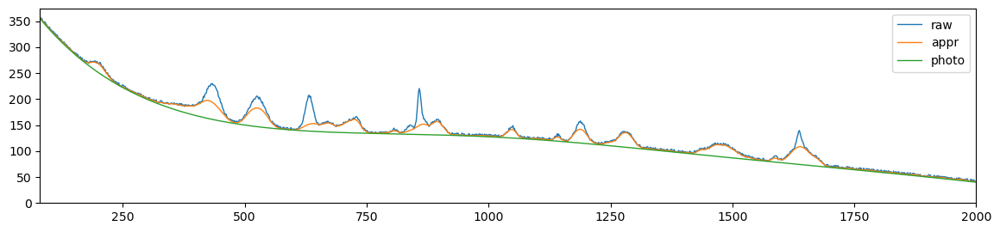

als_lambda: 10.0,	 als_p_weight: 0.1,	 error: 169.66024915133914, 	 smoothness: 0.4708586875114441, 	 smoothness: 0.4552166336868939


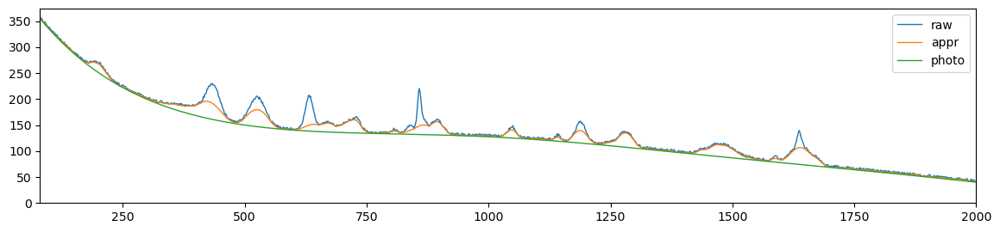

als_lambda: 10.0,	 als_p_weight: 0.0727895384398315,	 error: 160.2483576021902, 	 smoothness: 0.4228452634370265, 	 smoothness: 0.40571848596563453


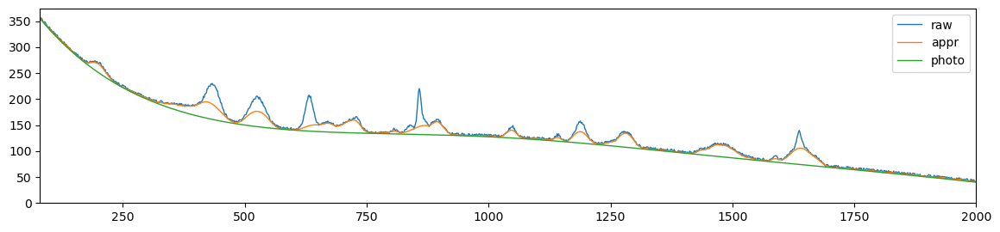

als_lambda: 10.0,	 als_p_weight: 0.05298316906283707,	 error: 151.18890504868398, 	 smoothness: 0.3780840715021205, 	 smoothness: 0.3592234595642665


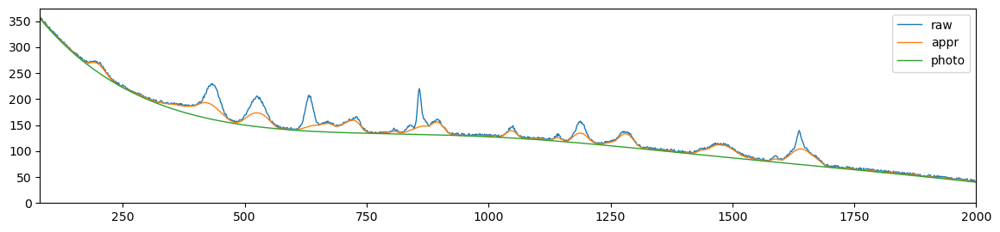

als_lambda: 10.0,	 als_p_weight: 0.03856620421163472,	 error: 142.44101629843868, 	 smoothness: 0.3365217864658895, 	 smoothness: 0.315540324634741


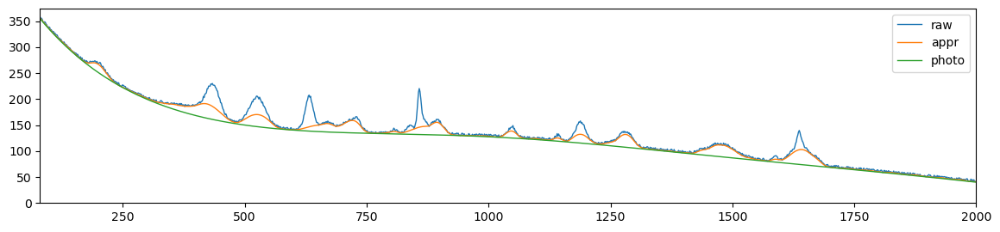

als_lambda: 10.0,	 als_p_weight: 0.02807216203941177,	 error: 133.8738088710822, 	 smoothness: 0.2979963081815868, 	 smoothness: 0.2744254063184417


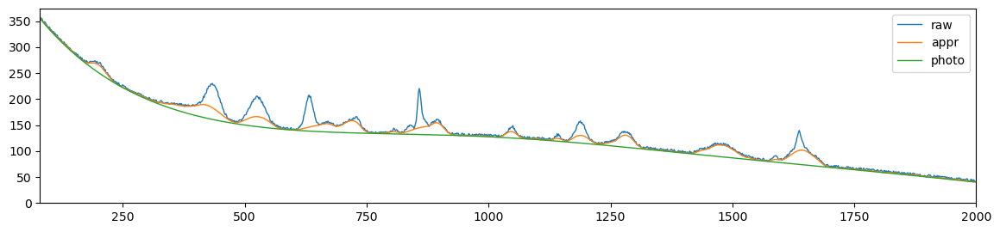

als_lambda: 10.0,	 als_p_weight: 0.020433597178569417,	 error: 125.48143064182511, 	 smoothness: 0.2627032240213685, 	 smoothness: 0.23606844103570182


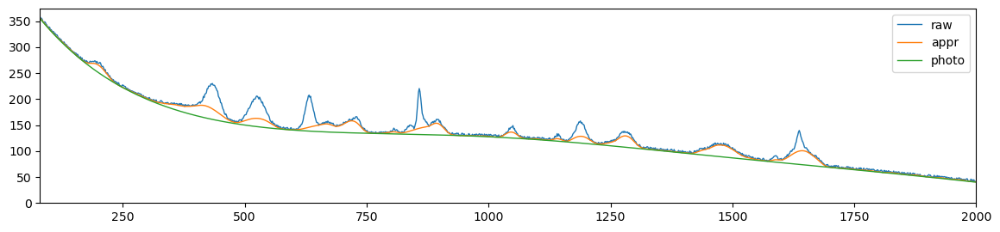

als_lambda: 10.0,	 als_p_weight: 0.014873521072935119,	 error: 117.60008151048233, 	 smoothness: 0.23089965293680736, 	 smoothness: 0.20052764021606861


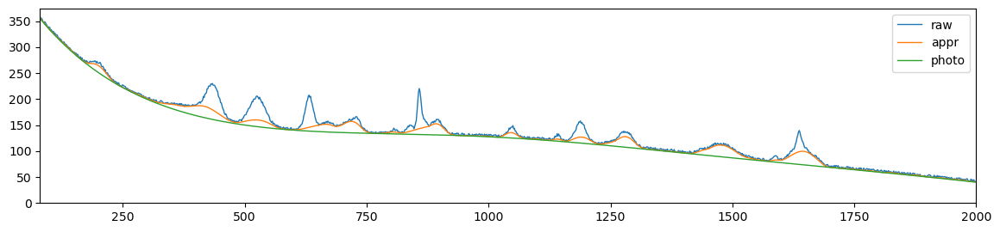

als_lambda: 10.0,	 als_p_weight: 0.010826367338740546,	 error: 110.06511118580575, 	 smoothness: 0.2022571065543685, 	 smoothness: 0.16763522090177005


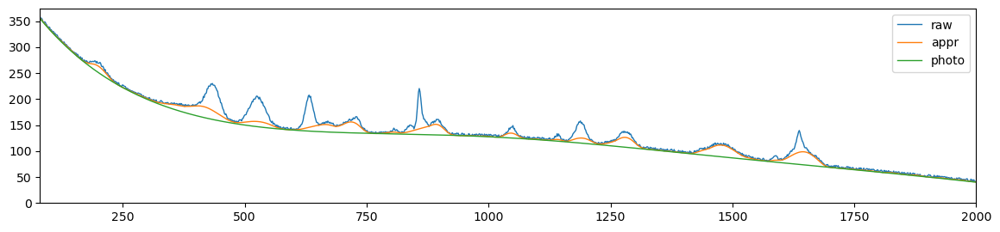

als_lambda: 10.0,	 als_p_weight: 0.007880462815669913,	 error: 102.83289329907095, 	 smoothness: 0.17675545513944005, 	 smoothness: 0.1372622703865719


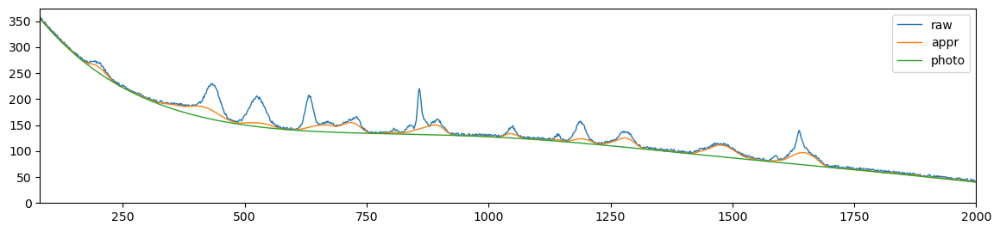

als_lambda: 10.0,	 als_p_weight: 0.005736152510448681,	 error: 95.9598501127255, 	 smoothness: 0.15415589257115322, 	 smoothness: 0.10922881104101176


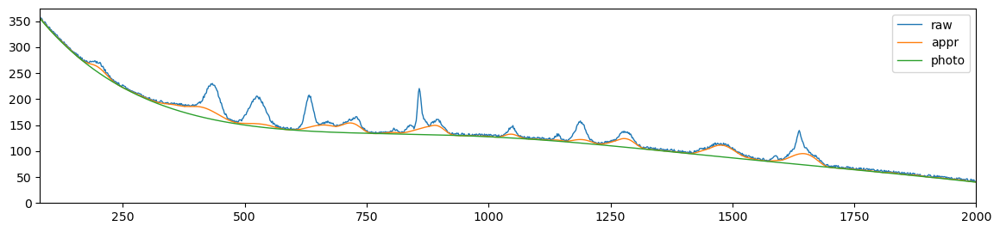

als_lambda: 10.0,	 als_p_weight: 0.0041753189365604,	 error: 89.38668370801165, 	 smoothness: 0.13420536138646186, 	 smoothness: 0.08291085090618963


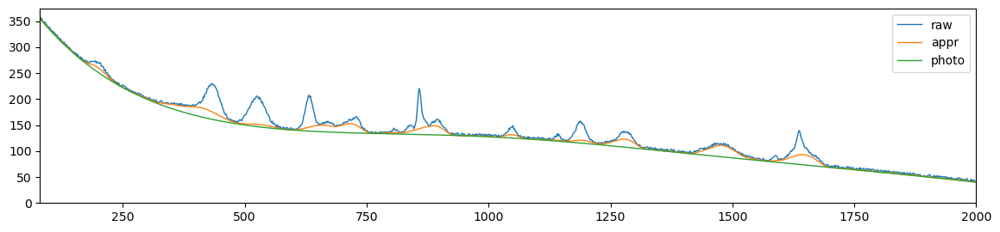

als_lambda: 10.0,	 als_p_weight: 0.0030391953823131978,	 error: 83.19542486980907, 	 smoothness: 0.1169902750904172, 	 smoothness: 0.0578344149882287


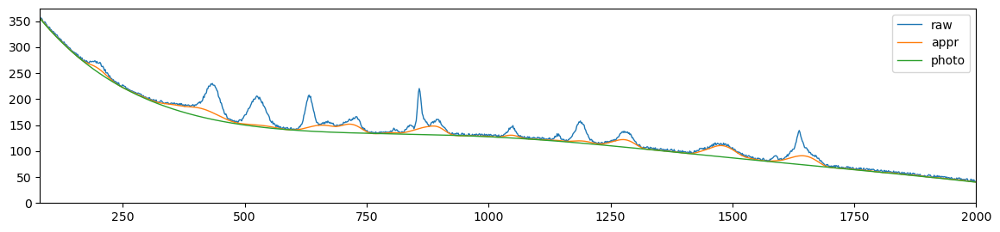

als_lambda: 10.0,	 als_p_weight: 0.00221221629107045,	 error: 77.36970860856808, 	 smoothness: 0.10240077697836343, 	 smoothness: 0.0334808825278342


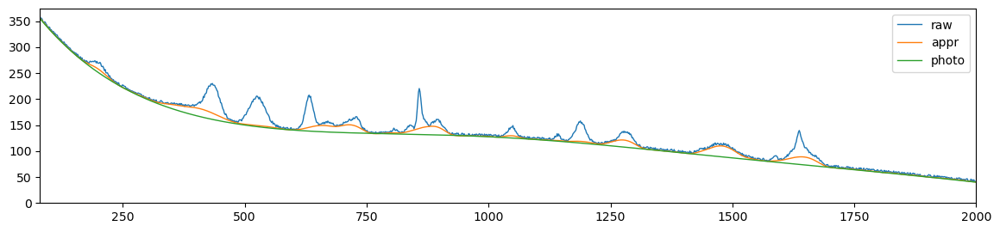

als_lambda: 10.0,	 als_p_weight: 0.0016102620275609393,	 error: 71.84974041795877, 	 smoothness: 0.09019739145887938, 	 smoothness: 0.010075175559509748


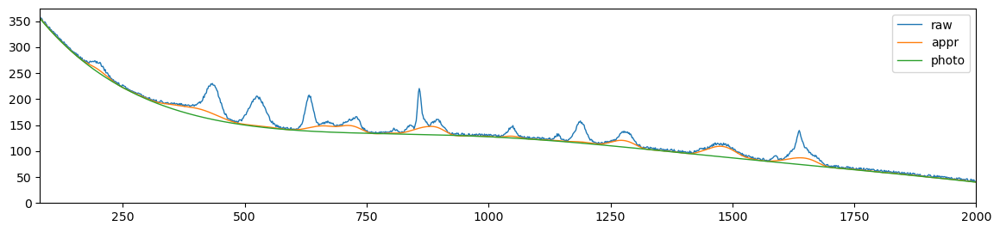

als_lambda: 10.0,	 als_p_weight: 0.0011721022975334804,	 error: 66.72565770322734, 	 smoothness: 0.08022516715781952, 	 smoothness: -0.01265337747342103


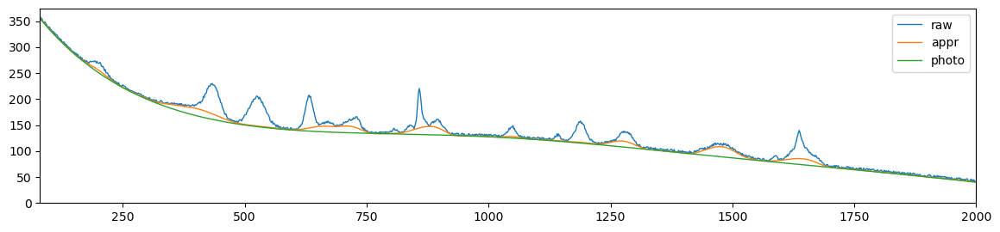

als_lambda: 10.0,	 als_p_weight: 0.0008531678524172806,	 error: 61.94070288556687, 	 smoothness: 0.07253190742725966, 	 smoothness: -0.035065465117375016


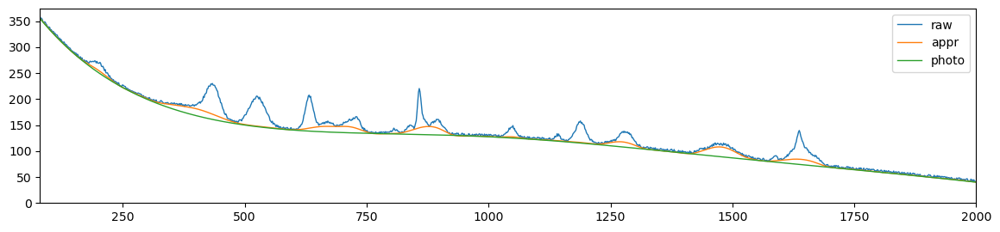

als_lambda: 10.0,	 als_p_weight: 0.0006210169418915617,	 error: 57.499436903964224, 	 smoothness: 0.06678526878400097, 	 smoothness: -0.05754677950064599


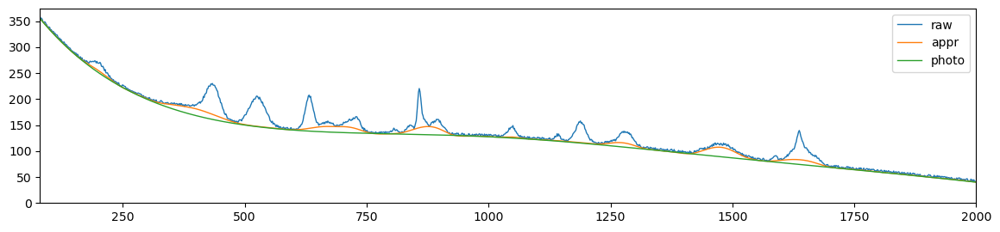

als_lambda: 10.0,	 als_p_weight: 0.00045203536563602454,	 error: 53.35870539822729, 	 smoothness: 0.06295172080371424, 	 smoothness: -0.08064578925684934


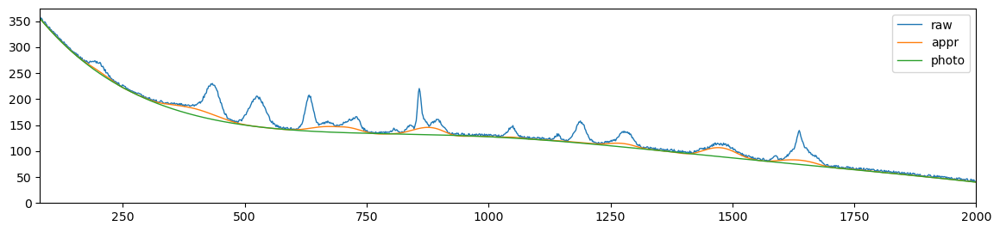

als_lambda: 10.0,	 als_p_weight: 0.00032903445623126676,	 error: 49.645464397172105, 	 smoothness: 0.06166442704183293, 	 smoothness: -0.10578245485654783


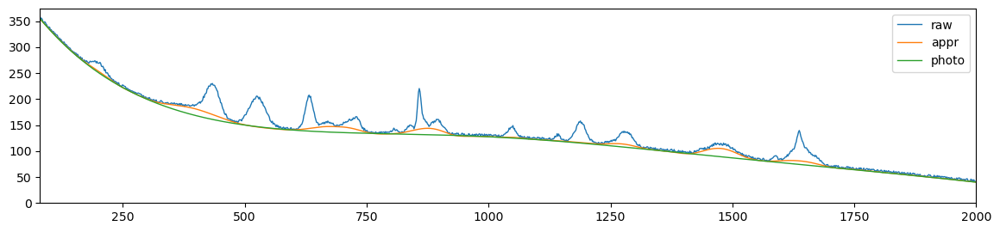

als_lambda: 10.0,	 als_p_weight: 0.0002395026619987486,	 error: 46.53321199059612, 	 smoothness: 0.06354941294264449, 	 smoothness: -0.13310597685840567


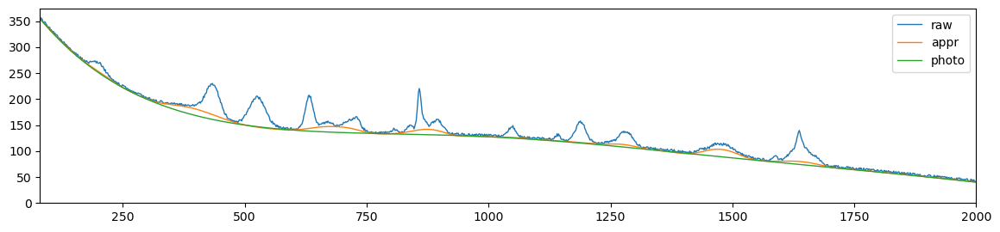

als_lambda: 10.0,	 als_p_weight: 0.00017433288221999874,	 error: 44.005432714739, 	 smoothness: 0.06897880376351435, 	 smoothness: -0.16296273025464


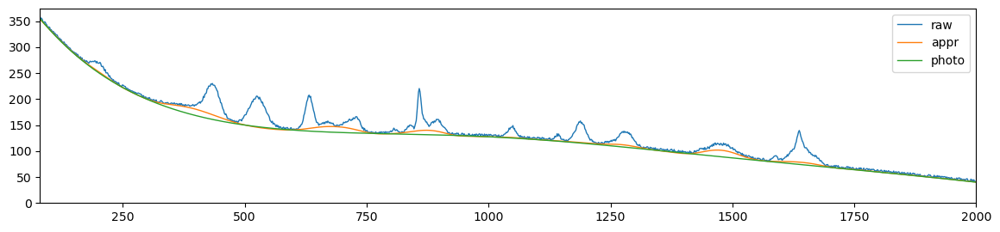

als_lambda: 10.0,	 als_p_weight: 0.0001268961003167922,	 error: 45.80360222714895, 	 smoothness: 0.08721387723083578, 	 smoothness: -0.20454312749646322


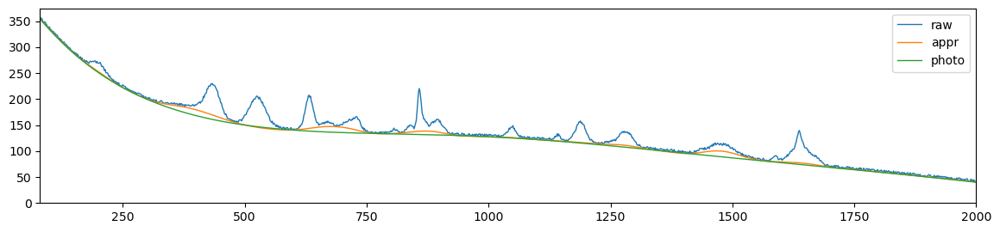

als_lambda: 10.0,	 als_p_weight: 9.236708571873866e-05,	 error: 56.25079423510641, 	 smoothness: 0.12170257301878433, 	 smoothness: -0.2534958368999393


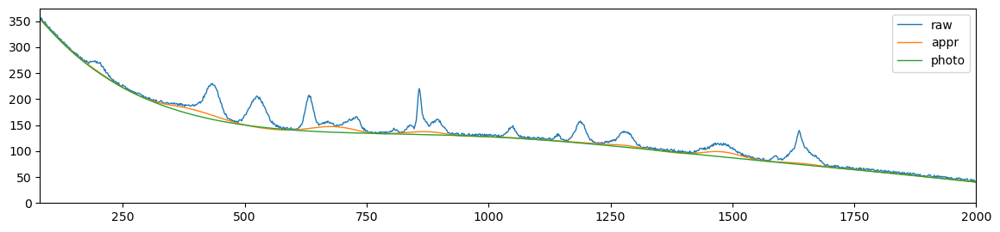

als_lambda: 10.0,	 als_p_weight: 6.723357536499335e-05,	 error: 71.61500933960902, 	 smoothness: 0.1622281290526546, 	 smoothness: -0.2988948361706877


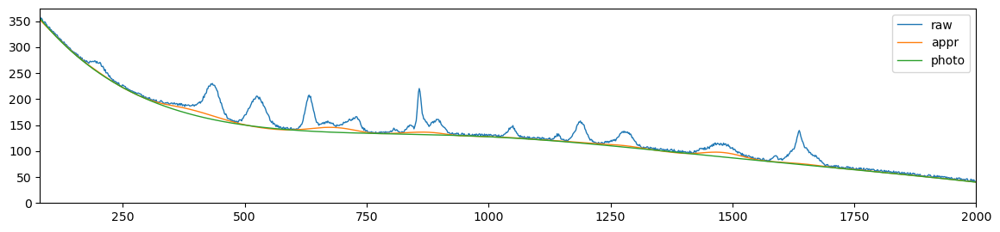

als_lambda: 10.0,	 als_p_weight: 4.893900918477499e-05,	 error: 80.58945431864205, 	 smoothness: 0.18718260152871774, 	 smoothness: -0.33582701711111


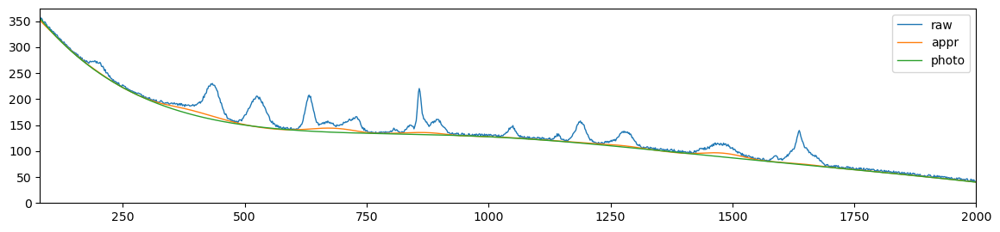

als_lambda: 10.0,	 als_p_weight: 3.5622478902624444e-05,	 error: 94.82629730183804, 	 smoothness: 0.21599523056731912, 	 smoothness: -0.3706036415107373


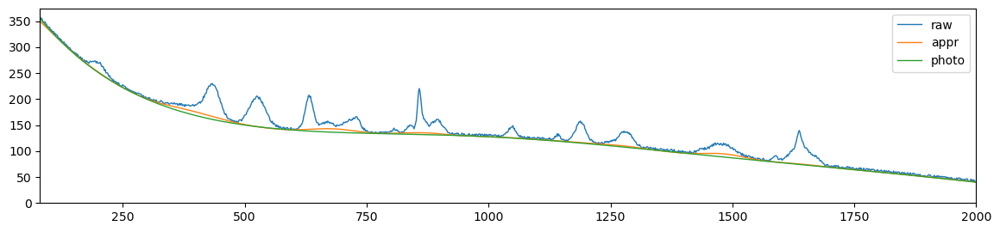

als_lambda: 10.0,	 als_p_weight: 2.592943797404667e-05,	 error: 99.53283877136724, 	 smoothness: 0.22677391581370734, 	 smoothness: -0.3895042089846901


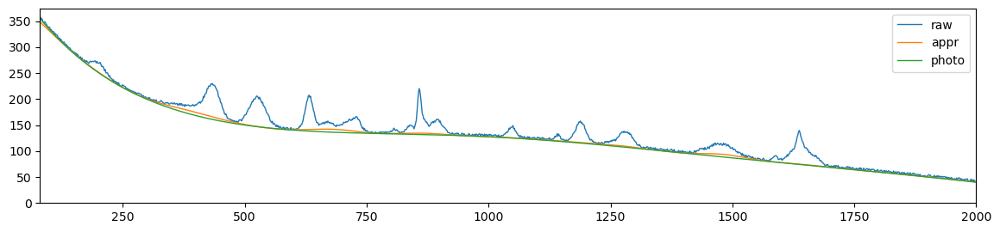

als_lambda: 10.0,	 als_p_weight: 1.8873918221350995e-05,	 error: 108.38091288969107, 	 smoothness: 0.24293405496616105, 	 smoothness: -0.40871458461848725


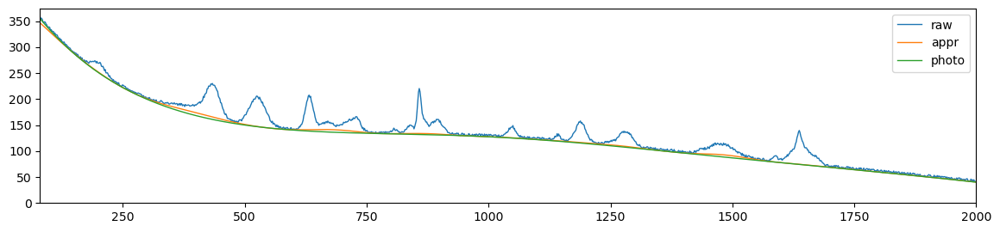

als_lambda: 10.0,	 als_p_weight: 1.3738237958832637e-05,	 error: 114.9175763737392, 	 smoothness: 0.25230957665761883, 	 smoothness: -0.4207228835805599


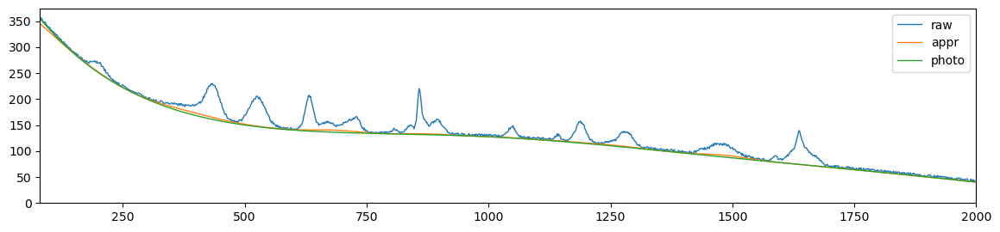

als_lambda: 10.0,	 als_p_weight: 1e-05,	 error: 115.67753880749244, 	 smoothness: 0.2544169150094039, 	 smoothness: -0.4260953474551797


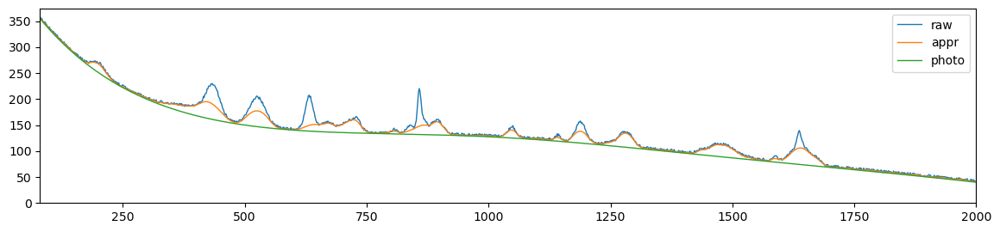

als_lambda: 17.43328822199988,	 als_p_weight: 0.1,	 error: 156.7539405012689, 	 smoothness: 0.38208543344542967, 	 smoothness: 0.363516393059153


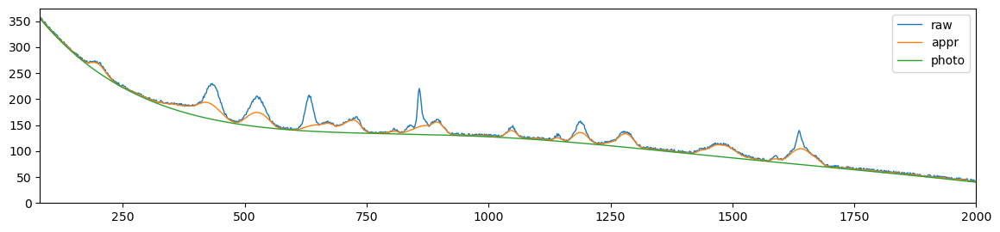

als_lambda: 17.43328822199988,	 als_p_weight: 0.0727895384398315,	 error: 147.52840477213158, 	 smoothness: 0.34119095356134027, 	 smoothness: 0.3206368590732637


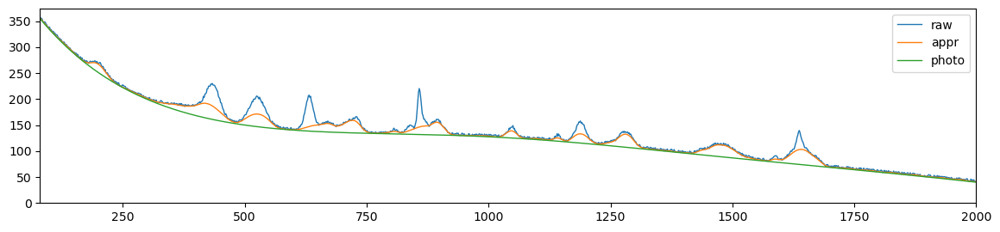

als_lambda: 17.43328822199988,	 als_p_weight: 0.05298316906283707,	 error: 138.54127213358922, 	 smoothness: 0.30295978416087094, 	 smoothness: 0.2799254599321324


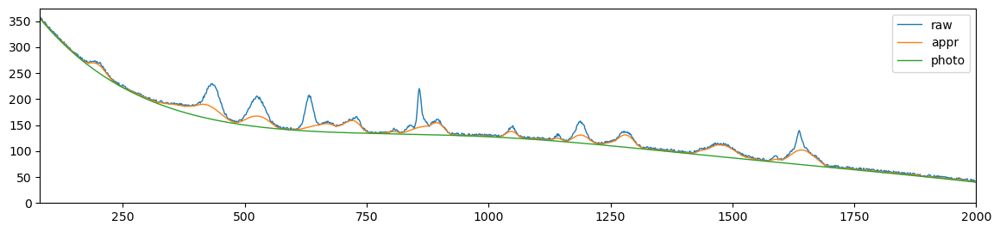

als_lambda: 17.43328822199988,	 als_p_weight: 0.03856620421163472,	 error: 129.60737392356484, 	 smoothness: 0.26736286218876354, 	 smoothness: 0.24136137909272018


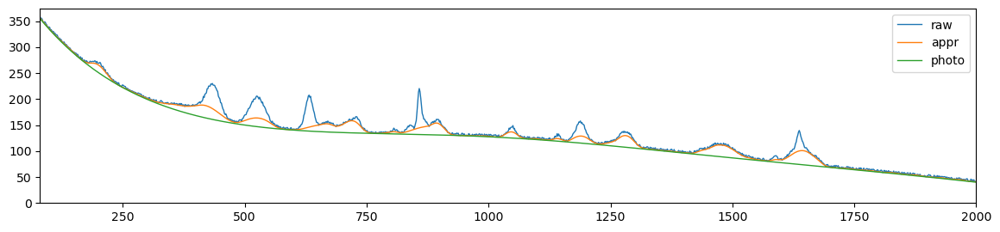

als_lambda: 17.43328822199988,	 als_p_weight: 0.02807216203941177,	 error: 121.41828269149204, 	 smoothness: 0.23568766608636602, 	 smoothness: 0.20623763015473756


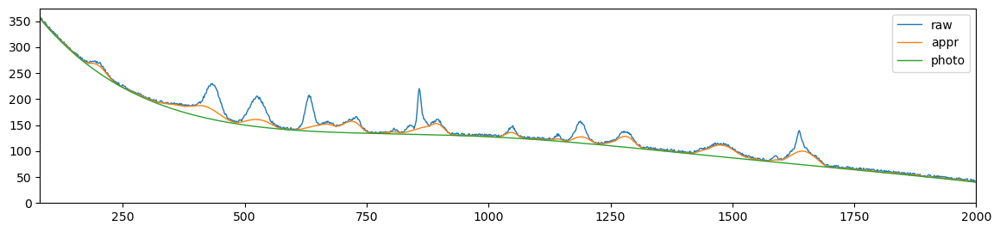

als_lambda: 17.43328822199988,	 als_p_weight: 0.020433597178569417,	 error: 113.56385295468533, 	 smoothness: 0.20696364377737353, 	 smoothness: 0.17337908205180363


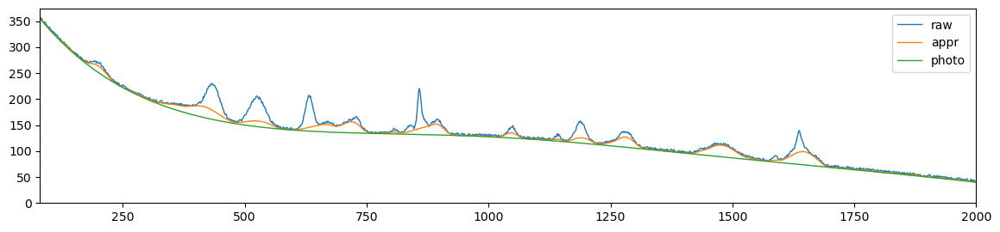

als_lambda: 17.43328822199988,	 als_p_weight: 0.014873521072935119,	 error: 106.0082301079426, 	 smoothness: 0.18112336555538897, 	 smoothness: 0.14274278190945197


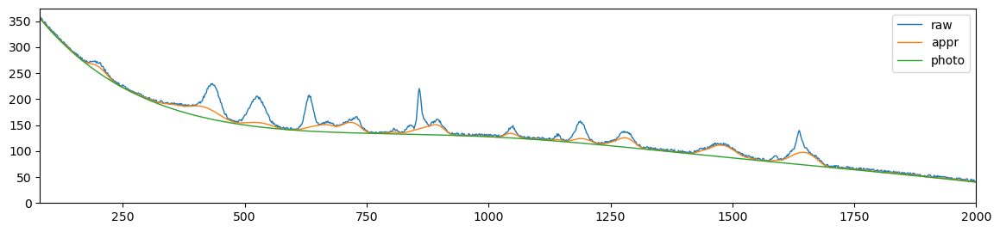

als_lambda: 17.43328822199988,	 als_p_weight: 0.010826367338740546,	 error: 98.83562744118609, 	 smoothness: 0.15820727117938055, 	 smoothness: 0.11447062467474638


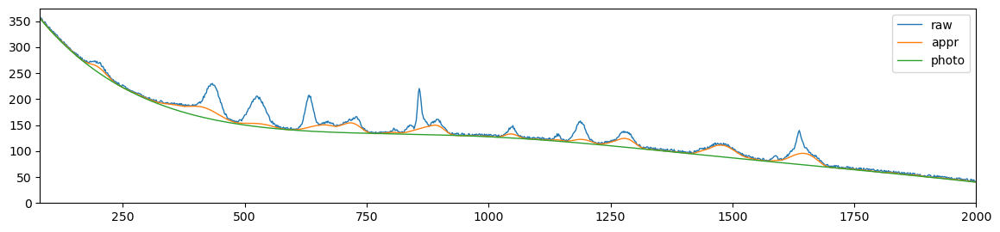

als_lambda: 17.43328822199988,	 als_p_weight: 0.007880462815669913,	 error: 91.99995646136794, 	 smoothness: 0.13795020966516147, 	 smoothness: 0.08812191476968012


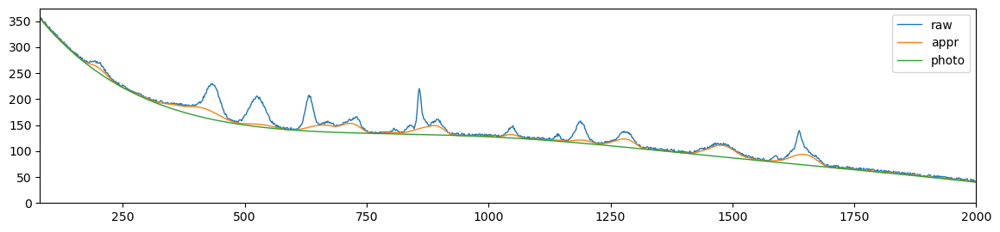

als_lambda: 17.43328822199988,	 als_p_weight: 0.005736152510448681,	 error: 85.5745119125131, 	 smoothness: 0.12032599090147097, 	 smoothness: 0.06296882020726523


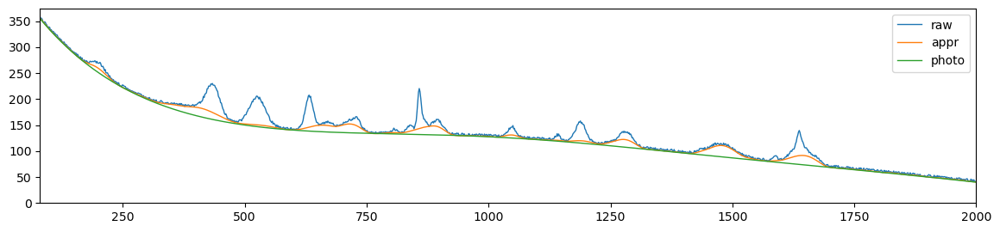

als_lambda: 17.43328822199988,	 als_p_weight: 0.0041753189365604,	 error: 79.516440351427, 	 smoothness: 0.10529026561433001, 	 smoothness: 0.038749274521453644


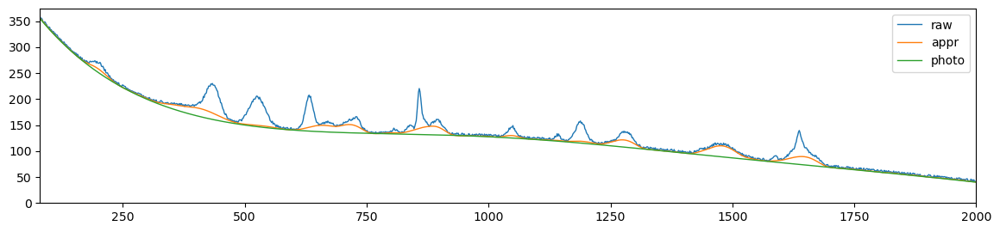

als_lambda: 17.43328822199988,	 als_p_weight: 0.0030391953823131978,	 error: 73.78935409725567, 	 smoothness: 0.09265029599023661, 	 smoothness: 0.01532987029262424


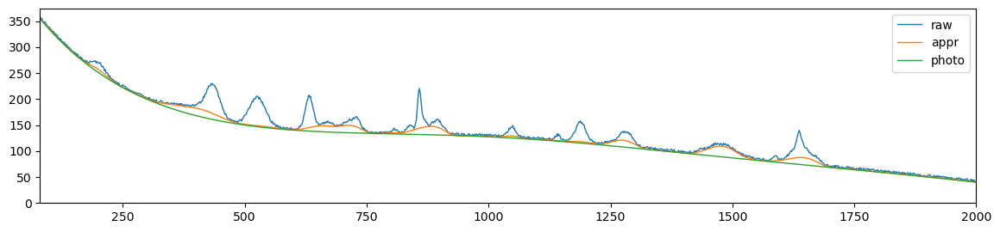

als_lambda: 17.43328822199988,	 als_p_weight: 0.00221221629107045,	 error: 68.45875988298565, 	 smoothness: 0.08221881443248238, 	 smoothness: -0.007413802662609758


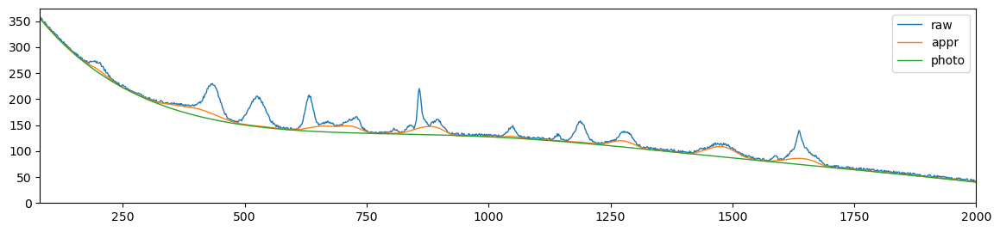

als_lambda: 17.43328822199988,	 als_p_weight: 0.0016102620275609393,	 error: 63.50575160091973, 	 smoothness: 0.07405335650226913, 	 smoothness: -0.029831215071999182


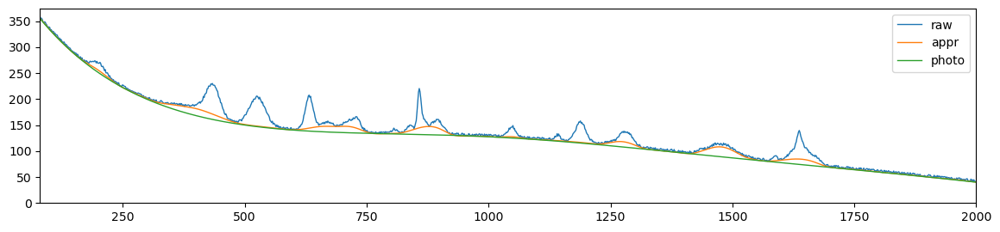

als_lambda: 17.43328822199988,	 als_p_weight: 0.0011721022975334804,	 error: 58.87334106681764, 	 smoothness: 0.06786949901920665, 	 smoothness: -0.052175288180201285


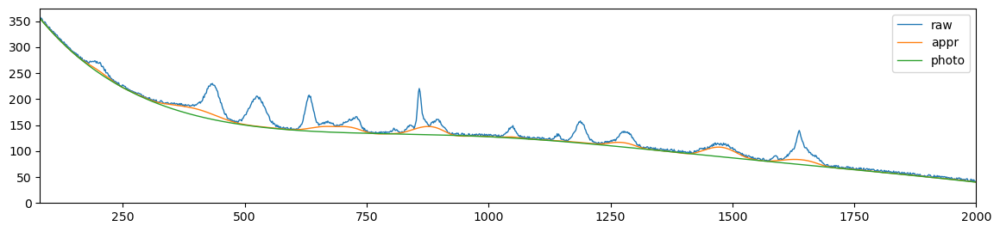

als_lambda: 17.43328822199988,	 als_p_weight: 0.0008531678524172806,	 error: 54.61595467331046, 	 smoothness: 0.06362955451775912, 	 smoothness: -0.07493054498154822


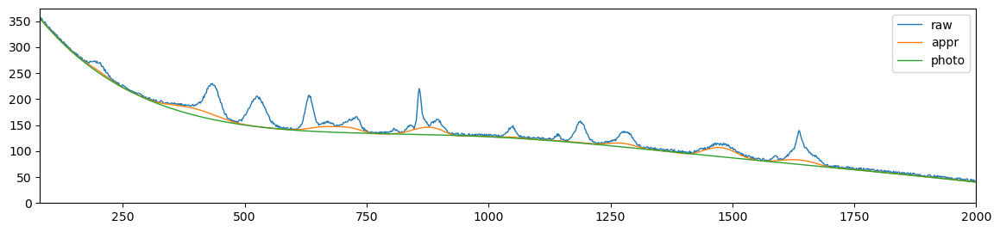

als_lambda: 17.43328822199988,	 als_p_weight: 0.0006210169418915617,	 error: 50.71609630619004, 	 smoothness: 0.061614561544980614, 	 smoothness: -0.09938711191581664


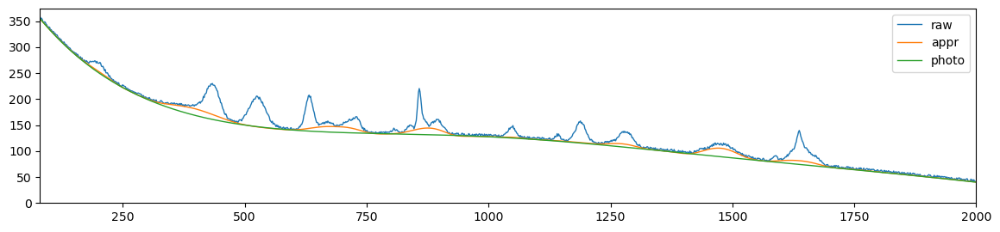

als_lambda: 17.43328822199988,	 als_p_weight: 0.00045203536563602454,	 error: 47.36516978604111, 	 smoothness: 0.06273109552010818, 	 smoothness: -0.1263768603905341


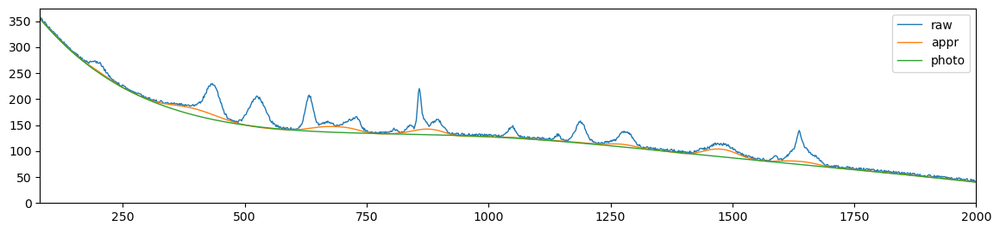

als_lambda: 17.43328822199988,	 als_p_weight: 0.00032903445623126676,	 error: 44.570973959077975, 	 smoothness: 0.06681302186408292, 	 smoothness: -0.15452284189476312


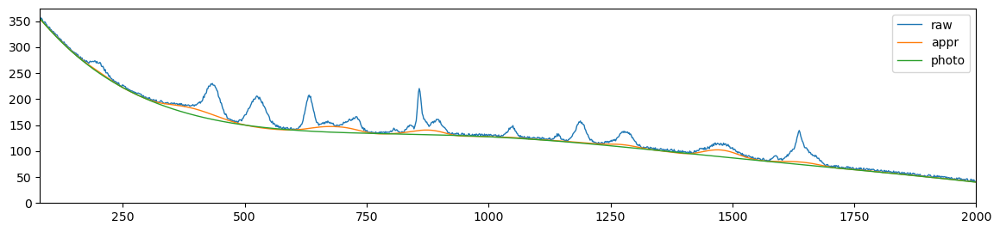

als_lambda: 17.43328822199988,	 als_p_weight: 0.0002395026619987486,	 error: 44.36749099346732, 	 smoothness: 0.08049946489585544, 	 smoothness: -0.19318203534068548


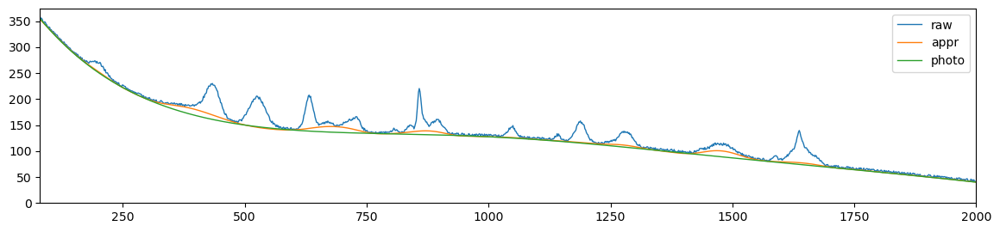

als_lambda: 17.43328822199988,	 als_p_weight: 0.00017433288221999874,	 error: 53.67694338999718, 	 smoothness: 0.11575826116352327, 	 smoothness: -0.24482964328571089


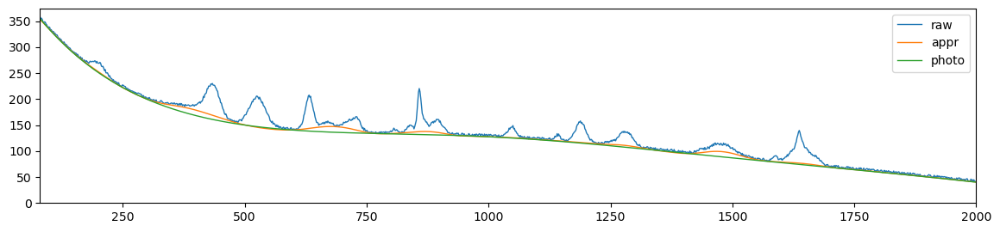

als_lambda: 17.43328822199988,	 als_p_weight: 0.0001268961003167922,	 error: 77.00891641498198, 	 smoothness: 0.16831921087508459, 	 smoothness: -0.2962292401463217


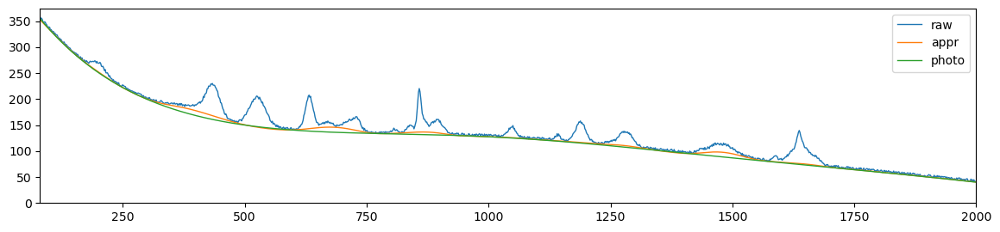

als_lambda: 17.43328822199988,	 als_p_weight: 9.236708571873866e-05,	 error: 91.53434303445003, 	 smoothness: 0.20344377632611546, 	 smoothness: -0.3387524092640084


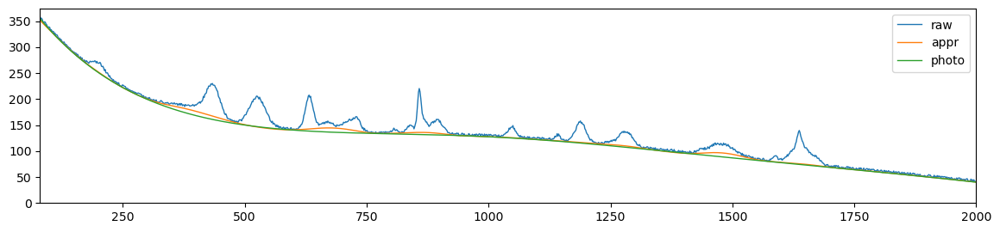

als_lambda: 17.43328822199988,	 als_p_weight: 6.723357536499335e-05,	 error: 105.56399719924435, 	 smoothness: 0.23363235450489356, 	 smoothness: -0.37462382449143616


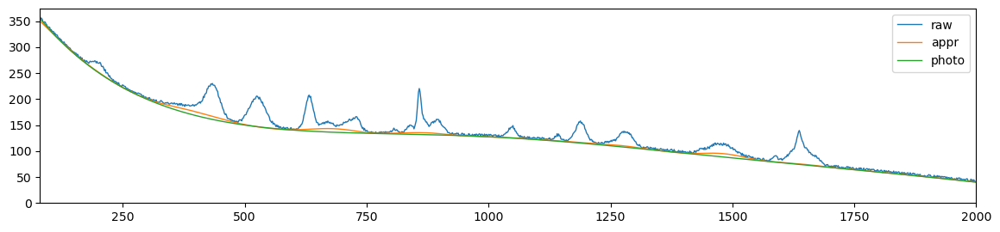

als_lambda: 17.43328822199988,	 als_p_weight: 4.893900918477499e-05,	 error: 112.60736299206637, 	 smoothness: 0.24553240909004523, 	 smoothness: -0.39458629656460525


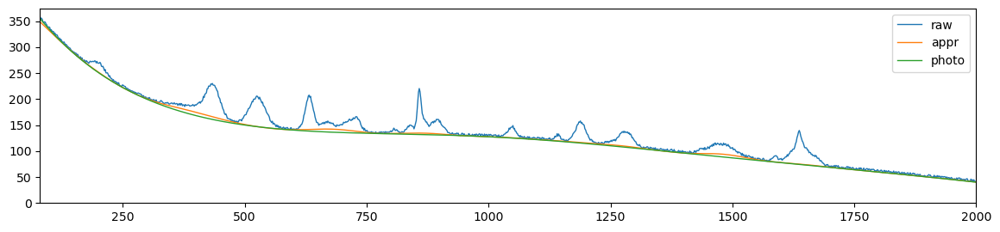

als_lambda: 17.43328822199988,	 als_p_weight: 3.5622478902624444e-05,	 error: 117.25331948142195, 	 smoothness: 0.2552576979325899, 	 smoothness: -0.4130394630282892


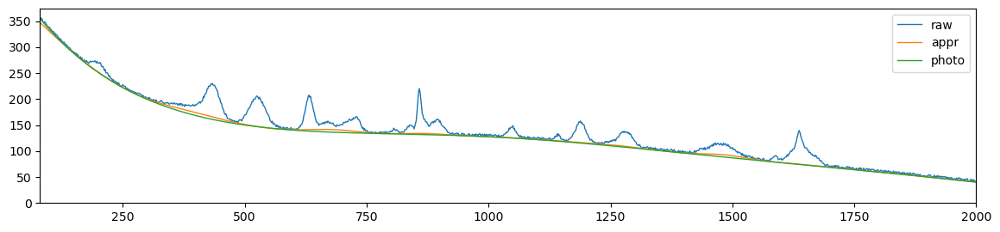

als_lambda: 17.43328822199988,	 als_p_weight: 2.592943797404667e-05,	 error: 124.44717833435028, 	 smoothness: 0.2677673479866261, 	 smoothness: -0.427453959007963


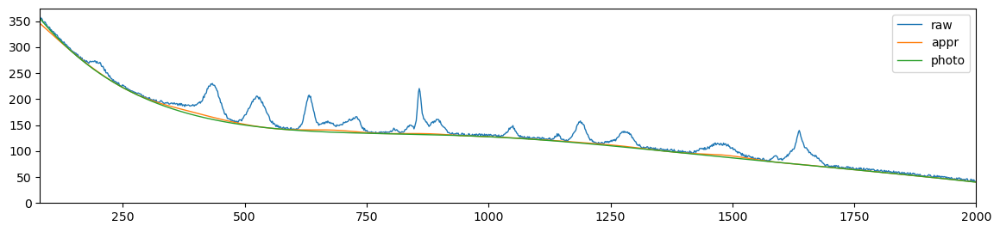

als_lambda: 17.43328822199988,	 als_p_weight: 1.8873918221350995e-05,	 error: 127.76406148166461, 	 smoothness: 0.2717750301894618, 	 smoothness: -0.4350893557641418


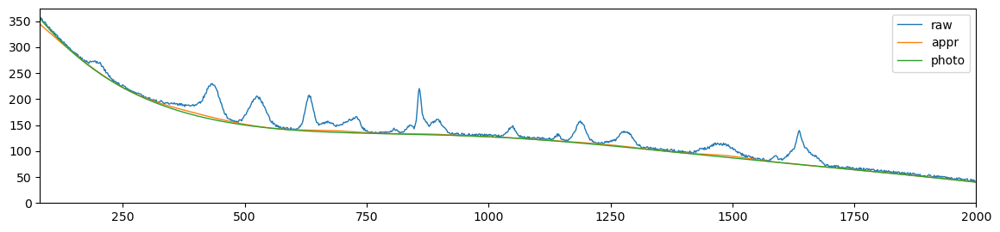

als_lambda: 17.43328822199988,	 als_p_weight: 1.3738237958832637e-05,	 error: 140.24670654683277, 	 smoothness: 0.283182397752651, 	 smoothness: -0.44452951280620245


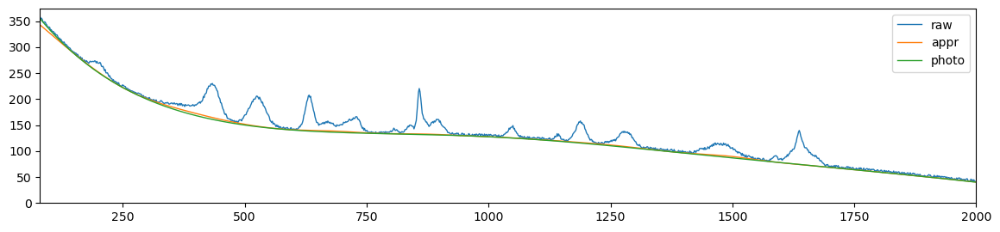

als_lambda: 17.43328822199988,	 als_p_weight: 1e-05,	 error: 149.98616378079277, 	 smoothness: 0.29354054028946885, 	 smoothness: -0.4512027732736468


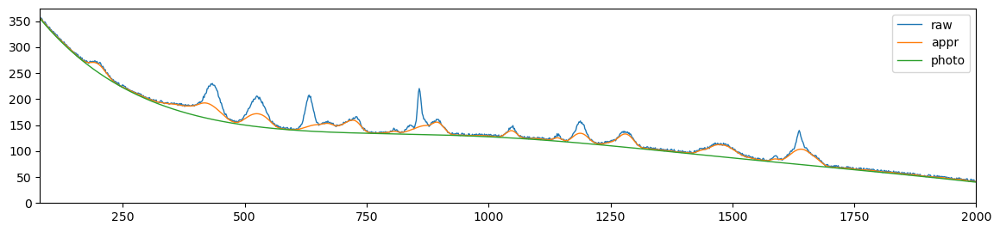

als_lambda: 30.39195382313198,	 als_p_weight: 0.1,	 error: 144.4092538355963, 	 smoothness: 0.3064550068991552, 	 smoothness: 0.2838703524318123


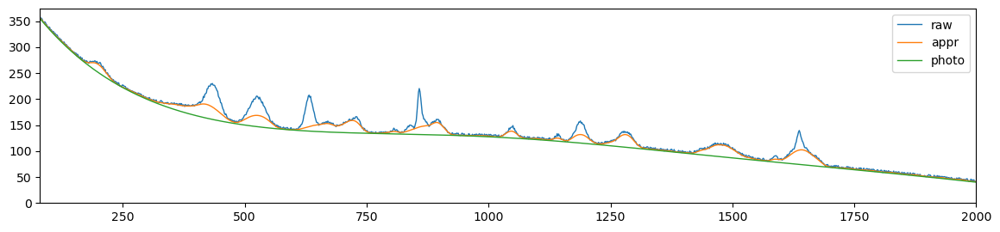

als_lambda: 30.39195382313198,	 als_p_weight: 0.0727895384398315,	 error: 134.82660336784818, 	 smoothness: 0.27099804587730225, 	 smoothness: 0.24559658460338554


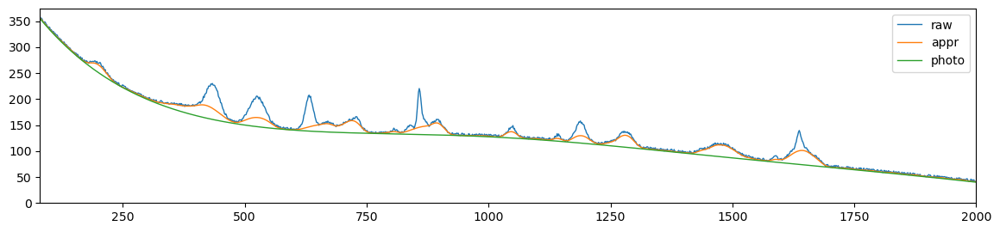

als_lambda: 30.39195382313198,	 als_p_weight: 0.05298316906283707,	 error: 126.18628974416751, 	 smoothness: 0.23955767445696138, 	 smoothness: 0.2107985756001581


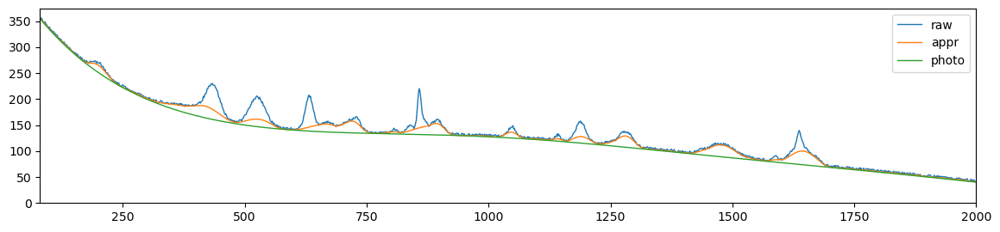

als_lambda: 30.39195382313198,	 als_p_weight: 0.03856620421163472,	 error: 117.89235562299726, 	 smoothness: 0.21087389421930067, 	 smoothness: 0.17817837646165252


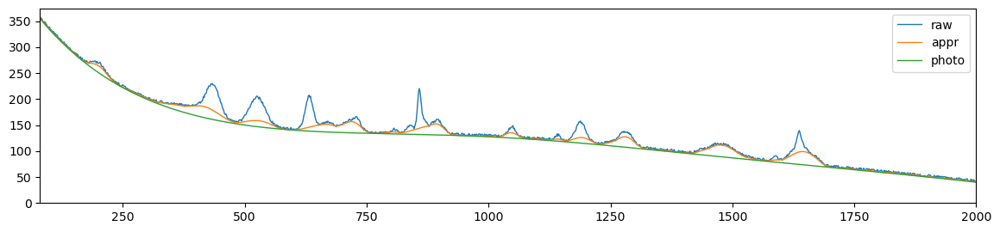

als_lambda: 30.39195382313198,	 als_p_weight: 0.02807216203941177,	 error: 109.96921930366918, 	 smoothness: 0.18500448159866914, 	 smoothness: 0.14762062172646903


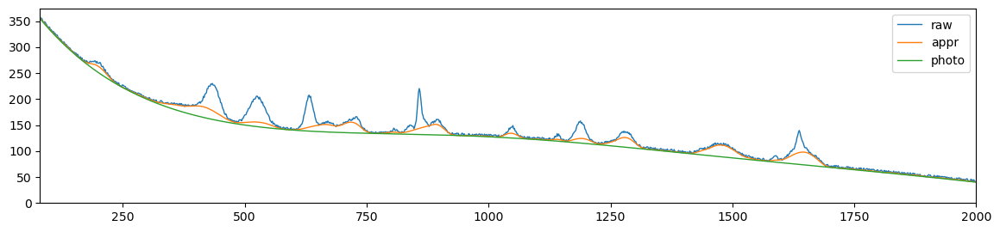

als_lambda: 30.39195382313198,	 als_p_weight: 0.020433597178569417,	 error: 102.39530501625553, 	 smoothness: 0.16183877470676442, 	 smoothness: 0.11916492335674521


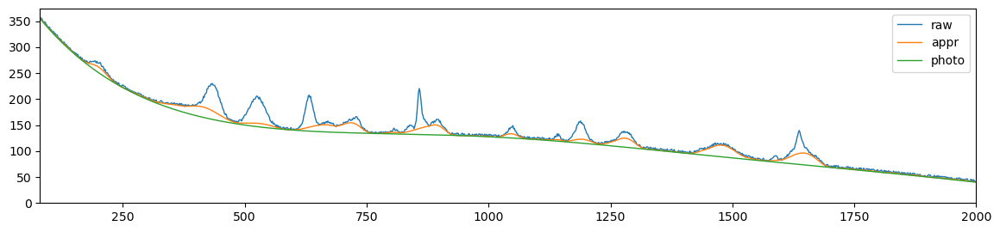

als_lambda: 30.39195382313198,	 als_p_weight: 0.014873521072935119,	 error: 95.23066442031775, 	 smoothness: 0.14135403661088974, 	 smoothness: 0.09270838233666052


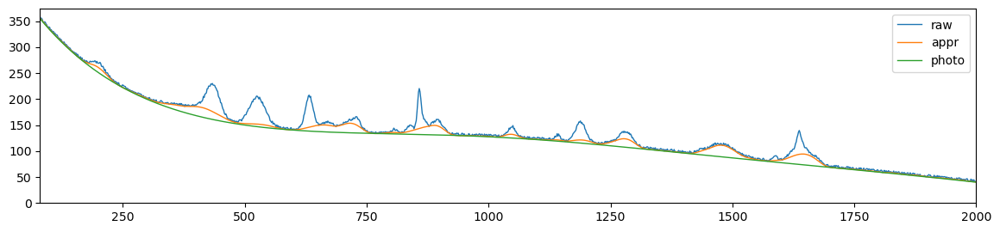

als_lambda: 30.39195382313198,	 als_p_weight: 0.010826367338740546,	 error: 88.48818670855358, 	 smoothness: 0.1234531048848369, 	 smoothness: 0.0676493843901766


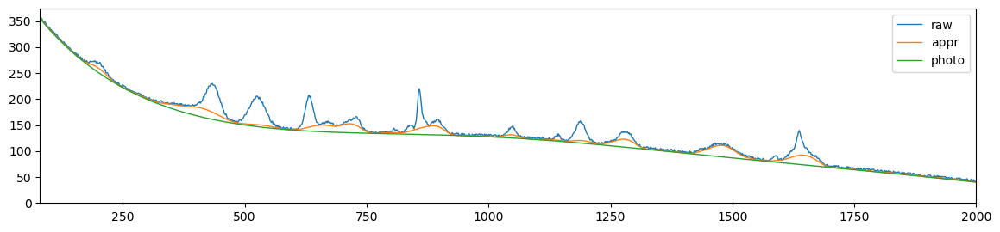

als_lambda: 30.39195382313198,	 als_p_weight: 0.007880462815669913,	 error: 82.14942869849627, 	 smoothness: 0.10805385631997137, 	 smoothness: 0.043529239468200434


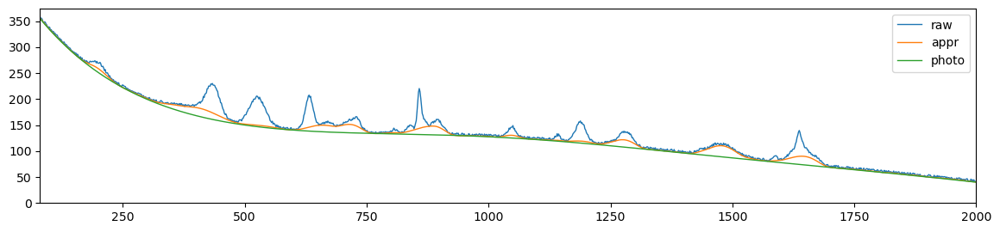

als_lambda: 30.39195382313198,	 als_p_weight: 0.005736152510448681,	 error: 76.17162511650368, 	 smoothness: 0.09503487046788824, 	 smoothness: 0.02018984946984589


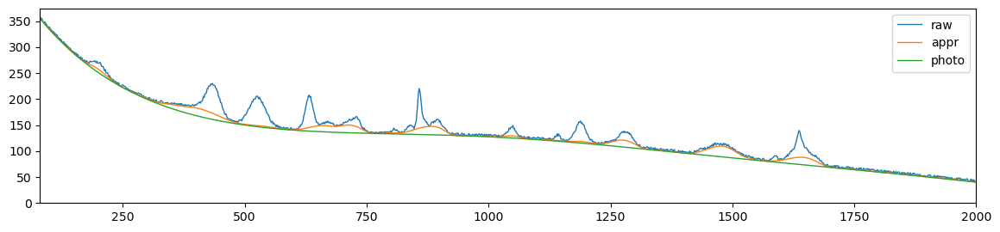

als_lambda: 30.39195382313198,	 als_p_weight: 0.0041753189365604,	 error: 70.55838188422793, 	 smoothness: 0.08417853141083681, 	 smoothness: -0.0023717676000521975


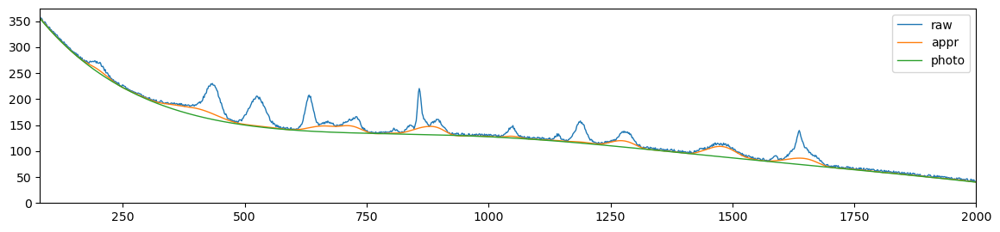

als_lambda: 30.39195382313198,	 als_p_weight: 0.0030391953823131978,	 error: 65.38926503259869, 	 smoothness: 0.07559356514899655, 	 smoothness: -0.024838930148810702


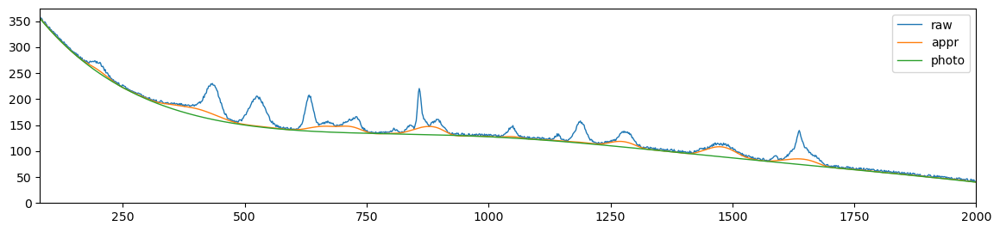

als_lambda: 30.39195382313198,	 als_p_weight: 0.00221221629107045,	 error: 60.52400509583436, 	 smoothness: 0.0689955361322419, 	 smoothness: -0.04711157494006207


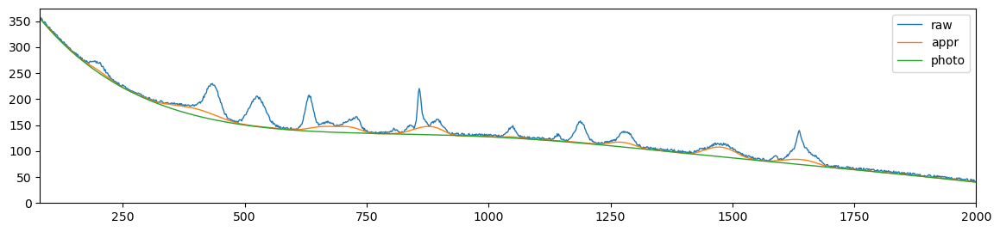

als_lambda: 30.39195382313198,	 als_p_weight: 0.0016102620275609393,	 error: 56.09822167815068, 	 smoothness: 0.06435226046061567, 	 smoothness: -0.06948899077479562


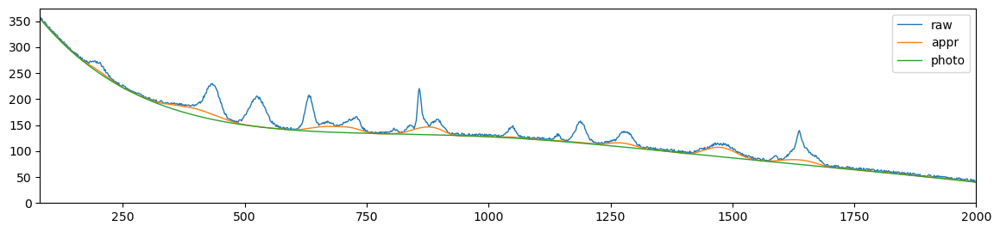

als_lambda: 30.39195382313198,	 als_p_weight: 0.0011721022975334804,	 error: 51.9966977226625, 	 smoothness: 0.06176787190412315, 	 smoothness: -0.09338979555109461


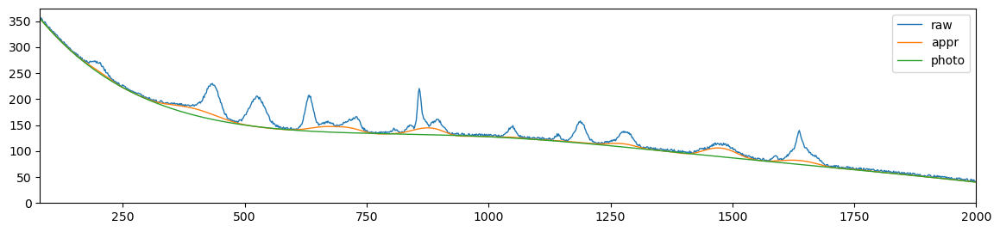

als_lambda: 30.39195382313198,	 als_p_weight: 0.0008531678524172806,	 error: 48.4238374333463, 	 smoothness: 0.06208478852560563, 	 smoothness: -0.1196710835650409


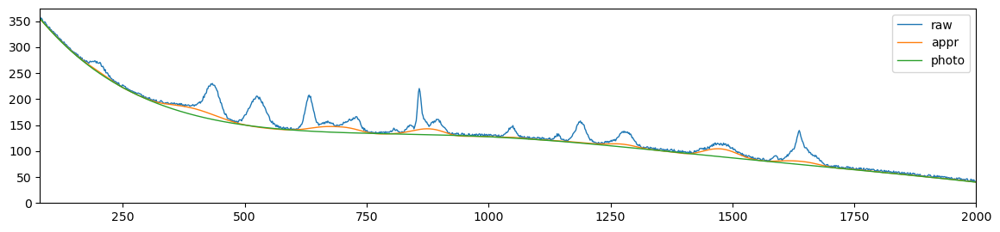

als_lambda: 30.39195382313198,	 als_p_weight: 0.0006210169418915617,	 error: 45.40332219393313, 	 smoothness: 0.06533948151918917, 	 smoothness: -0.14726763025716041


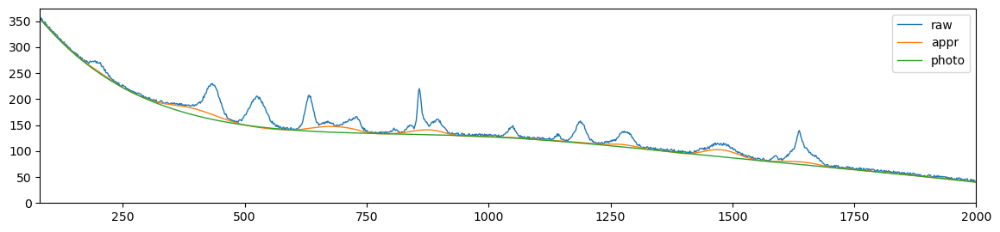

als_lambda: 30.39195382313198,	 als_p_weight: 0.00045203536563602454,	 error: 43.96572616617125, 	 smoothness: 0.07544186722614411, 	 smoothness: -0.18213768014227003


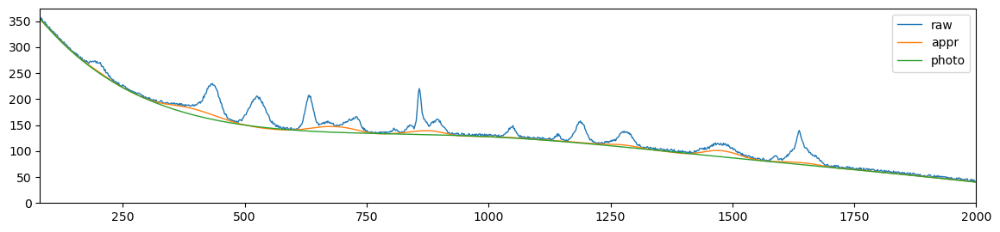

als_lambda: 30.39195382313198,	 als_p_weight: 0.00032903445623126676,	 error: 53.67649831198549, 	 smoothness: 0.11060750294915662, 	 smoothness: -0.23400838562831194


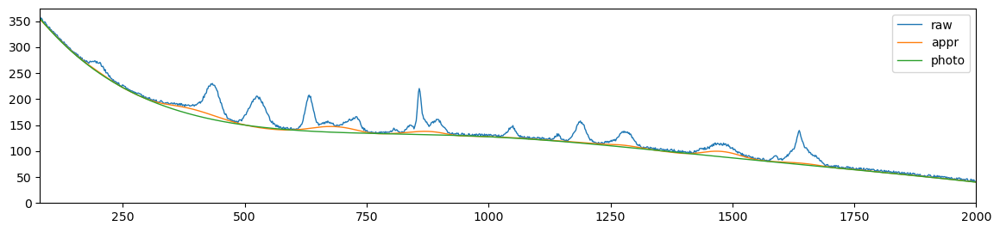

als_lambda: 30.39195382313198,	 als_p_weight: 0.0002395026619987486,	 error: 74.32580022433076, 	 smoothness: 0.16198652517944886, 	 smoothness: -0.286453080858214


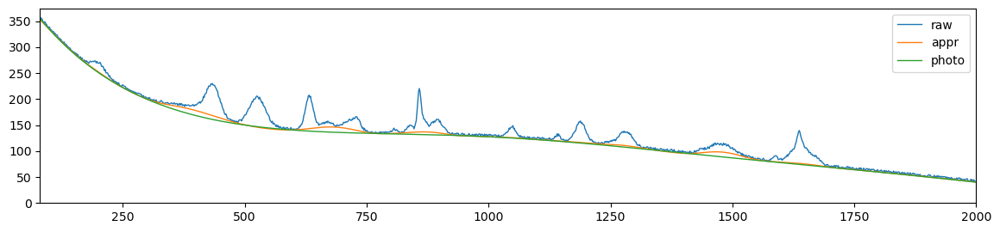

als_lambda: 30.39195382313198,	 als_p_weight: 0.00017433288221999874,	 error: 98.73200358757056, 	 smoothness: 0.2103794004072482, 	 smoothness: -0.33532756666481484


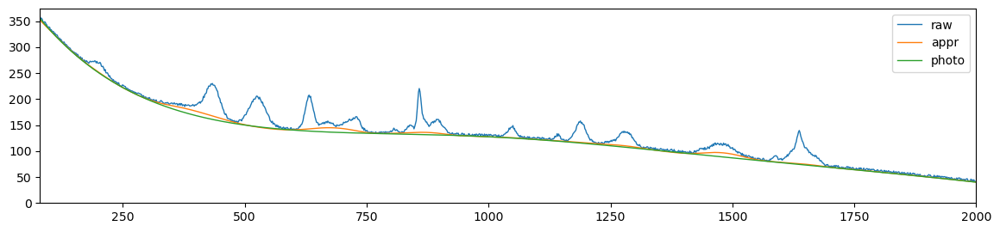

als_lambda: 30.39195382313198,	 als_p_weight: 0.0001268961003167922,	 error: 116.33084908828026, 	 smoothness: 0.24424294816049102, 	 smoothness: -0.3743839812466028


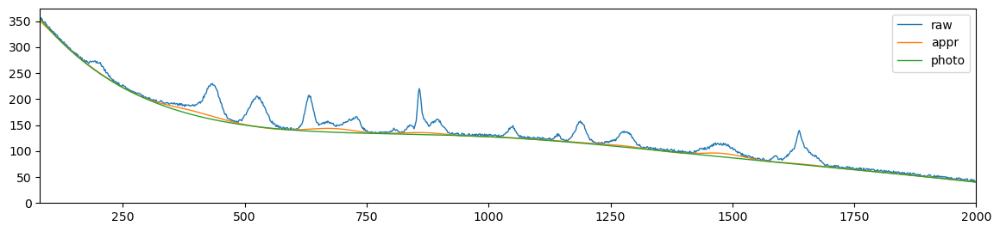

als_lambda: 30.39195382313198,	 als_p_weight: 9.236708571873866e-05,	 error: 123.38692562165649, 	 smoothness: 0.2588324436167937, 	 smoothness: -0.39527387846437484


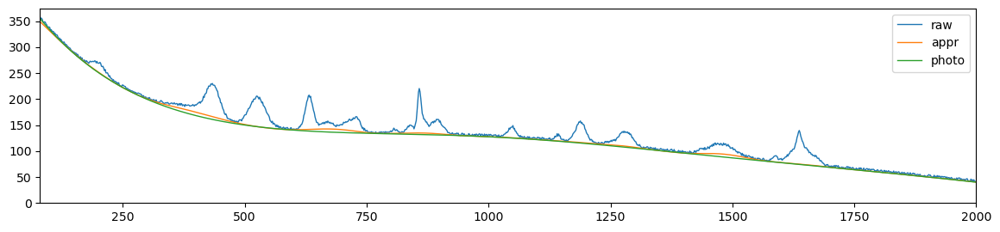

als_lambda: 30.39195382313198,	 als_p_weight: 6.723357536499335e-05,	 error: 130.11458262379787, 	 smoothness: 0.2720137959815461, 	 smoothness: -0.4203603886266385


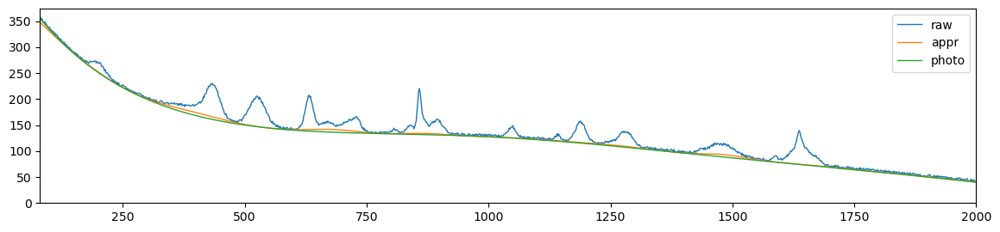

als_lambda: 30.39195382313198,	 als_p_weight: 4.893900918477499e-05,	 error: 141.92116967340624, 	 smoothness: 0.2884357301822786, 	 smoothness: -0.4390089771641161


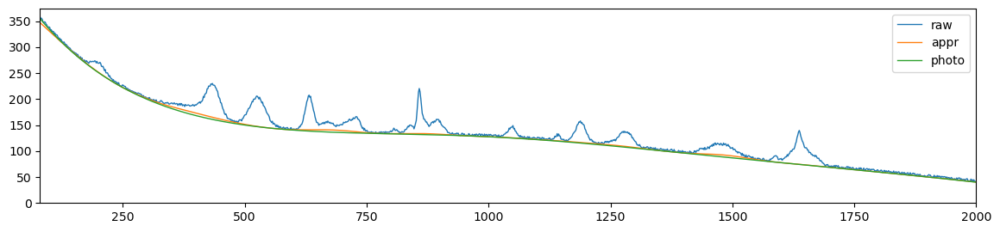

als_lambda: 30.39195382313198,	 als_p_weight: 3.5622478902624444e-05,	 error: 144.96790732157197, 	 smoothness: 0.29308660796511904, 	 smoothness: -0.44544617026398703


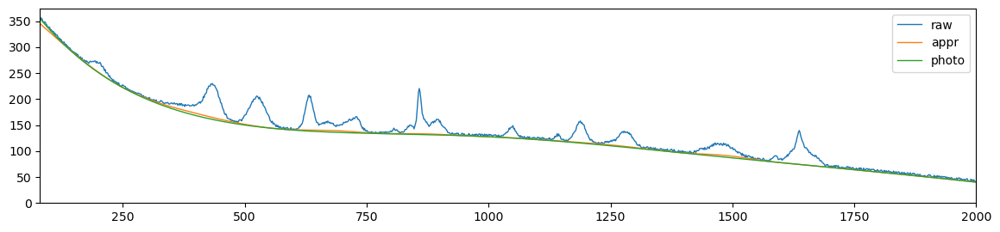

als_lambda: 30.39195382313198,	 als_p_weight: 2.592943797404667e-05,	 error: 147.23925480062238, 	 smoothness: 0.2961898246038954, 	 smoothness: -0.4523869072800549


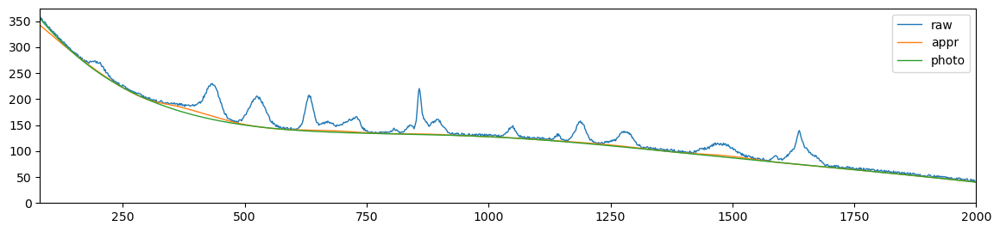

als_lambda: 30.39195382313198,	 als_p_weight: 1.8873918221350995e-05,	 error: 156.3697787689805, 	 smoothness: 0.3048995448844917, 	 smoothness: -0.45846500626249354


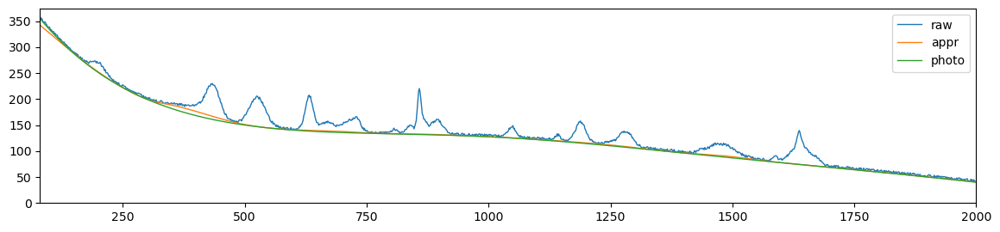

als_lambda: 30.39195382313198,	 als_p_weight: 1.3738237958832637e-05,	 error: 153.86585516123398, 	 smoothness: 0.30133254129406695, 	 smoothness: -0.46000553504968034


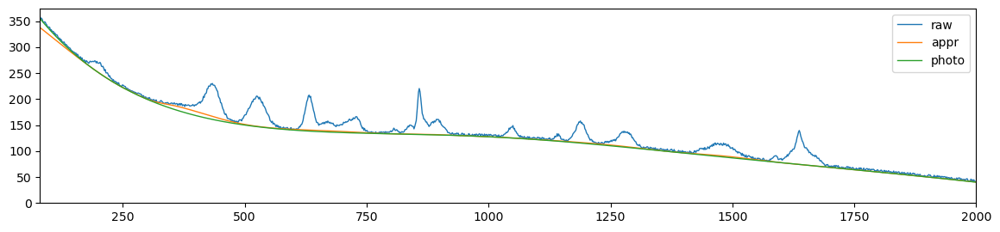

als_lambda: 30.39195382313198,	 als_p_weight: 1e-05,	 error: 160.24712633910283, 	 smoothness: 0.30645868242145763, 	 smoothness: -0.4638863980189349


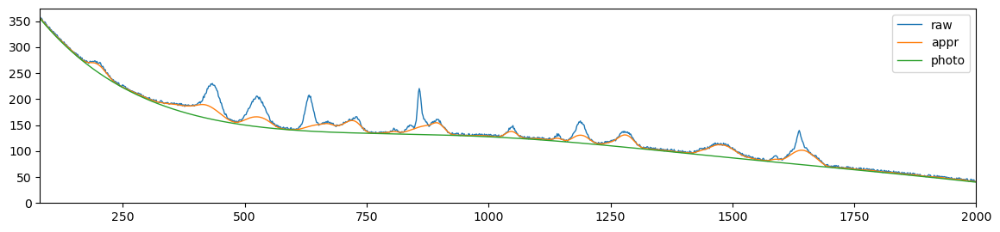

als_lambda: 52.98316906283707,	 als_p_weight: 0.1,	 error: 132.2023324442169, 	 smoothness: 0.24220192734769483, 	 smoothness: 0.2140161804779177


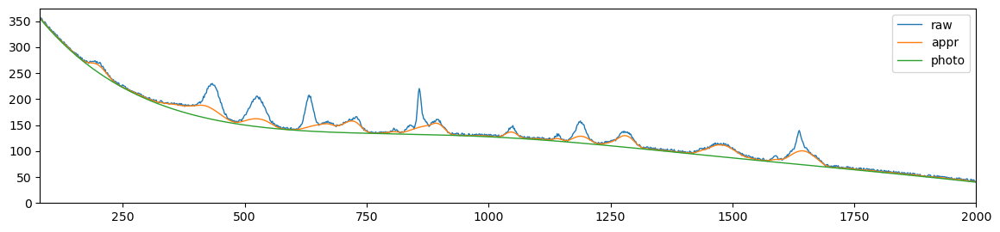

als_lambda: 52.98316906283707,	 als_p_weight: 0.0727895384398315,	 error: 123.34816238999869, 	 smoothness: 0.21391188514591236, 	 smoothness: 0.18193222320628127


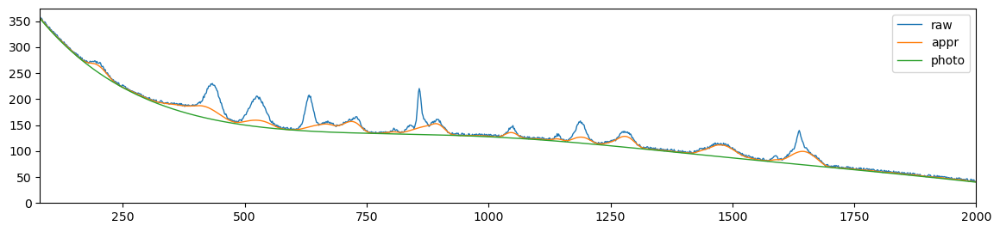

als_lambda: 52.98316906283707,	 als_p_weight: 0.05298316906283707,	 error: 114.93873272940183, 	 smoothness: 0.18821928732167328, 	 smoothness: 0.1517366021356264


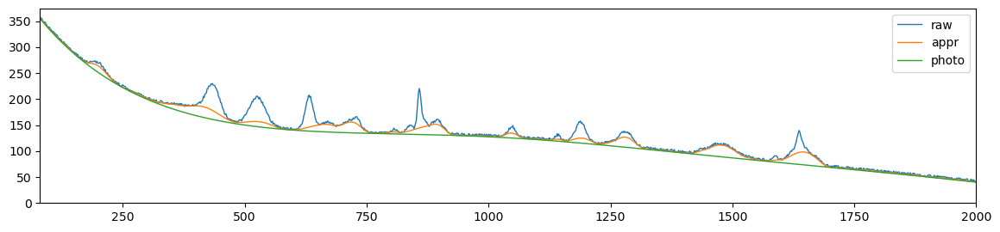

als_lambda: 52.98316906283707,	 als_p_weight: 0.03856620421163472,	 error: 106.88916517025551, 	 smoothness: 0.16503438384332716, 	 smoothness: 0.12332709685210153


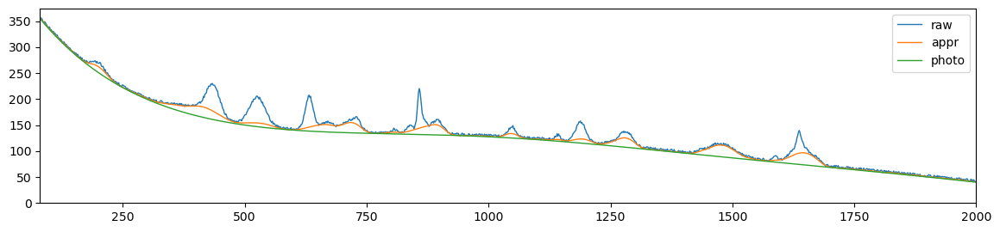

als_lambda: 52.98316906283707,	 als_p_weight: 0.02807216203941177,	 error: 99.27489689653815, 	 smoothness: 0.1444044620360305, 	 smoothness: 0.09686408665376277


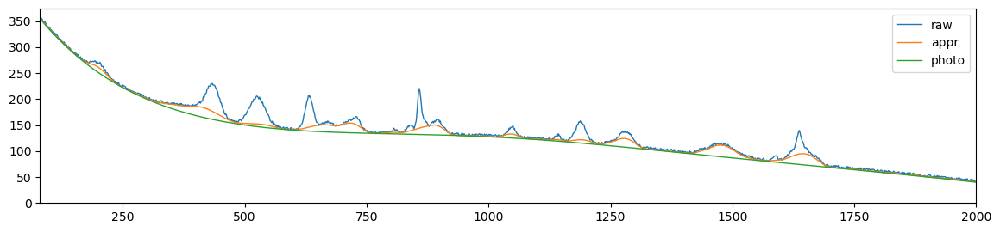

als_lambda: 52.98316906283707,	 als_p_weight: 0.020433597178569417,	 error: 92.10528344201681, 	 smoothness: 0.12627559178717365, 	 smoothness: 0.07176378343733165


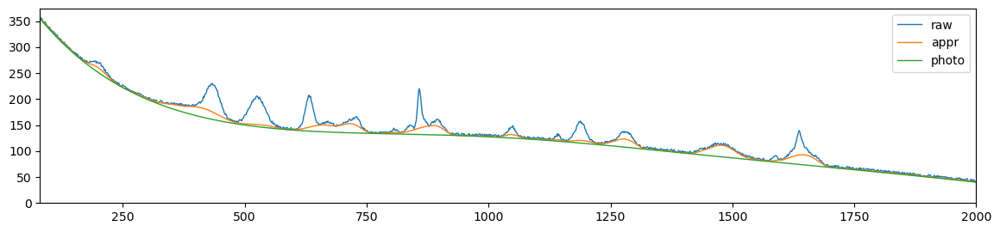

als_lambda: 52.98316906283707,	 als_p_weight: 0.014873521072935119,	 error: 85.44717955930011, 	 smoothness: 0.11068090681106774, 	 smoothness: 0.04783817356768126


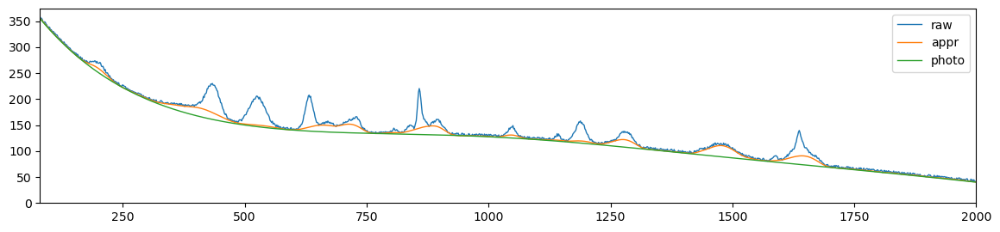

als_lambda: 52.98316906283707,	 als_p_weight: 0.010826367338740546,	 error: 79.15669994909827, 	 smoothness: 0.09731395203548354, 	 smoothness: 0.02468232401666758


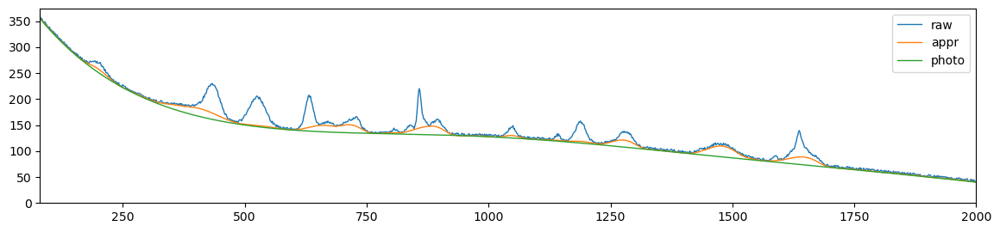

als_lambda: 52.98316906283707,	 als_p_weight: 0.007880462815669913,	 error: 73.20592560315878, 	 smoothness: 0.08611819314860704, 	 smoothness: 0.0023478309604470777


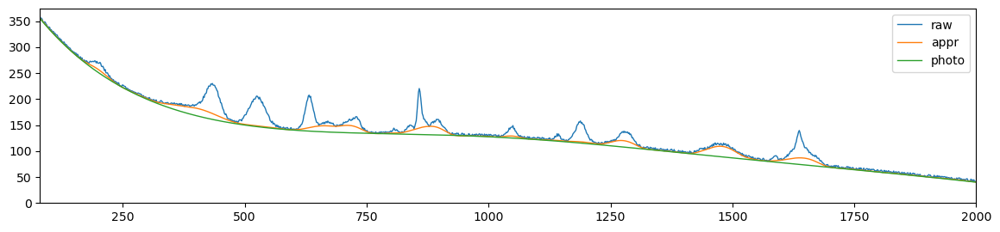

als_lambda: 52.98316906283707,	 als_p_weight: 0.005736152510448681,	 error: 67.70569435246733, 	 smoothness: 0.07709389844038818, 	 smoothness: -0.020102206285289945


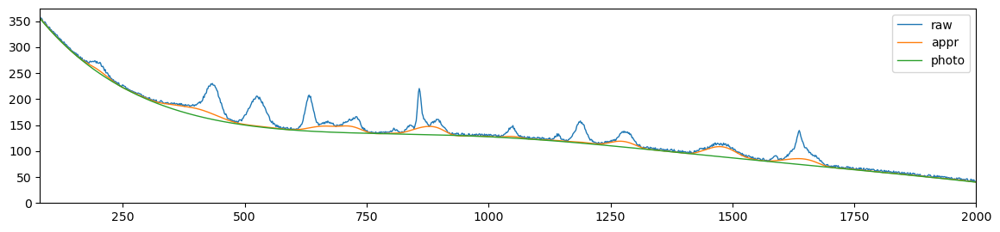

als_lambda: 52.98316906283707,	 als_p_weight: 0.0041753189365604,	 error: 62.58285642276687, 	 smoothness: 0.07013178864189419, 	 smoothness: -0.042284816861829805


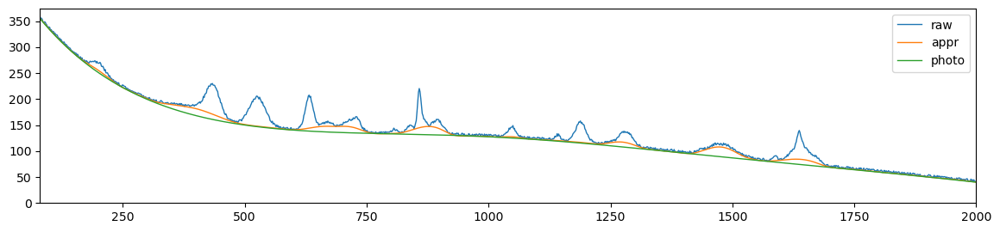

als_lambda: 52.98316906283707,	 als_p_weight: 0.0030391953823131978,	 error: 57.89686403078506, 	 smoothness: 0.06507192763037269, 	 smoothness: -0.06431259826934672


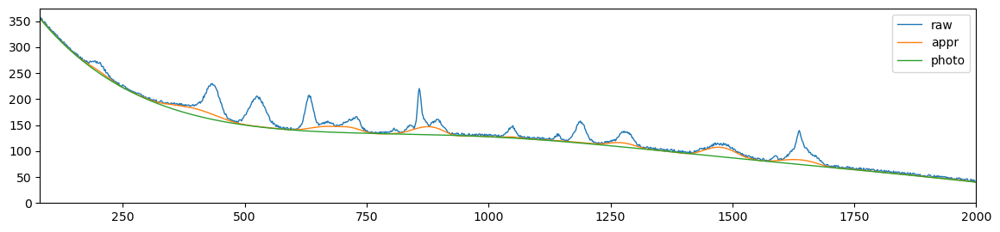

als_lambda: 52.98316906283707,	 als_p_weight: 0.00221221629107045,	 error: 53.584509628302584, 	 smoothness: 0.062016978629957996, 	 smoothness: -0.08756840832922323


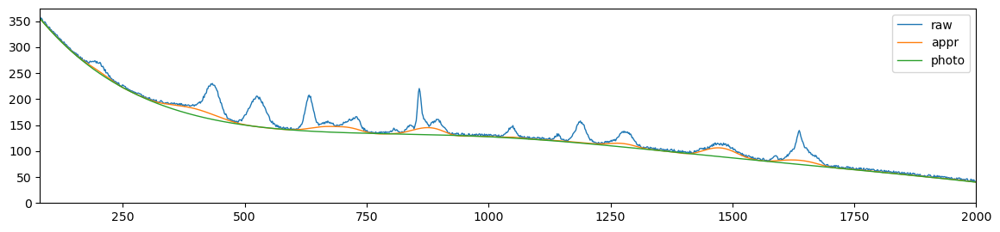

als_lambda: 52.98316906283707,	 als_p_weight: 0.0016102620275609393,	 error: 49.7499421739333, 	 smoothness: 0.06154886535412943, 	 smoothness: -0.11305034011783326


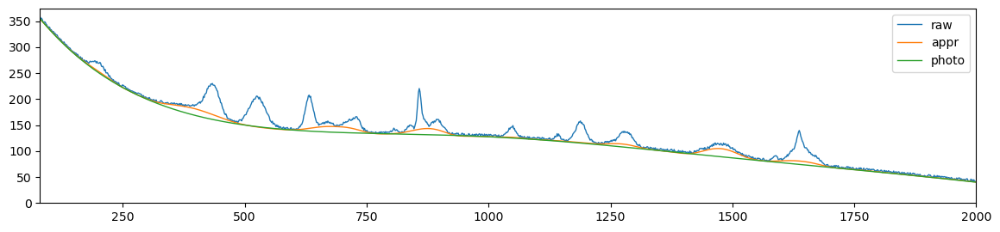

als_lambda: 52.98316906283707,	 als_p_weight: 0.0011721022975334804,	 error: 46.48681538361175, 	 smoothness: 0.06409043761291038, 	 smoothness: -0.14030268373604712


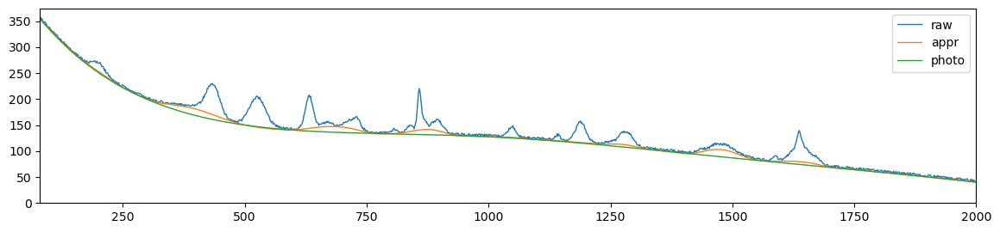

als_lambda: 52.98316906283707,	 als_p_weight: 0.0008531678524172806,	 error: 44.43474126194429, 	 smoothness: 0.0722109098011263, 	 smoothness: -0.17290027524932075


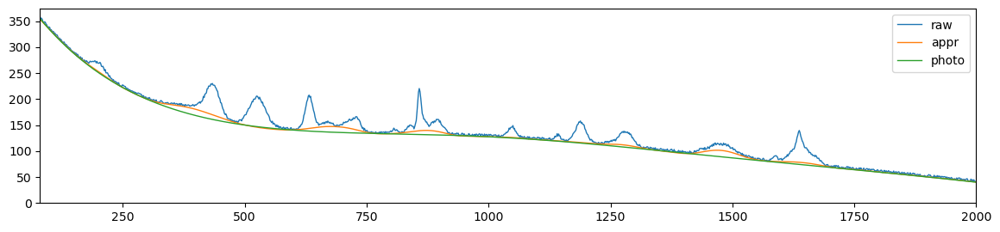

als_lambda: 52.98316906283707,	 als_p_weight: 0.0006210169418915617,	 error: 50.94093283402348, 	 smoothness: 0.09988952377047079, 	 smoothness: -0.21982611553379097


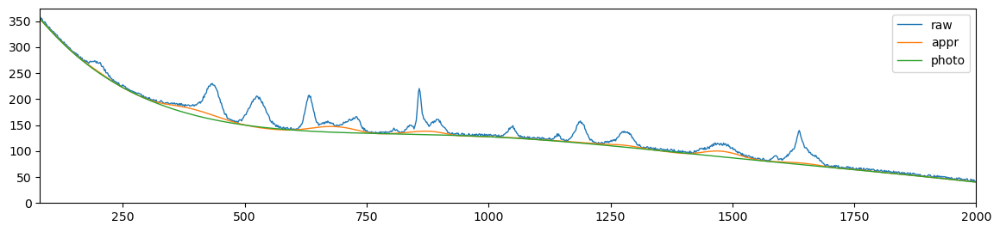

als_lambda: 52.98316906283707,	 als_p_weight: 0.00045203536563602454,	 error: 78.89420384982685, 	 smoothness: 0.16434273315210876, 	 smoothness: -0.2813503678812202


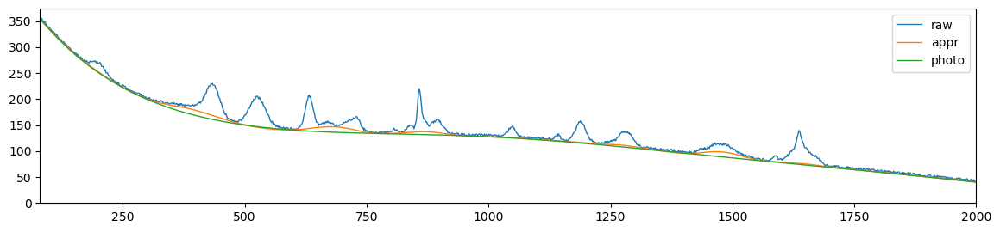

als_lambda: 52.98316906283707,	 als_p_weight: 0.00032903445623126676,	 error: 102.26112880753861, 	 smoothness: 0.21226682104070363, 	 smoothness: -0.32916590637338616


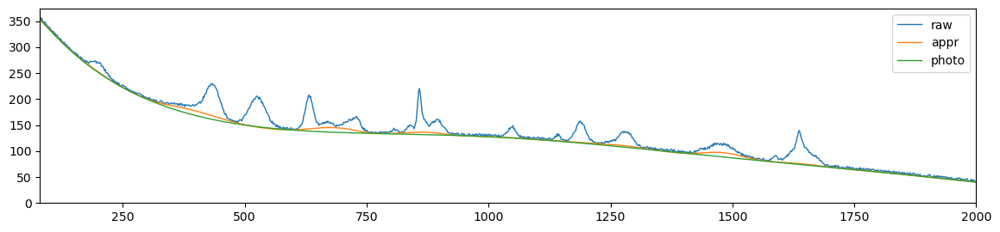

als_lambda: 52.98316906283707,	 als_p_weight: 0.0002395026619987486,	 error: 125.3672494880008, 	 smoothness: 0.25601712593175757, 	 smoothness: -0.3755072056275026


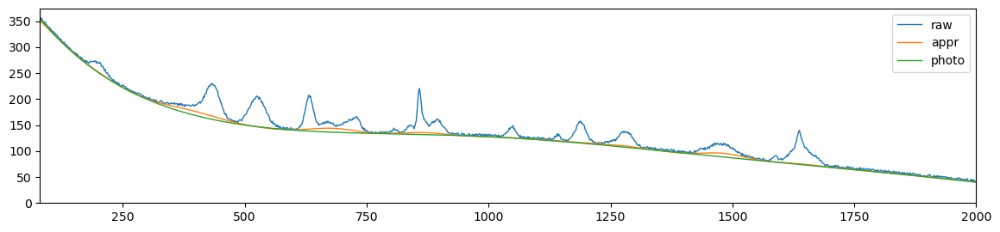

als_lambda: 52.98316906283707,	 als_p_weight: 0.00017433288221999874,	 error: 135.5645121976678, 	 smoothness: 0.27525118478453997, 	 smoothness: -0.4009943513286608


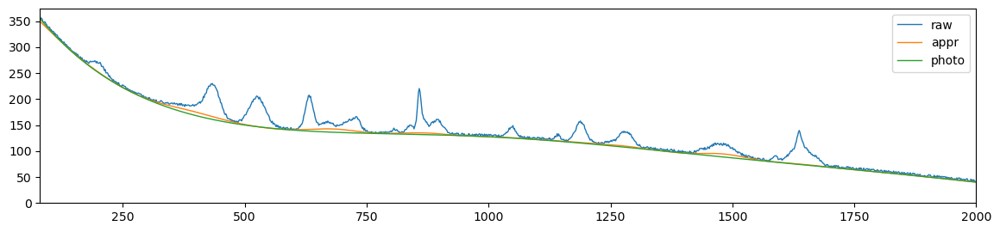

als_lambda: 52.98316906283707,	 als_p_weight: 0.0001268961003167922,	 error: 153.8283314601472, 	 smoothness: 0.3002465909802694, 	 smoothness: -0.4296882182184176


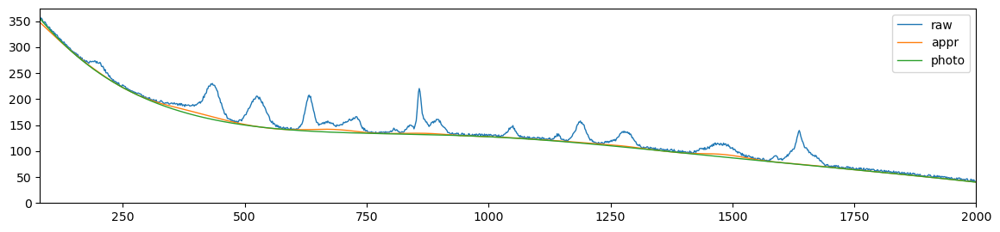

als_lambda: 52.98316906283707,	 als_p_weight: 9.236708571873866e-05,	 error: 164.6399583061795, 	 smoothness: 0.3126672431770205, 	 smoothness: -0.446461736209416


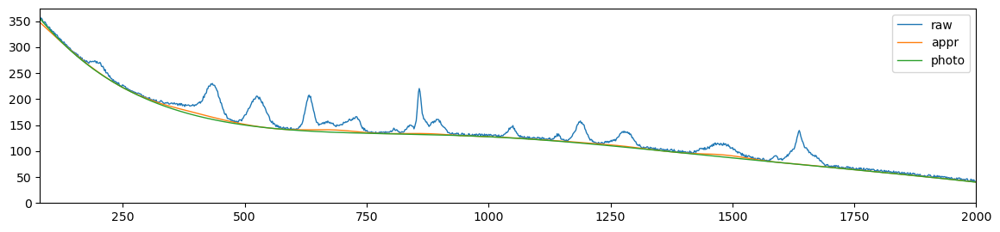

als_lambda: 52.98316906283707,	 als_p_weight: 6.723357536499335e-05,	 error: 169.37060734945027, 	 smoothness: 0.3184491303713984, 	 smoothness: -0.4553093417880946


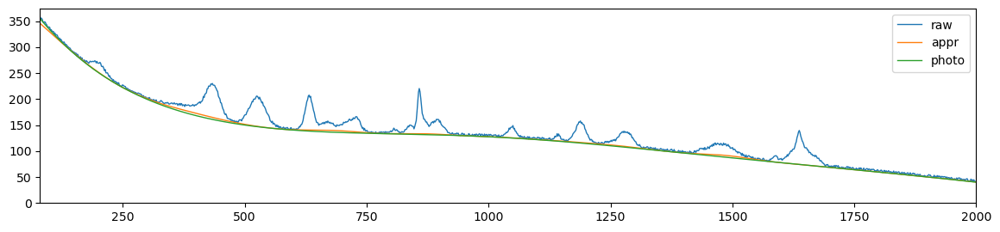

als_lambda: 52.98316906283707,	 als_p_weight: 4.893900918477499e-05,	 error: 180.58640587558463, 	 smoothness: 0.3285720914251563, 	 smoothness: -0.46465519713622766


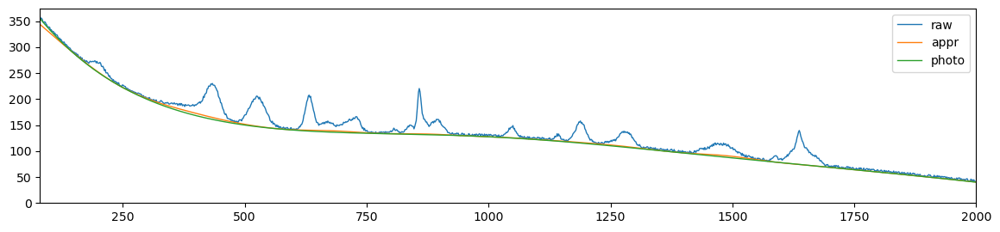

als_lambda: 52.98316906283707,	 als_p_weight: 3.5622478902624444e-05,	 error: 179.46896735290548, 	 smoothness: 0.32594589193632295, 	 smoothness: -0.4670052216937086


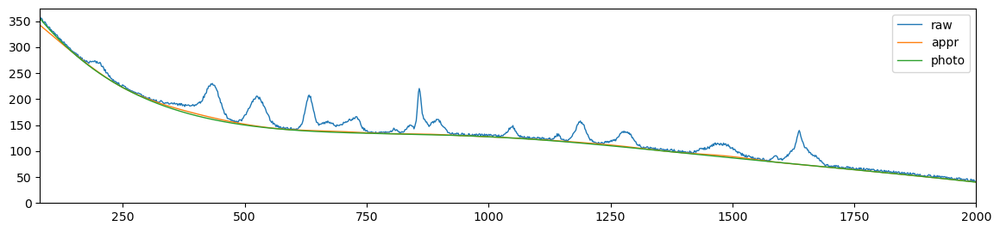

als_lambda: 52.98316906283707,	 als_p_weight: 2.592943797404667e-05,	 error: 178.06160379312948, 	 smoothness: 0.32360749412705614, 	 smoothness: -0.46964609479013847


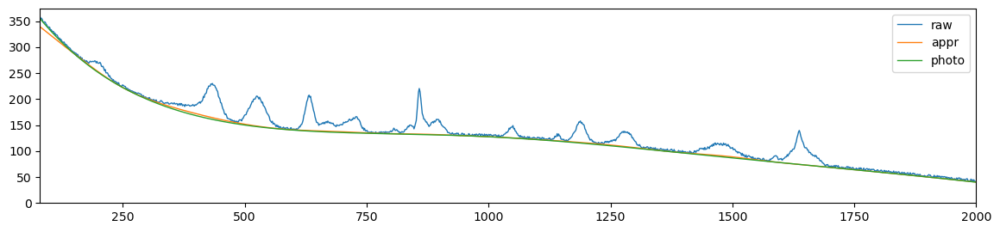

als_lambda: 52.98316906283707,	 als_p_weight: 1.8873918221350995e-05,	 error: 179.70291807014678, 	 smoothness: 0.32332021950405876, 	 smoothness: -0.4710833774615611


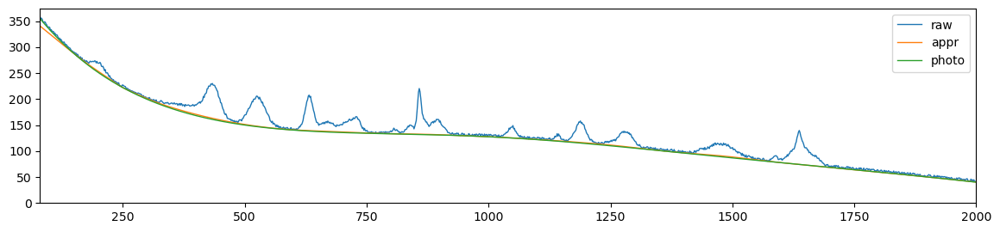

als_lambda: 52.98316906283707,	 als_p_weight: 1.3738237958832637e-05,	 error: 184.88883224651067, 	 smoothness: 0.3273077910894722, 	 smoothness: -0.4742266323790645


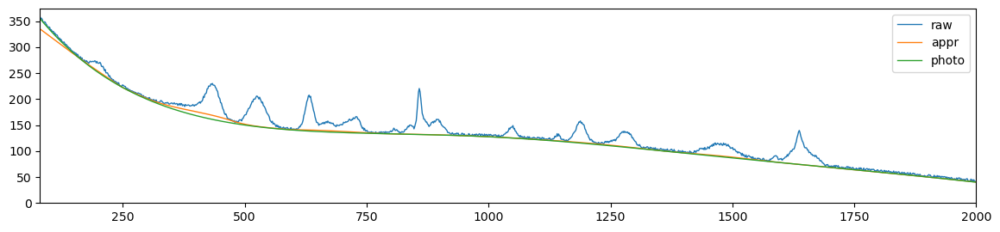

als_lambda: 52.98316906283707,	 als_p_weight: 1e-05,	 error: 186.93892708656776, 	 smoothness: 0.328584340713559, 	 smoothness: -0.4734172550327534


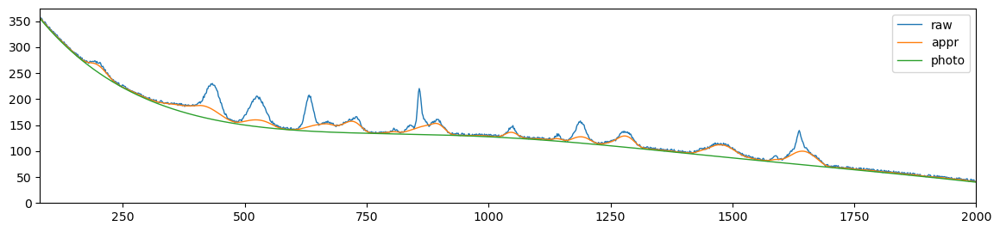

als_lambda: 92.36708571873865,	 als_p_weight: 0.1,	 error: 121.20224057211428, 	 smoothness: 0.19049381470732812, 	 smoothness: 0.15468962555911586


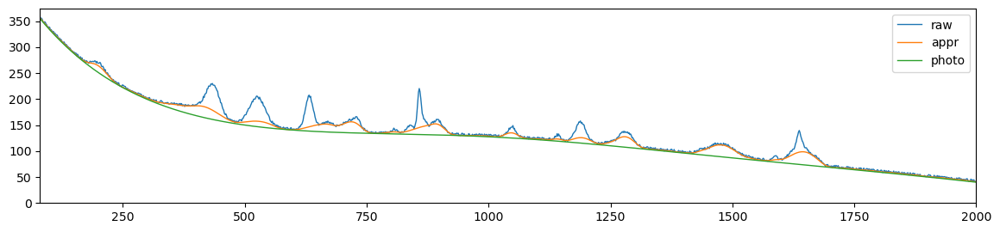

als_lambda: 92.36708571873865,	 als_p_weight: 0.0727895384398315,	 error: 112.53705709329599, 	 smoothness: 0.16757886652970136, 	 smoothness: 0.12664191465854244


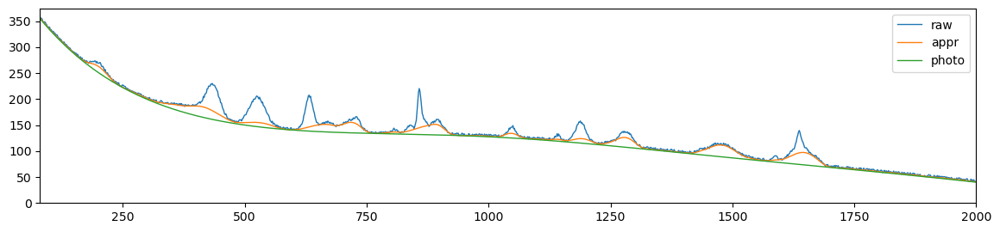

als_lambda: 92.36708571873865,	 als_p_weight: 0.05298316906283707,	 error: 104.35525593328579, 	 smoothness: 0.1470026001219216, 	 smoothness: 0.10023299666013182


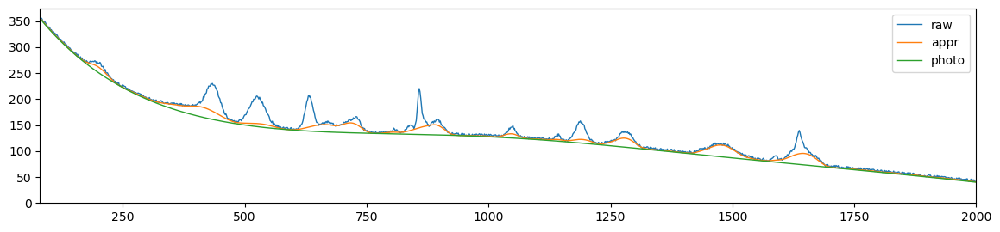

als_lambda: 92.36708571873865,	 als_p_weight: 0.03856620421163472,	 error: 96.67143426058264, 	 smoothness: 0.12878136043564667, 	 smoothness: 0.0751843403838956


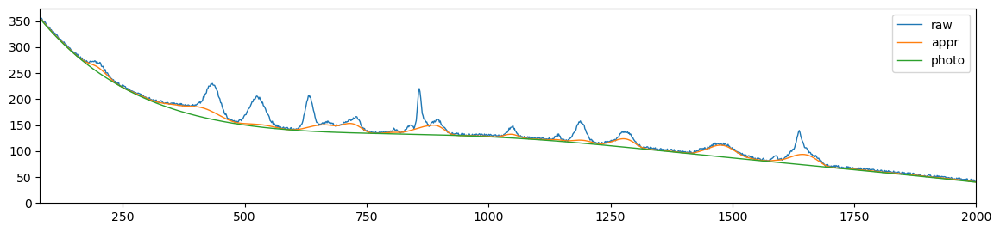

als_lambda: 92.36708571873865,	 als_p_weight: 0.02807216203941177,	 error: 89.53530399258896, 	 smoothness: 0.11302095213608006, 	 smoothness: 0.05147738357461951


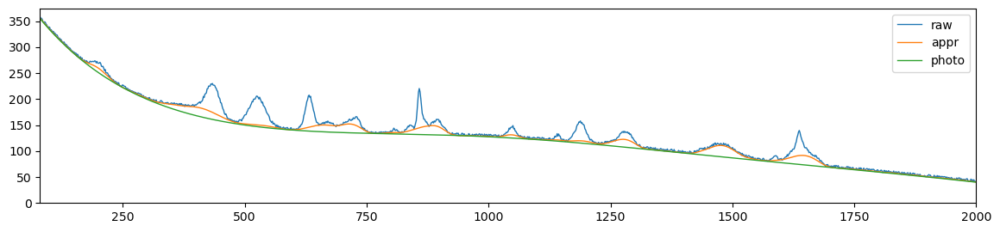

als_lambda: 92.36708571873865,	 als_p_weight: 0.020433597178569417,	 error: 82.87143712260819, 	 smoothness: 0.09951264492601254, 	 smoothness: 0.028746457963880104


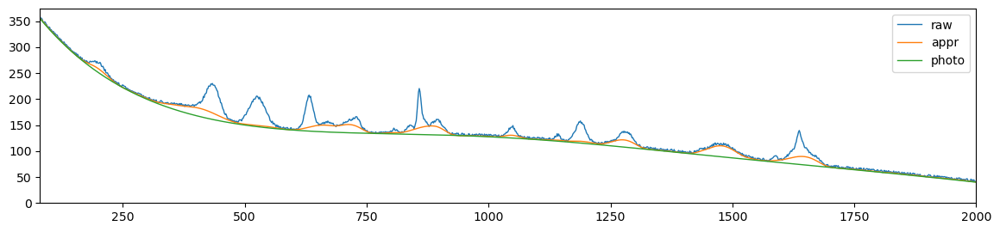

als_lambda: 92.36708571873865,	 als_p_weight: 0.014873521072935119,	 error: 76.53112383030776, 	 smoothness: 0.08798726539061985, 	 smoothness: 0.006559052534955188


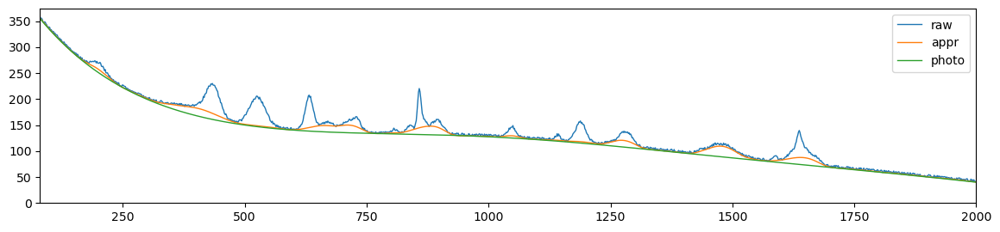

als_lambda: 92.36708571873865,	 als_p_weight: 0.010826367338740546,	 error: 70.65960500764736, 	 smoothness: 0.07862373886328256, 	 smoothness: -0.015582869435913502


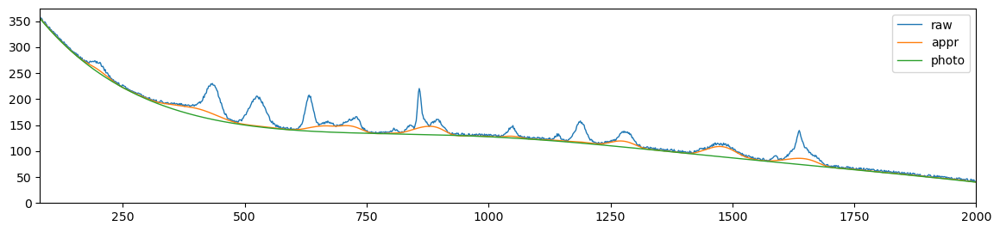

als_lambda: 92.36708571873865,	 als_p_weight: 0.007880462815669913,	 error: 65.2225410828159, 	 smoothness: 0.07130172995009226, 	 smoothness: -0.03755596366218059


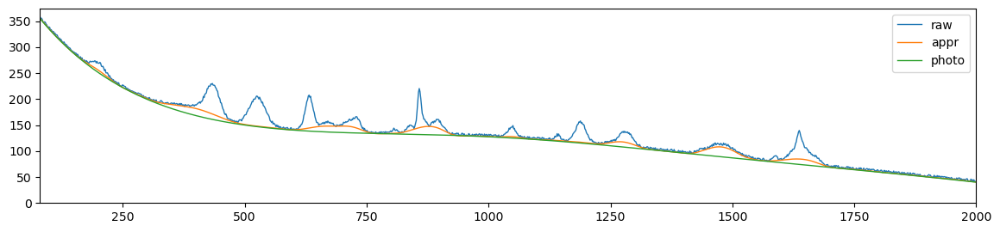

als_lambda: 92.36708571873865,	 als_p_weight: 0.005736152510448681,	 error: 60.15759342866382, 	 smoothness: 0.06580985437734016, 	 smoothness: -0.059491633869343905


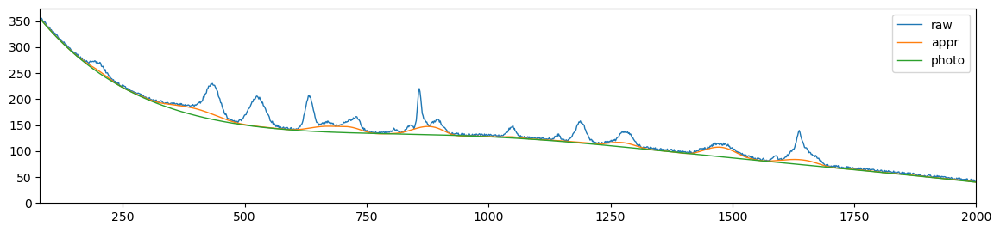

als_lambda: 92.36708571873865,	 als_p_weight: 0.0041753189365604,	 error: 55.58656084321453, 	 smoothness: 0.06235752573734011, 	 smoothness: -0.08208121583238662


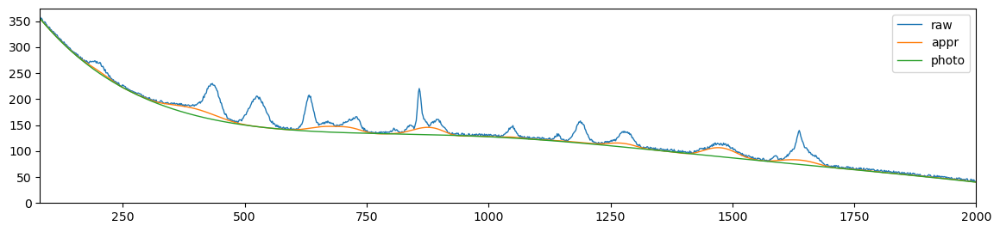

als_lambda: 92.36708571873865,	 als_p_weight: 0.0030391953823131978,	 error: 51.44942020349901, 	 smoothness: 0.06118271973224601, 	 smoothness: -0.10673581763917035


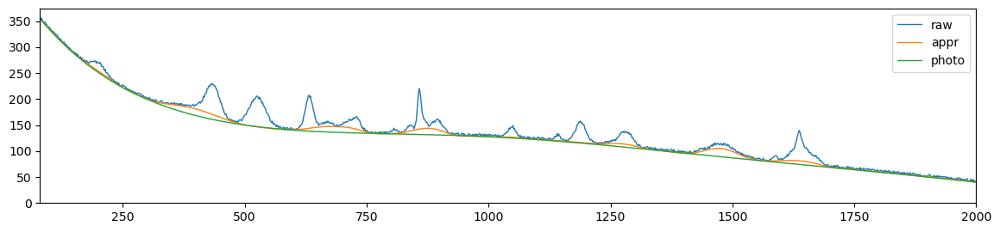

als_lambda: 92.36708571873865,	 als_p_weight: 0.00221221629107045,	 error: 47.87948731674881, 	 smoothness: 0.06296490524497889, 	 smoothness: -0.13340456642327397


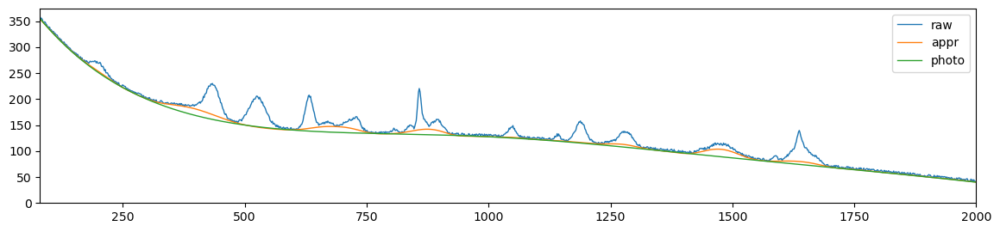

als_lambda: 92.36708571873865,	 als_p_weight: 0.0016102620275609393,	 error: 45.24462838540898, 	 smoothness: 0.06925169129100434, 	 smoothness: -0.16427375083028076


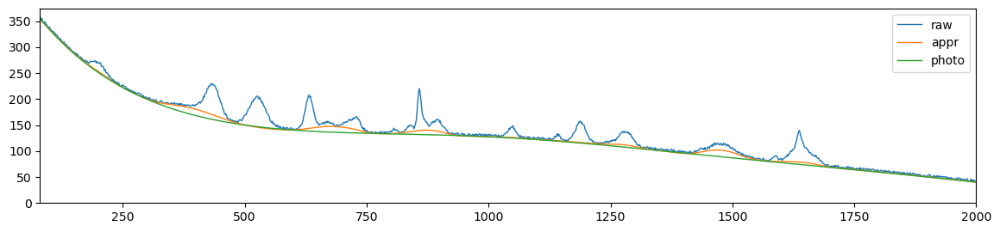

als_lambda: 92.36708571873865,	 als_p_weight: 0.0011721022975334804,	 error: 49.985958304386514, 	 smoothness: 0.09326942626347495, 	 smoothness: -0.2085127305265574


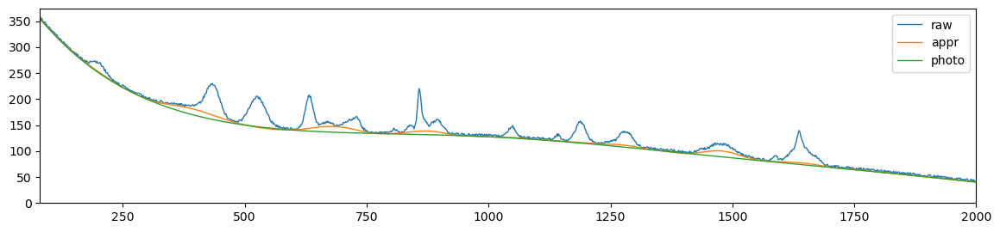

als_lambda: 92.36708571873865,	 als_p_weight: 0.0008531678524172806,	 error: 77.72483009661008, 	 smoothness: 0.15861551022673576, 	 smoothness: -0.2721827978883348


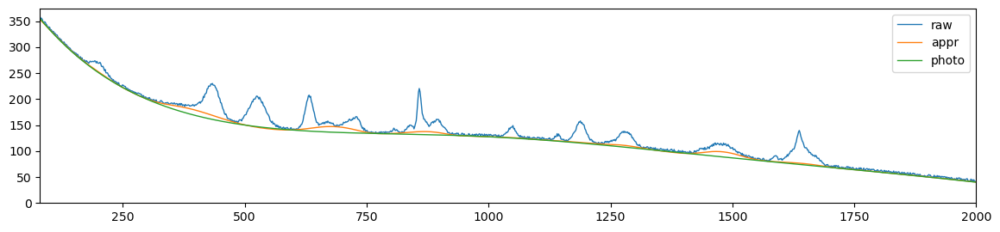

als_lambda: 92.36708571873865,	 als_p_weight: 0.0006210169418915617,	 error: 101.92218303045827, 	 smoothness: 0.20726775733387257, 	 smoothness: -0.31931453698811774


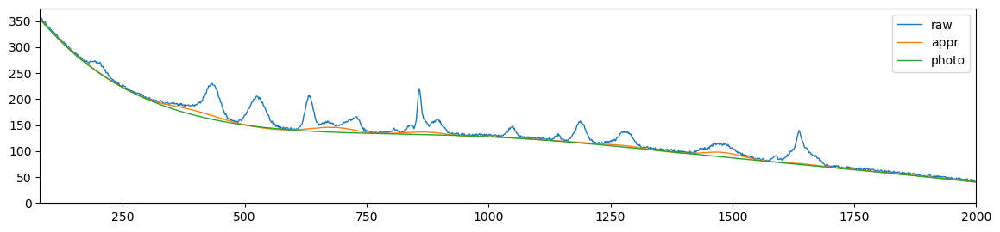

als_lambda: 92.36708571873865,	 als_p_weight: 0.00045203536563602454,	 error: 128.7318810394855, 	 smoothness: 0.25674706416928983, 	 smoothness: -0.36829166603226143


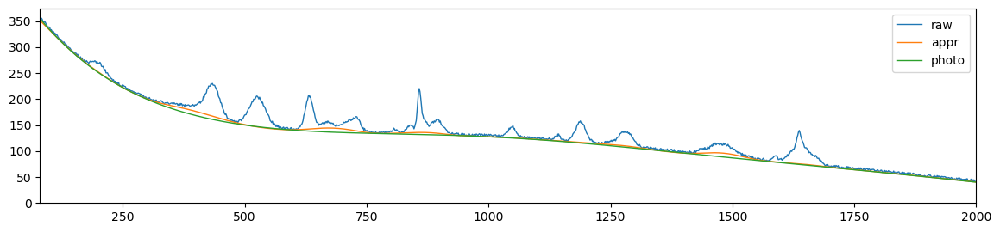

als_lambda: 92.36708571873865,	 als_p_weight: 0.00032903445623126676,	 error: 151.41009664722822, 	 smoothness: 0.29083139803668506, 	 smoothness: -0.4012190386674749


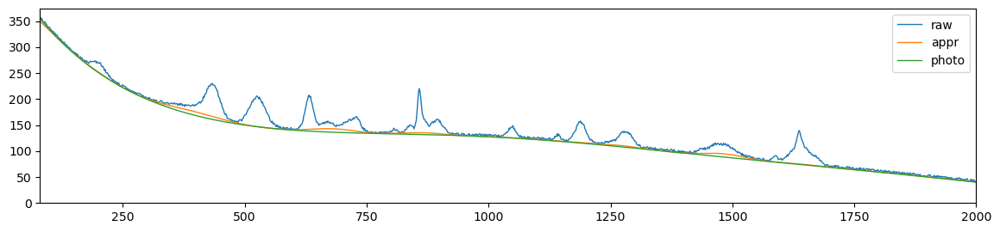

als_lambda: 92.36708571873865,	 als_p_weight: 0.0002395026619987486,	 error: 163.80960188061115, 	 smoothness: 0.3100720211351604, 	 smoothness: -0.42898990687366756


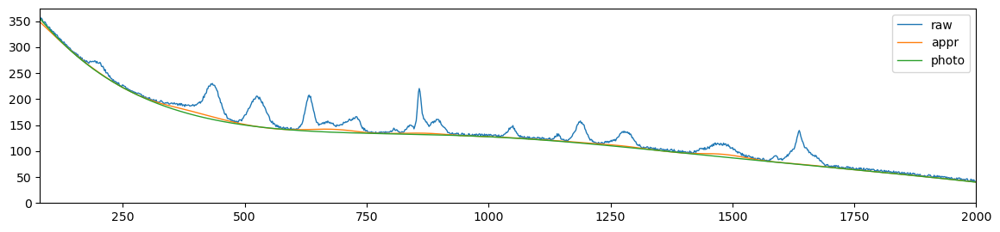

als_lambda: 92.36708571873865,	 als_p_weight: 0.00017433288221999874,	 error: 179.20671281783, 	 smoothness: 0.32762835678621516, 	 smoothness: -0.4503673967932526


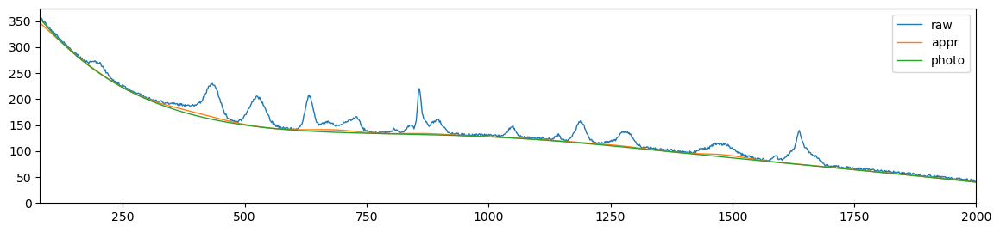

als_lambda: 92.36708571873865,	 als_p_weight: 0.0001268961003167922,	 error: 189.17662259228794, 	 smoothness: 0.3372251299954439, 	 smoothness: -0.46176954181992746


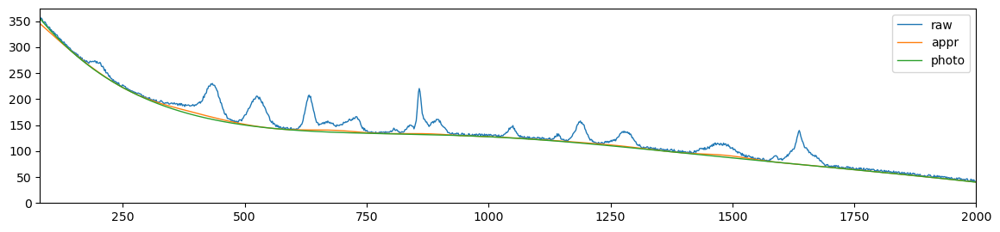

als_lambda: 92.36708571873865,	 als_p_weight: 9.236708571873866e-05,	 error: 198.4992923956771, 	 smoothness: 0.3431735686094564, 	 smoothness: -0.4718342117937195


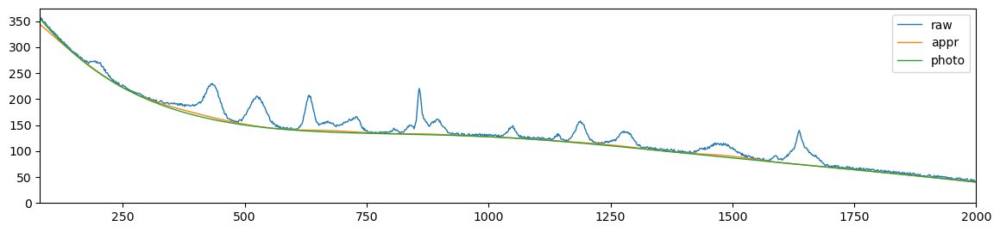

als_lambda: 92.36708571873865,	 als_p_weight: 6.723357536499335e-05,	 error: 206.56599278928715, 	 smoothness: 0.3488738902524782, 	 smoothness: -0.47852335986099737


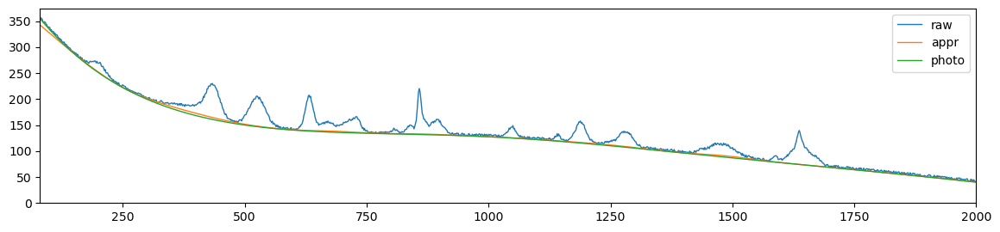

als_lambda: 92.36708571873865,	 als_p_weight: 4.893900918477499e-05,	 error: 207.92068048689362, 	 smoothness: 0.34876108749475626, 	 smoothness: -0.4815323822586793


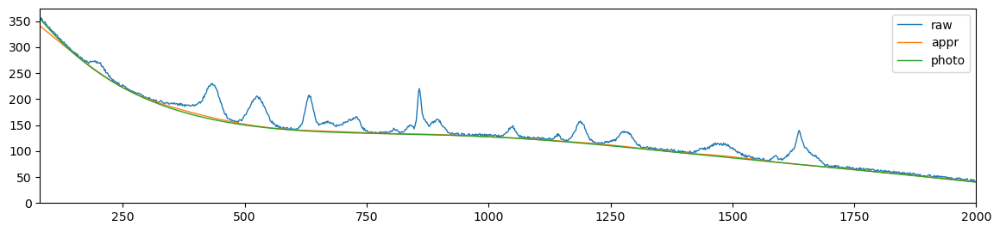

als_lambda: 92.36708571873865,	 als_p_weight: 3.5622478902624444e-05,	 error: 215.60242071580498, 	 smoothness: 0.35268273447364146, 	 smoothness: -0.48461202919830404


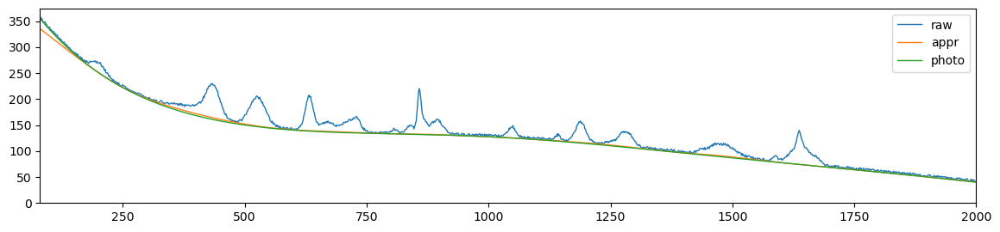

als_lambda: 92.36708571873865,	 als_p_weight: 2.592943797404667e-05,	 error: 226.02591572120176, 	 smoothness: 0.35776078545440976, 	 smoothness: -0.4891309947181731


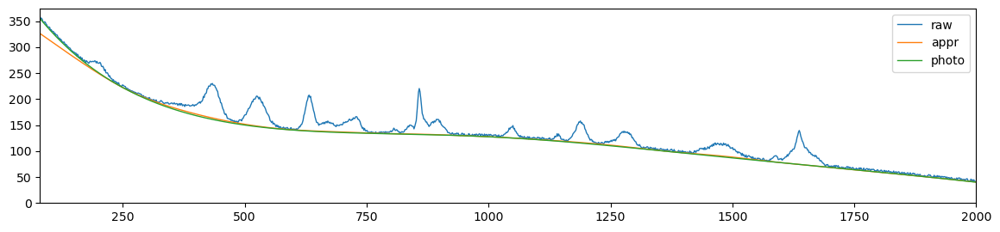

als_lambda: 92.36708571873865,	 als_p_weight: 1.8873918221350995e-05,	 error: 232.8974887463967, 	 smoothness: 0.36159355392208065, 	 smoothness: -0.49160045029822186


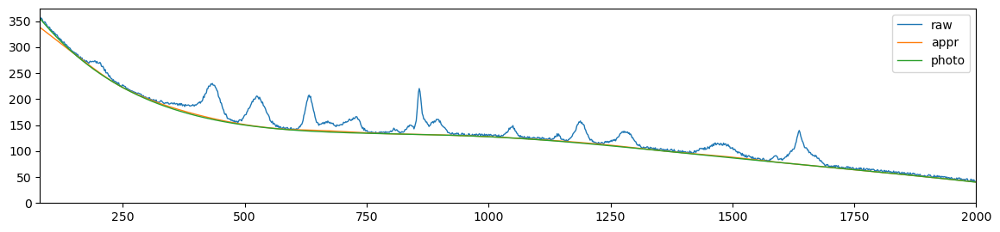

als_lambda: 92.36708571873865,	 als_p_weight: 1.3738237958832637e-05,	 error: 239.27643946204665, 	 smoothness: 0.3666808020002638, 	 smoothness: -0.49220888319235506


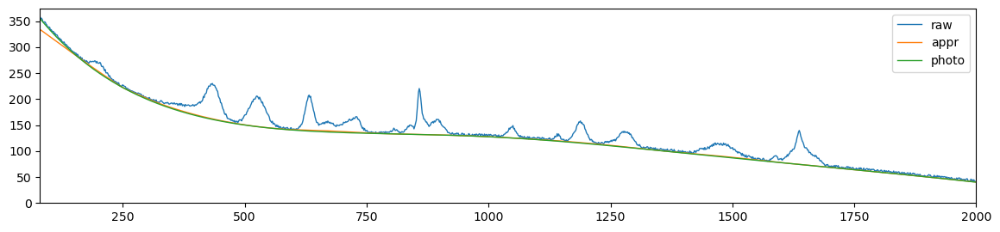

als_lambda: 92.36708571873865,	 als_p_weight: 1e-05,	 error: 237.8600194854941, 	 smoothness: 0.3621683875851875, 	 smoothness: -0.4920987709028966


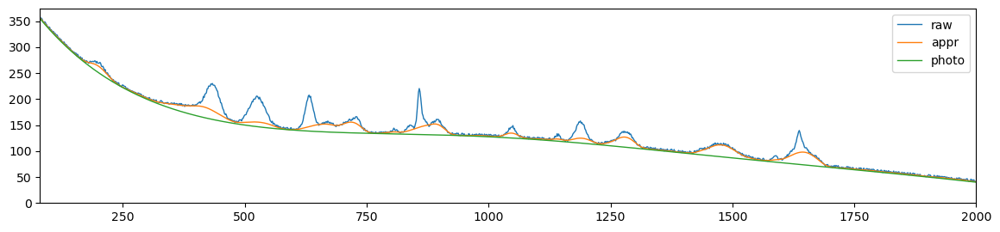

als_lambda: 161.02620275609394,	 als_p_weight: 0.1,	 error: 110.84792077561748, 	 smoothness: 0.1489834261096103, 	 smoothness: 0.10262738195204786


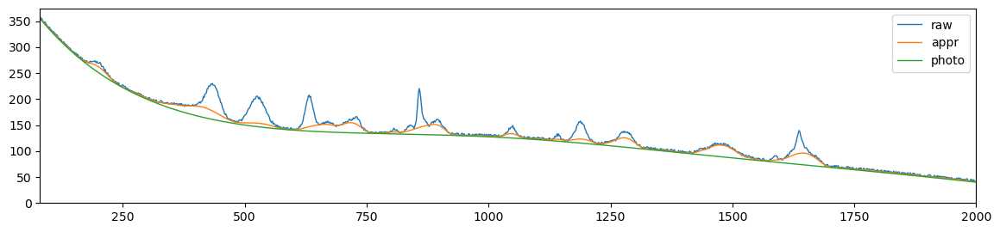

als_lambda: 161.02620275609394,	 als_p_weight: 0.0727895384398315,	 error: 102.45249555571772, 	 smoothness: 0.13089213216646228, 	 smoothness: 0.07800274088408235


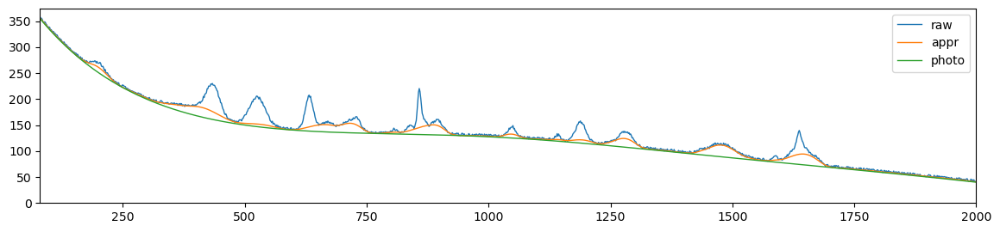

als_lambda: 161.02620275609394,	 als_p_weight: 0.05298316906283707,	 error: 94.67718348496041, 	 smoothness: 0.11506967157144694, 	 smoothness: 0.05453769770901665


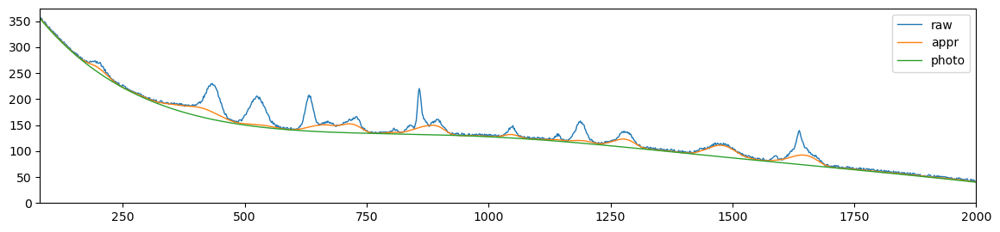

als_lambda: 161.02620275609394,	 als_p_weight: 0.03856620421163472,	 error: 87.4950849621848, 	 smoothness: 0.10150838275435944, 	 smoothness: 0.0322236957240448


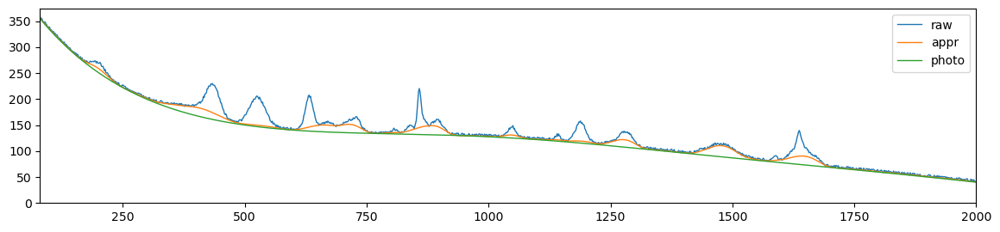

als_lambda: 161.02620275609394,	 als_p_weight: 0.02807216203941177,	 error: 80.73515318453885, 	 smoothness: 0.08989432581317214, 	 smoothness: 0.010317204746243596


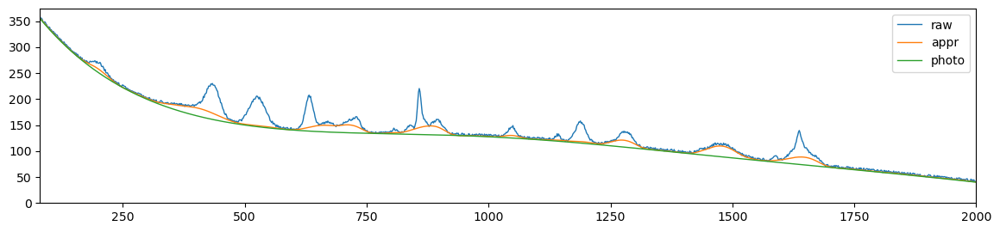

als_lambda: 161.02620275609394,	 als_p_weight: 0.020433597178569417,	 error: 74.38085891505641, 	 smoothness: 0.08017238846114033, 	 smoothness: -0.011324521286803509


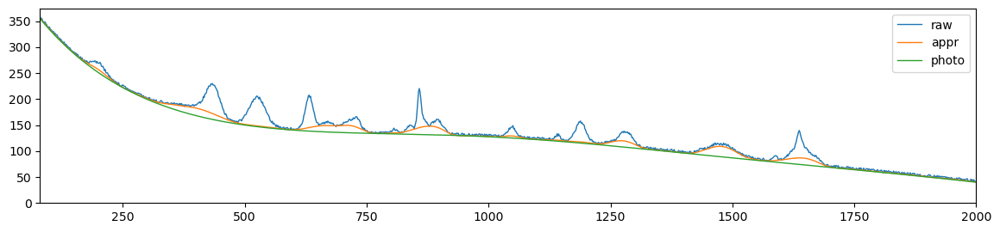

als_lambda: 161.02620275609394,	 als_p_weight: 0.014873521072935119,	 error: 68.53609670451746, 	 smoothness: 0.07249876017929542, 	 smoothness: -0.03304058928162303


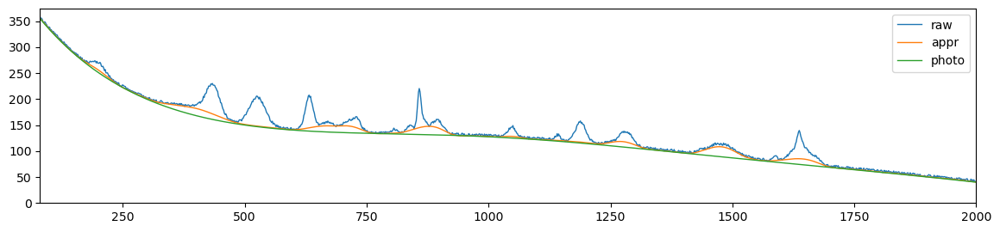

als_lambda: 161.02620275609394,	 als_p_weight: 0.010826367338740546,	 error: 63.073323872122394, 	 smoothness: 0.06666213612472668, 	 smoothness: -0.054889122599916546


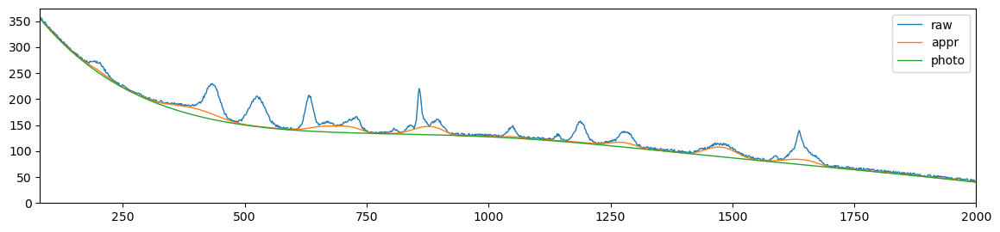

als_lambda: 161.02620275609394,	 als_p_weight: 0.007880462815669913,	 error: 58.117221007776806, 	 smoothness: 0.06273417615373318, 	 smoothness: -0.07697394297329355


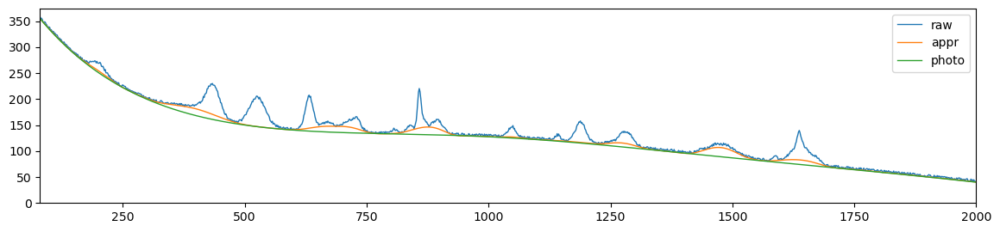

als_lambda: 161.02620275609394,	 als_p_weight: 0.005736152510448681,	 error: 53.62469071640598, 	 smoothness: 0.06099313099376026, 	 smoothness: -0.10090391240851668


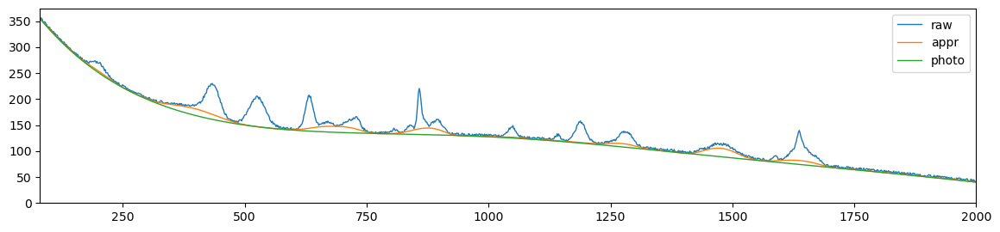

als_lambda: 161.02620275609394,	 als_p_weight: 0.0041753189365604,	 error: 49.70546864262623, 	 smoothness: 0.062007216649006575, 	 smoothness: -0.12688280455926443


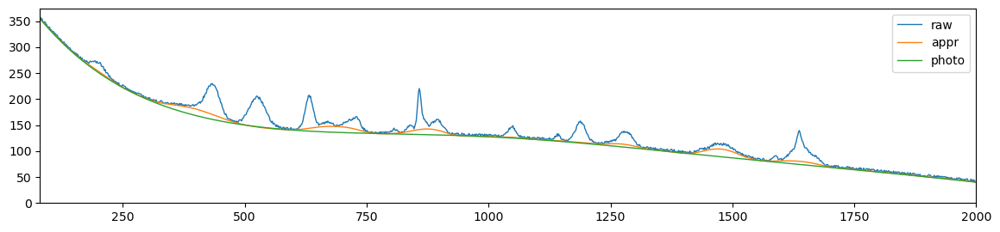

als_lambda: 161.02620275609394,	 als_p_weight: 0.0030391953823131978,	 error: 46.5441126292575, 	 smoothness: 0.06675751124098103, 	 smoothness: -0.15611857917444727


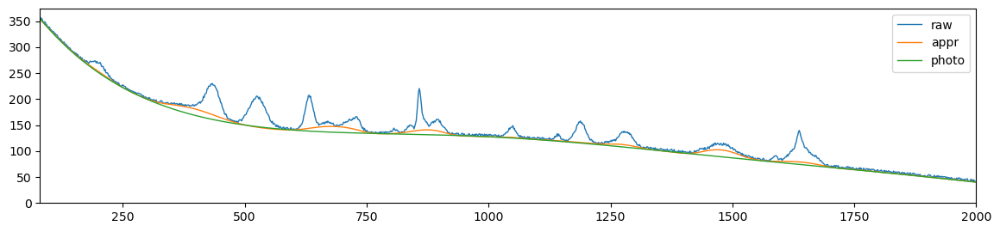

als_lambda: 161.02620275609394,	 als_p_weight: 0.00221221629107045,	 error: 47.88503593476756, 	 smoothness: 0.08421080929733192, 	 smoothness: -0.19579979888130847


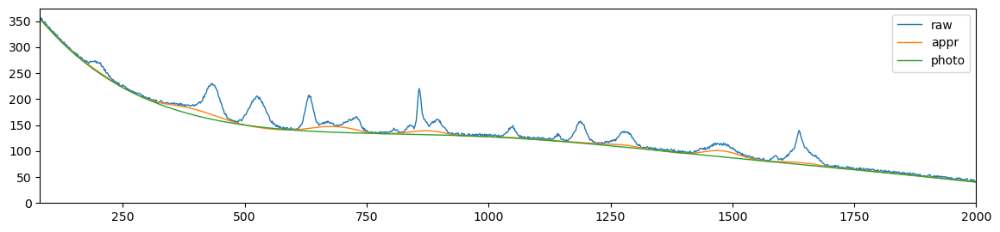

als_lambda: 161.02620275609394,	 als_p_weight: 0.0016102620275609393,	 error: 68.01715610404052, 	 smoothness: 0.13898590879712241, 	 smoothness: -0.25708454515867607


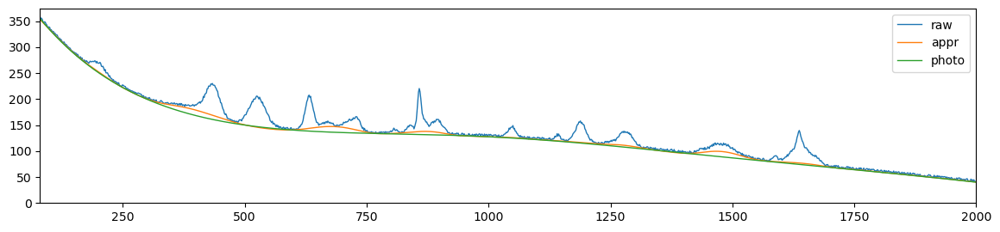

als_lambda: 161.02620275609394,	 als_p_weight: 0.0011721022975334804,	 error: 98.49835933340273, 	 smoothness: 0.1985133024757194, 	 smoothness: -0.30903123122678144


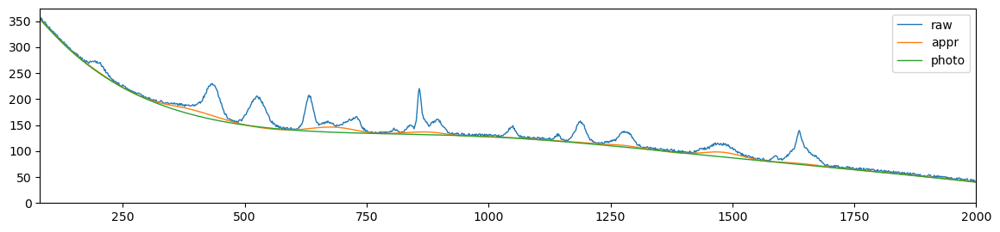

als_lambda: 161.02620275609394,	 als_p_weight: 0.0008531678524172806,	 error: 127.98675303855866, 	 smoothness: 0.2519137794515436, 	 smoothness: -0.35986407893210687


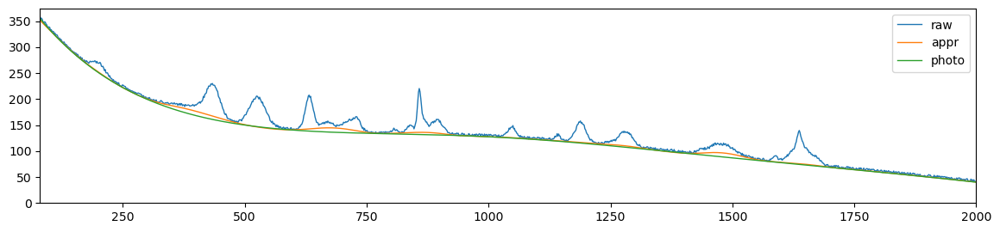

als_lambda: 161.02620275609394,	 als_p_weight: 0.0006210169418915617,	 error: 153.2197687358327, 	 smoothness: 0.2902655405145138, 	 smoothness: -0.39672883531809744


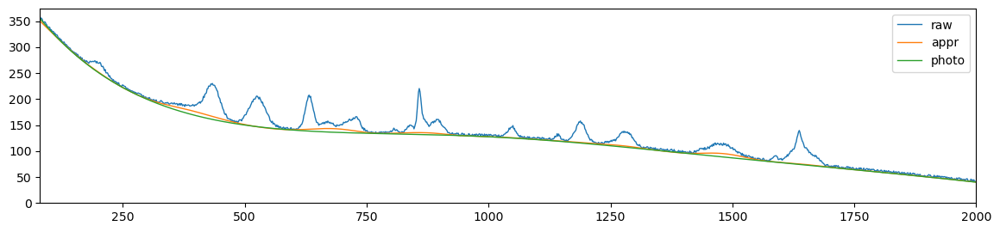

als_lambda: 161.02620275609394,	 als_p_weight: 0.00045203536563602454,	 error: 167.36192997172654, 	 smoothness: 0.3107370353603803, 	 smoothness: -0.4245124028756832


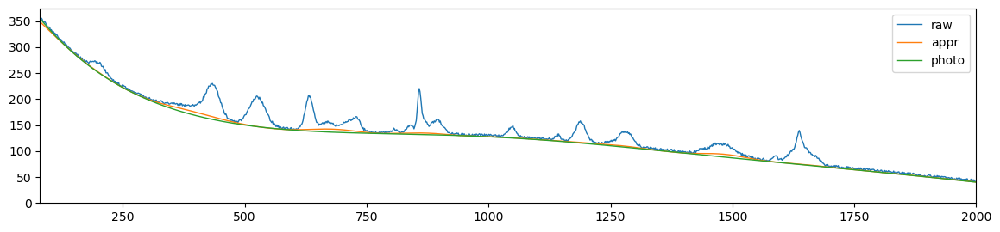

als_lambda: 161.02620275609394,	 als_p_weight: 0.00032903445623126676,	 error: 190.69853921118306, 	 smoothness: 0.3365466344942332, 	 smoothness: -0.45130487693359655


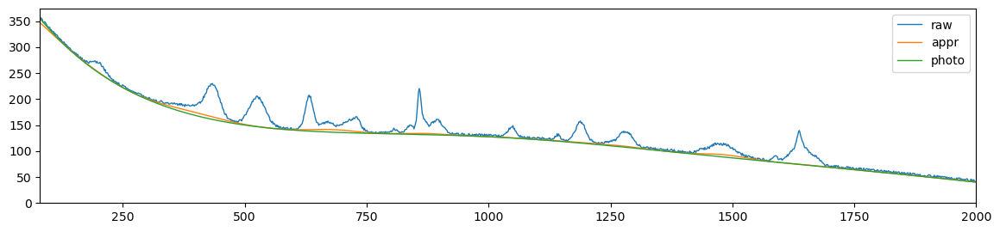

als_lambda: 161.02620275609394,	 als_p_weight: 0.0002395026619987486,	 error: 203.641676821998, 	 smoothness: 0.34781196963618577, 	 smoothness: -0.4647566261674929


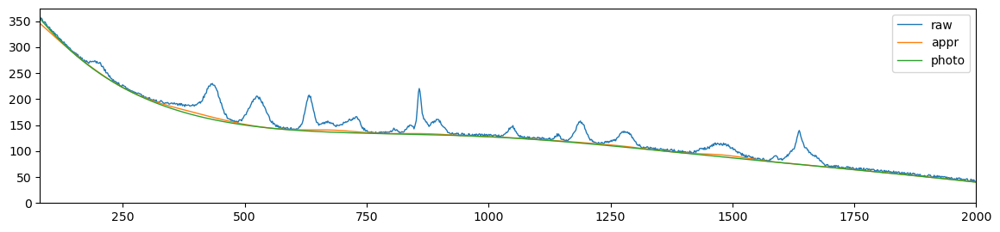

als_lambda: 161.02620275609394,	 als_p_weight: 0.00017433288221999874,	 error: 210.29854858776372, 	 smoothness: 0.3535584673438932, 	 smoothness: -0.47339309858760875


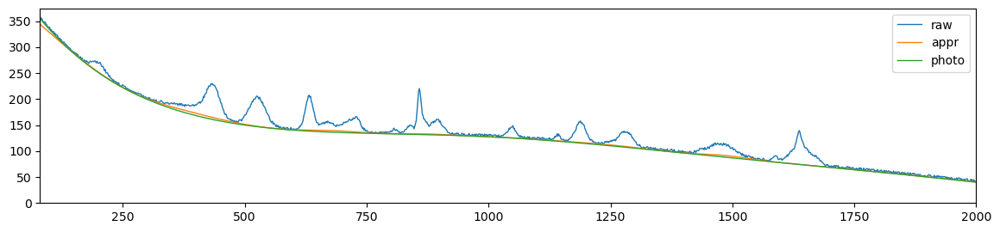

als_lambda: 161.02620275609394,	 als_p_weight: 0.0001268961003167922,	 error: 217.09764467124708, 	 smoothness: 0.35734840809667995, 	 smoothness: -0.48048944826974954


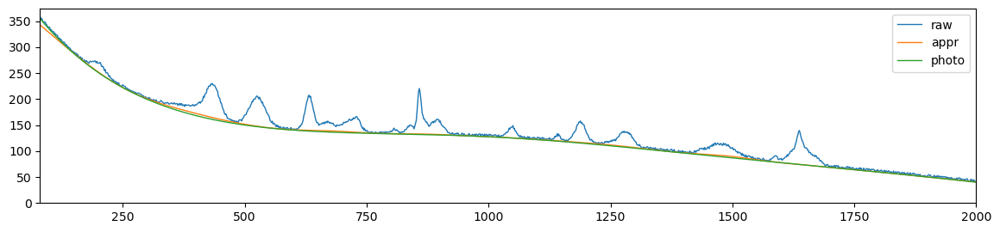

als_lambda: 161.02620275609394,	 als_p_weight: 9.236708571873866e-05,	 error: 234.2367936548302, 	 smoothness: 0.3681649411566703, 	 smoothness: -0.4879961746013264


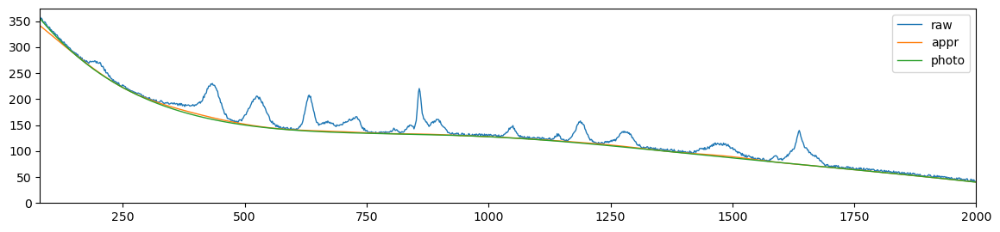

als_lambda: 161.02620275609394,	 als_p_weight: 6.723357536499335e-05,	 error: 242.80194520502772, 	 smoothness: 0.37377415235804234, 	 smoothness: -0.4926796120162459


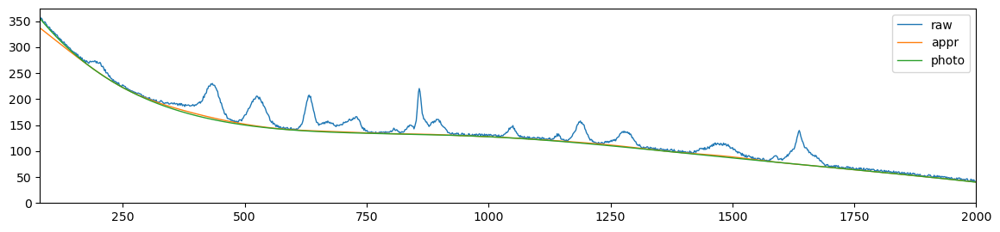

als_lambda: 161.02620275609394,	 als_p_weight: 4.893900918477499e-05,	 error: 251.25161938385878, 	 smoothness: 0.3783229123926965, 	 smoothness: -0.49693117710589163


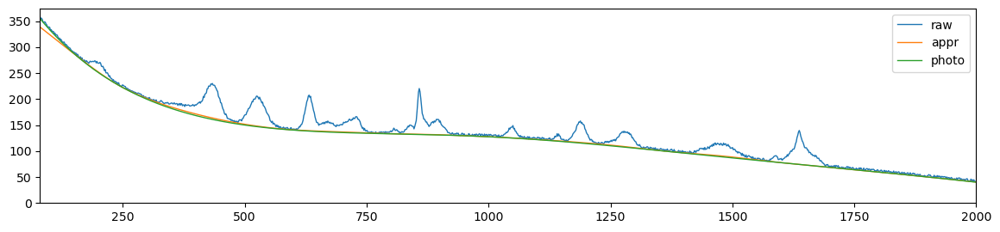

als_lambda: 161.02620275609394,	 als_p_weight: 3.5622478902624444e-05,	 error: 269.0577022384194, 	 smoothness: 0.38690817405089584, 	 smoothness: -0.5021360524340434


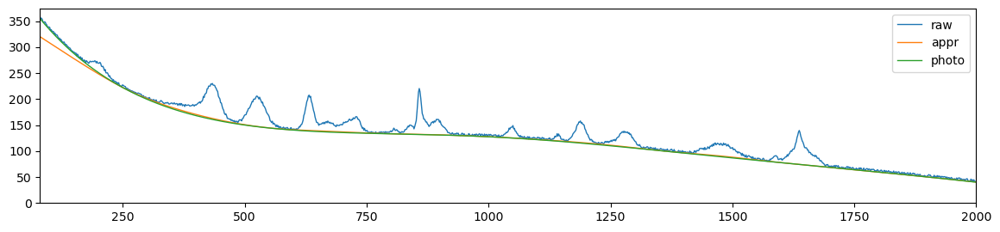

als_lambda: 161.02620275609394,	 als_p_weight: 2.592943797404667e-05,	 error: 282.2084657017871, 	 smoothness: 0.39220471931596923, 	 smoothness: -0.504863496284231


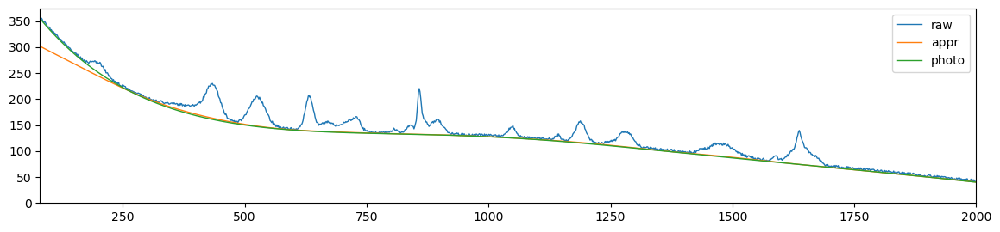

als_lambda: 161.02620275609394,	 als_p_weight: 1.8873918221350995e-05,	 error: 286.41309049081434, 	 smoothness: 0.39304504699454396, 	 smoothness: -0.5054607867894678


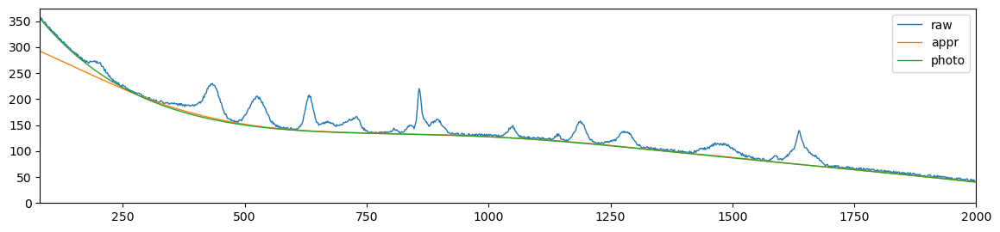

als_lambda: 161.02620275609394,	 als_p_weight: 1.3738237958832637e-05,	 error: 299.033102860773, 	 smoothness: 0.39618045491150866, 	 smoothness: -0.5075021770583854


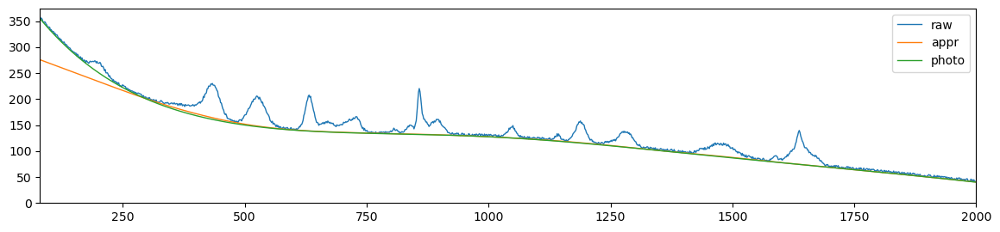

als_lambda: 161.02620275609394,	 als_p_weight: 1e-05,	 error: 307.33161948068687, 	 smoothness: 0.39852590499483226, 	 smoothness: -0.5085831079827369


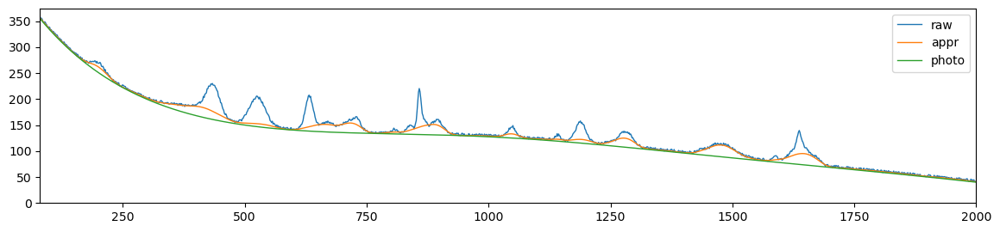

als_lambda: 280.72162039411756,	 als_p_weight: 0.1,	 error: 101.30497605646055, 	 smoothness: 0.11671104915283646, 	 smoothness: 0.05688353994652437


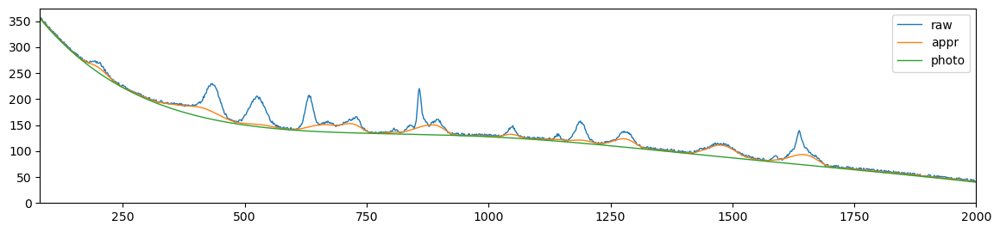

als_lambda: 280.72162039411756,	 als_p_weight: 0.0727895384398315,	 error: 93.34165729041848, 	 smoothness: 0.1031275322230165, 	 smoothness: 0.034861990945843795


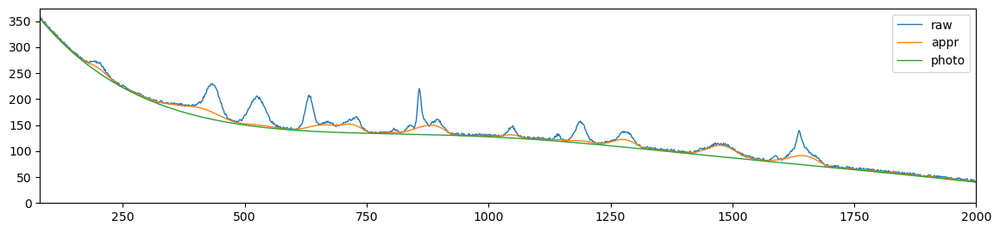

als_lambda: 280.72162039411756,	 als_p_weight: 0.05298316906283707,	 error: 86.01366861020911, 	 smoothness: 0.09155556362929497, 	 smoothness: 0.01359004668784566


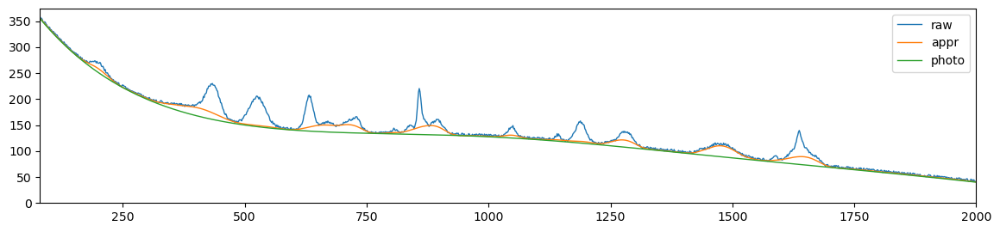

als_lambda: 280.72162039411756,	 als_p_weight: 0.03856620421163472,	 error: 79.07625969015334, 	 smoothness: 0.08169044527152196, 	 smoothness: -0.007654480914560575


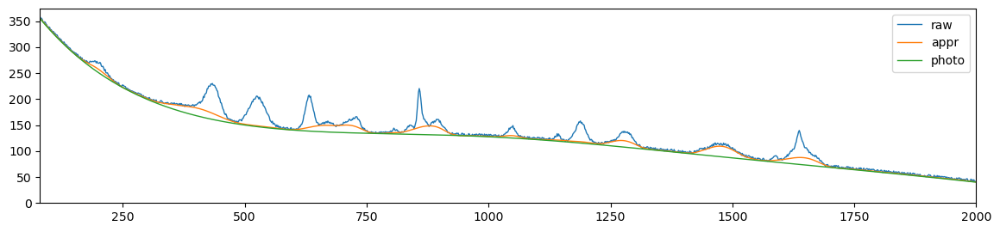

als_lambda: 280.72162039411756,	 als_p_weight: 0.02807216203941177,	 error: 72.69043857339919, 	 smoothness: 0.07372045466147824, 	 smoothness: -0.028899464809697642


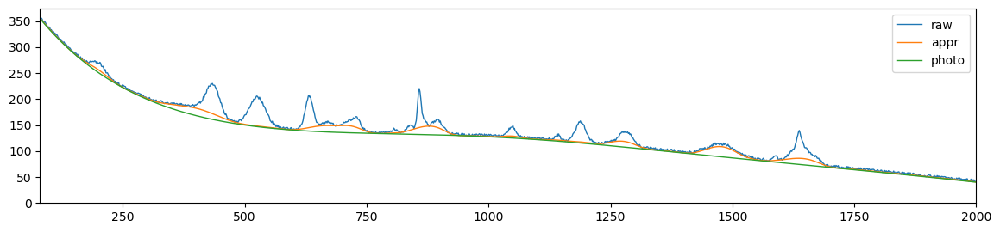

als_lambda: 280.72162039411756,	 als_p_weight: 0.020433597178569417,	 error: 66.78291068581308, 	 smoothness: 0.06758580941883151, 	 smoothness: -0.05029655523687355


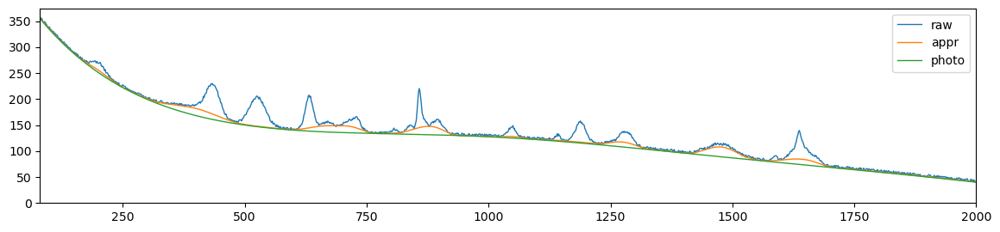

als_lambda: 280.72162039411756,	 als_p_weight: 0.014873521072935119,	 error: 61.33404855079468, 	 smoothness: 0.06324303923185728, 	 smoothness: -0.07240166964501801


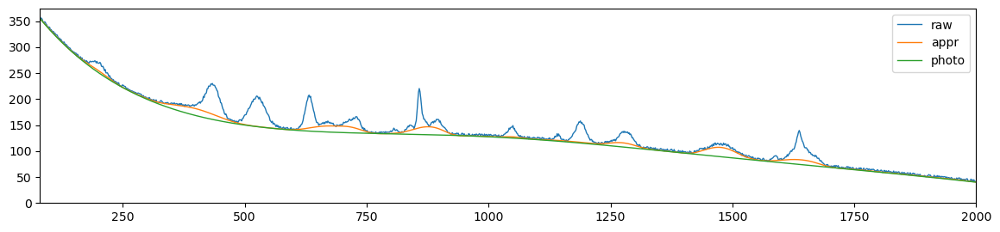

als_lambda: 280.72162039411756,	 als_p_weight: 0.010826367338740546,	 error: 56.4317163696605, 	 smoothness: 0.060960125739218524, 	 smoothness: -0.09537816473365755


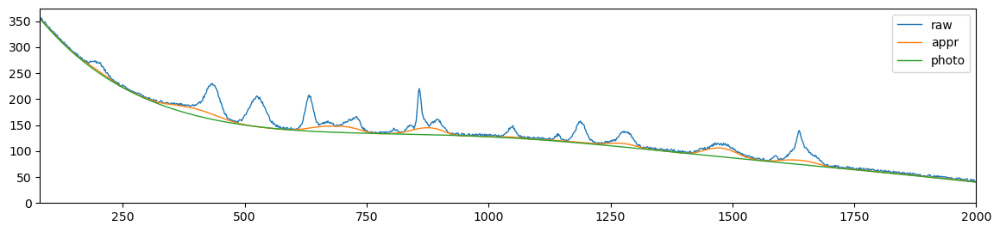

als_lambda: 280.72162039411756,	 als_p_weight: 0.007880462815669913,	 error: 52.079754600762456, 	 smoothness: 0.06116632622106316, 	 smoothness: -0.12044672189709717


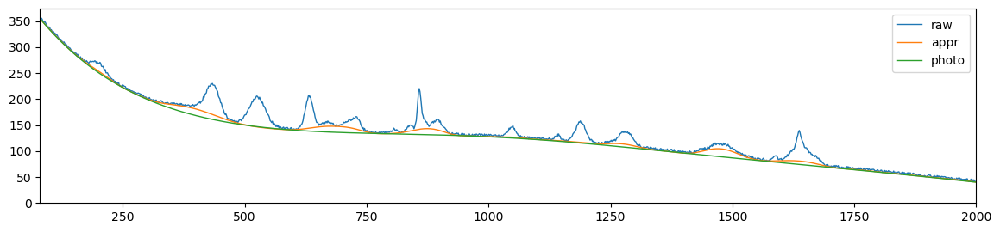

als_lambda: 280.72162039411756,	 als_p_weight: 0.005736152510448681,	 error: 48.46417861584918, 	 smoothness: 0.0648457797130984, 	 smoothness: -0.1487207233225094


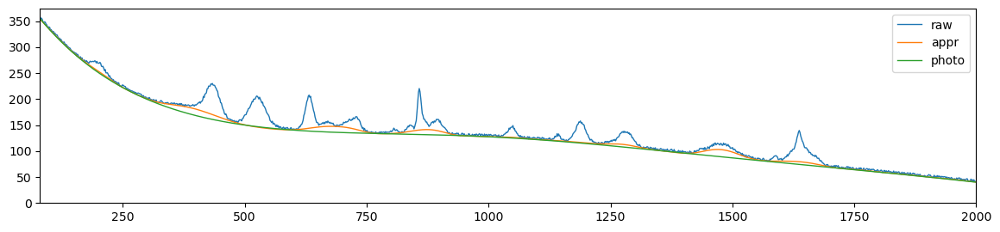

als_lambda: 280.72162039411756,	 als_p_weight: 0.0041753189365604,	 error: 47.43415031944977, 	 smoothness: 0.07723602400531104, 	 smoothness: -0.1844384856510343


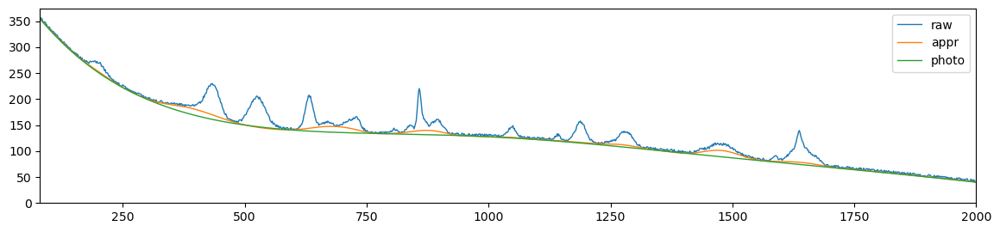

als_lambda: 280.72162039411756,	 als_p_weight: 0.0030391953823131978,	 error: 63.11904389119711, 	 smoothness: 0.1239947903440349, 	 smoothness: -0.2420948205900208


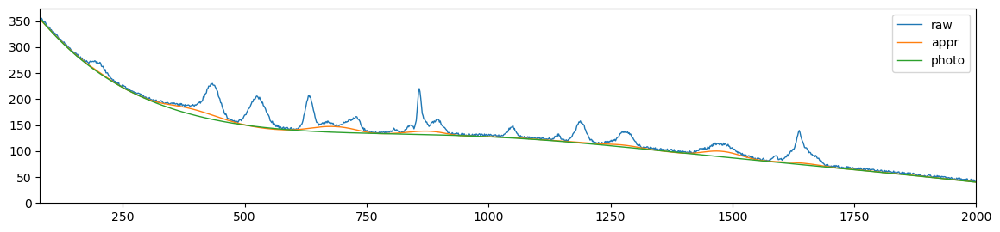

als_lambda: 280.72162039411756,	 als_p_weight: 0.00221221629107045,	 error: 95.99214508795758, 	 smoothness: 0.1896477960925548, 	 smoothness: -0.29778477782388435


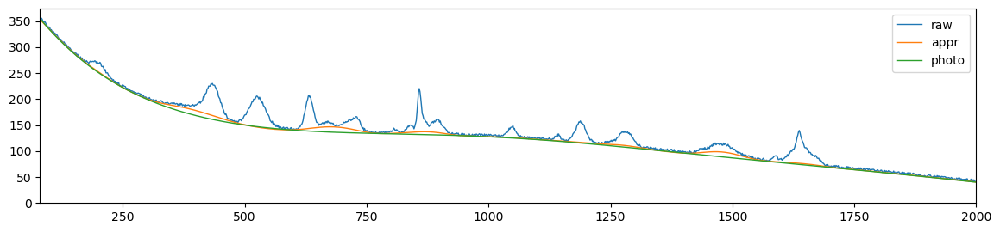

als_lambda: 280.72162039411756,	 als_p_weight: 0.0016102620275609393,	 error: 128.03207781464636, 	 smoothness: 0.24793272305703465, 	 smoothness: -0.3524057771509129


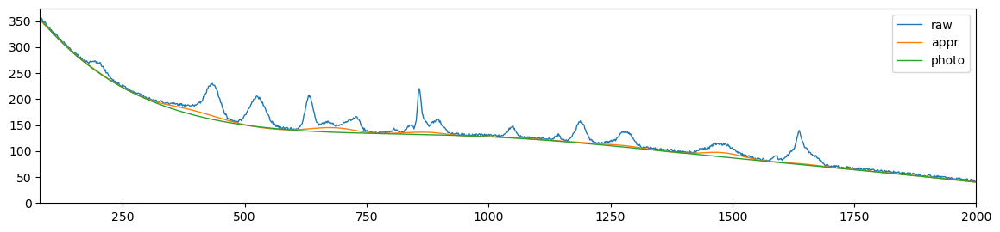

als_lambda: 280.72162039411756,	 als_p_weight: 0.0011721022975334804,	 error: 154.01632700710786, 	 smoothness: 0.2884542514663716, 	 smoothness: -0.39126647423921845


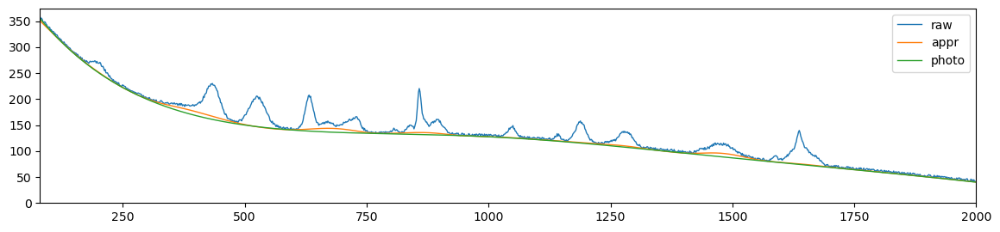

als_lambda: 280.72162039411756,	 als_p_weight: 0.0008531678524172806,	 error: 167.86992058326044, 	 smoothness: 0.30931757289990586, 	 smoothness: -0.41804780382339596


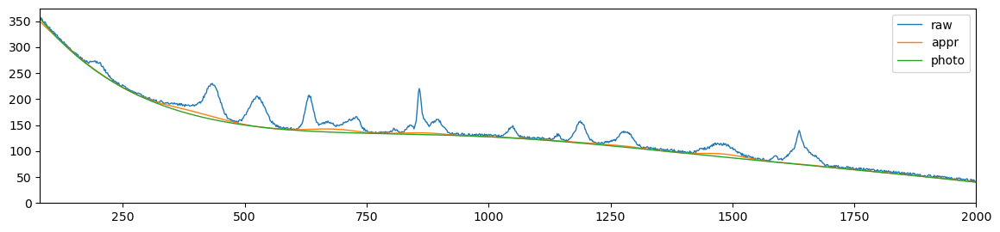

als_lambda: 280.72162039411756,	 als_p_weight: 0.0006210169418915617,	 error: 193.05328972933228, 	 smoothness: 0.3374032153862674, 	 smoothness: -0.44882011446926107


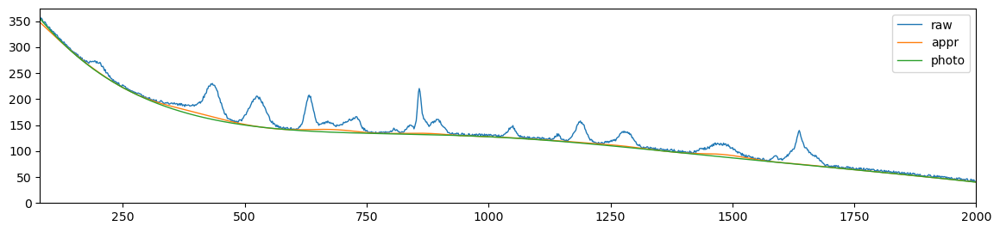

als_lambda: 280.72162039411756,	 als_p_weight: 0.00045203536563602454,	 error: 210.34654262304446, 	 smoothness: 0.3524528269780634, 	 smoothness: -0.46462365930272925


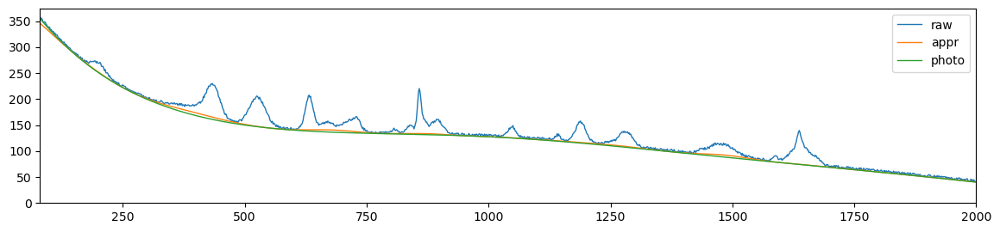

als_lambda: 280.72162039411756,	 als_p_weight: 0.00032903445623126676,	 error: 222.85209239062314, 	 smoothness: 0.36180811138582775, 	 smoothness: -0.47418374591547485


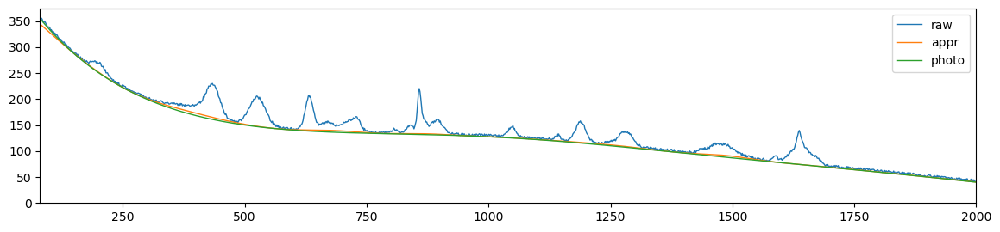

als_lambda: 280.72162039411756,	 als_p_weight: 0.0002395026619987486,	 error: 242.51847515059524, 	 smoothness: 0.3740185723084556, 	 smoothness: -0.4851812963753021


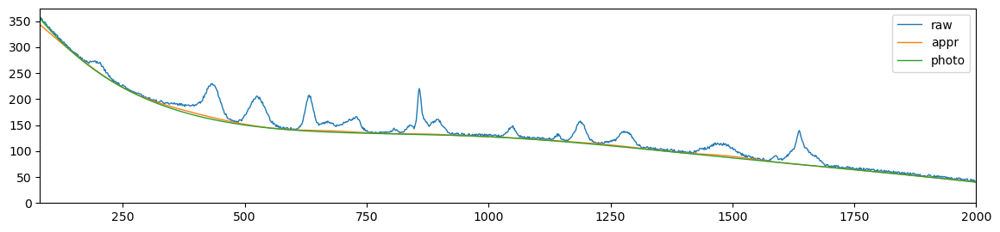

als_lambda: 280.72162039411756,	 als_p_weight: 0.00017433288221999874,	 error: 257.88126683503583, 	 smoothness: 0.38182356244285254, 	 smoothness: -0.4920343004642717


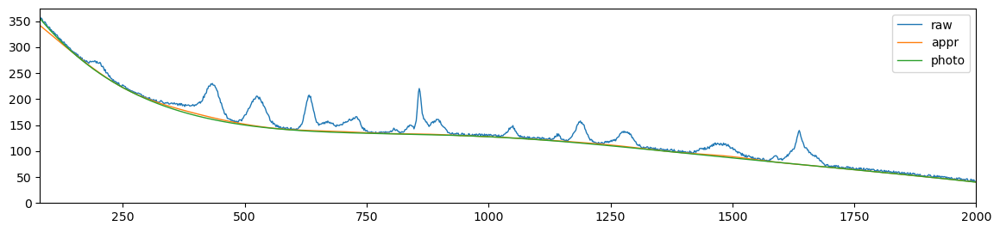

als_lambda: 280.72162039411756,	 als_p_weight: 0.0001268961003167922,	 error: 270.4725024378307, 	 smoothness: 0.38858860731326916, 	 smoothness: -0.49699656600057857


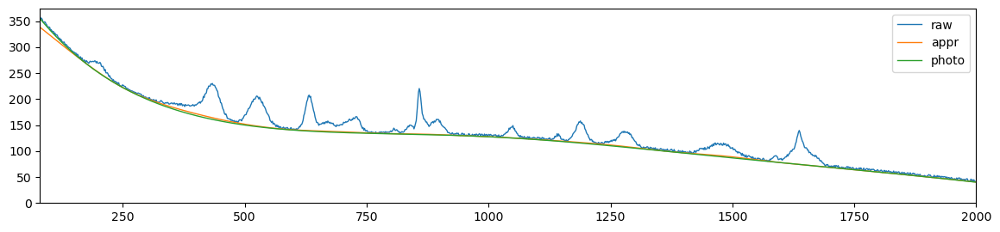

als_lambda: 280.72162039411756,	 als_p_weight: 9.236708571873866e-05,	 error: 273.7824024633292, 	 smoothness: 0.38972452475445507, 	 smoothness: -0.5000060311307727


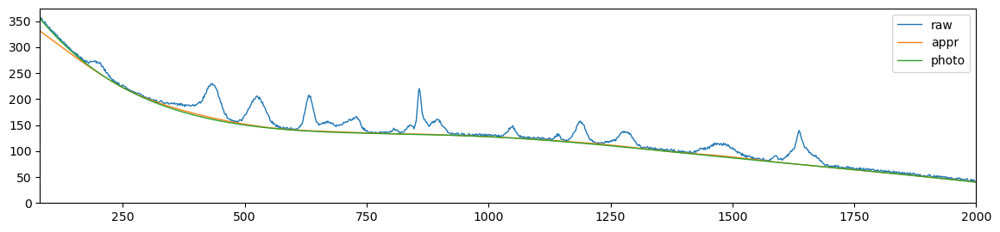

als_lambda: 280.72162039411756,	 als_p_weight: 6.723357536499335e-05,	 error: 286.4457677705078, 	 smoothness: 0.3938351368556951, 	 smoothness: -0.5037869938100097


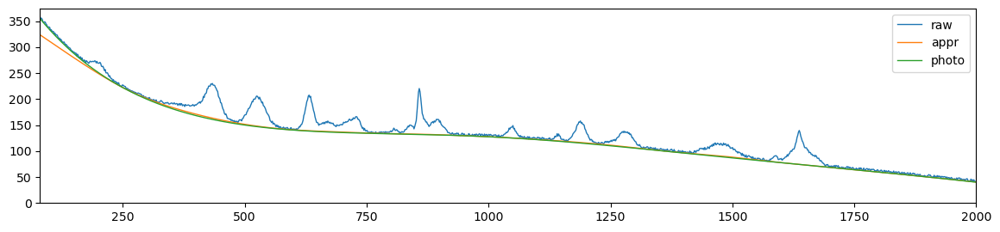

als_lambda: 280.72162039411756,	 als_p_weight: 4.893900918477499e-05,	 error: 301.96218691678615, 	 smoothness: 0.40020458269818504, 	 smoothness: -0.5072419417543942


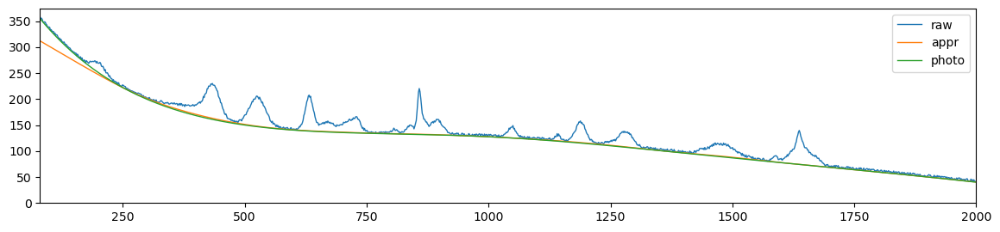

als_lambda: 280.72162039411756,	 als_p_weight: 3.5622478902624444e-05,	 error: 304.6680834581612, 	 smoothness: 0.39947835423469136, 	 smoothness: -0.508498544594577


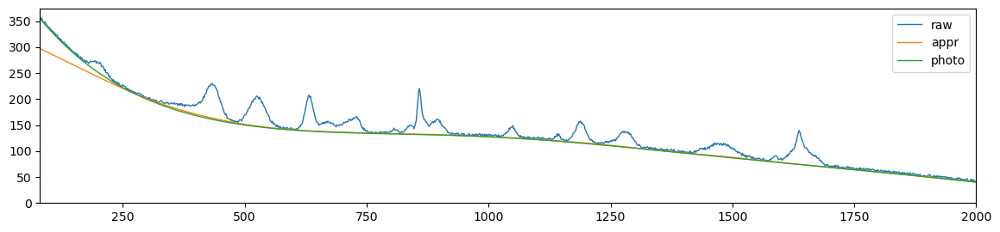

als_lambda: 280.72162039411756,	 als_p_weight: 2.592943797404667e-05,	 error: 320.9911526342798, 	 smoothness: 0.4069776001129581, 	 smoothness: -0.5115956212778076


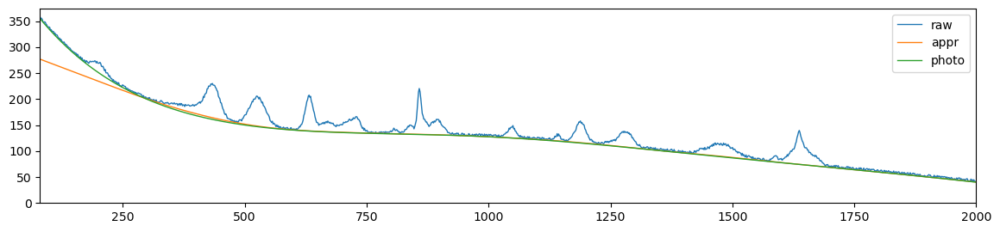

als_lambda: 280.72162039411756,	 als_p_weight: 1.8873918221350995e-05,	 error: 330.47473812963386, 	 smoothness: 0.4098549996005755, 	 smoothness: -0.5139049523759305


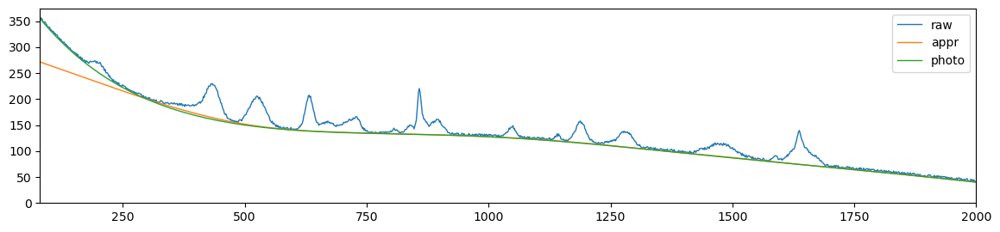

als_lambda: 280.72162039411756,	 als_p_weight: 1.3738237958832637e-05,	 error: 336.89943851726747, 	 smoothness: 0.40823619767889113, 	 smoothness: -0.5136892081292928


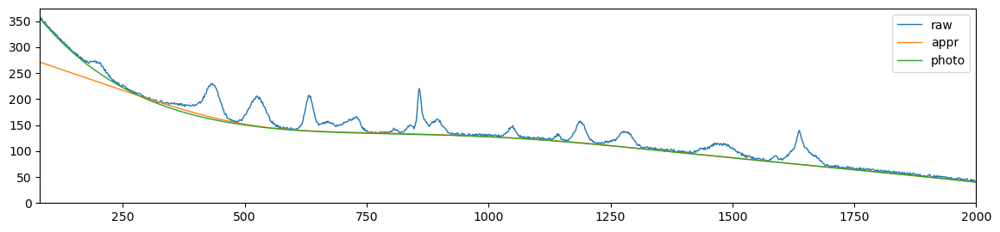

als_lambda: 280.72162039411756,	 als_p_weight: 1e-05,	 error: 341.8424836251119, 	 smoothness: 0.40926010154718534, 	 smoothness: -0.5141206602733258


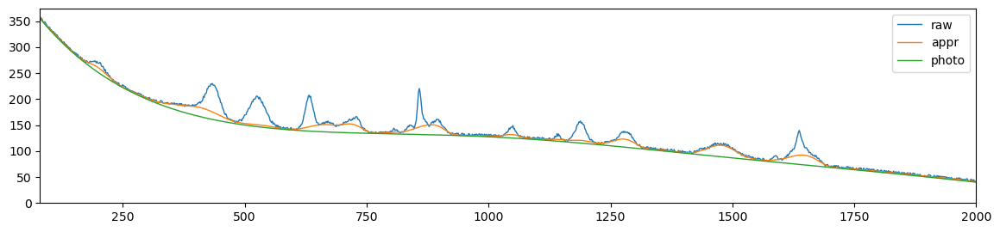

als_lambda: 489.3900918477494,	 als_p_weight: 0.1,	 error: 92.70776697685919, 	 smoothness: 0.09282161987483663, 	 smoothness: 0.015740996312143988


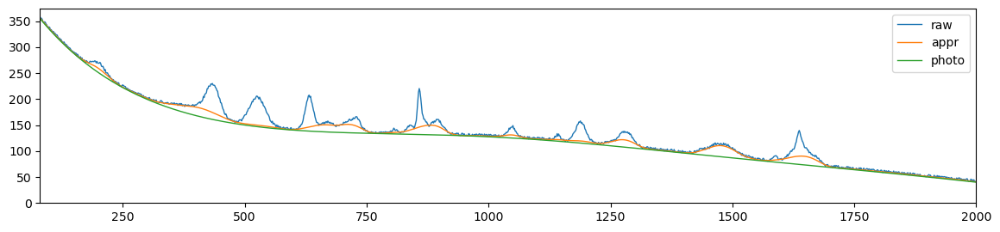

als_lambda: 489.3900918477494,	 als_p_weight: 0.0727895384398315,	 error: 85.0551693759147, 	 smoothness: 0.08300317205108224, 	 smoothness: -0.00478094922948484


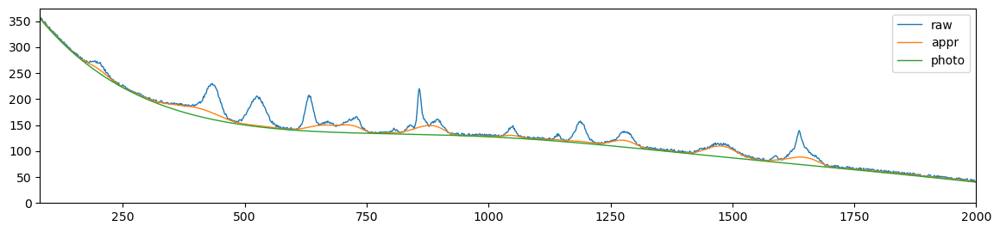

als_lambda: 489.3900918477494,	 als_p_weight: 0.05298316906283707,	 error: 77.95984214946029, 	 smoothness: 0.07486634619788446, 	 smoothness: -0.025334591218942062


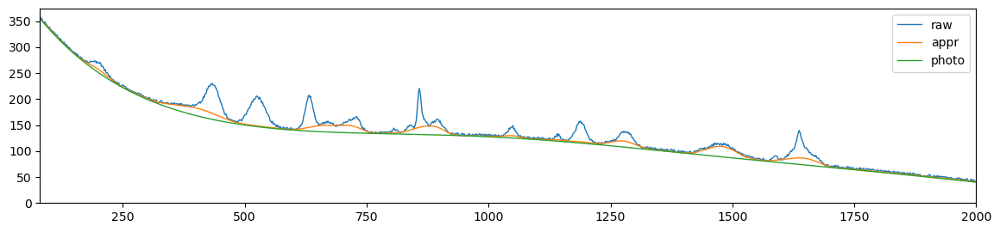

als_lambda: 489.3900918477494,	 als_p_weight: 0.03856620421163472,	 error: 71.46437796872567, 	 smoothness: 0.06851578062448467, 	 smoothness: -0.046298762721473194


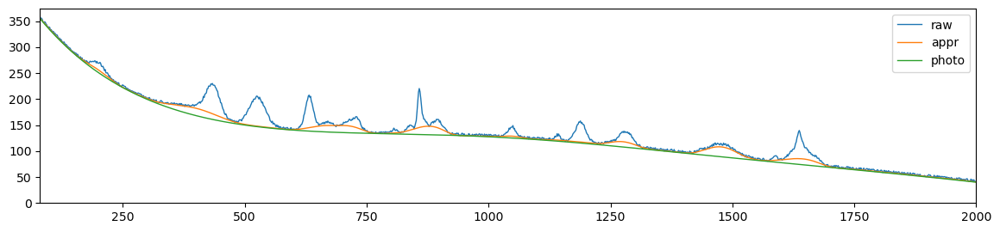

als_lambda: 489.3900918477494,	 als_p_weight: 0.02807216203941177,	 error: 65.46011681280392, 	 smoothness: 0.0638606013377673, 	 smoothness: -0.06794311604910896


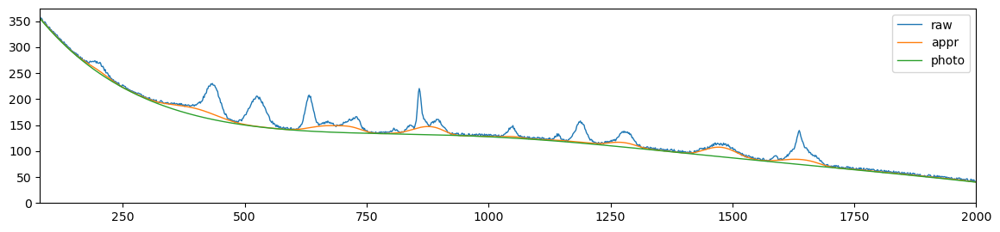

als_lambda: 489.3900918477494,	 als_p_weight: 0.020433597178569417,	 error: 60.014619380821394, 	 smoothness: 0.061106330812455575, 	 smoothness: -0.09039900781233352


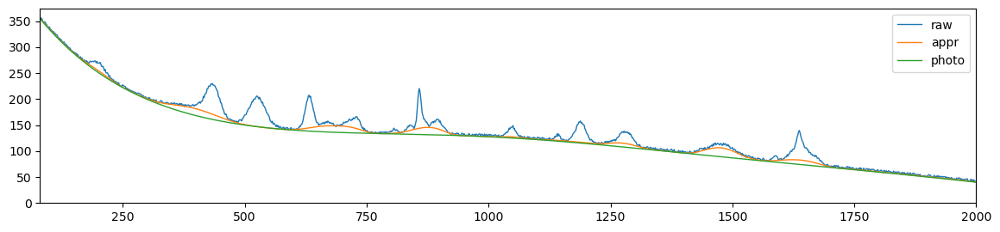

als_lambda: 489.3900918477494,	 als_p_weight: 0.014873521072935119,	 error: 55.16284096155131, 	 smoothness: 0.06064629566087453, 	 smoothness: -0.11455467585914678


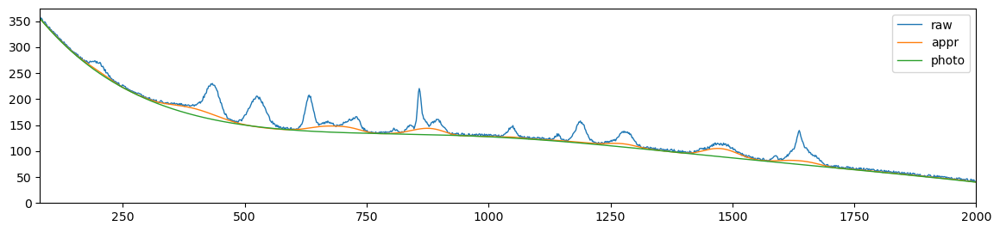

als_lambda: 489.3900918477494,	 als_p_weight: 0.010826367338740546,	 error: 51.04111804963108, 	 smoothness: 0.06337382451399852, 	 smoothness: -0.14186082868659233


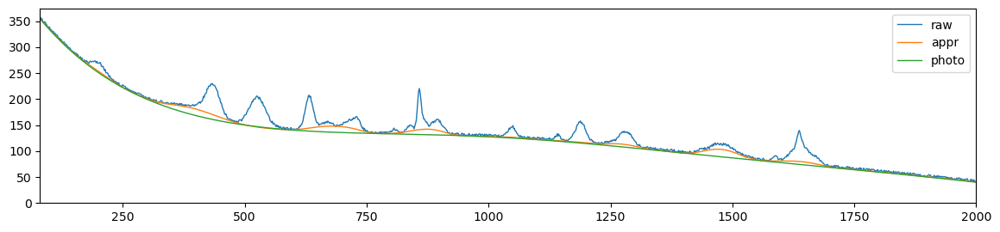

als_lambda: 489.3900918477494,	 als_p_weight: 0.007880462815669913,	 error: 48.30615786633334, 	 smoothness: 0.07200633705448807, 	 smoothness: -0.1746645321550642


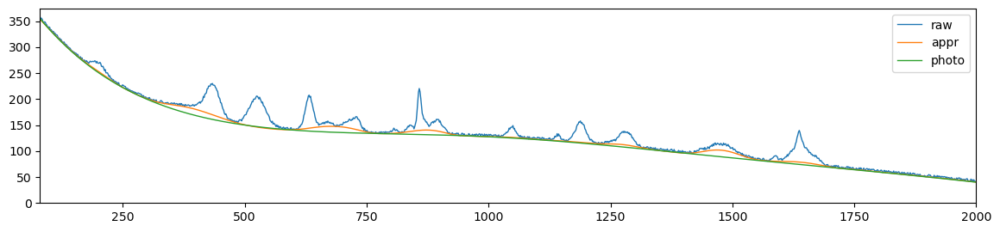

als_lambda: 489.3900918477494,	 als_p_weight: 0.005736152510448681,	 error: 59.27637139576582, 	 smoothness: 0.11005478795306992, 	 smoothness: -0.22662369925843023


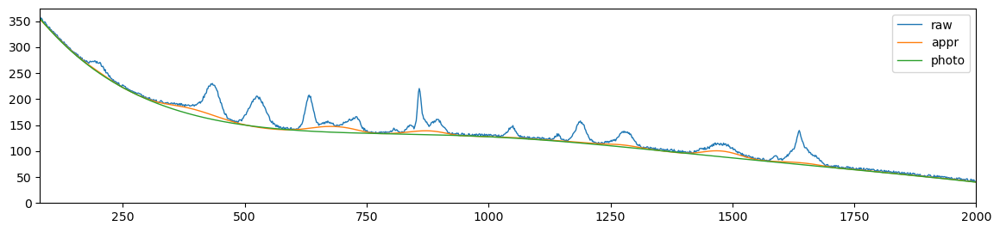

als_lambda: 489.3900918477494,	 als_p_weight: 0.0041753189365604,	 error: 94.11123464052908, 	 smoothness: 0.18153997865208726, 	 smoothness: -0.28733995604391366


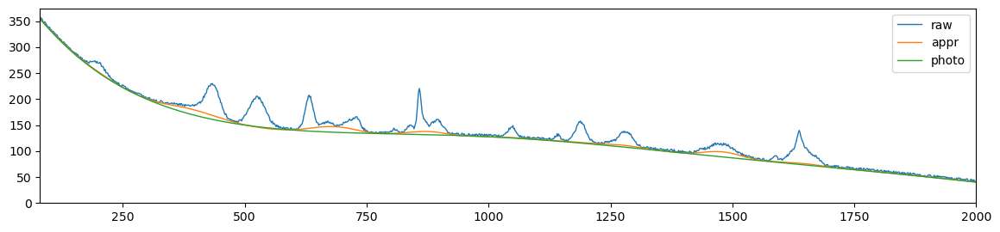

als_lambda: 489.3900918477494,	 als_p_weight: 0.0030391953823131978,	 error: 122.86765327073701, 	 smoothness: 0.23705937409800998, 	 smoothness: -0.34195134434842056


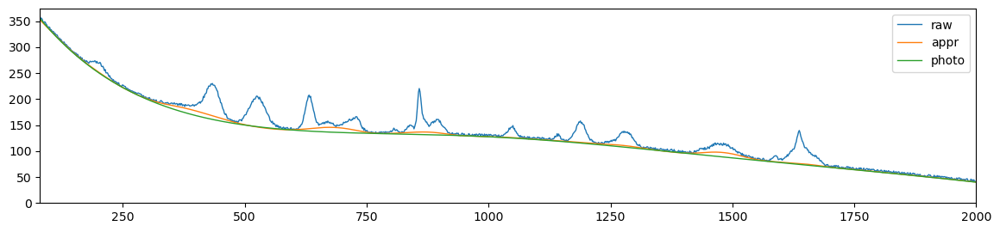

als_lambda: 489.3900918477494,	 als_p_weight: 0.00221221629107045,	 error: 152.16922432469647, 	 smoothness: 0.28401509697032734, 	 smoothness: -0.38499502859296625


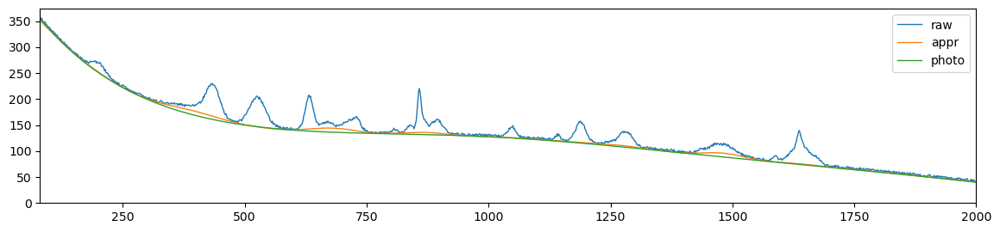

als_lambda: 489.3900918477494,	 als_p_weight: 0.0016102620275609393,	 error: 168.3996841830641, 	 smoothness: 0.3072231936991814, 	 smoothness: -0.41289516469538445


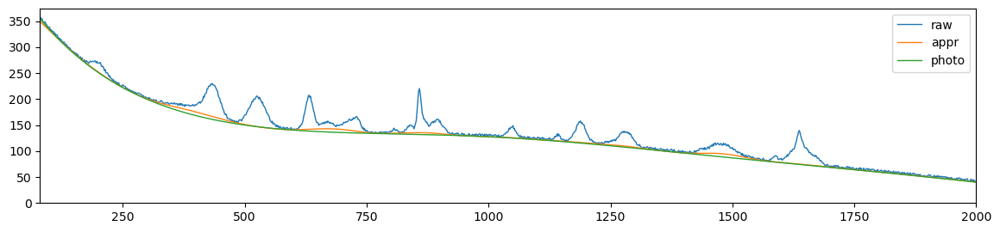

als_lambda: 489.3900918477494,	 als_p_weight: 0.0011721022975334804,	 error: 192.34462134625963, 	 smoothness: 0.3351022055768725, 	 smoothness: -0.44398288364677524


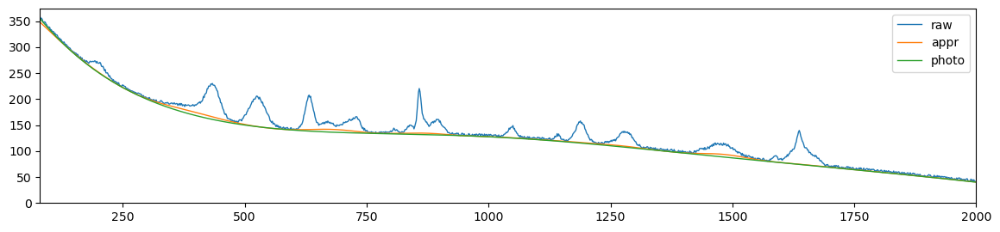

als_lambda: 489.3900918477494,	 als_p_weight: 0.0008531678524172806,	 error: 214.0938019736539, 	 smoothness: 0.35422581102221806, 	 smoothness: -0.46325527609730294


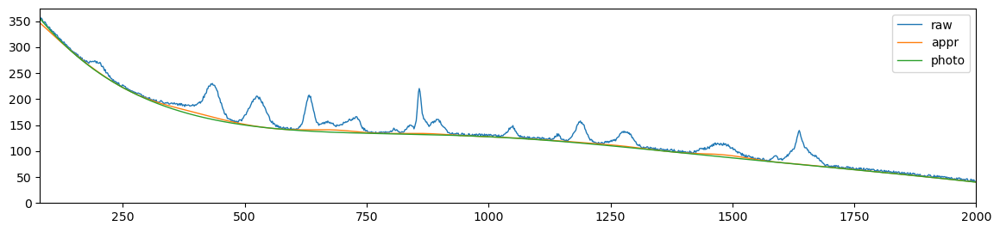

als_lambda: 489.3900918477494,	 als_p_weight: 0.0006210169418915617,	 error: 228.81307378752993, 	 smoothness: 0.36485028905174, 	 smoothness: -0.4734781770390248


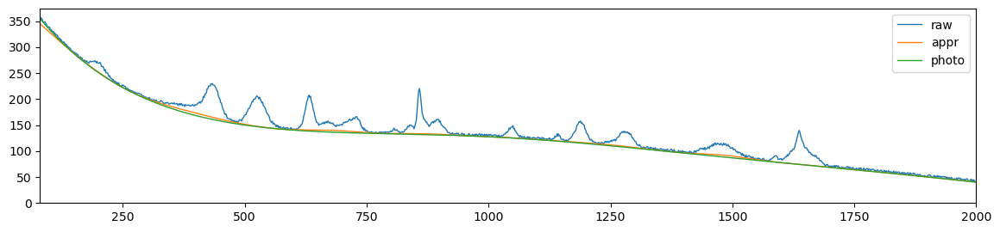

als_lambda: 489.3900918477494,	 als_p_weight: 0.00045203536563602454,	 error: 246.33517846959887, 	 smoothness: 0.3760315100632537, 	 smoothness: -0.483792347680768


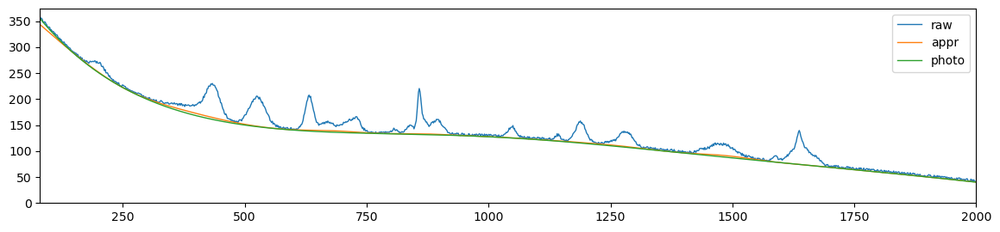

als_lambda: 489.3900918477494,	 als_p_weight: 0.00032903445623126676,	 error: 261.8534485106688, 	 smoothness: 0.38520663758515816, 	 smoothness: -0.4920086538334925


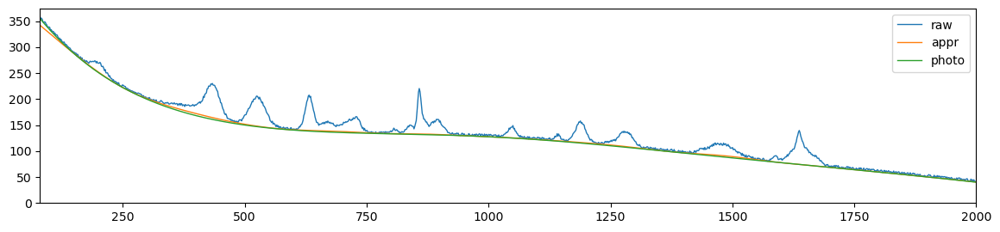

als_lambda: 489.3900918477494,	 als_p_weight: 0.0002395026619987486,	 error: 282.61987386151077, 	 smoothness: 0.39574279130701584, 	 smoothness: -0.49837694269114885


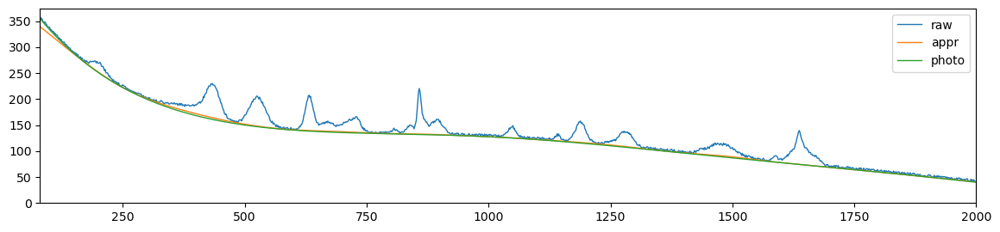

als_lambda: 489.3900918477494,	 als_p_weight: 0.00017433288221999874,	 error: 303.93099416743746, 	 smoothness: 0.4058099055822392, 	 smoothness: -0.5038745280736451


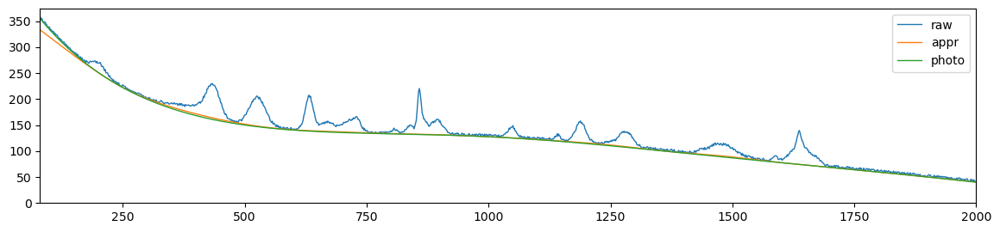

als_lambda: 489.3900918477494,	 als_p_weight: 0.0001268961003167922,	 error: 318.870104728057, 	 smoothness: 0.4120336475987456, 	 smoothness: -0.508607278621882


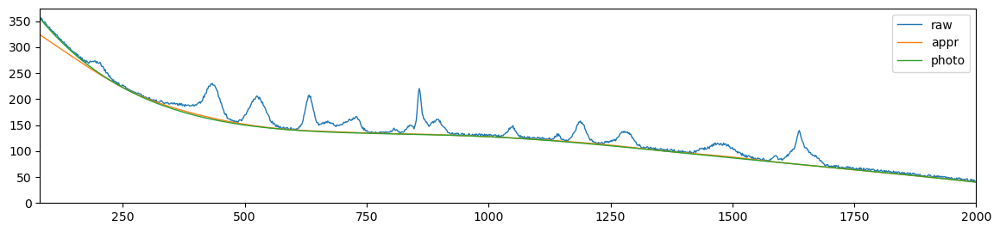

als_lambda: 489.3900918477494,	 als_p_weight: 9.236708571873866e-05,	 error: 335.29808075309137, 	 smoothness: 0.41772976481715707, 	 smoothness: -0.5126674315605197


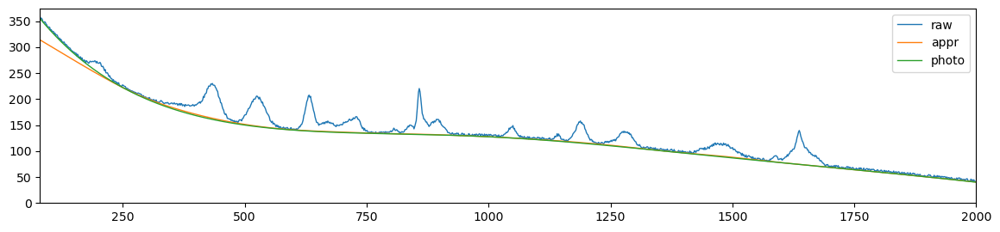

als_lambda: 489.3900918477494,	 als_p_weight: 6.723357536499335e-05,	 error: 347.12979197335613, 	 smoothness: 0.4202559031747042, 	 smoothness: -0.5141950507567734


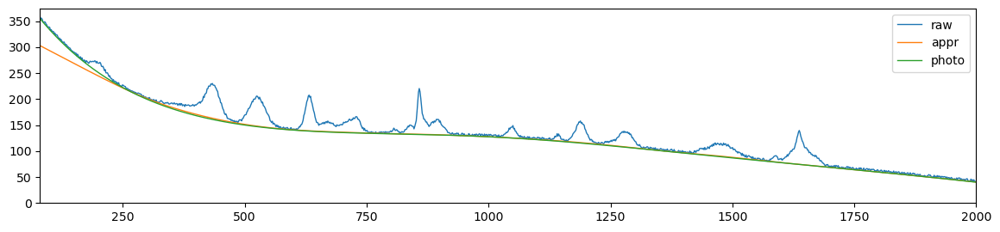

als_lambda: 489.3900918477494,	 als_p_weight: 4.893900918477499e-05,	 error: 365.06784470859964, 	 smoothness: 0.4243484960063034, 	 smoothness: -0.515969235168531


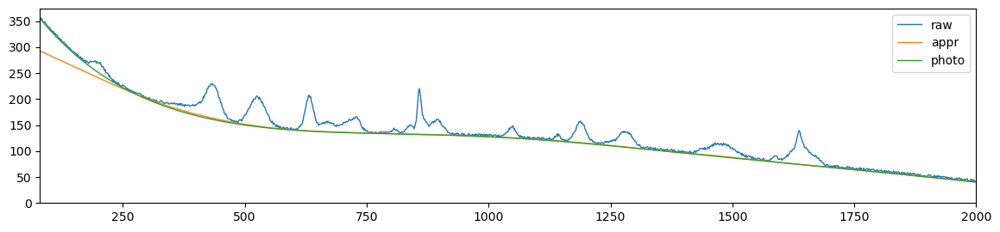

als_lambda: 489.3900918477494,	 als_p_weight: 3.5622478902624444e-05,	 error: 377.14658285978805, 	 smoothness: 0.4283609644851564, 	 smoothness: -0.5181222401737036


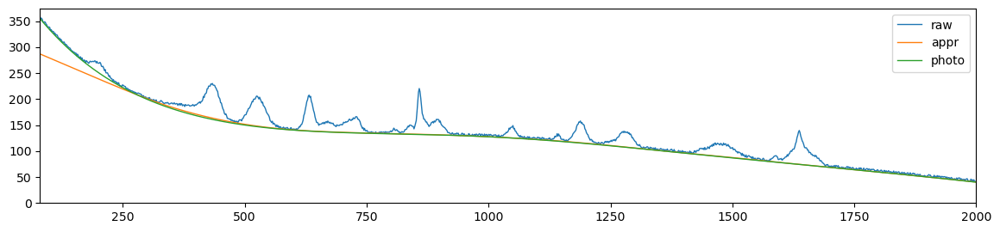

als_lambda: 489.3900918477494,	 als_p_weight: 2.592943797404667e-05,	 error: 389.05527871420526, 	 smoothness: 0.43198960537118675, 	 smoothness: -0.5203360845760209


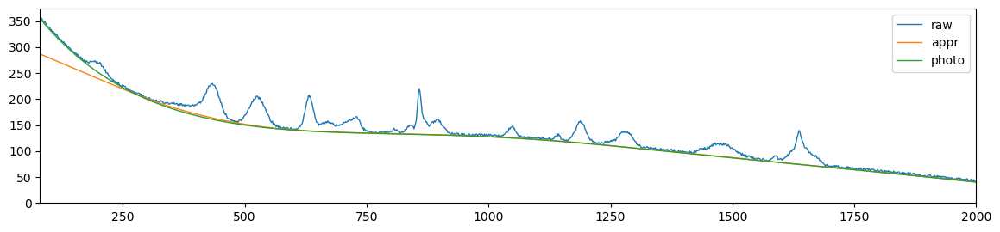

als_lambda: 489.3900918477494,	 als_p_weight: 1.8873918221350995e-05,	 error: 405.4688053946222, 	 smoothness: 0.4361143360335318, 	 smoothness: -0.5220043055115352


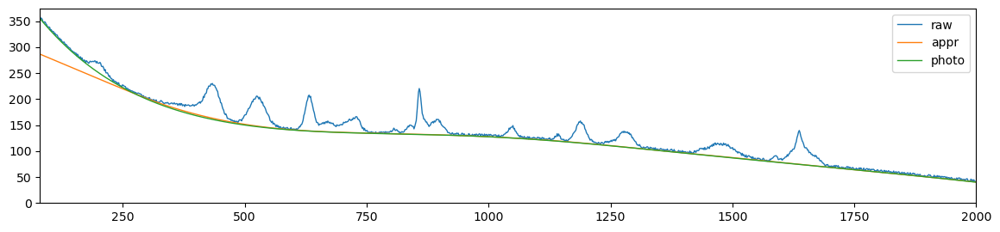

als_lambda: 489.3900918477494,	 als_p_weight: 1.3738237958832637e-05,	 error: 418.6757128822065, 	 smoothness: 0.4376458766692462, 	 smoothness: -0.523795341107897


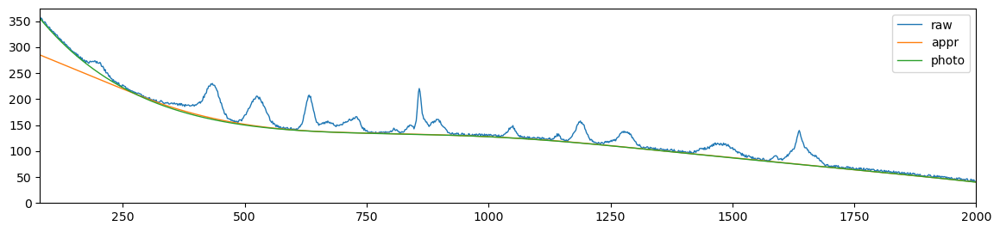

als_lambda: 489.3900918477494,	 als_p_weight: 1e-05,	 error: 434.76135150742584, 	 smoothness: 0.44271932762230626, 	 smoothness: -0.5248572078180986


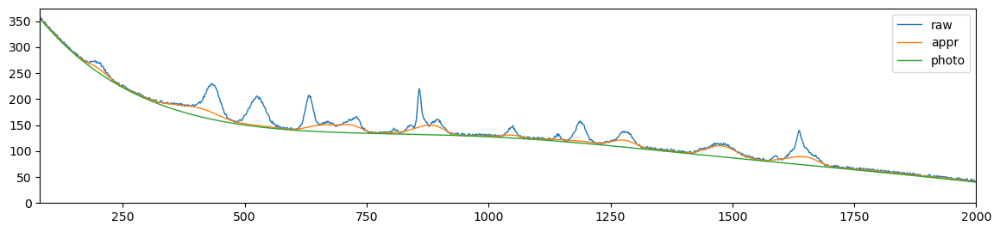

als_lambda: 853.1678524172814,	 als_p_weight: 0.1,	 error: 84.77957497679485, 	 smoothness: 0.07586502950057078, 	 smoothness: -0.022854851767872962


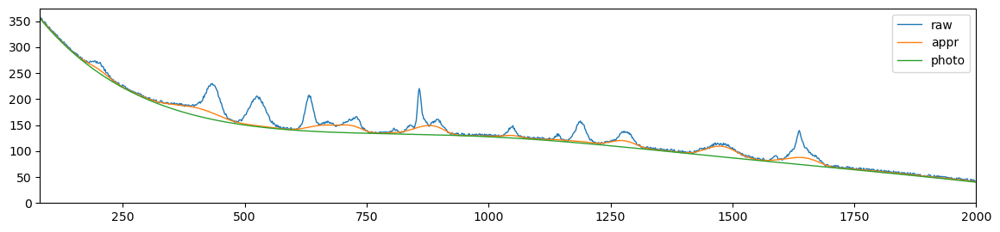

als_lambda: 853.1678524172814,	 als_p_weight: 0.0727895384398315,	 error: 77.43980775598284, 	 smoothness: 0.06935758521264831, 	 smoothness: -0.043064520418496136


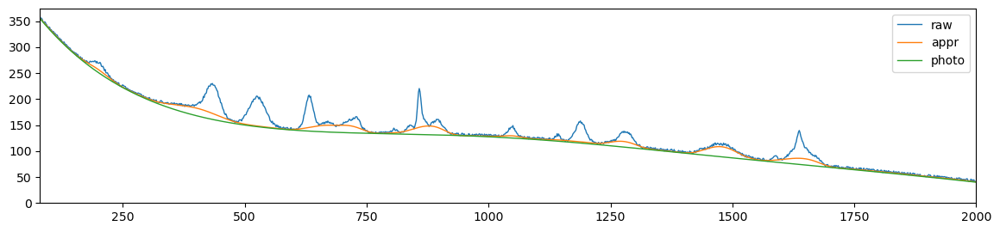

als_lambda: 853.1678524172814,	 als_p_weight: 0.05298316906283707,	 error: 70.73605842147398, 	 smoothness: 0.06451015269598842, 	 smoothness: -0.06399504313668246


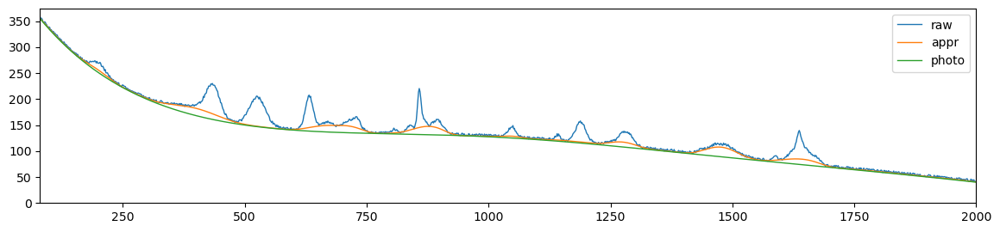

als_lambda: 853.1678524172814,	 als_p_weight: 0.03856620421163472,	 error: 64.61827267801712, 	 smoothness: 0.0614191610307431, 	 smoothness: -0.08601588401960113


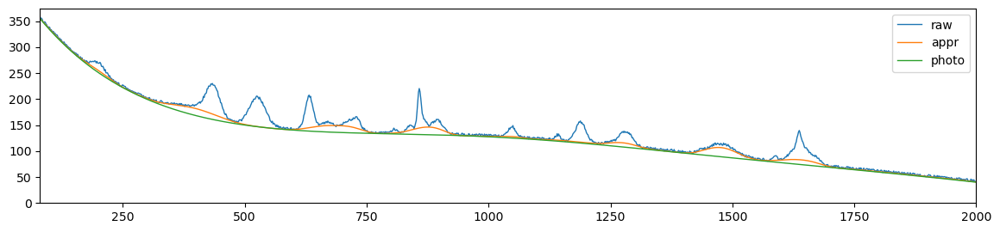

als_lambda: 853.1678524172814,	 als_p_weight: 0.02807216203941177,	 error: 59.117487683257075, 	 smoothness: 0.06033954070464195, 	 smoothness: -0.10926708079192915


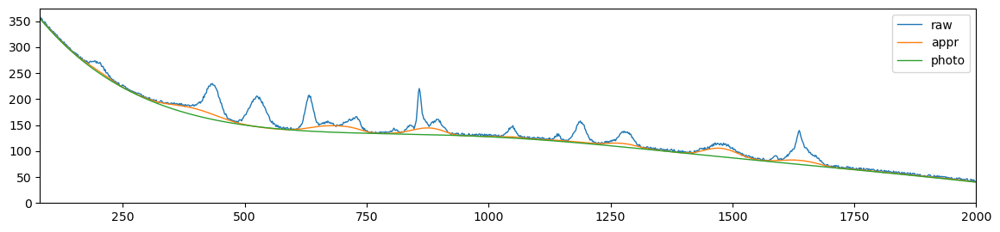

als_lambda: 853.1678524172814,	 als_p_weight: 0.020433597178569417,	 error: 54.34934145568571, 	 smoothness: 0.06201068434480121, 	 smoothness: -0.13496735387044614


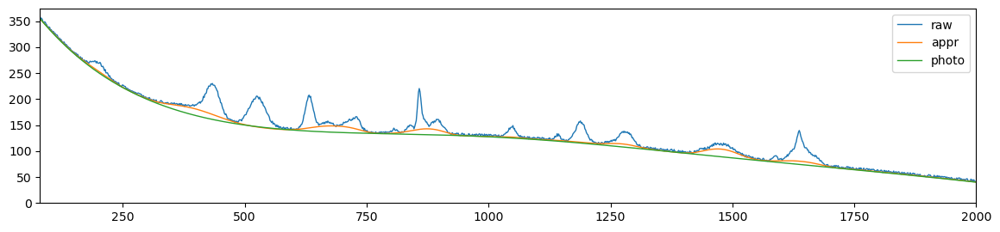

als_lambda: 853.1678524172814,	 als_p_weight: 0.014873521072935119,	 error: 50.73055049019924, 	 smoothness: 0.06855917818274439, 	 smoothness: -0.1659080642997959


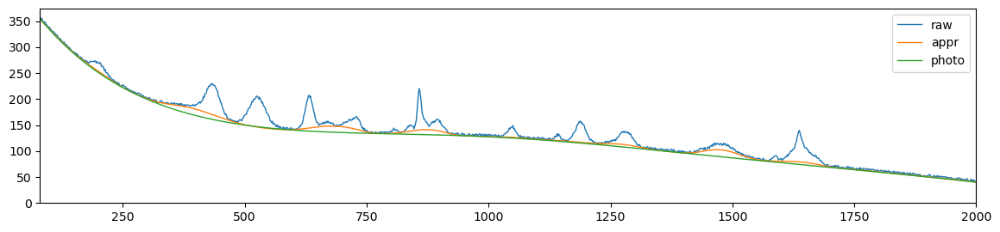

als_lambda: 853.1678524172814,	 als_p_weight: 0.010826367338740546,	 error: 56.2417185010097, 	 smoothness: 0.09584135362698207, 	 smoothness: -0.21076148492719007


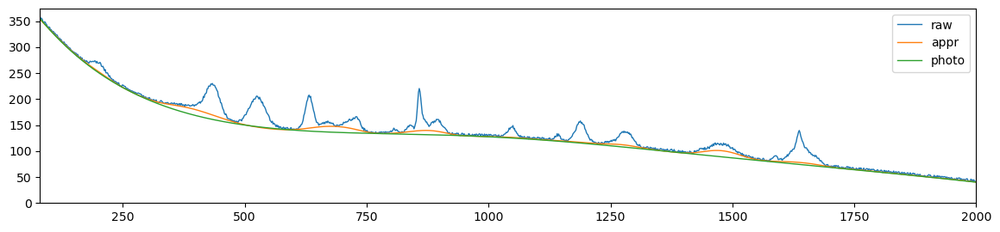

als_lambda: 853.1678524172814,	 als_p_weight: 0.007880462815669913,	 error: 91.15285858327019, 	 smoothness: 0.17248652551130517, 	 smoothness: -0.27739118041792216


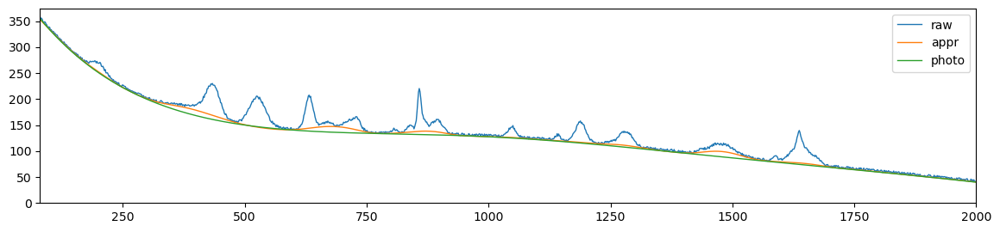

als_lambda: 853.1678524172814,	 als_p_weight: 0.005736152510448681,	 error: 113.05153805968106, 	 smoothness: 0.21885763989095214, 	 smoothness: -0.32726585930100016


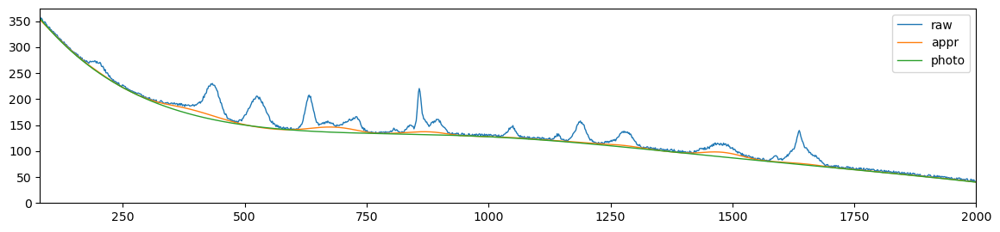

als_lambda: 853.1678524172814,	 als_p_weight: 0.0041753189365604,	 error: 145.00574956255213, 	 smoothness: 0.2722160450226548, 	 smoothness: -0.3752512319424354


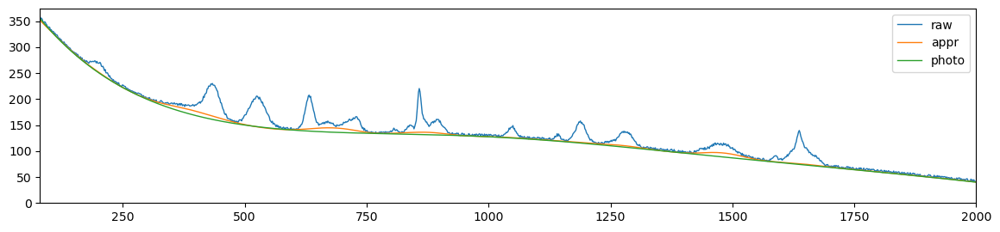

als_lambda: 853.1678524172814,	 als_p_weight: 0.0030391953823131978,	 error: 165.1800034093271, 	 smoothness: 0.30204046308295385, 	 smoothness: -0.4065658205864612


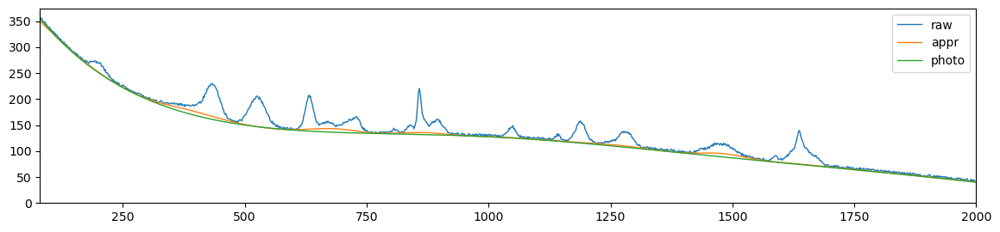

als_lambda: 853.1678524172814,	 als_p_weight: 0.00221221629107045,	 error: 188.26651656235313, 	 smoothness: 0.3298972393695434, 	 smoothness: -0.4384586371817558


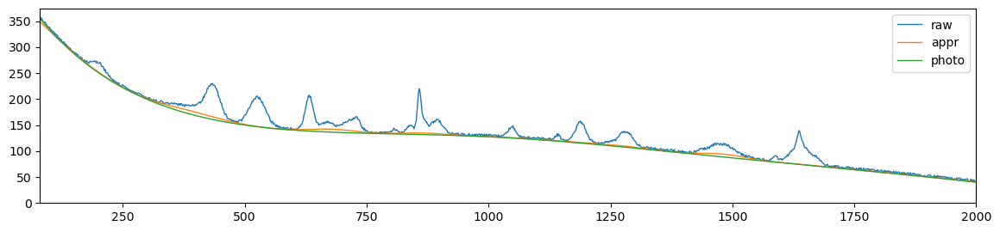

als_lambda: 853.1678524172814,	 als_p_weight: 0.0016102620275609393,	 error: 212.28492428689896, 	 smoothness: 0.352445881814319, 	 smoothness: -0.4609420496179088


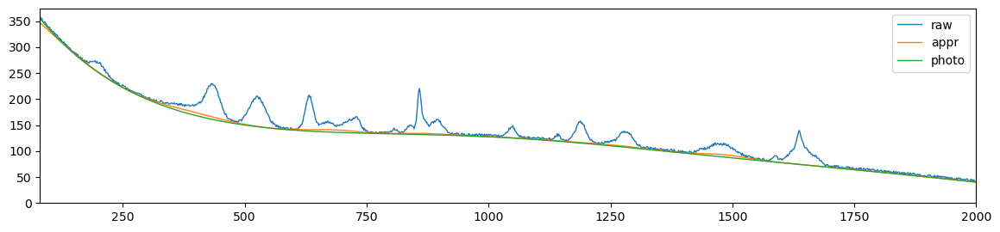

als_lambda: 853.1678524172814,	 als_p_weight: 0.0011721022975334804,	 error: 227.30947290664116, 	 smoothness: 0.3636663871488192, 	 smoothness: -0.47177936867978937


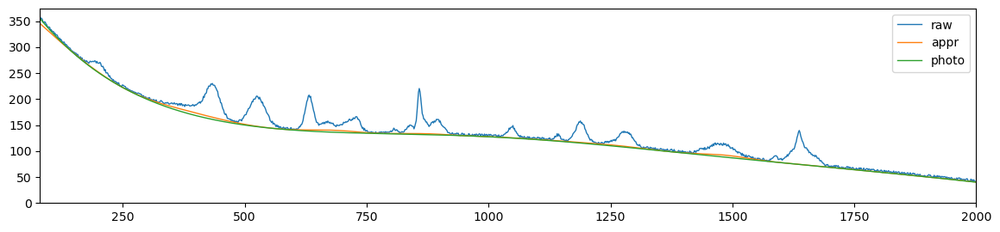

als_lambda: 853.1678524172814,	 als_p_weight: 0.0008531678524172806,	 error: 243.9425719646522, 	 smoothness: 0.37460069163656134, 	 smoothness: -0.4819270259963073


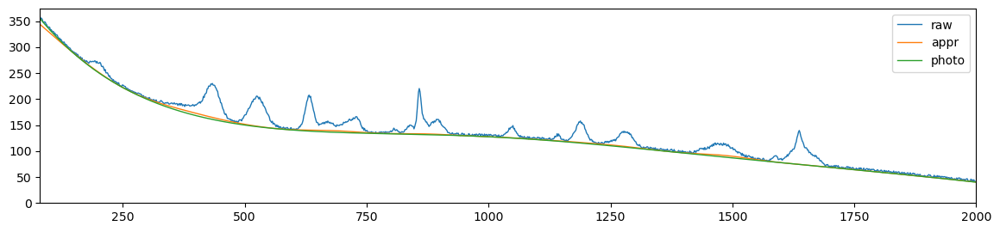

als_lambda: 853.1678524172814,	 als_p_weight: 0.0006210169418915617,	 error: 264.8553334737186, 	 smoothness: 0.3865017438126763, 	 smoothness: -0.4911438817100428


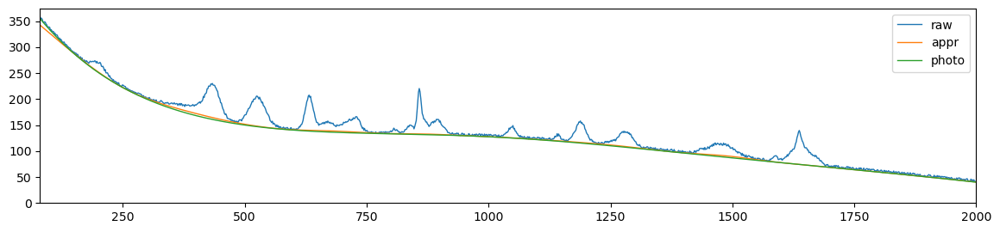

als_lambda: 853.1678524172814,	 als_p_weight: 0.00045203536563602454,	 error: 285.386968556154, 	 smoothness: 0.39673806788675464, 	 smoothness: -0.49770079985869586


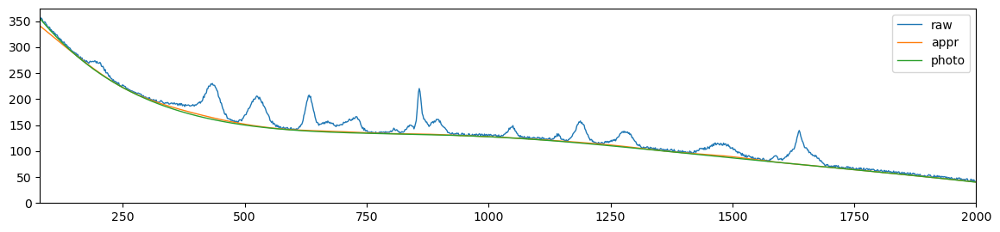

als_lambda: 853.1678524172814,	 als_p_weight: 0.00032903445623126676,	 error: 306.02082156857335, 	 smoothness: 0.4063704310442918, 	 smoothness: -0.503311720068867


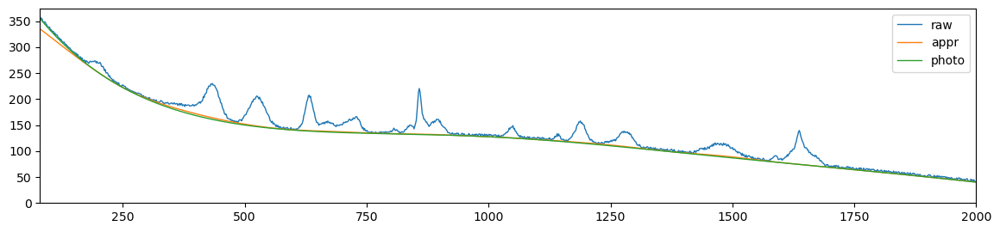

als_lambda: 853.1678524172814,	 als_p_weight: 0.0002395026619987486,	 error: 326.98764761862867, 	 smoothness: 0.41553956517054275, 	 smoothness: -0.5087380415067996


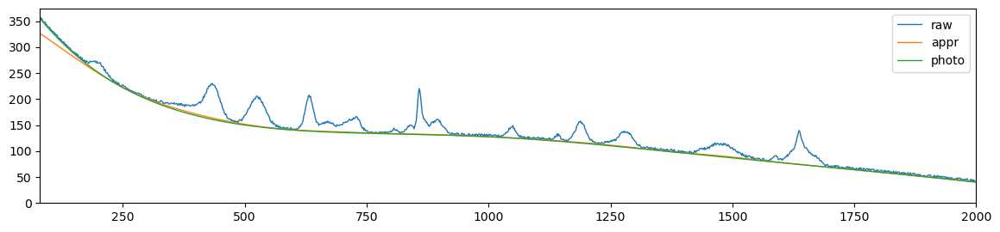

als_lambda: 853.1678524172814,	 als_p_weight: 0.00017433288221999874,	 error: 350.09313103042126, 	 smoothness: 0.4246926895876752, 	 smoothness: -0.5136688894470912


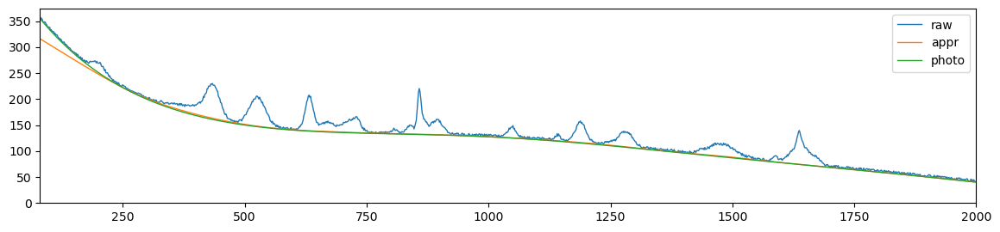

als_lambda: 853.1678524172814,	 als_p_weight: 0.0001268961003167922,	 error: 374.8235988790013, 	 smoothness: 0.4340532045580472, 	 smoothness: -0.5176759831885327


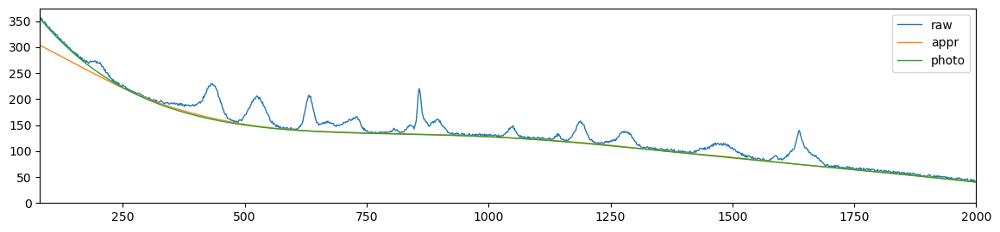

als_lambda: 853.1678524172814,	 als_p_weight: 9.236708571873866e-05,	 error: 393.5596419589404, 	 smoothness: 0.43976921501729677, 	 smoothness: -0.5206375690655077


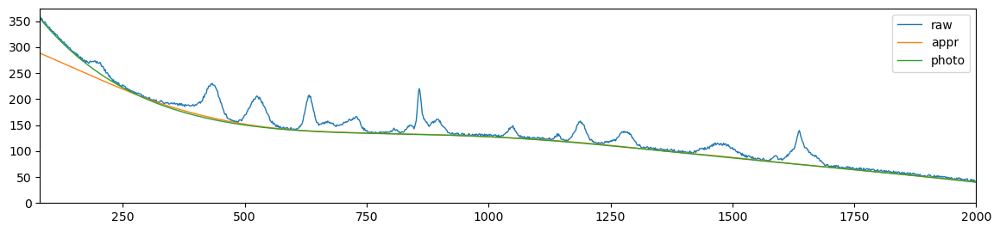

als_lambda: 853.1678524172814,	 als_p_weight: 6.723357536499335e-05,	 error: 415.3094548134117, 	 smoothness: 0.44612083569582717, 	 smoothness: -0.5238030500352923


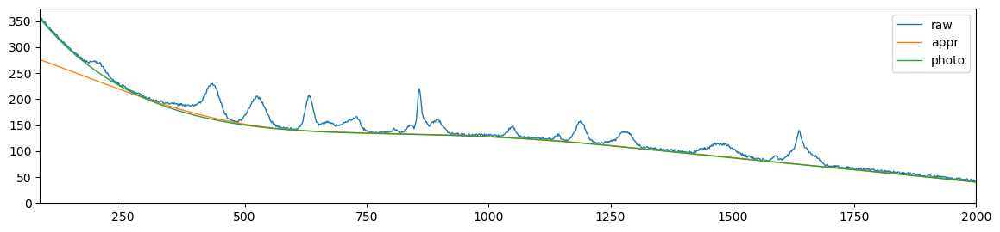

als_lambda: 853.1678524172814,	 als_p_weight: 4.893900918477499e-05,	 error: 430.47655252333965, 	 smoothness: 0.45062442250358503, 	 smoothness: -0.5263616648489492


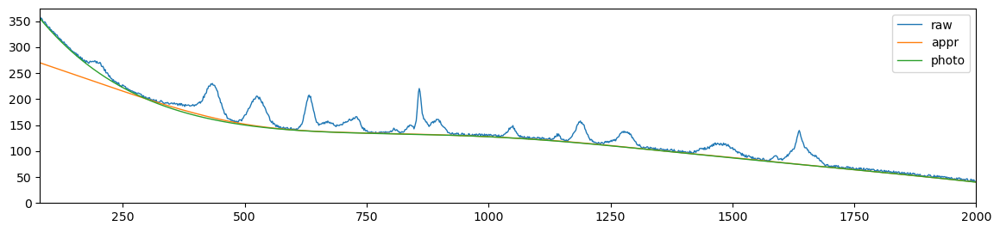

als_lambda: 853.1678524172814,	 als_p_weight: 3.5622478902624444e-05,	 error: 451.80463151671097, 	 smoothness: 0.4544972491298252, 	 smoothness: -0.5287428777972096


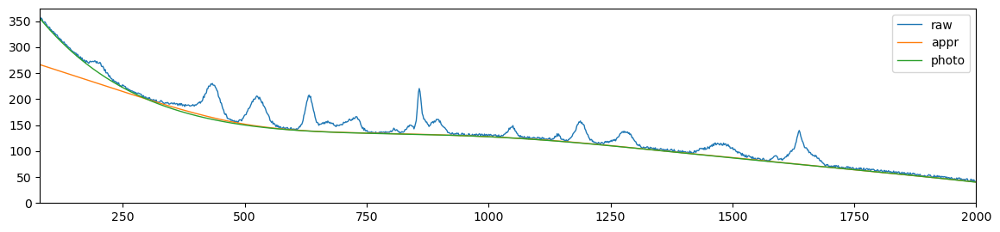

als_lambda: 853.1678524172814,	 als_p_weight: 2.592943797404667e-05,	 error: 469.1092754271054, 	 smoothness: 0.4594973051277335, 	 smoothness: -0.5302080280669514


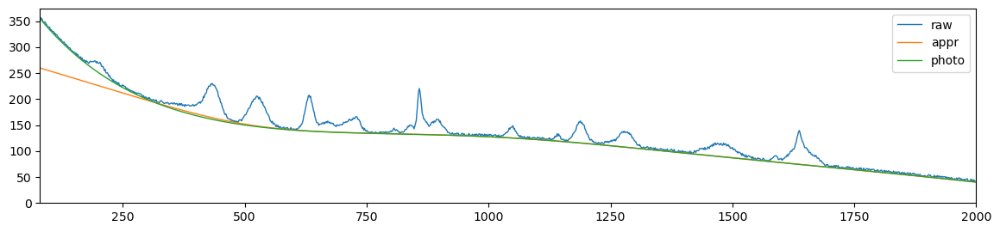

als_lambda: 853.1678524172814,	 als_p_weight: 1.8873918221350995e-05,	 error: 481.1433831554384, 	 smoothness: 0.4594303906888721, 	 smoothness: -0.530064528105164


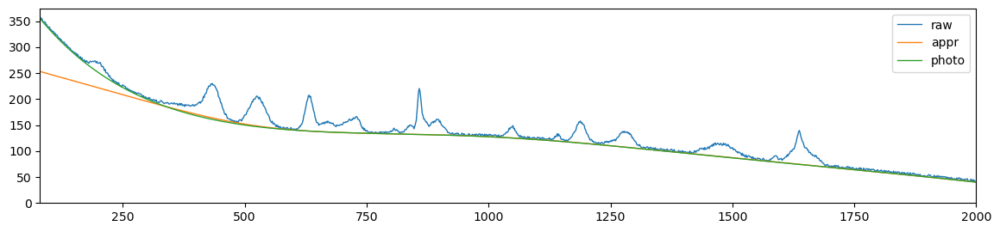

als_lambda: 853.1678524172814,	 als_p_weight: 1.3738237958832637e-05,	 error: 494.9615438916225, 	 smoothness: 0.46279255071512215, 	 smoothness: -0.5312502260557284


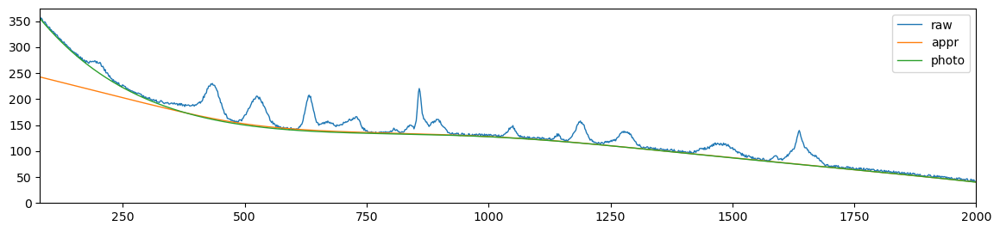

als_lambda: 853.1678524172814,	 als_p_weight: 1e-05,	 error: 514.2803152834969, 	 smoothness: 0.4652231768723928, 	 smoothness: -0.5322006166536347


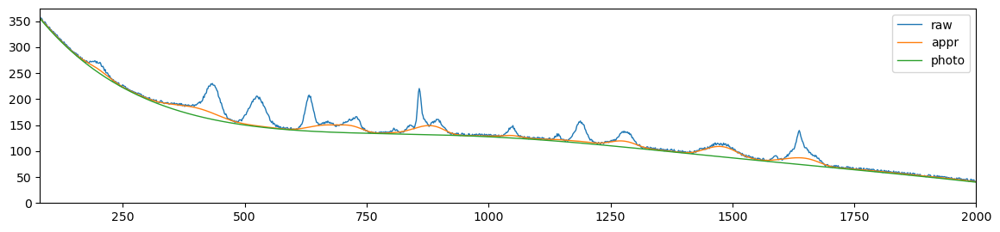

als_lambda: 1487.3521072935118,	 als_p_weight: 0.1,	 error: 77.58005566856386, 	 smoothness: 0.06506964660088282, 	 smoothness: -0.06111577678636184


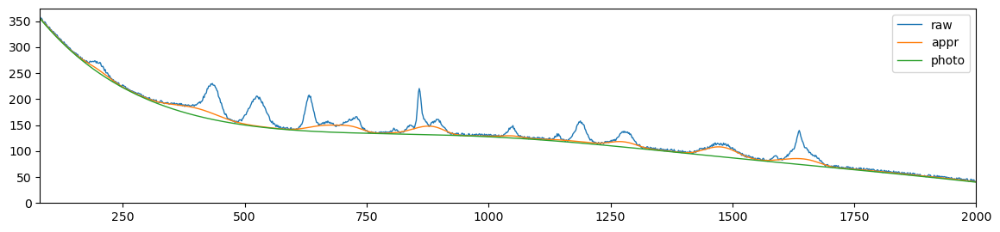

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0727895384398315,	 error: 70.60610178610223, 	 smoothness: 0.061737496421163746, 	 smoothness: -0.08217145670037841


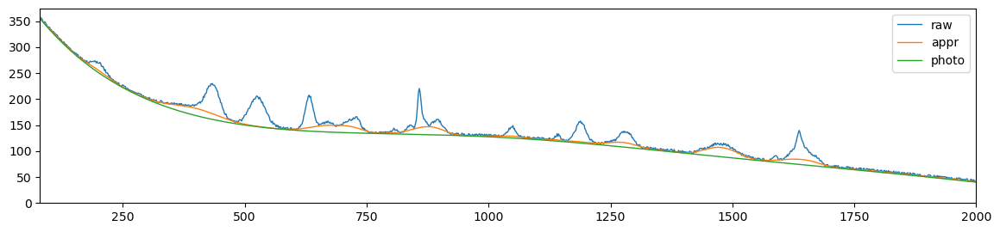

als_lambda: 1487.3521072935118,	 als_p_weight: 0.05298316906283707,	 error: 64.30832050597547, 	 smoothness: 0.060260463772596, 	 smoothness: -0.10466782789374081


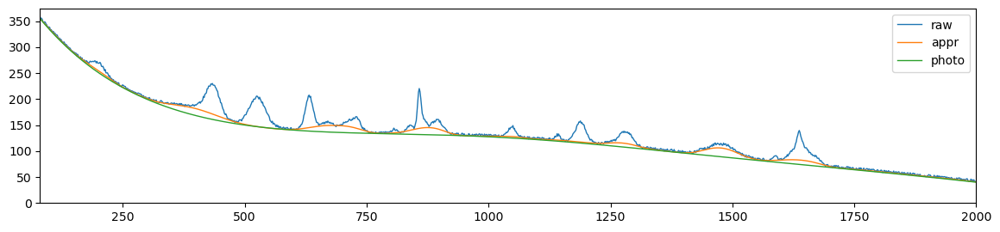

als_lambda: 1487.3521072935118,	 als_p_weight: 0.03856620421163472,	 error: 58.749364658938646, 	 smoothness: 0.061164473400167944, 	 smoothness: -0.1292965139889449


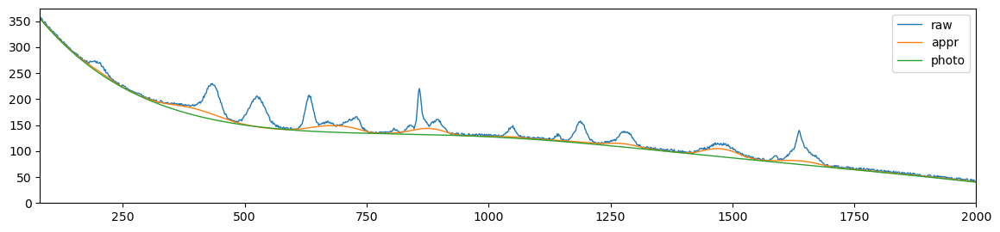

als_lambda: 1487.3521072935118,	 als_p_weight: 0.02807216203941177,	 error: 54.216209449061786, 	 smoothness: 0.06583170878674748, 	 smoothness: -0.15774324768106593


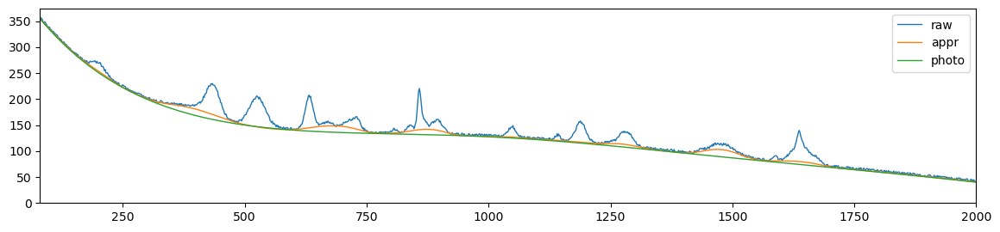

als_lambda: 1487.3521072935118,	 als_p_weight: 0.020433597178569417,	 error: 55.61477326716099, 	 smoothness: 0.08499835178308812, 	 smoothness: -0.1967296668586722


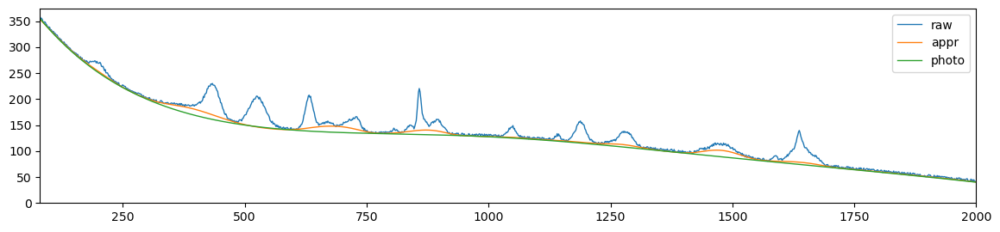

als_lambda: 1487.3521072935118,	 als_p_weight: 0.014873521072935119,	 error: 82.61391297866138, 	 smoothness: 0.15356941306932448, 	 smoothness: -0.26387144752035585


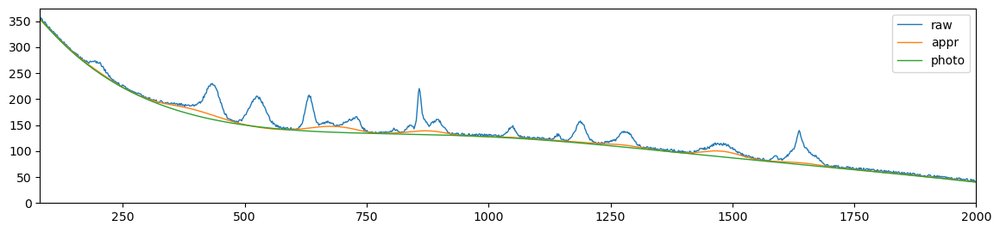

als_lambda: 1487.3521072935118,	 als_p_weight: 0.010826367338740546,	 error: 106.75513531941368, 	 smoothness: 0.2030895226511506, 	 smoothness: -0.31211874177638194


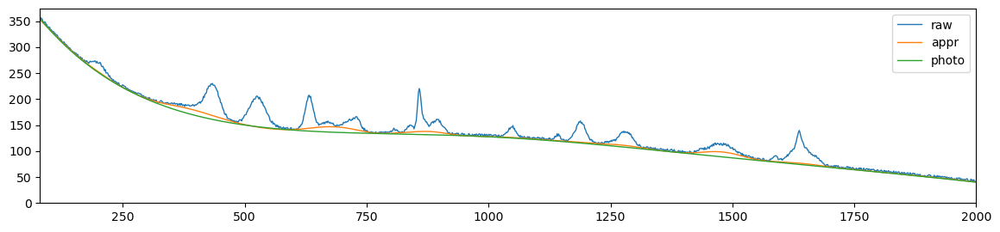

als_lambda: 1487.3521072935118,	 als_p_weight: 0.007880462815669913,	 error: 140.27107931284905, 	 smoothness: 0.2617942100786014, 	 smoothness: -0.36461901235986427


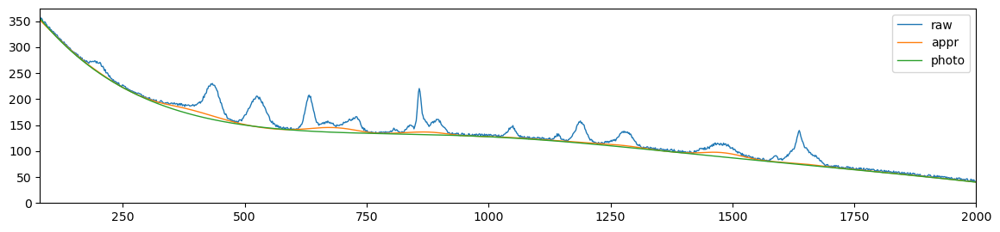

als_lambda: 1487.3521072935118,	 als_p_weight: 0.005736152510448681,	 error: 162.95836418350248, 	 smoothness: 0.2970909554792375, 	 smoothness: -0.39964598866523227


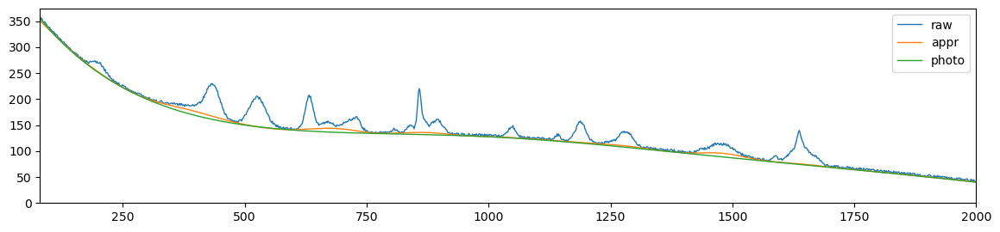

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0041753189365604,	 error: 182.6512574588888, 	 smoothness: 0.32235135395486375, 	 smoothness: -0.43005469011560427


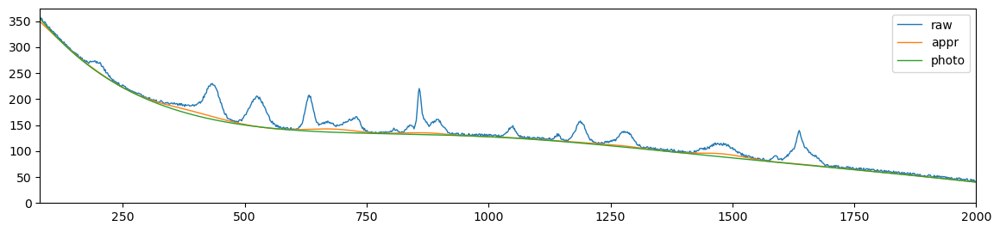

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0030391953823131978,	 error: 209.21219853756517, 	 smoothness: 0.3494093630240424, 	 smoothness: -0.45732387730961727


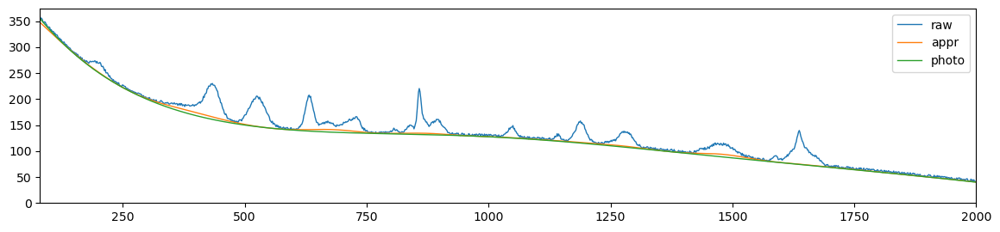

als_lambda: 1487.3521072935118,	 als_p_weight: 0.00221221629107045,	 error: 225.57155555018065, 	 smoothness: 0.3622203957425938, 	 smoothness: -0.47003373299320456


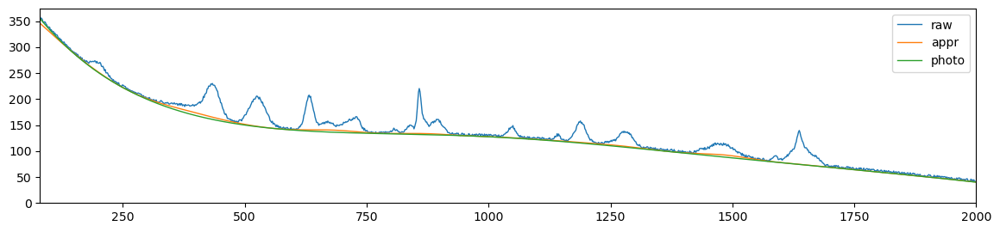

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0016102620275609393,	 error: 241.13854369913292, 	 smoothness: 0.37271291890770525, 	 smoothness: -0.4800617782516812


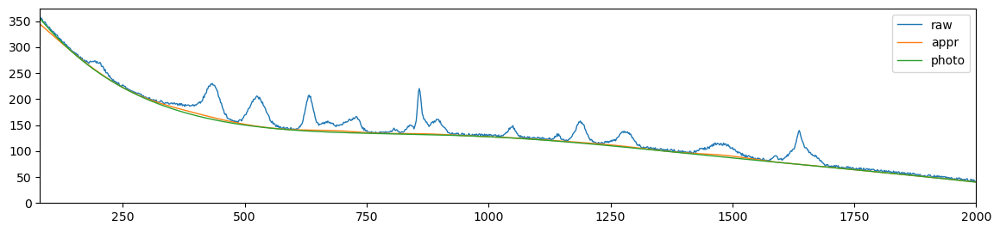

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0011721022975334804,	 error: 261.98956206264614, 	 smoothness: 0.38480811619723837, 	 smoothness: -0.48966565068512247


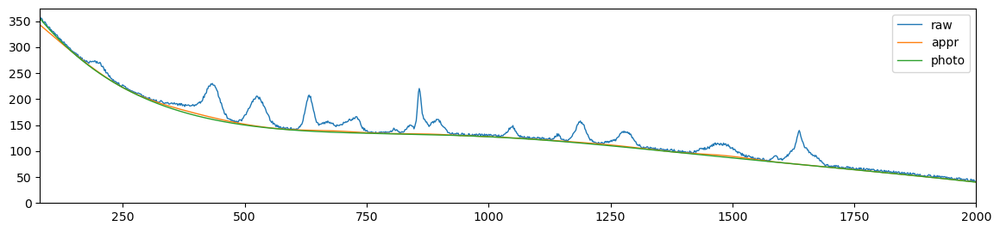

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0008531678524172806,	 error: 282.9214409609633, 	 smoothness: 0.3955160491405133, 	 smoothness: -0.4968160220713242


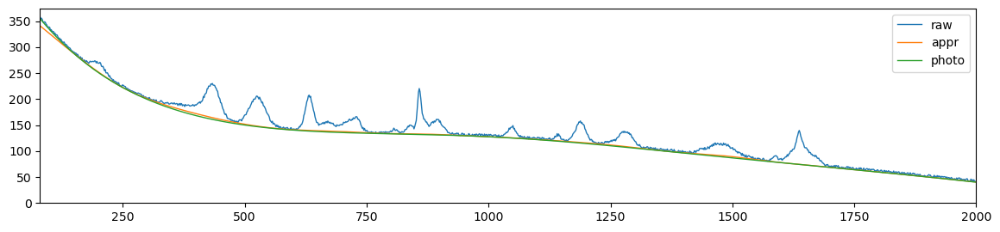

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0006210169418915617,	 error: 303.5875538866244, 	 smoothness: 0.40526074291488207, 	 smoothness: -0.5023694031614168


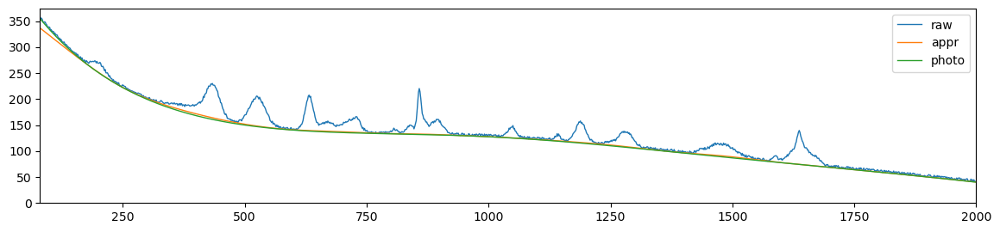

als_lambda: 1487.3521072935118,	 als_p_weight: 0.00045203536563602454,	 error: 327.1701840834487, 	 smoothness: 0.4155632917010623, 	 smoothness: -0.5081062521908251


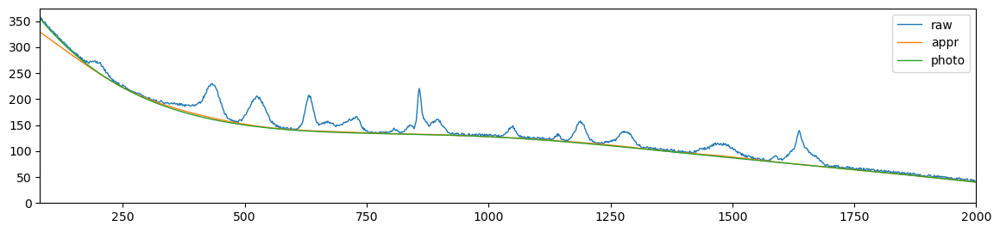

als_lambda: 1487.3521072935118,	 als_p_weight: 0.00032903445623126676,	 error: 351.56716276795976, 	 smoothness: 0.4252989451198962, 	 smoothness: -0.5133126127729678


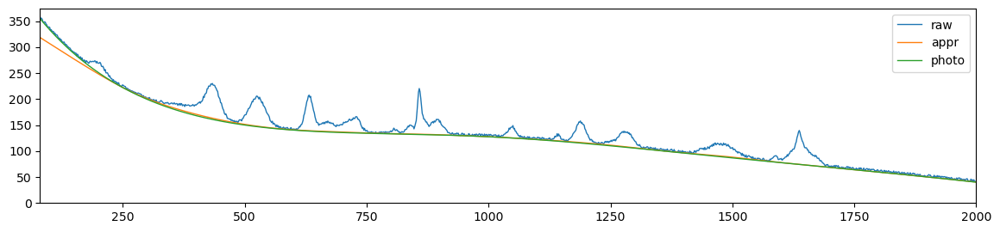

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0002395026619987486,	 error: 377.99938063146465, 	 smoothness: 0.43490732518326425, 	 smoothness: -0.5176944000561735


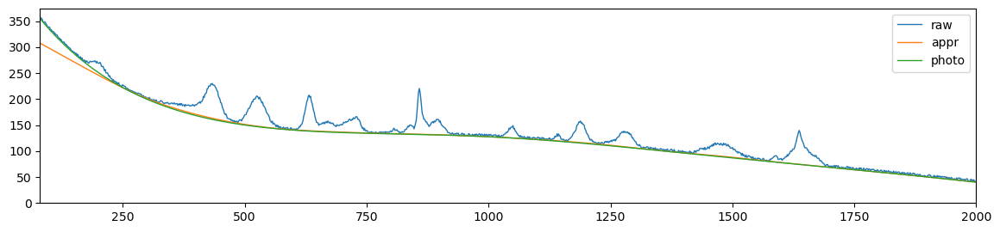

als_lambda: 1487.3521072935118,	 als_p_weight: 0.00017433288221999874,	 error: 403.9307330898804, 	 smoothness: 0.4433909426196372, 	 smoothness: -0.5212639227737401


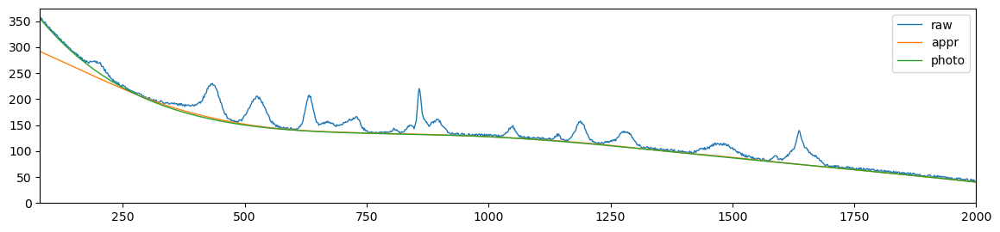

als_lambda: 1487.3521072935118,	 als_p_weight: 0.0001268961003167922,	 error: 428.91914897639805, 	 smoothness: 0.45087011914863717, 	 smoothness: -0.5247992491007676


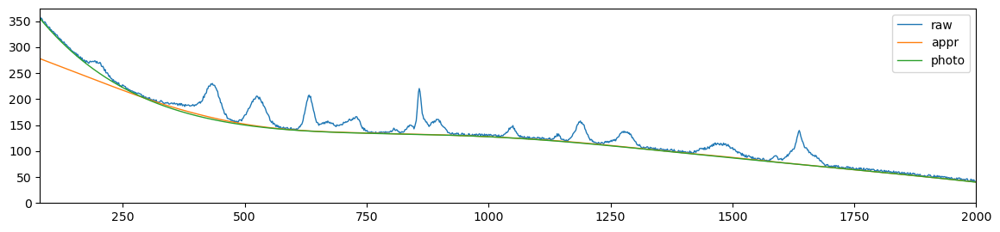

als_lambda: 1487.3521072935118,	 als_p_weight: 9.236708571873866e-05,	 error: 458.2031218213222, 	 smoothness: 0.4590297891071288, 	 smoothness: -0.5281311051159487


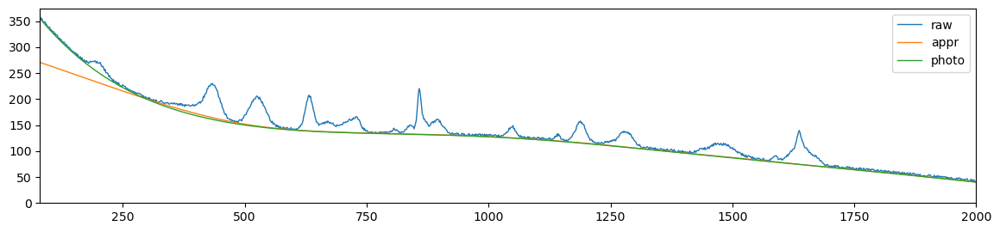

als_lambda: 1487.3521072935118,	 als_p_weight: 6.723357536499335e-05,	 error: 481.6045482946351, 	 smoothness: 0.4648906768710433, 	 smoothness: -0.5306242985441956


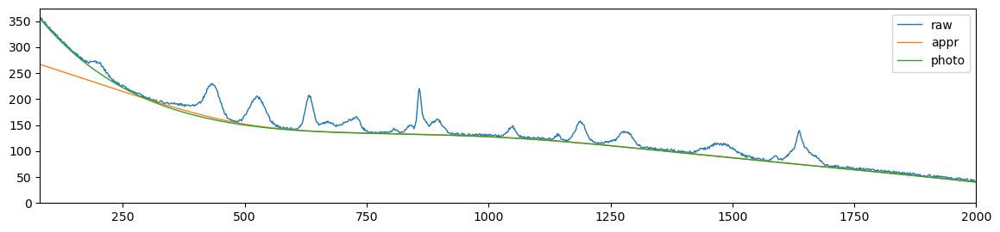

als_lambda: 1487.3521072935118,	 als_p_weight: 4.893900918477499e-05,	 error: 504.9399297592788, 	 smoothness: 0.4701742987049114, 	 smoothness: -0.5327037466705753


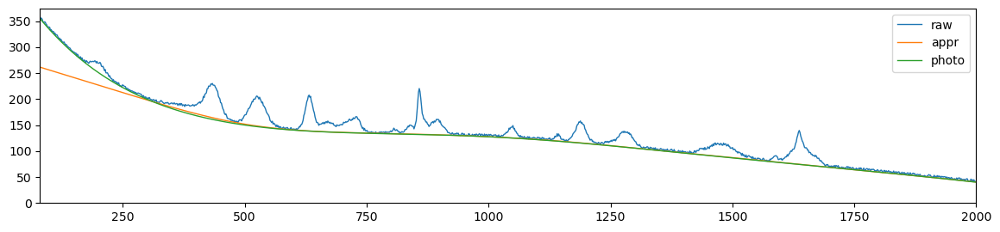

als_lambda: 1487.3521072935118,	 als_p_weight: 3.5622478902624444e-05,	 error: 526.5989689735851, 	 smoothness: 0.4737553061957536, 	 smoothness: -0.5347127543860932


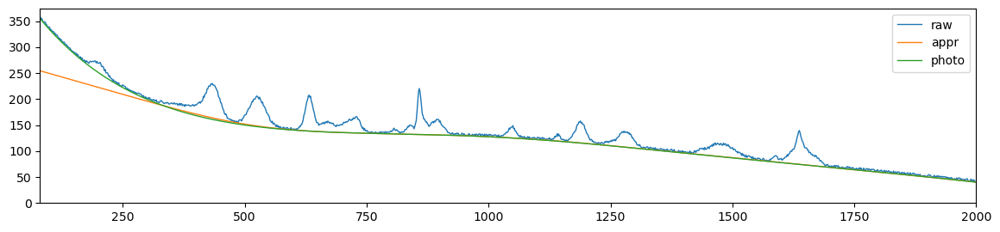

als_lambda: 1487.3521072935118,	 als_p_weight: 2.592943797404667e-05,	 error: 549.5201644494409, 	 smoothness: 0.47947229152398785, 	 smoothness: -0.5360948695837426


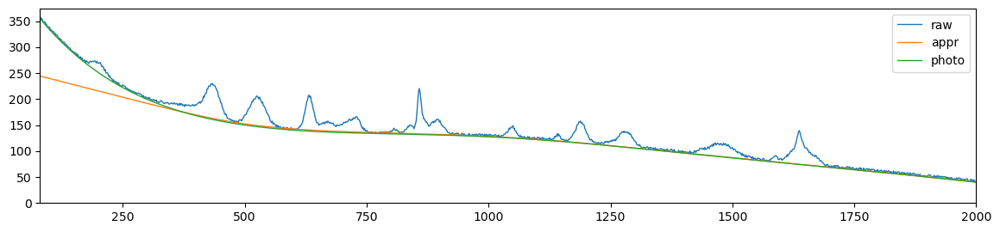

als_lambda: 1487.3521072935118,	 als_p_weight: 1.8873918221350995e-05,	 error: 585.3392758094109, 	 smoothness: 0.4848725225420004, 	 smoothness: -0.5384812362937361


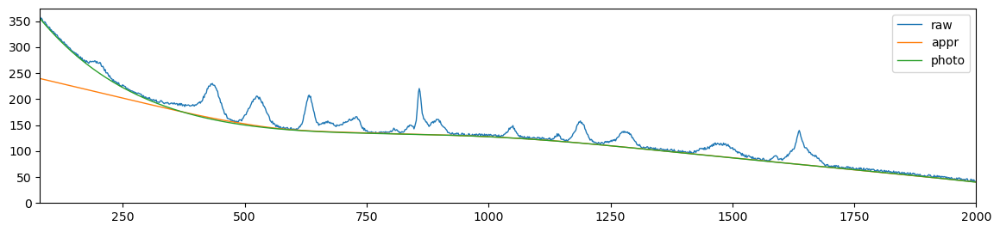

als_lambda: 1487.3521072935118,	 als_p_weight: 1.3738237958832637e-05,	 error: 606.2968632552304, 	 smoothness: 0.48709521208579815, 	 smoothness: -0.5394438645585501


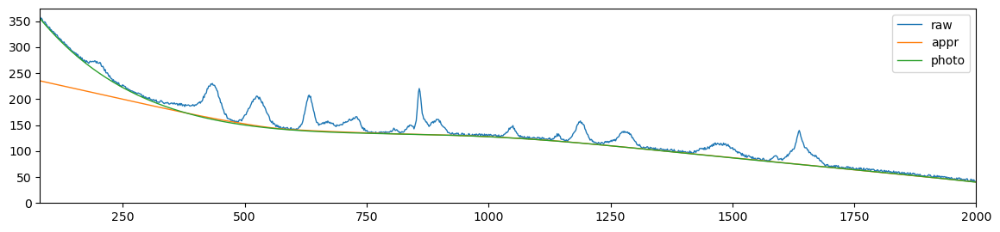

als_lambda: 1487.3521072935118,	 als_p_weight: 1e-05,	 error: 624.3415307795381, 	 smoothness: 0.48880042456993605, 	 smoothness: -0.540476527018264


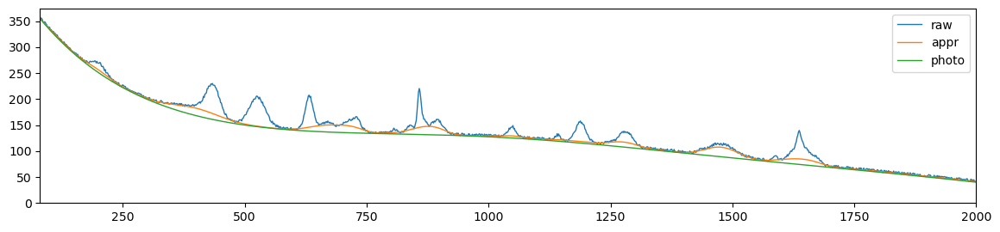

als_lambda: 2592.943797404667,	 als_p_weight: 0.1,	 error: 71.15434710174571, 	 smoothness: 0.06020244110217643, 	 smoothness: -0.10076127047506583


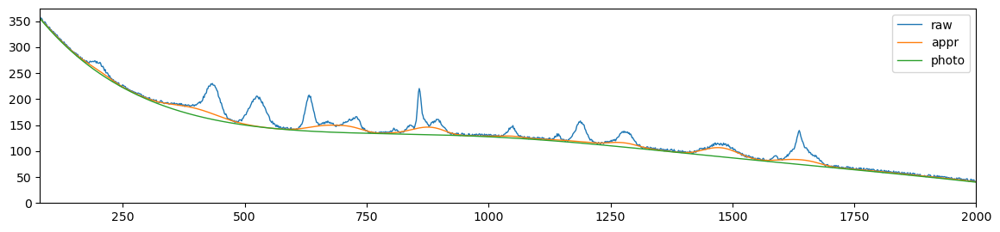

als_lambda: 2592.943797404667,	 als_p_weight: 0.0727895384398315,	 error: 64.59815006544758, 	 smoothness: 0.06047760162044465, 	 smoothness: -0.12411332029301798


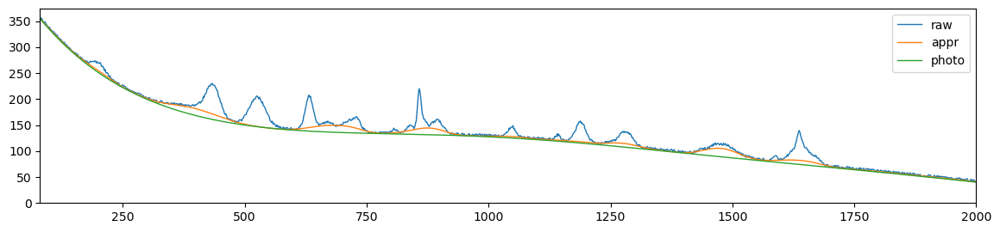

als_lambda: 2592.943797404667,	 als_p_weight: 0.05298316906283707,	 error: 59.028868936442706, 	 smoothness: 0.06386962616610782, 	 smoothness: -0.15071634591169844


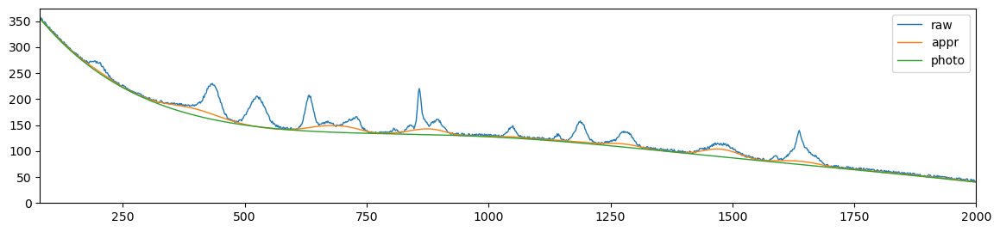

als_lambda: 2592.943797404667,	 als_p_weight: 0.03856620421163472,	 error: 57.82405390738434, 	 smoothness: 0.07862199238937129, 	 smoothness: -0.18646966454880334


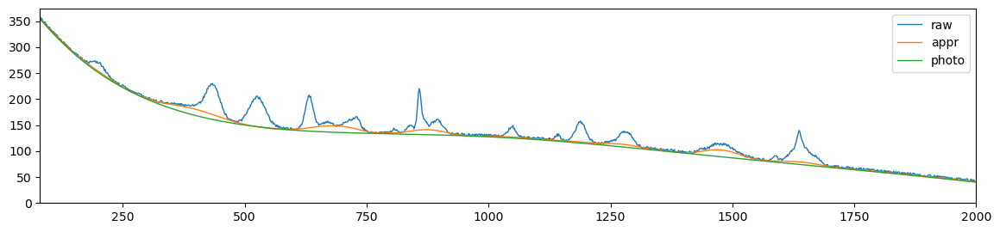

als_lambda: 2592.943797404667,	 als_p_weight: 0.02807216203941177,	 error: 73.73655566731759, 	 smoothness: 0.1275174117446437, 	 smoothness: -0.24359969846759907


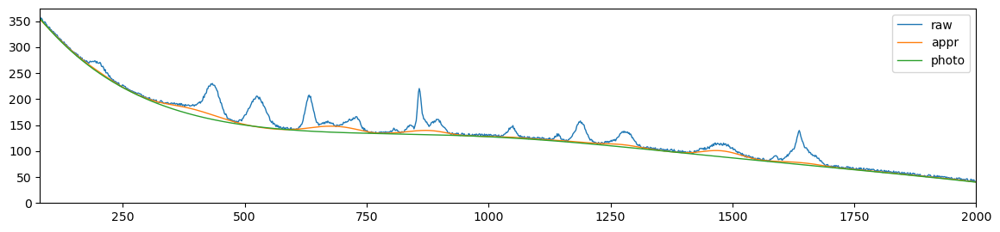

als_lambda: 2592.943797404667,	 als_p_weight: 0.020433597178569417,	 error: 103.31389765034129, 	 smoothness: 0.190893622540869, 	 smoothness: -0.2989939352764825


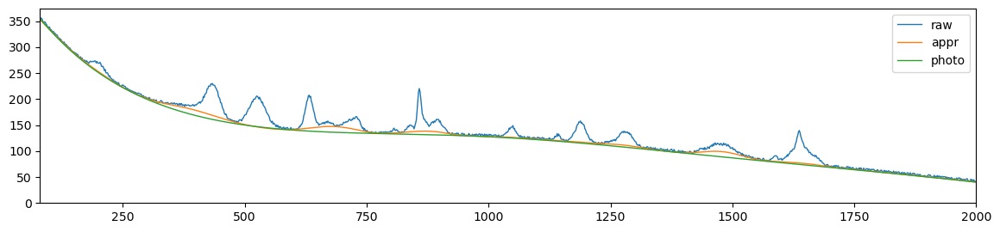

als_lambda: 2592.943797404667,	 als_p_weight: 0.014873521072935119,	 error: 138.0966536000663, 	 smoothness: 0.25405656937165216, 	 smoothness: -0.35557426305086515


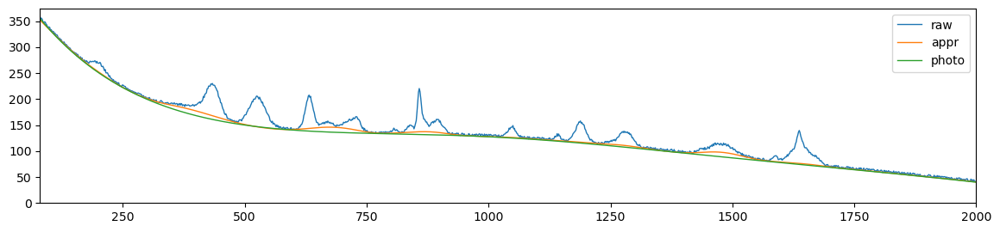

als_lambda: 2592.943797404667,	 als_p_weight: 0.010826367338740546,	 error: 162.13251223022118, 	 smoothness: 0.2928314909917319, 	 smoothness: -0.39347622232006685


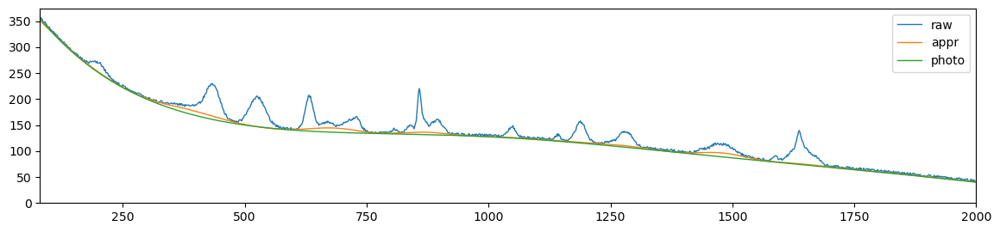

als_lambda: 2592.943797404667,	 als_p_weight: 0.007880462815669913,	 error: 177.93478149702446, 	 smoothness: 0.3155988297122619, 	 smoothness: -0.42239139561706696


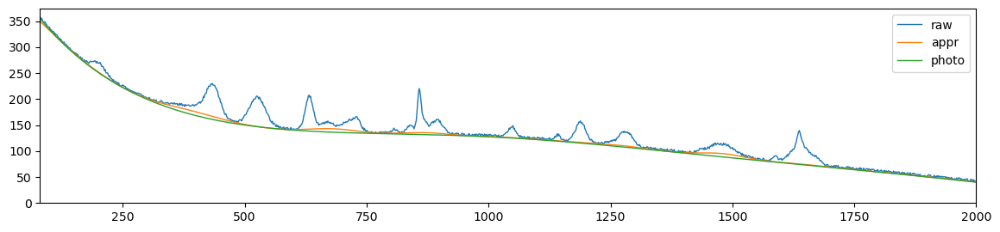

als_lambda: 2592.943797404667,	 als_p_weight: 0.005736152510448681,	 error: 205.6447027750446, 	 smoothness: 0.34569236138337817, 	 smoothness: -0.4532500124293073


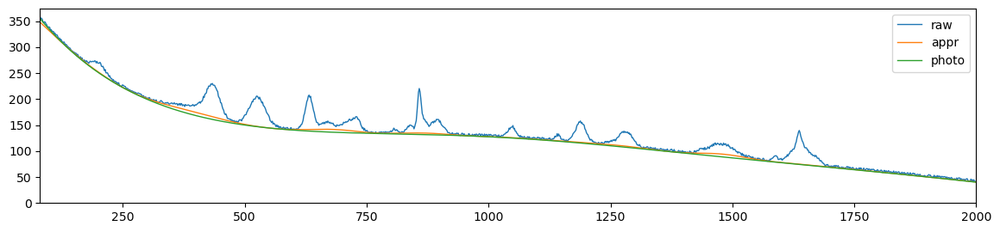

als_lambda: 2592.943797404667,	 als_p_weight: 0.0041753189365604,	 error: 223.7778667375581, 	 smoothness: 0.3606444217896463, 	 smoothness: -0.4682504627897472


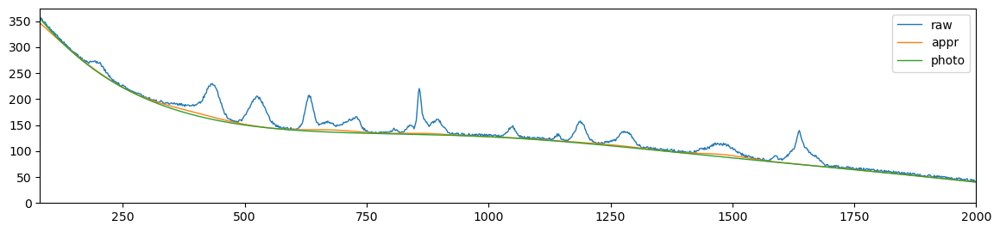

als_lambda: 2592.943797404667,	 als_p_weight: 0.0030391953823131978,	 error: 237.74343618212035, 	 smoothness: 0.3704628473093823, 	 smoothness: -0.4779567895353978


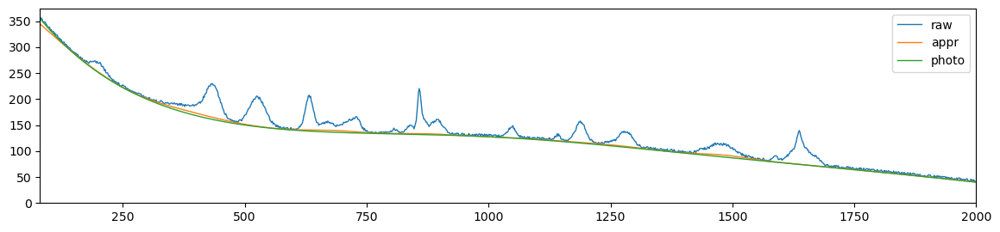

als_lambda: 2592.943797404667,	 als_p_weight: 0.00221221629107045,	 error: 258.29700192172714, 	 smoothness: 0.3826295926467152, 	 smoothness: -0.48790650746092235


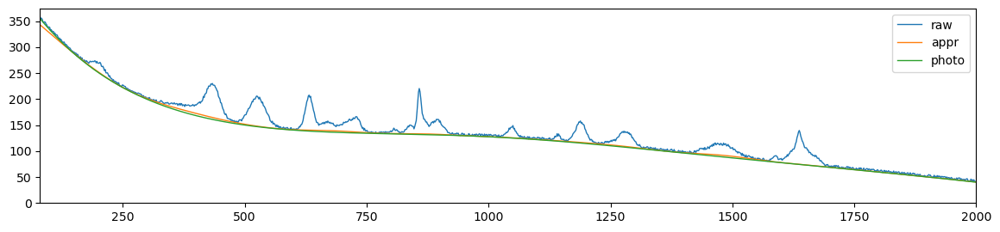

als_lambda: 2592.943797404667,	 als_p_weight: 0.0016102620275609393,	 error: 279.2748438371249, 	 smoothness: 0.3935892697025698, 	 smoothness: -0.49551575572202095


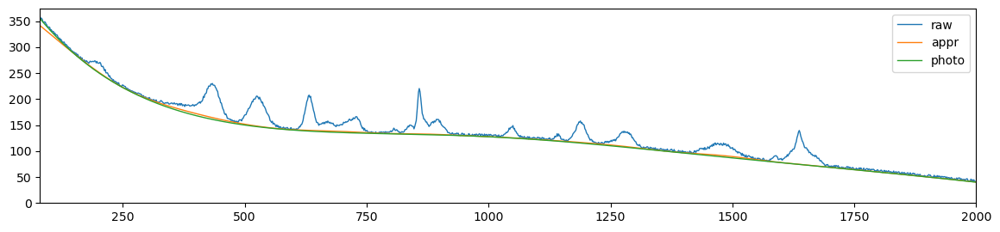

als_lambda: 2592.943797404667,	 als_p_weight: 0.0011721022975334804,	 error: 300.5617534631614, 	 smoothness: 0.4036677966553546, 	 smoothness: -0.5012778491014662


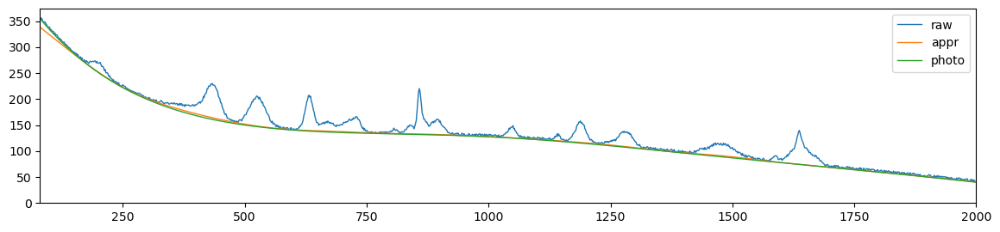

als_lambda: 2592.943797404667,	 als_p_weight: 0.0008531678524172806,	 error: 323.3468925690185, 	 smoothness: 0.4138238427080951, 	 smoothness: -0.5070286116140218


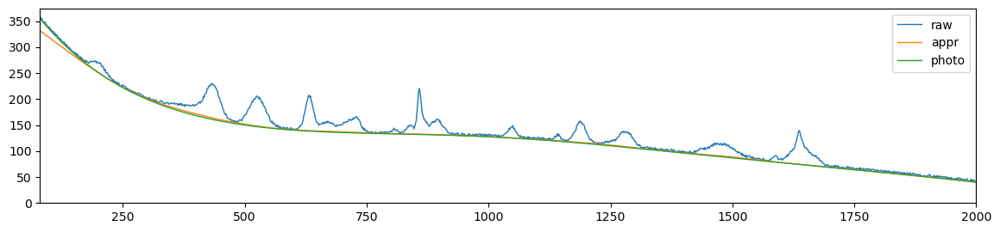

als_lambda: 2592.943797404667,	 als_p_weight: 0.0006210169418915617,	 error: 349.0271788277749, 	 smoothness: 0.4240995843622067, 	 smoothness: -0.5124110946695983


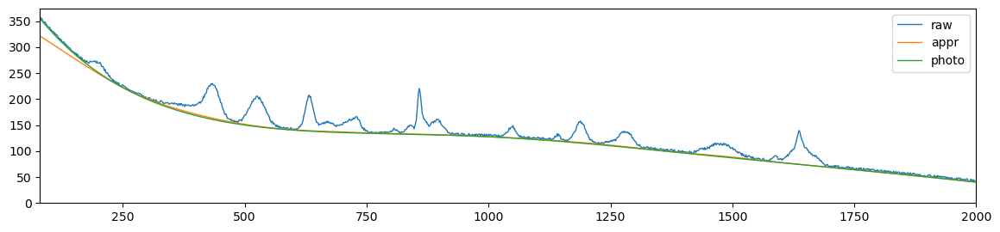

als_lambda: 2592.943797404667,	 als_p_weight: 0.00045203536563602454,	 error: 376.03145351968664, 	 smoothness: 0.4340685350700323, 	 smoothness: -0.5171226393307811


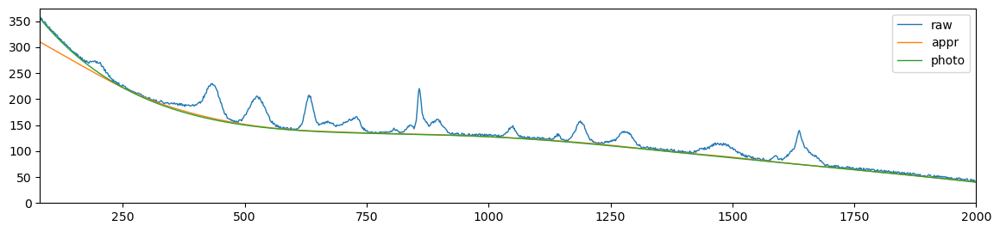

als_lambda: 2592.943797404667,	 als_p_weight: 0.00032903445623126676,	 error: 403.79444581133765, 	 smoothness: 0.44335800336176817, 	 smoothness: -0.520924507641971


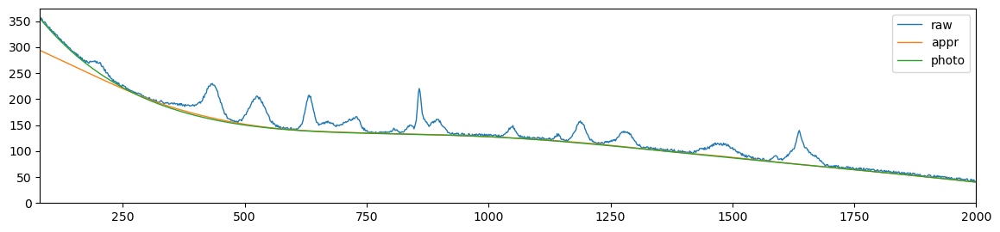

als_lambda: 2592.943797404667,	 als_p_weight: 0.0002395026619987486,	 error: 432.9932332527614, 	 smoothness: 0.45241260248580195, 	 smoothness: -0.524597873292435


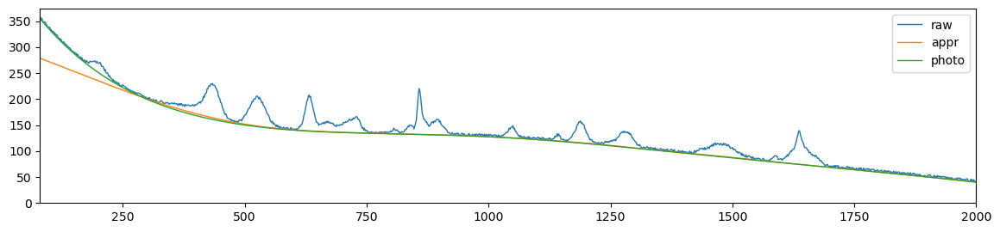

als_lambda: 2592.943797404667,	 als_p_weight: 0.00017433288221999874,	 error: 461.5533753026034, 	 smoothness: 0.46065341508399493, 	 smoothness: -0.5279755141932289


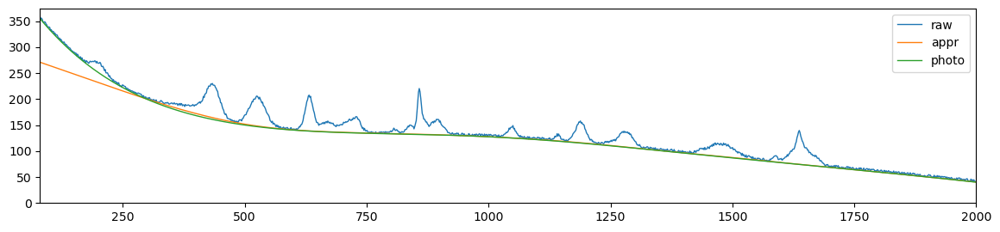

als_lambda: 2592.943797404667,	 als_p_weight: 0.0001268961003167922,	 error: 492.39312163355294, 	 smoothness: 0.46794744902211194, 	 smoothness: -0.5311128316852948


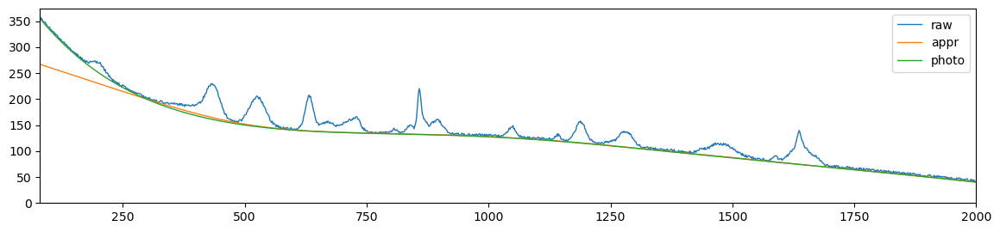

als_lambda: 2592.943797404667,	 als_p_weight: 9.236708571873866e-05,	 error: 524.5741612996006, 	 smoothness: 0.4748863084247995, 	 smoothness: -0.5336341169941714


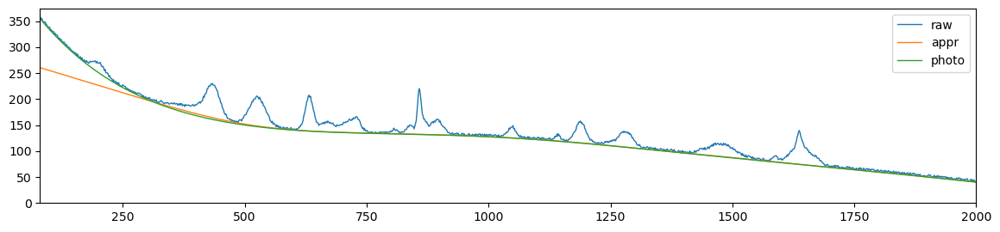

als_lambda: 2592.943797404667,	 als_p_weight: 6.723357536499335e-05,	 error: 553.5346830054517, 	 smoothness: 0.48094392497435234, 	 smoothness: -0.5356365848422864


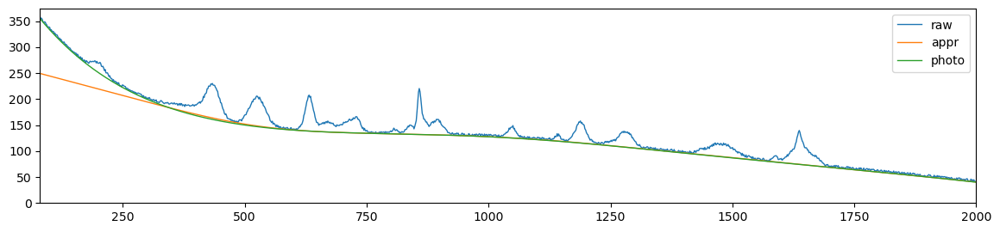

als_lambda: 2592.943797404667,	 als_p_weight: 4.893900918477499e-05,	 error: 585.3209246464063, 	 smoothness: 0.48642849506670827, 	 smoothness: -0.5375076269302562


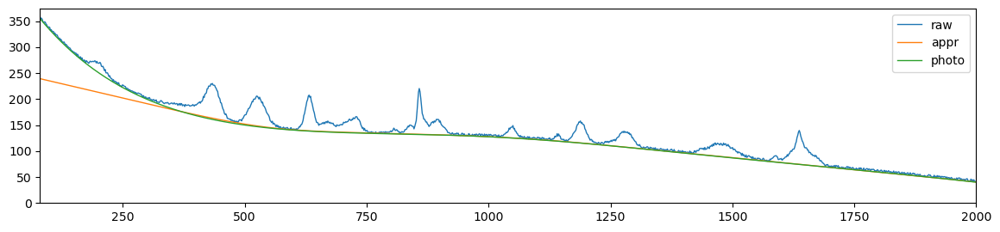

als_lambda: 2592.943797404667,	 als_p_weight: 3.5622478902624444e-05,	 error: 616.0385483833418, 	 smoothness: 0.4915509461800555, 	 smoothness: -0.5396475039053267


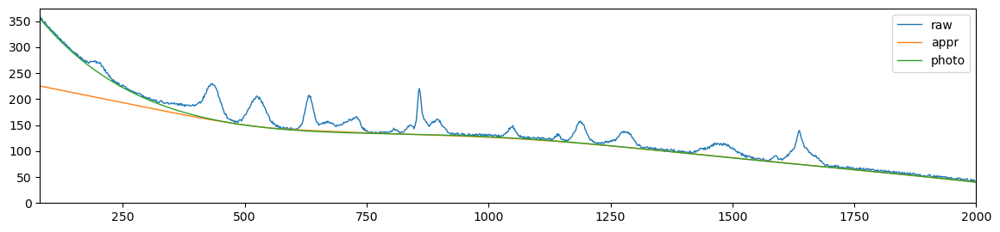

als_lambda: 2592.943797404667,	 als_p_weight: 2.592943797404667e-05,	 error: 651.9410961876454, 	 smoothness: 0.49635952224993907, 	 smoothness: -0.54164671051125


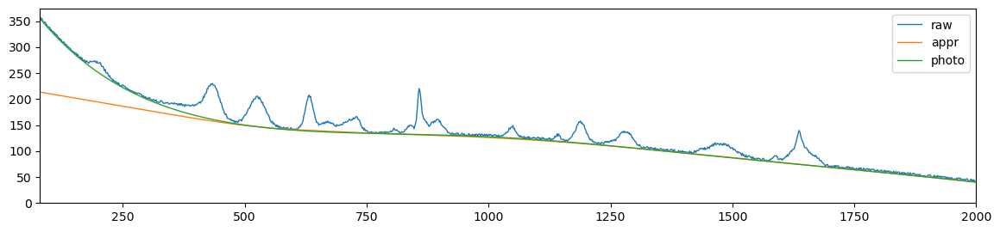

als_lambda: 2592.943797404667,	 als_p_weight: 1.8873918221350995e-05,	 error: 684.7883885180458, 	 smoothness: 0.499414761646935, 	 smoothness: -0.5428403829592812


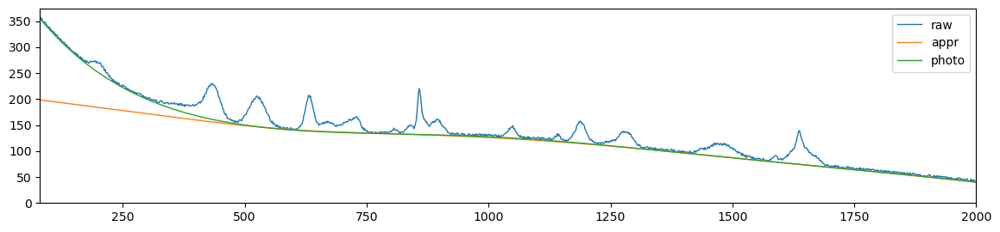

als_lambda: 2592.943797404667,	 als_p_weight: 1.3738237958832637e-05,	 error: 713.4078481375619, 	 smoothness: 0.5040150733375437, 	 smoothness: -0.5438327749255812


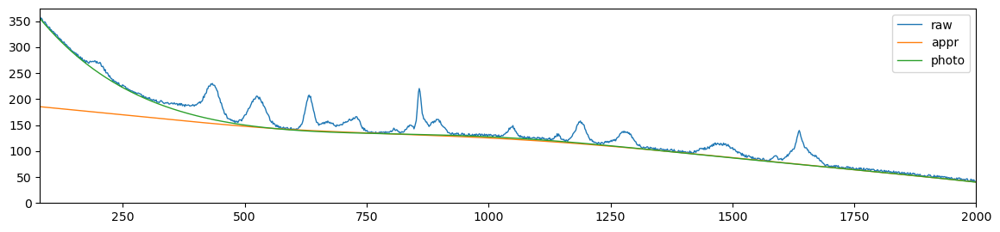

als_lambda: 2592.943797404667,	 als_p_weight: 1e-05,	 error: 750.2524414980135, 	 smoothness: 0.5077342720880339, 	 smoothness: -0.54499063873007


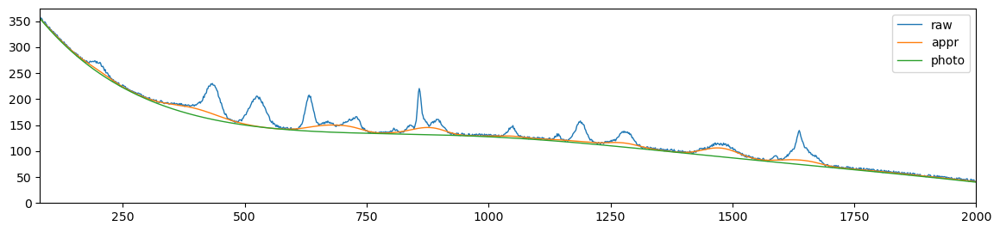

als_lambda: 4520.353656360246,	 als_p_weight: 0.1,	 error: 65.64928665686323, 	 smoothness: 0.06245037048648592, 	 smoothness: -0.1450077092631477


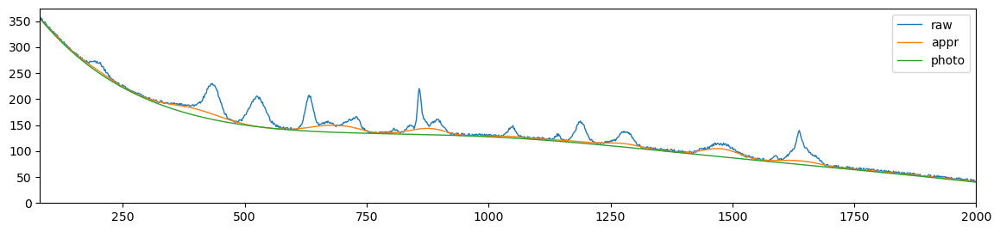

als_lambda: 4520.353656360246,	 als_p_weight: 0.0727895384398315,	 error: 60.508457838714484, 	 smoothness: 0.07037520795592697, 	 smoothness: -0.17588991571920676


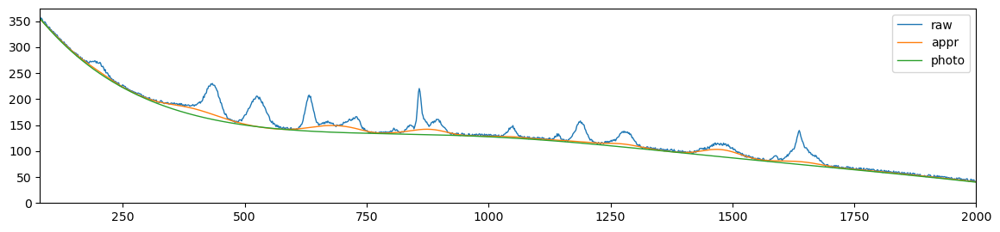

als_lambda: 4520.353656360246,	 als_p_weight: 0.05298316906283707,	 error: 68.66707261908533, 	 smoothness: 0.10632328141466674, 	 smoothness: -0.22490674434074484


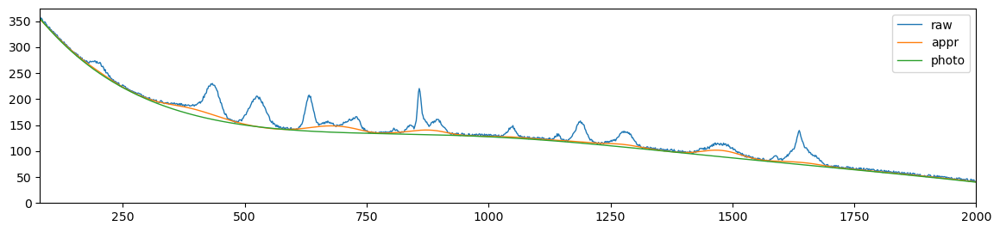

als_lambda: 4520.353656360246,	 als_p_weight: 0.03856620421163472,	 error: 102.99191599341974, 	 smoothness: 0.18136481549543934, 	 smoothness: -0.28797434835819957


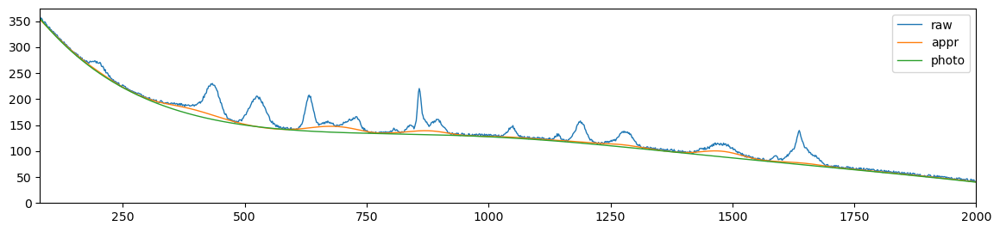

als_lambda: 4520.353656360246,	 als_p_weight: 0.02807216203941177,	 error: 131.89158371856422, 	 smoothness: 0.23913060651157225, 	 smoothness: -0.3430991223102024


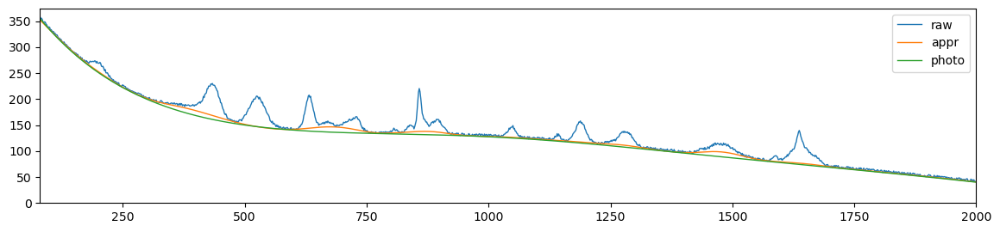

als_lambda: 4520.353656360246,	 als_p_weight: 0.020433597178569417,	 error: 160.9961047321978, 	 smoothness: 0.28736848831887374, 	 smoothness: -0.3864644217519426


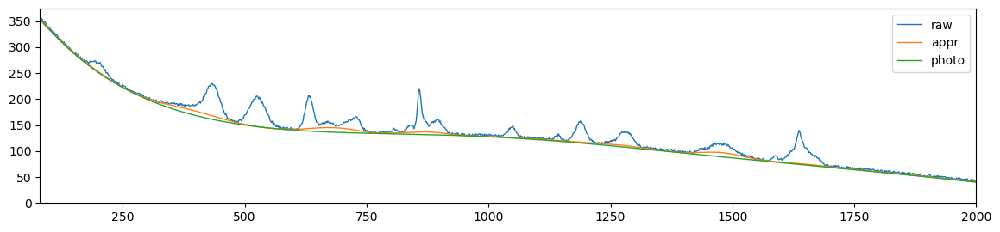

als_lambda: 4520.353656360246,	 als_p_weight: 0.014873521072935119,	 error: 175.81075441505237, 	 smoothness: 0.3101695521873388, 	 smoothness: -0.41458887910151326


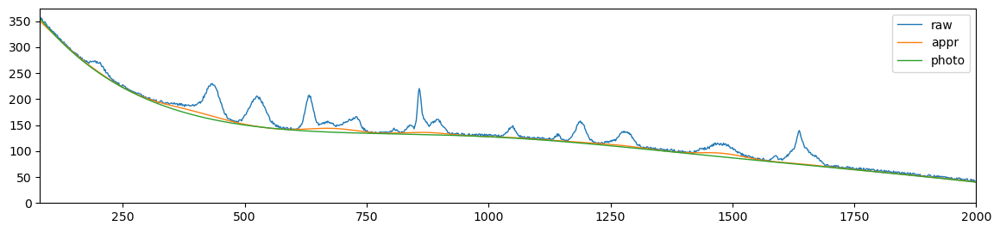

als_lambda: 4520.353656360246,	 als_p_weight: 0.010826367338740546,	 error: 201.4561109462237, 	 smoothness: 0.3403612589585491, 	 smoothness: -0.4472384587660775


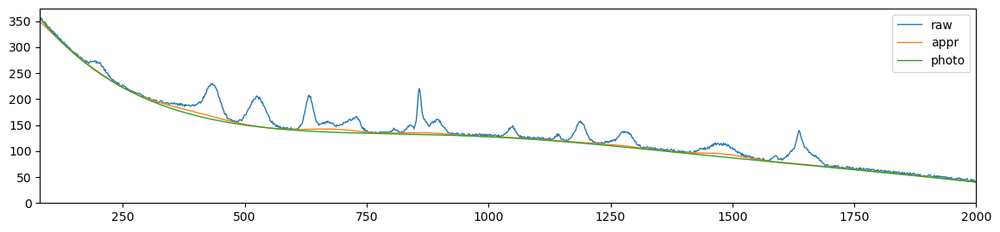

als_lambda: 4520.353656360246,	 als_p_weight: 0.007880462815669913,	 error: 221.5790109630308, 	 smoothness: 0.3583449072493128, 	 smoothness: -0.4657651202724813


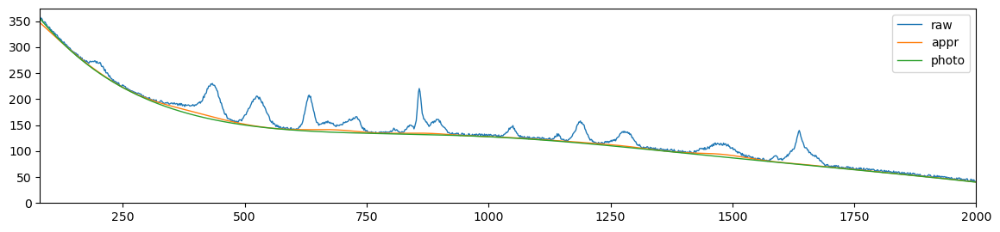

als_lambda: 4520.353656360246,	 als_p_weight: 0.005736152510448681,	 error: 235.00174309906873, 	 smoothness: 0.36830162268174343, 	 smoothness: -0.47546445442573604


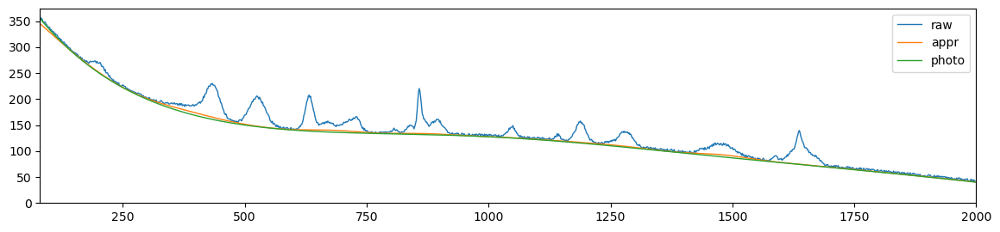

als_lambda: 4520.353656360246,	 als_p_weight: 0.0041753189365604,	 error: 253.68250300166517, 	 smoothness: 0.3800850704194577, 	 smoothness: -0.48588523119057675


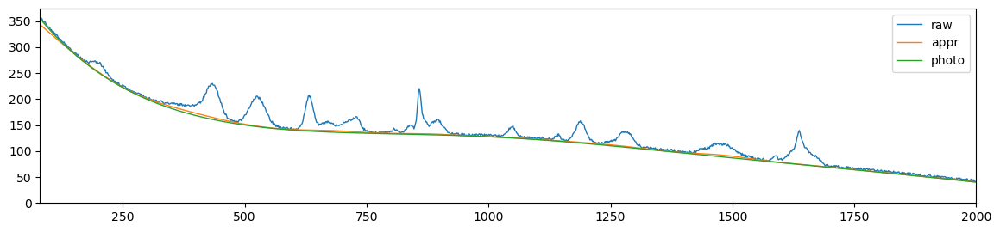

als_lambda: 4520.353656360246,	 als_p_weight: 0.0030391953823131978,	 error: 275.8035720883875, 	 smoothness: 0.3916909952017409, 	 smoothness: -0.49416252525800813


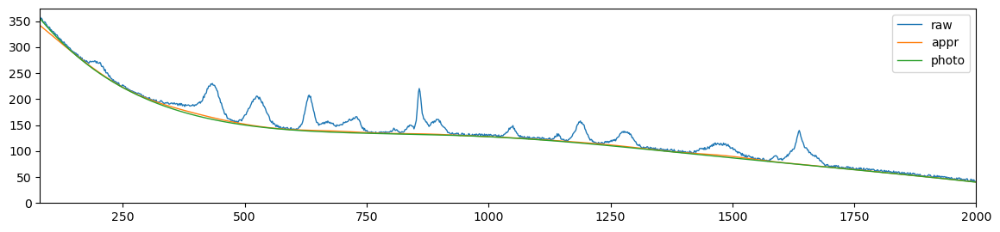

als_lambda: 4520.353656360246,	 als_p_weight: 0.00221221629107045,	 error: 296.31135880722644, 	 smoothness: 0.40167619080576455, 	 smoothness: -0.5000775445498743


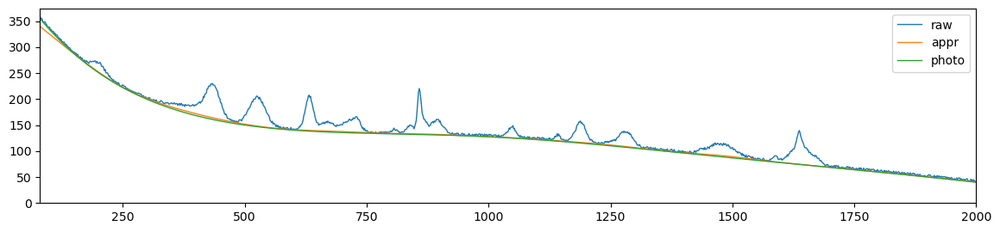

als_lambda: 4520.353656360246,	 als_p_weight: 0.0016102620275609393,	 error: 317.46423094779584, 	 smoothness: 0.4114387049663029, 	 smoothness: -0.5054874334456343


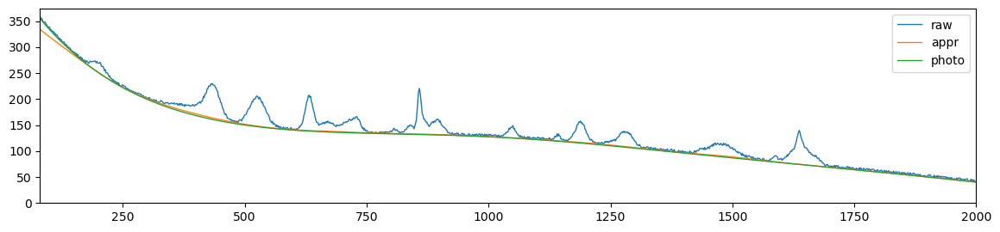

als_lambda: 4520.353656360246,	 als_p_weight: 0.0011721022975334804,	 error: 342.54692924281494, 	 smoothness: 0.4217947798295763, 	 smoothness: -0.511218239688641


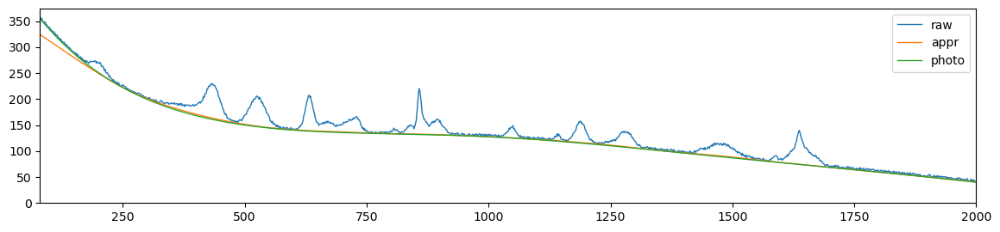

als_lambda: 4520.353656360246,	 als_p_weight: 0.0008531678524172806,	 error: 369.50301993513966, 	 smoothness: 0.4319142230479671, 	 smoothness: -0.5162277690783941


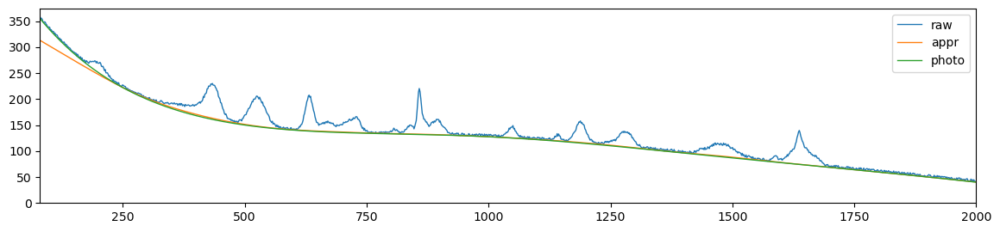

als_lambda: 4520.353656360246,	 als_p_weight: 0.0006210169418915617,	 error: 397.41165933453203, 	 smoothness: 0.44146189021353677, 	 smoothness: -0.5200792841994012


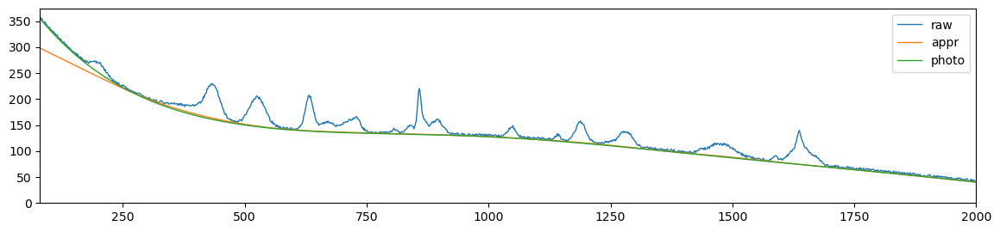

als_lambda: 4520.353656360246,	 als_p_weight: 0.00045203536563602454,	 error: 427.15448807392914, 	 smoothness: 0.4508171620529518, 	 smoothness: -0.5237817177232151


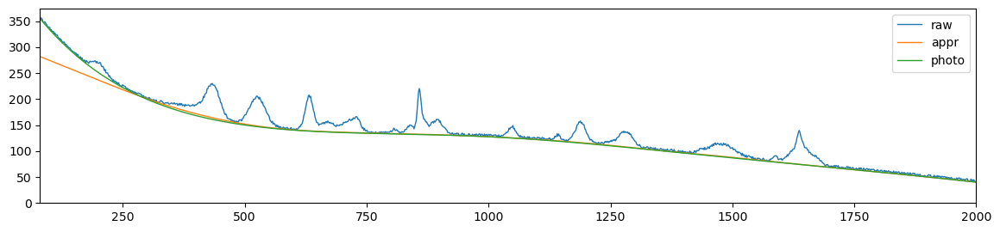

als_lambda: 4520.353656360246,	 als_p_weight: 0.00032903445623126676,	 error: 458.19084568512983, 	 smoothness: 0.4597565445943544, 	 smoothness: -0.5273919756935208


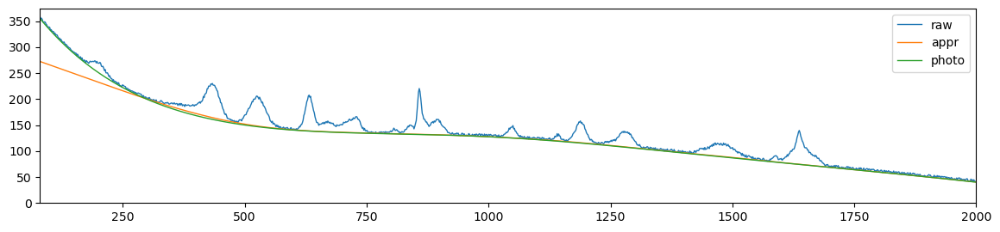

als_lambda: 4520.353656360246,	 als_p_weight: 0.0002395026619987486,	 error: 493.46072160820387, 	 smoothness: 0.4685729162519383, 	 smoothness: -0.5308102730229108


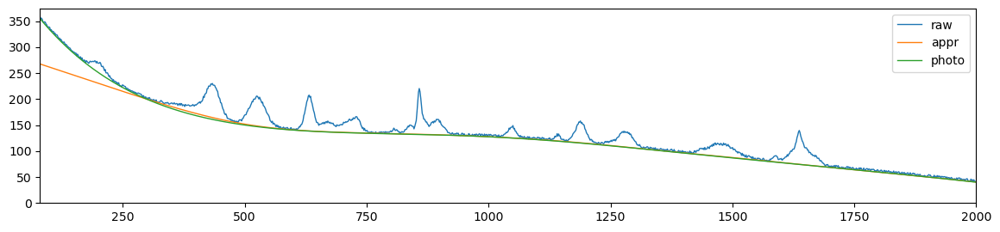

als_lambda: 4520.353656360246,	 als_p_weight: 0.00017433288221999874,	 error: 531.4350257967835, 	 smoothness: 0.47702853422006297, 	 smoothness: -0.5336044428966051


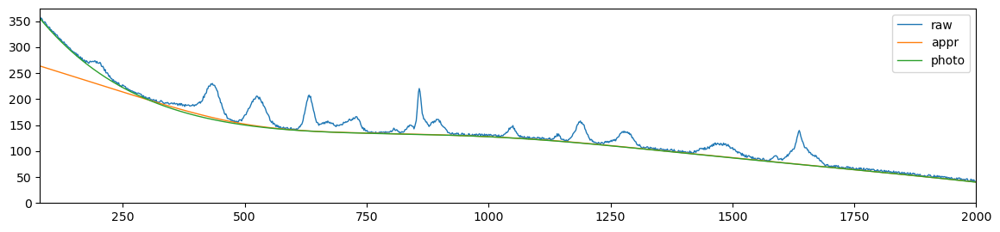

als_lambda: 4520.353656360246,	 als_p_weight: 0.0001268961003167922,	 error: 563.4348150898311, 	 smoothness: 0.483691864327868, 	 smoothness: -0.5358205333386107


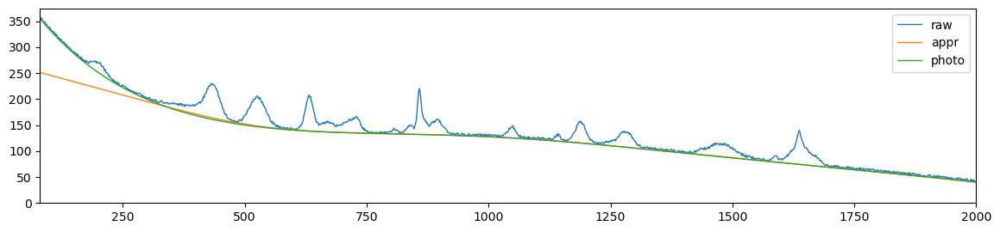

als_lambda: 4520.353656360246,	 als_p_weight: 9.236708571873866e-05,	 error: 599.2274482706823, 	 smoothness: 0.4902906052211635, 	 smoothness: -0.5379148259684149


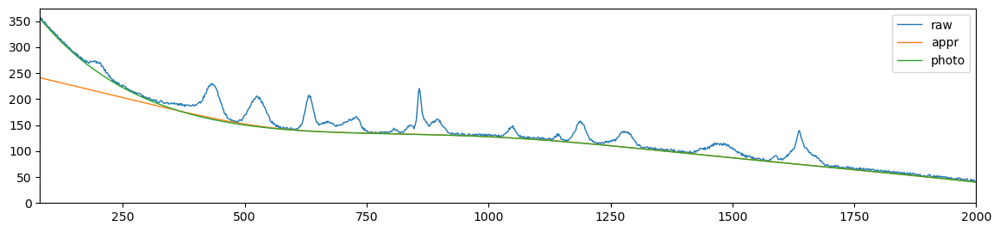

als_lambda: 4520.353656360246,	 als_p_weight: 6.723357536499335e-05,	 error: 638.2832298551598, 	 smoothness: 0.49629068399069254, 	 smoothness: -0.5403135566242245


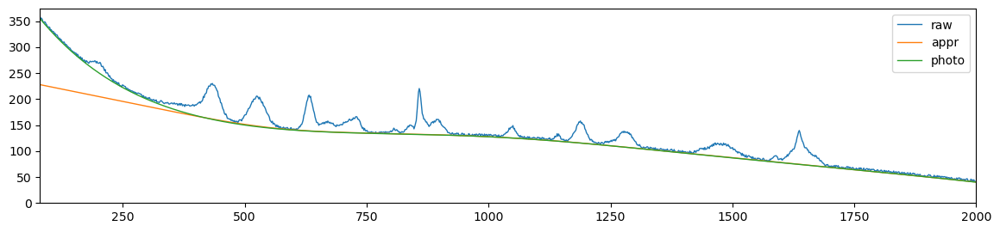

als_lambda: 4520.353656360246,	 als_p_weight: 4.893900918477499e-05,	 error: 673.7253069044679, 	 smoothness: 0.5015356231608405, 	 smoothness: -0.5423157957382778


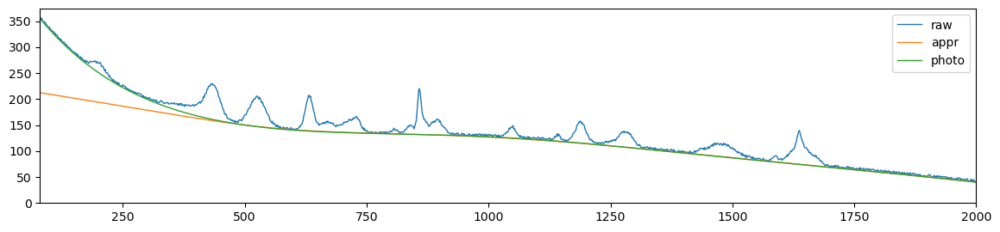

als_lambda: 4520.353656360246,	 als_p_weight: 3.5622478902624444e-05,	 error: 725.0390029832756, 	 smoothness: 0.5080374781836888, 	 smoothness: -0.5442506046045672


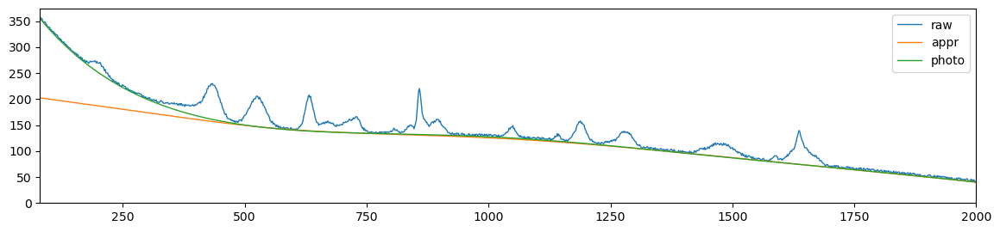

als_lambda: 4520.353656360246,	 als_p_weight: 2.592943797404667e-05,	 error: 762.9121640891822, 	 smoothness: 0.5117234748213169, 	 smoothness: -0.5451976804920642


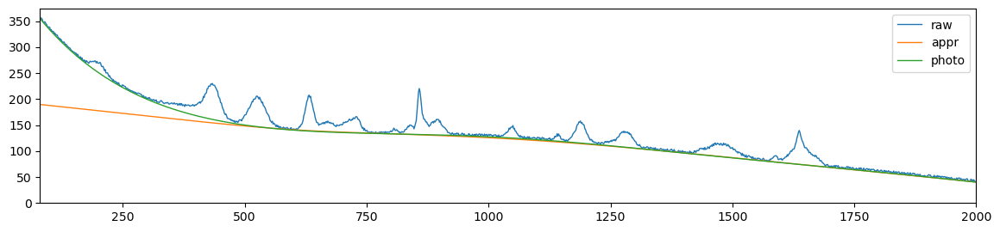

als_lambda: 4520.353656360246,	 als_p_weight: 1.8873918221350995e-05,	 error: 790.240636786485, 	 smoothness: 0.5153751304797038, 	 smoothness: -0.5461456667862272


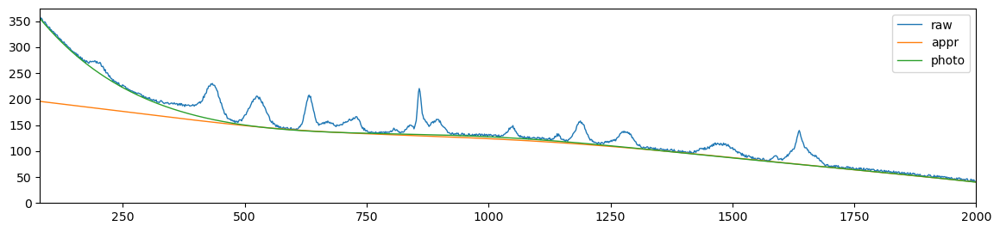

als_lambda: 4520.353656360246,	 als_p_weight: 1.3738237958832637e-05,	 error: 807.9812565171441, 	 smoothness: 0.5172082468934085, 	 smoothness: -0.5467573420231296


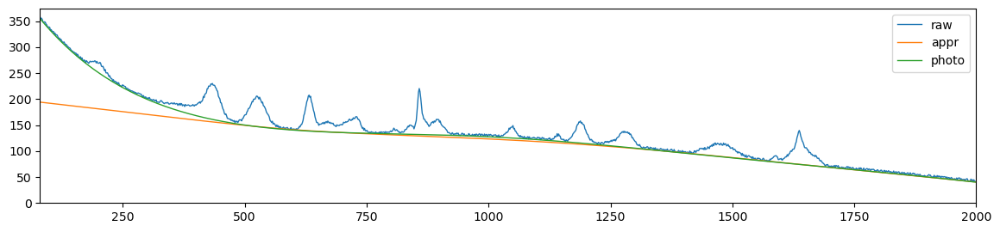

als_lambda: 4520.353656360246,	 als_p_weight: 1e-05,	 error: 834.099613735325, 	 smoothness: 0.5204044092204169, 	 smoothness: -0.5475672129705316


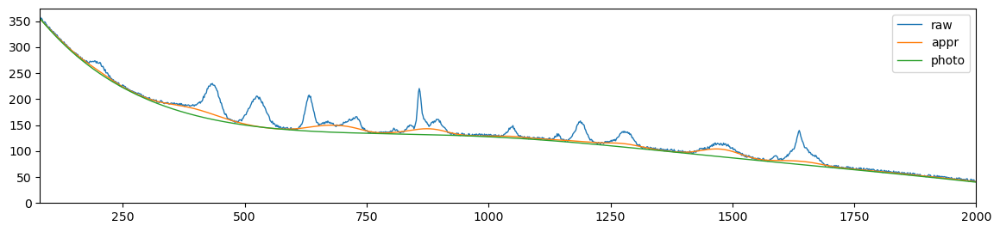

als_lambda: 7880.462815669913,	 als_p_weight: 0.1,	 error: 68.01954201321186, 	 smoothness: 0.08975474442430967, 	 smoothness: -0.2089236343619319


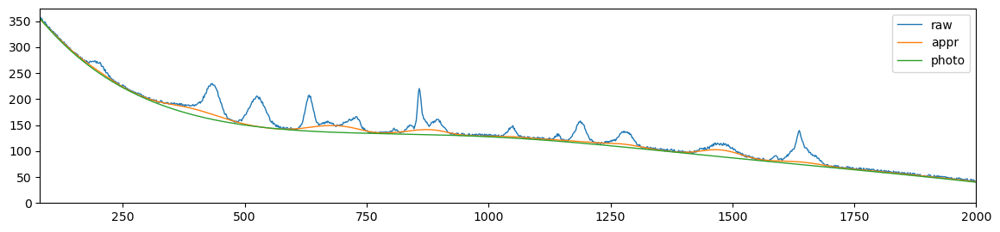

als_lambda: 7880.462815669913,	 als_p_weight: 0.0727895384398315,	 error: 100.72642728880366, 	 smoothness: 0.16828446493287394, 	 smoothness: -0.2767821215288352


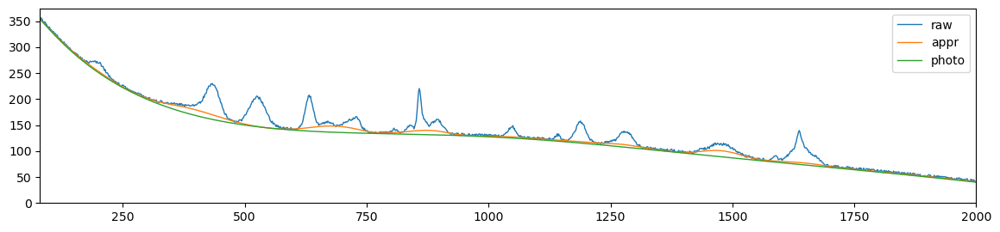

als_lambda: 7880.462815669913,	 als_p_weight: 0.05298316906283707,	 error: 124.78382782347764, 	 smoothness: 0.220967704238135, 	 smoothness: -0.3286045626169908


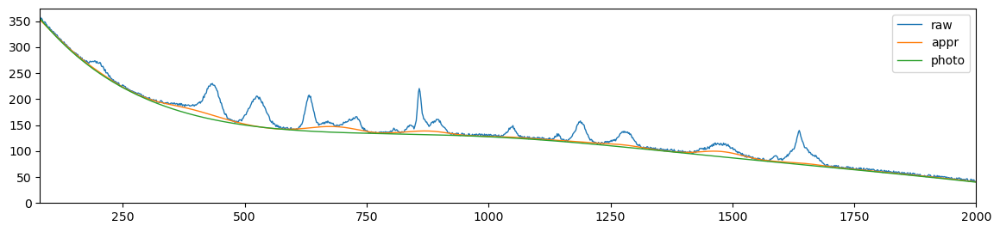

als_lambda: 7880.462815669913,	 als_p_weight: 0.03856620421163472,	 error: 155.3055896425373, 	 smoothness: 0.27540481739614914, 	 smoothness: -0.37763346557866756


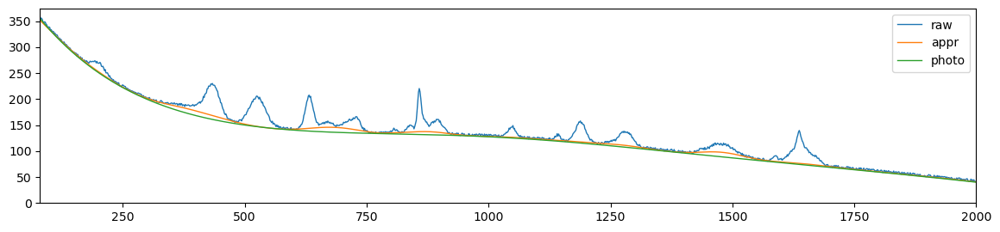

als_lambda: 7880.462815669913,	 als_p_weight: 0.02807216203941177,	 error: 174.1541694403772, 	 smoothness: 0.30498990219030825, 	 smoothness: -0.4081274929027


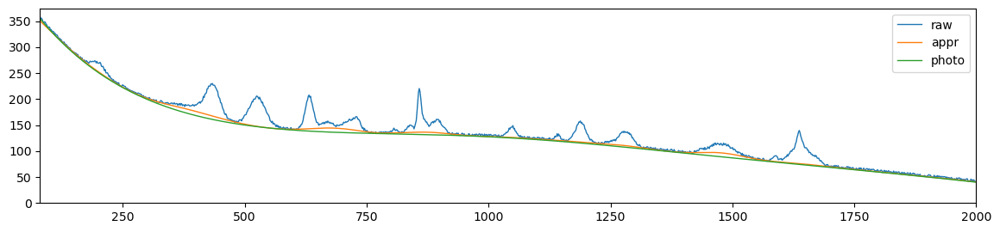

als_lambda: 7880.462815669913,	 als_p_weight: 0.020433597178569417,	 error: 198.09453516152635, 	 smoothness: 0.33488710949713296, 	 smoothness: -0.4413317690483474


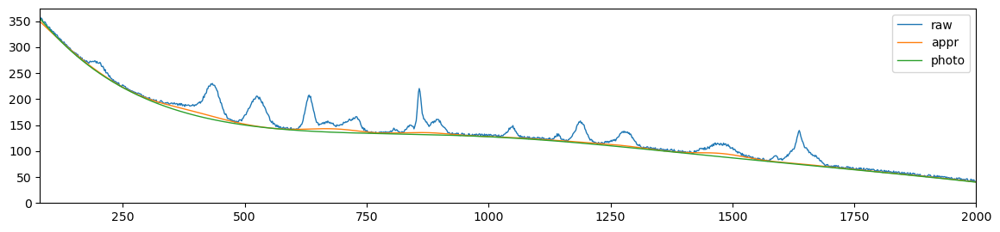

als_lambda: 7880.462815669913,	 als_p_weight: 0.014873521072935119,	 error: 219.77483453276832, 	 smoothness: 0.3556885094258877, 	 smoothness: -0.4625355070290928


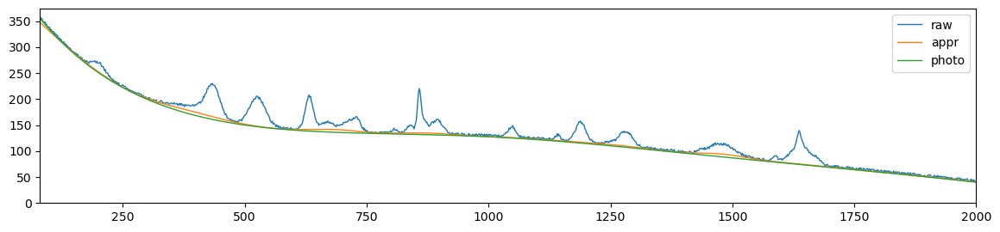

als_lambda: 7880.462815669913,	 als_p_weight: 0.010826367338740546,	 error: 233.3802047368584, 	 smoothness: 0.366670362553057, 	 smoothness: -0.47354965937221544


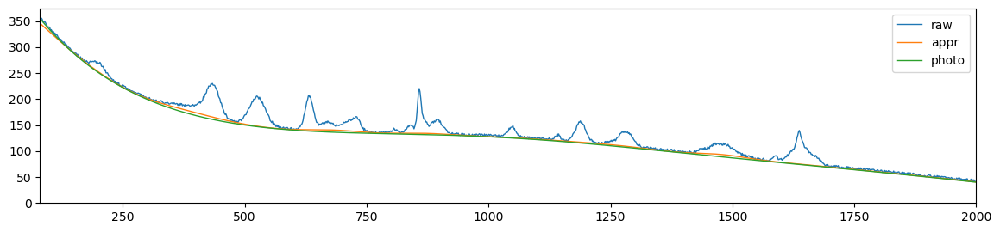

als_lambda: 7880.462815669913,	 als_p_weight: 0.007880462815669913,	 error: 249.77313727032958, 	 smoothness: 0.37757407928340586, 	 smoothness: -0.48350228201043377


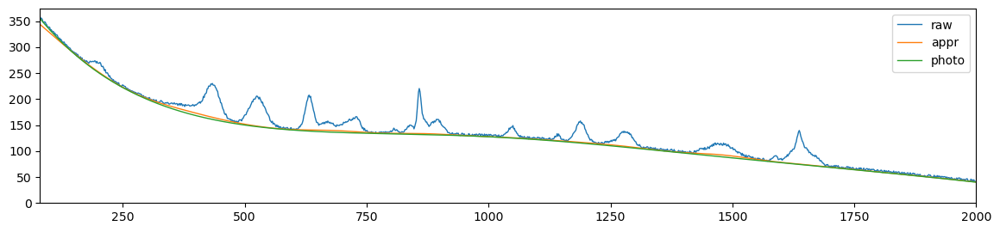

als_lambda: 7880.462815669913,	 als_p_weight: 0.005736152510448681,	 error: 271.4462415225951, 	 smoothness: 0.38954174345479636, 	 smoothness: -0.4927176646604192


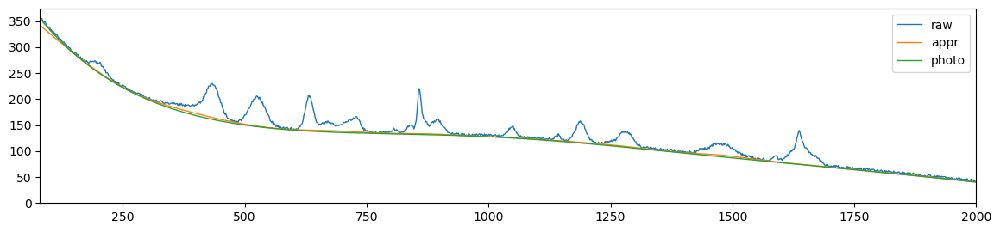

als_lambda: 7880.462815669913,	 als_p_weight: 0.0041753189365604,	 error: 292.11651481327425, 	 smoothness: 0.3997145073134073, 	 smoothness: -0.49892908197962027


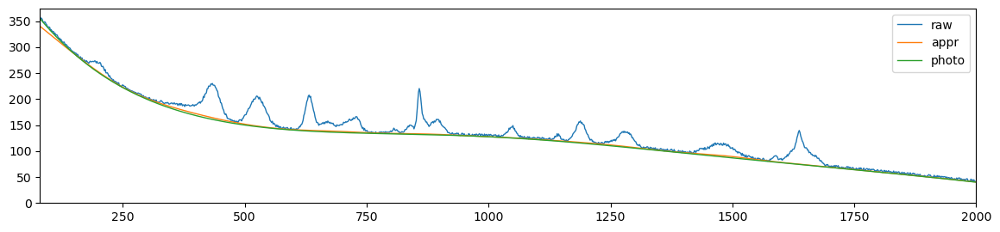

als_lambda: 7880.462815669913,	 als_p_weight: 0.0030391953823131978,	 error: 312.14785128726754, 	 smoothness: 0.4092345008778202, 	 smoothness: -0.5042670827150497


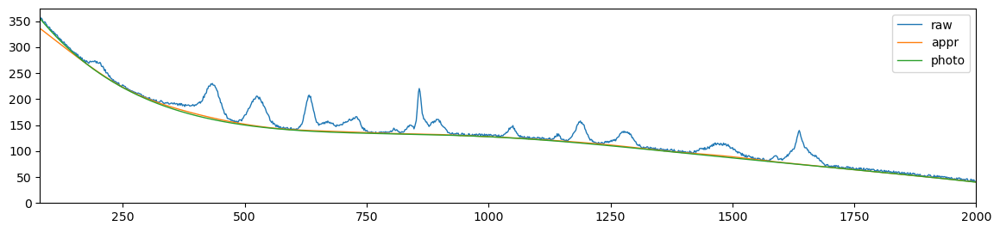

als_lambda: 7880.462815669913,	 als_p_weight: 0.00221221629107045,	 error: 336.16515437224484, 	 smoothness: 0.41950765864226597, 	 smoothness: -0.5100498313773568


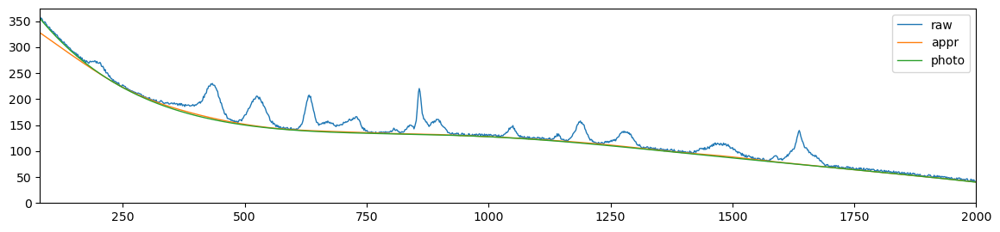

als_lambda: 7880.462815669913,	 als_p_weight: 0.0016102620275609393,	 error: 362.8818492990249, 	 smoothness: 0.4297196402492139, 	 smoothness: -0.5152172224601215


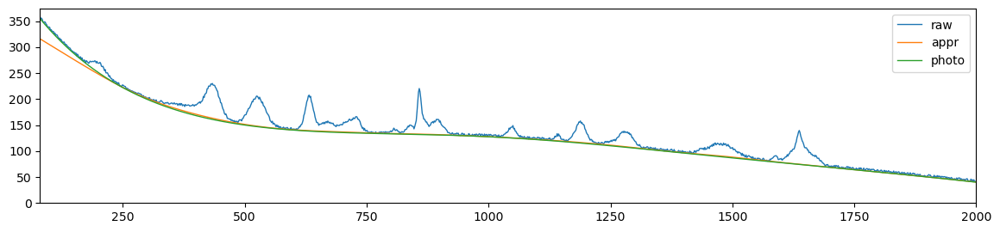

als_lambda: 7880.462815669913,	 als_p_weight: 0.0011721022975334804,	 error: 390.11474795695625, 	 smoothness: 0.4392756380650908, 	 smoothness: -0.5192551904227632


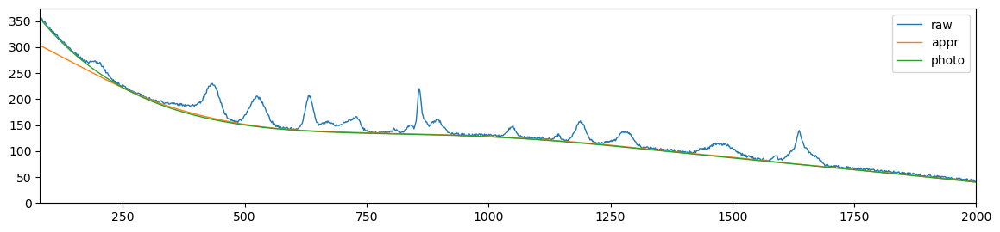

als_lambda: 7880.462815669913,	 als_p_weight: 0.0008531678524172806,	 error: 419.54112297977485, 	 smoothness: 0.44870194350154435, 	 smoothness: -0.5229412273964796


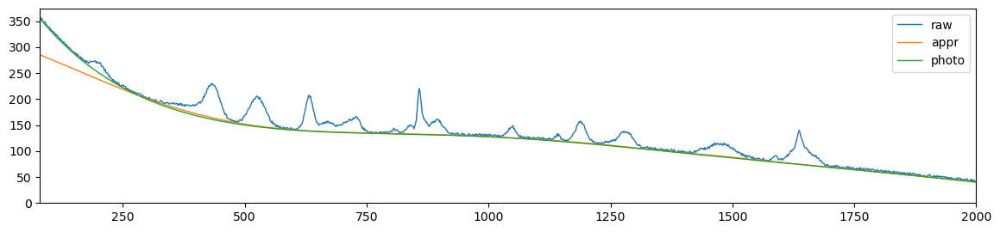

als_lambda: 7880.462815669913,	 als_p_weight: 0.0006210169418915617,	 error: 451.08738538263526, 	 smoothness: 0.45792311231821026, 	 smoothness: -0.52659457830987


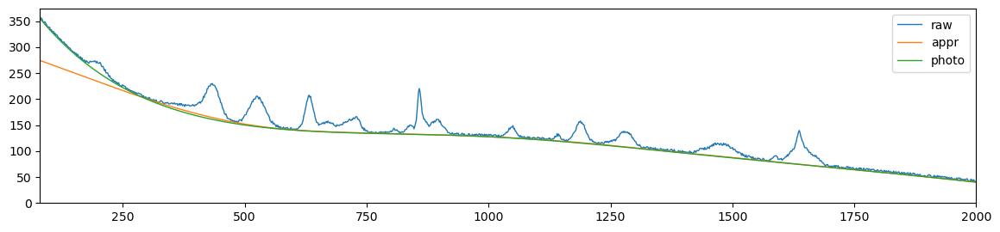

als_lambda: 7880.462815669913,	 als_p_weight: 0.00045203536563602454,	 error: 486.7759608867431, 	 smoothness: 0.4670627086824638, 	 smoothness: -0.5301817226428247


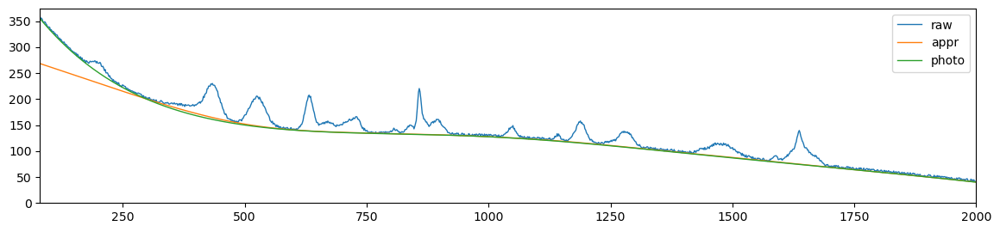

als_lambda: 7880.462815669913,	 als_p_weight: 0.00032903445623126676,	 error: 526.0992032244892, 	 smoothness: 0.4757621185450111, 	 smoothness: -0.5332017605117351


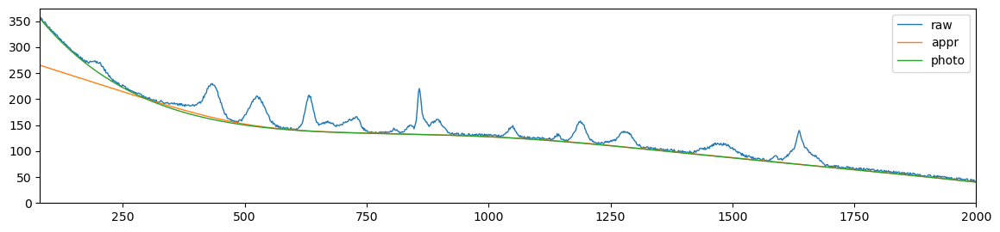

als_lambda: 7880.462815669913,	 als_p_weight: 0.0002395026619987486,	 error: 561.9805937547596, 	 smoothness: 0.4833523617725436, 	 smoothness: -0.5356111160580858


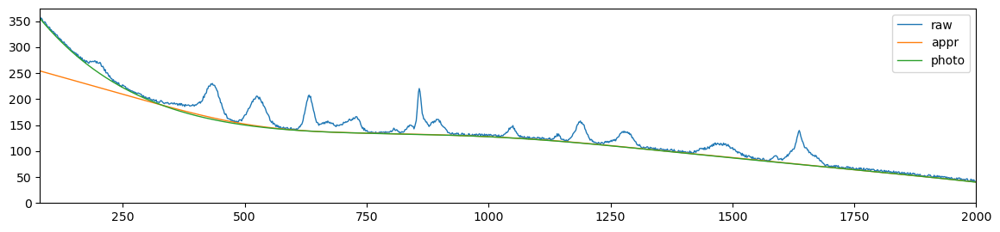

als_lambda: 7880.462815669913,	 als_p_weight: 0.00017433288221999874,	 error: 597.3408570073684, 	 smoothness: 0.49010281974921005, 	 smoothness: -0.537637982241836


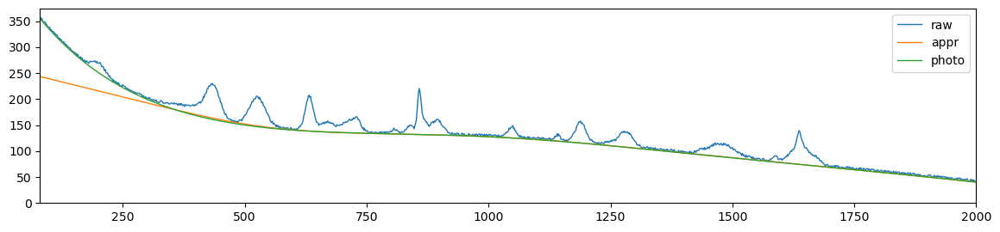

als_lambda: 7880.462815669913,	 als_p_weight: 0.0001268961003167922,	 error: 638.3305724333311, 	 smoothness: 0.49689359848269676, 	 smoothness: -0.540063336524226


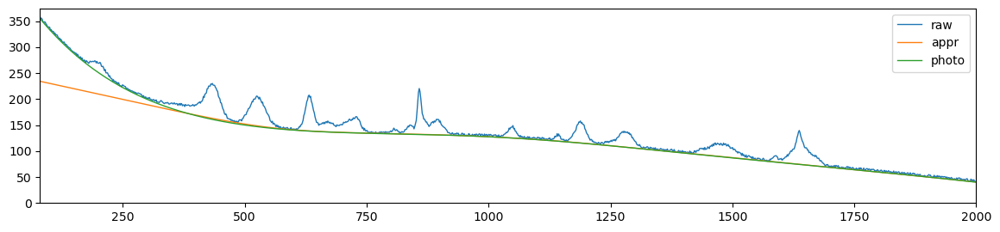

als_lambda: 7880.462815669913,	 als_p_weight: 9.236708571873866e-05,	 error: 686.571792793676, 	 smoothness: 0.5035940340575007, 	 smoothness: -0.542422266944293


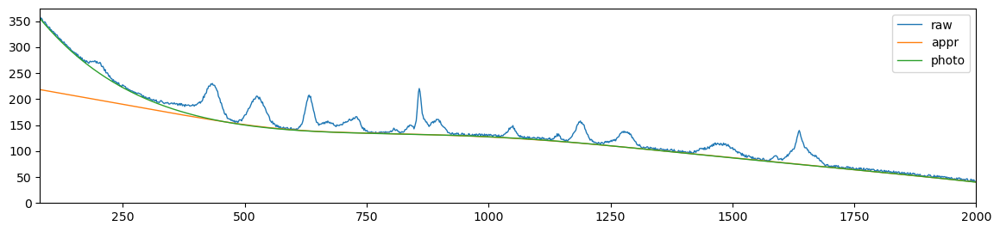

als_lambda: 7880.462815669913,	 als_p_weight: 6.723357536499335e-05,	 error: 737.9727450320652, 	 smoothness: 0.5099937401493136, 	 smoothness: -0.5443783215072214


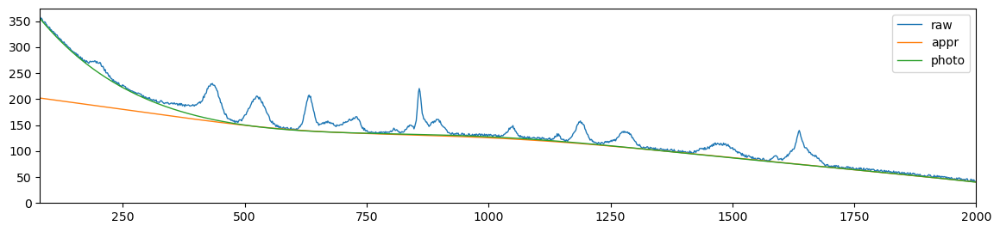

als_lambda: 7880.462815669913,	 als_p_weight: 4.893900918477499e-05,	 error: 782.2537338193974, 	 smoothness: 0.515268840850499, 	 smoothness: -0.5458108633779868


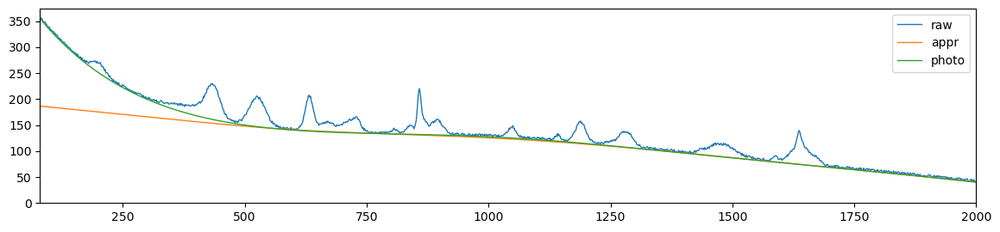

als_lambda: 7880.462815669913,	 als_p_weight: 3.5622478902624444e-05,	 error: 829.4107071354612, 	 smoothness: 0.5195675369627087, 	 smoothness: -0.5471007568638688


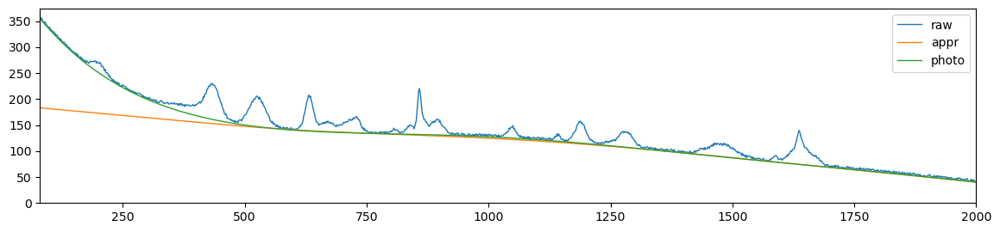

als_lambda: 7880.462815669913,	 als_p_weight: 2.592943797404667e-05,	 error: 853.7730890640992, 	 smoothness: 0.5220879154182844, 	 smoothness: -0.5477315753849488


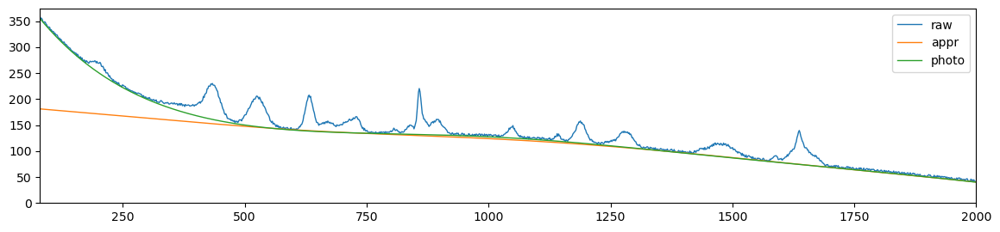

als_lambda: 7880.462815669913,	 als_p_weight: 1.8873918221350995e-05,	 error: 886.3744789041081, 	 smoothness: 0.52552524848237, 	 smoothness: -0.5483654123411528


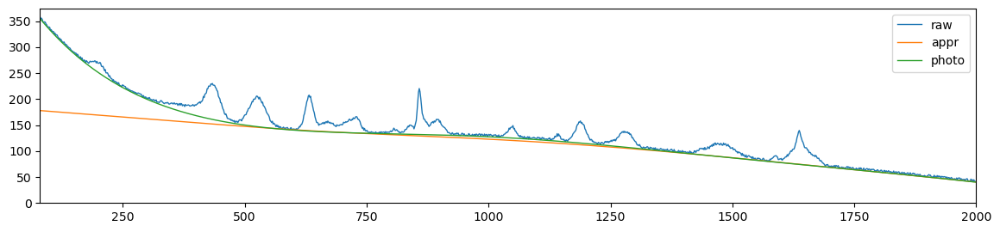

als_lambda: 7880.462815669913,	 als_p_weight: 1.3738237958832637e-05,	 error: 904.5196288958534, 	 smoothness: 0.5275133901239747, 	 smoothness: -0.5490866285086231


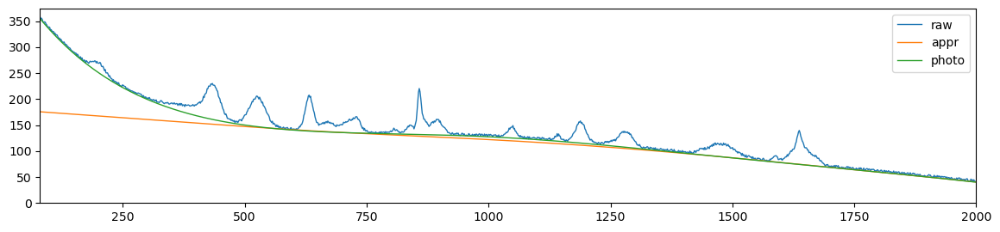

als_lambda: 7880.462815669913,	 als_p_weight: 1e-05,	 error: 928.9448692369277, 	 smoothness: 0.5288596214297633, 	 smoothness: -0.550226455845463


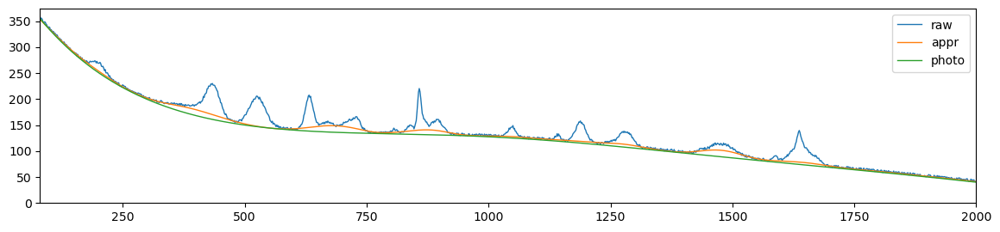

als_lambda: 13738.237958832638,	 als_p_weight: 0.1,	 error: 118.52849096480449, 	 smoothness: 0.19874619336668395, 	 smoothness: -0.3099295364670904


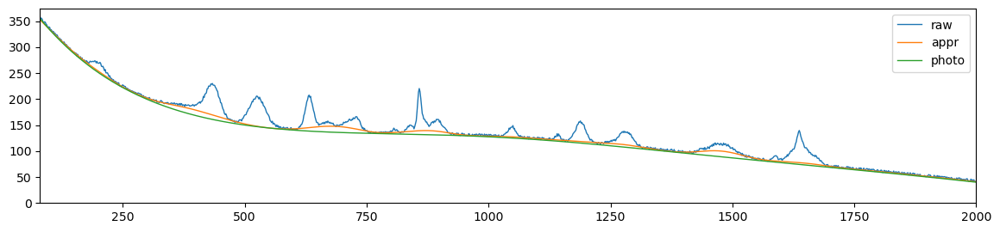

als_lambda: 13738.237958832638,	 als_p_weight: 0.0727895384398315,	 error: 150.59565151261904, 	 smoothness: 0.2602960755383586, 	 smoothness: -0.36427213365382755


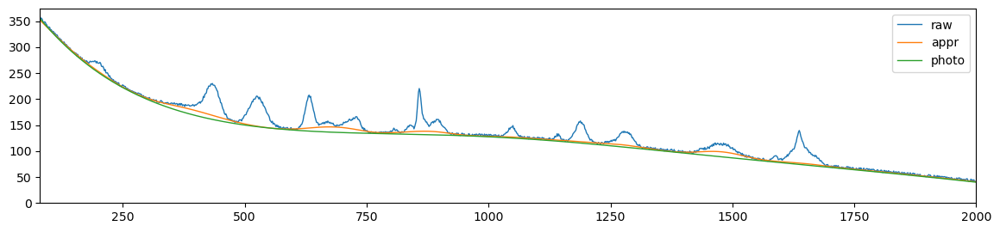

als_lambda: 13738.237958832638,	 als_p_weight: 0.05298316906283707,	 error: 172.00452713485436, 	 smoothness: 0.2971664998204502, 	 smoothness: -0.399607167121221


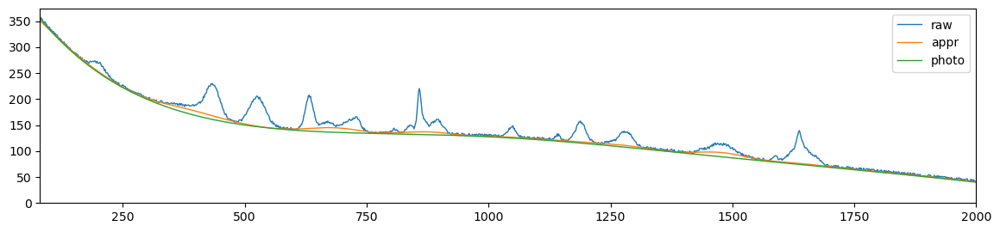

als_lambda: 13738.237958832638,	 als_p_weight: 0.03856620421163472,	 error: 192.82837128475347, 	 smoothness: 0.3255073300366058, 	 smoothness: -0.43196784494527113


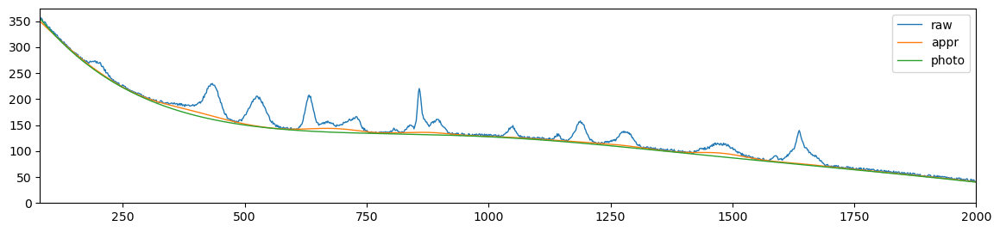

als_lambda: 13738.237958832638,	 als_p_weight: 0.02807216203941177,	 error: 218.39674320114062, 	 smoothness: 0.35286139597952854, 	 smoothness: -0.45913592419696575


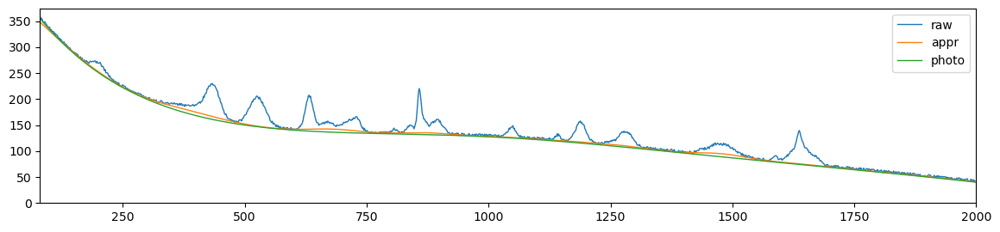

als_lambda: 13738.237958832638,	 als_p_weight: 0.020433597178569417,	 error: 232.60342072738712, 	 smoothness: 0.36518115549795693, 	 smoothness: -0.47165292475754755


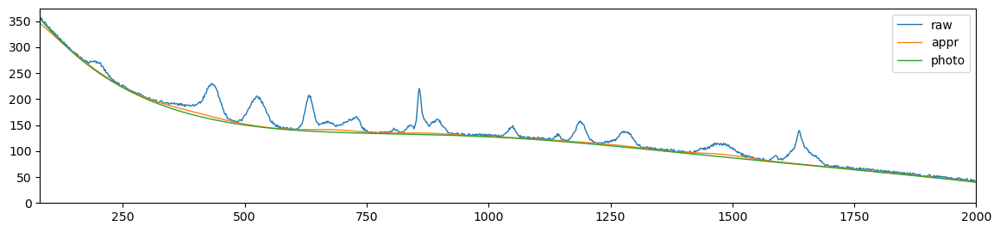

als_lambda: 13738.237958832638,	 als_p_weight: 0.014873521072935119,	 error: 247.76555408729547, 	 smoothness: 0.3758941363264733, 	 smoothness: -0.4817764715095381


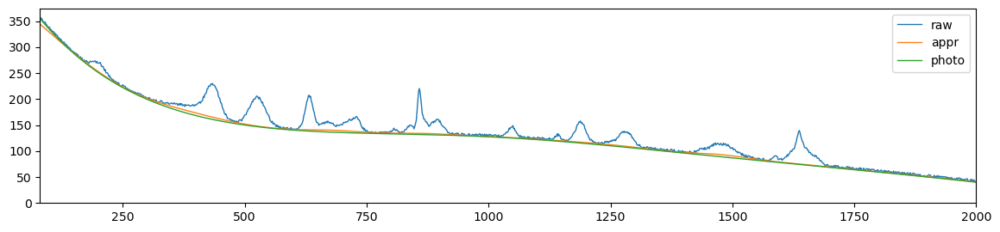

als_lambda: 13738.237958832638,	 als_p_weight: 0.010826367338740546,	 error: 268.0764840738764, 	 smoothness: 0.38754744605770014, 	 smoothness: -0.49092808465695226


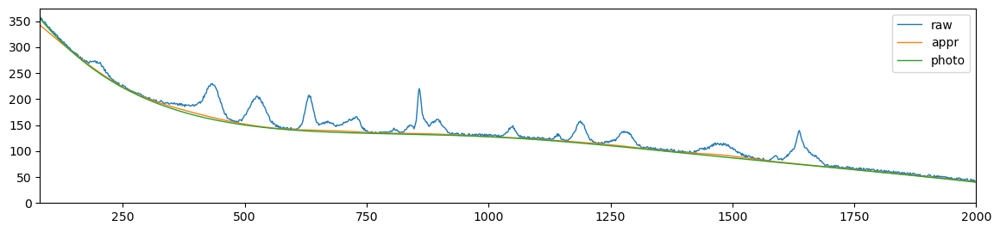

als_lambda: 13738.237958832638,	 als_p_weight: 0.007880462815669913,	 error: 288.9163235831686, 	 smoothness: 0.39802283499656, 	 smoothness: -0.4978203306892813


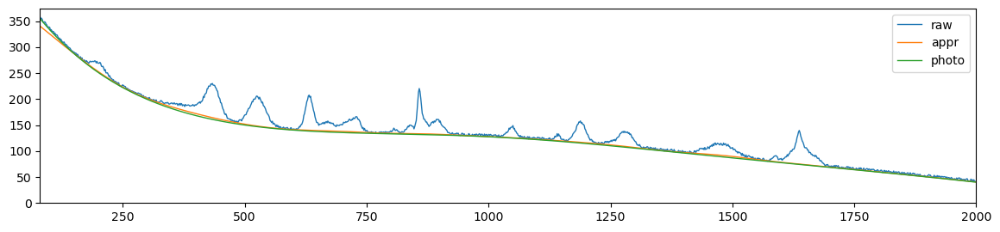

als_lambda: 13738.237958832638,	 als_p_weight: 0.005736152510448681,	 error: 307.5518119922649, 	 smoothness: 0.4072282875856139, 	 smoothness: -0.5031173343627986


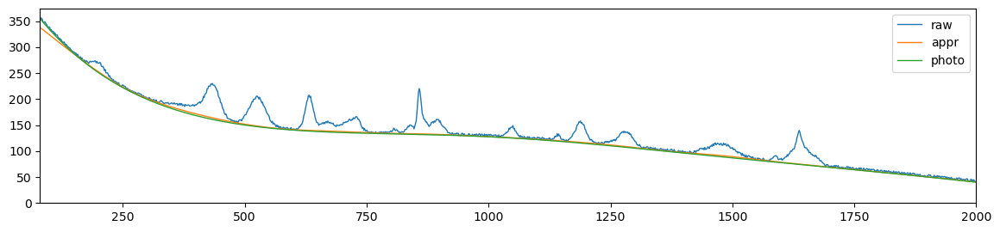

als_lambda: 13738.237958832638,	 als_p_weight: 0.0041753189365604,	 error: 330.07316751244144, 	 smoothness: 0.4172627521446251, 	 smoothness: -0.5087791799303159


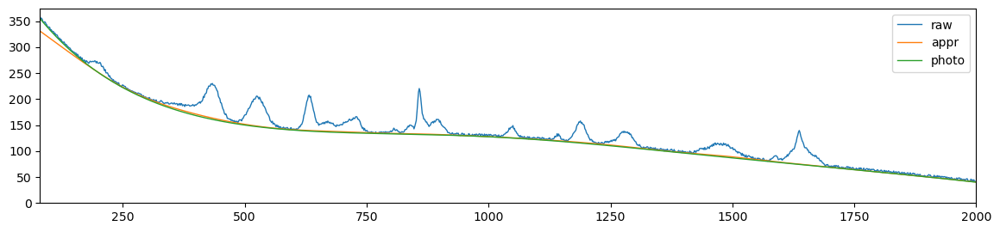

als_lambda: 13738.237958832638,	 als_p_weight: 0.0030391953823131978,	 error: 355.8179768233512, 	 smoothness: 0.4274037913360514, 	 smoothness: -0.5140460818470944


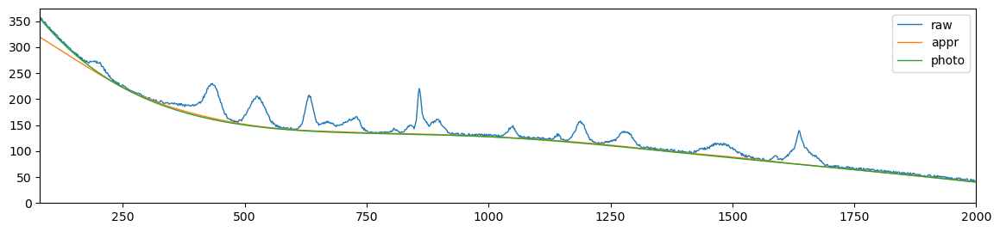

als_lambda: 13738.237958832638,	 als_p_weight: 0.00221221629107045,	 error: 383.0128185575597, 	 smoothness: 0.43715546348292195, 	 smoothness: -0.518427578984156


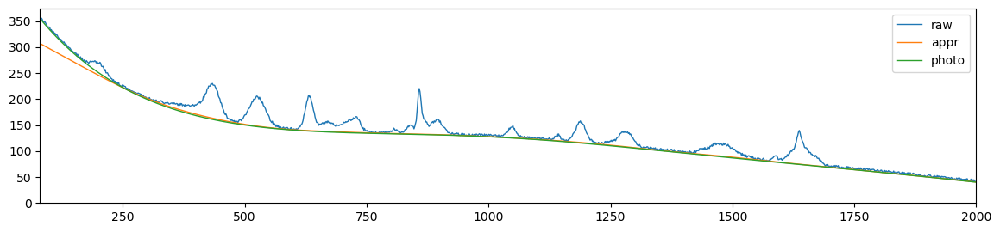

als_lambda: 13738.237958832638,	 als_p_weight: 0.0016102620275609393,	 error: 411.23805779881104, 	 smoothness: 0.4464454389367699, 	 smoothness: -0.5220399273689494


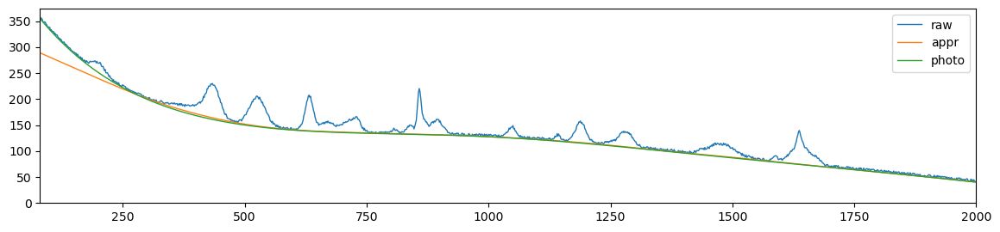

als_lambda: 13738.237958832638,	 als_p_weight: 0.0011721022975334804,	 error: 442.3687402027583, 	 smoothness: 0.45574635496576876, 	 smoothness: -0.5257171546580429


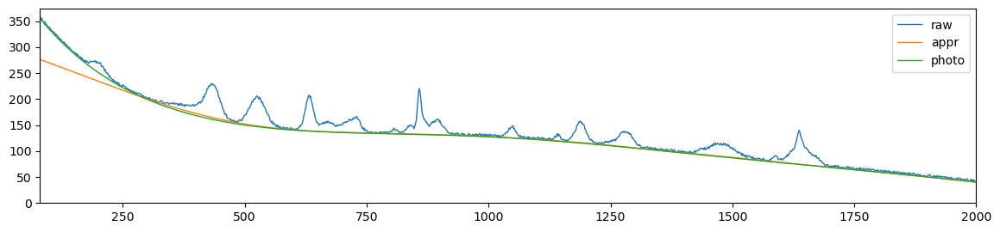

als_lambda: 13738.237958832638,	 als_p_weight: 0.0008531678524172806,	 error: 476.90852752459034, 	 smoothness: 0.4649474974551142, 	 smoothness: -0.5293284694721563


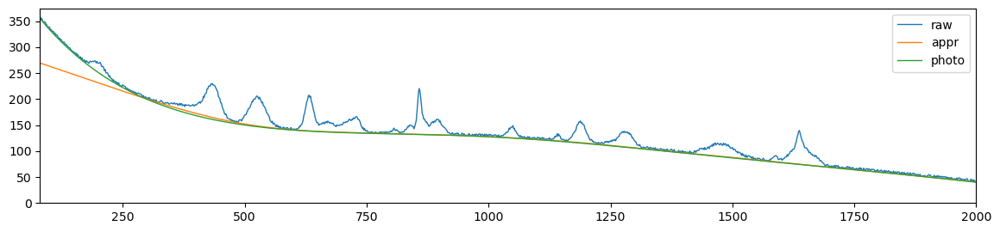

als_lambda: 13738.237958832638,	 als_p_weight: 0.0006210169418915617,	 error: 517.0732095777422, 	 smoothness: 0.47402973467905846, 	 smoothness: -0.532590903455043


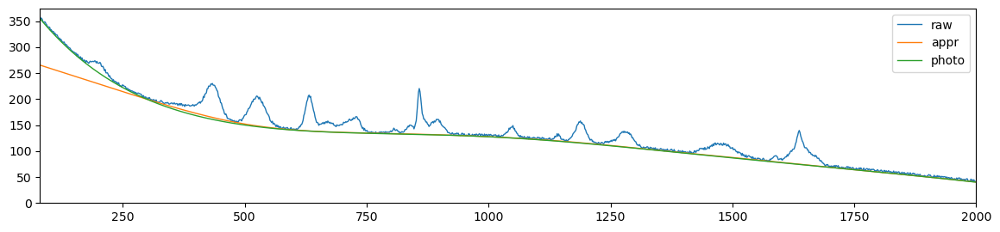

als_lambda: 13738.237958832638,	 als_p_weight: 0.00045203536563602454,	 error: 555.8269615949005, 	 smoothness: 0.4821347356800145, 	 smoothness: -0.5351997934543159


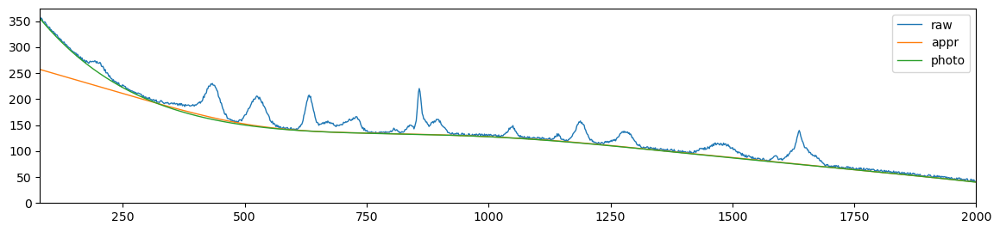

als_lambda: 13738.237958832638,	 als_p_weight: 0.00032903445623126676,	 error: 593.9621788432526, 	 smoothness: 0.4894332604700719, 	 smoothness: -0.5373670849583779


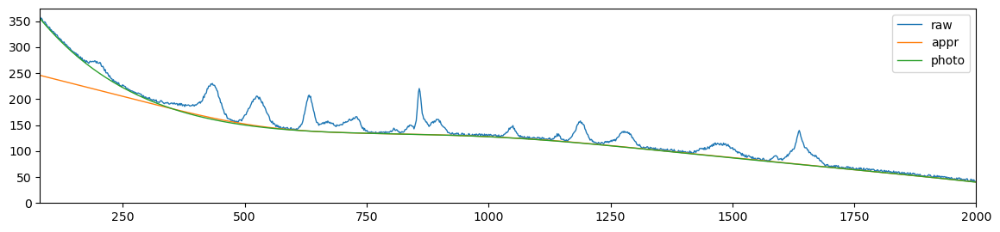

als_lambda: 13738.237958832638,	 als_p_weight: 0.0002395026619987486,	 error: 639.1698454919957, 	 smoothness: 0.49685368094350424, 	 smoothness: -0.539753138380492


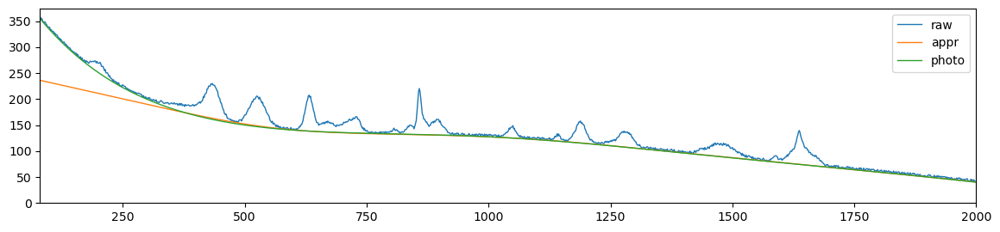

als_lambda: 13738.237958832638,	 als_p_weight: 0.00017433288221999874,	 error: 692.2463115741907, 	 smoothness: 0.5042483071046487, 	 smoothness: -0.5423105361312871


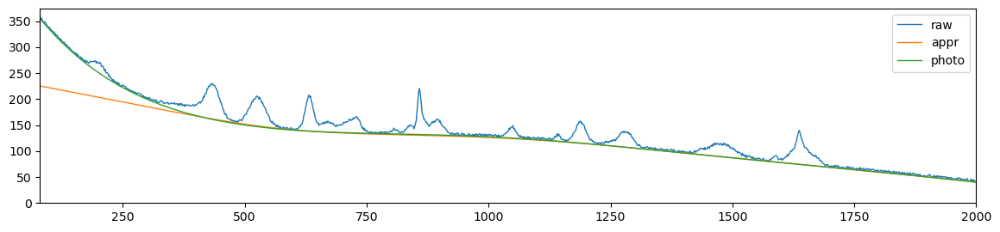

als_lambda: 13738.237958832638,	 als_p_weight: 0.0001268961003167922,	 error: 751.8548287342185, 	 smoothness: 0.5115634052486574, 	 smoothness: -0.5445876927552561


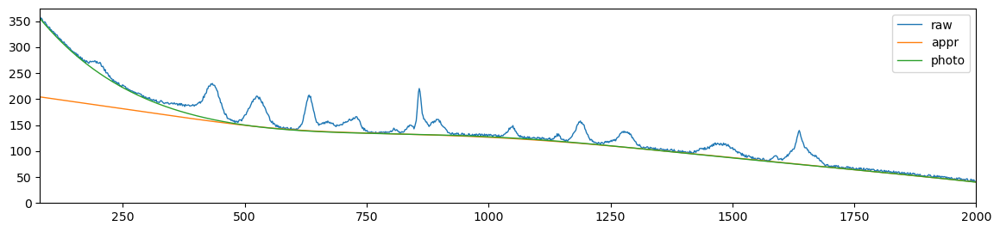

als_lambda: 13738.237958832638,	 als_p_weight: 9.236708571873866e-05,	 error: 816.5815960420382, 	 smoothness: 0.518598799662068, 	 smoothness: -0.546431716278558


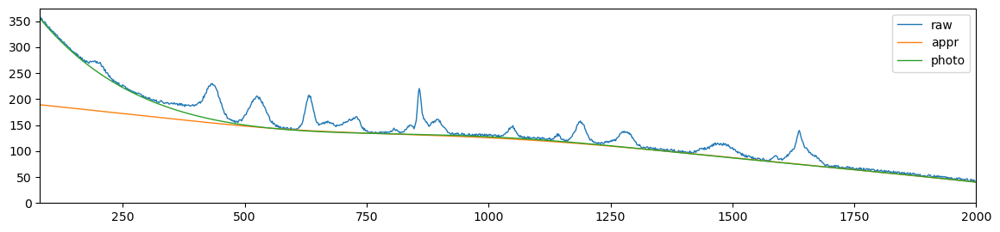

als_lambda: 13738.237958832638,	 als_p_weight: 6.723357536499335e-05,	 error: 876.2709260188756, 	 smoothness: 0.5244740665558714, 	 smoothness: -0.5476653484825139


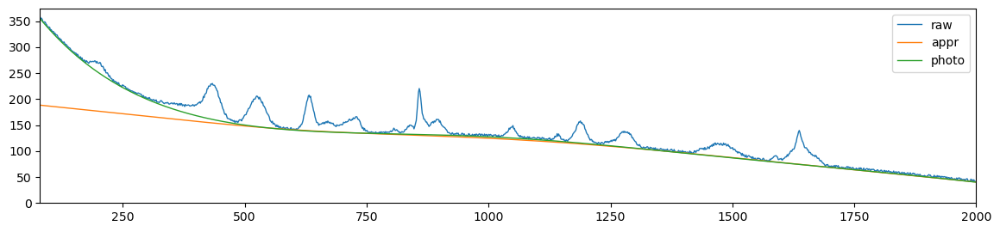

als_lambda: 13738.237958832638,	 als_p_weight: 4.893900918477499e-05,	 error: 923.212591572452, 	 smoothness: 0.5294014436818504, 	 smoothness: -0.5485623918899156


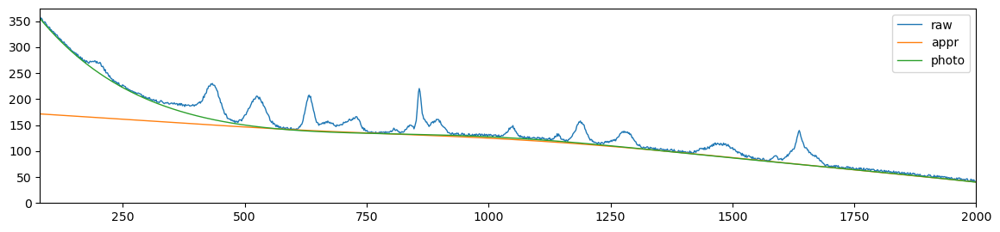

als_lambda: 13738.237958832638,	 als_p_weight: 3.5622478902624444e-05,	 error: 963.0003256686479, 	 smoothness: 0.5334916009842694, 	 smoothness: -0.5494180236346021


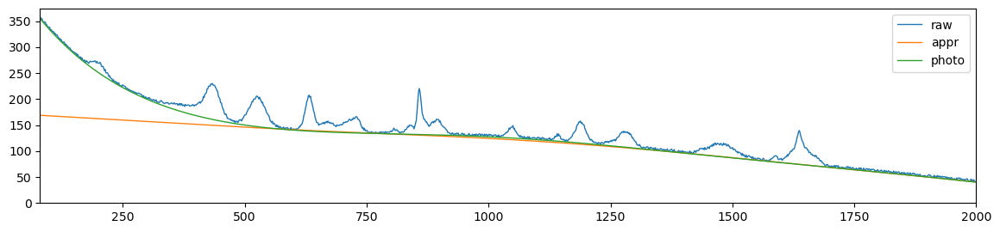

als_lambda: 13738.237958832638,	 als_p_weight: 2.592943797404667e-05,	 error: 991.4738469245692, 	 smoothness: 0.5363357385370977, 	 smoothness: -0.5501442546313211


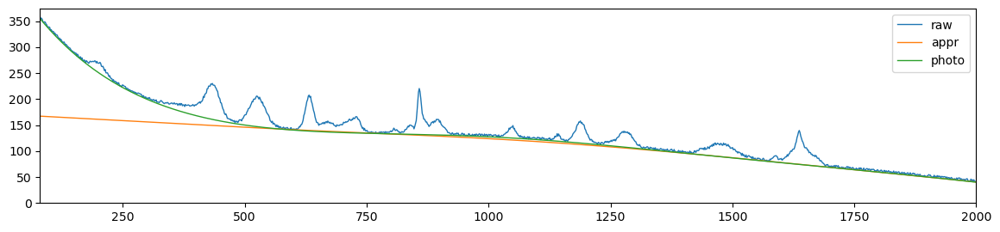

als_lambda: 13738.237958832638,	 als_p_weight: 1.8873918221350995e-05,	 error: 1024.8468233234942, 	 smoothness: 0.5389055936805007, 	 smoothness: -0.5513603541084874


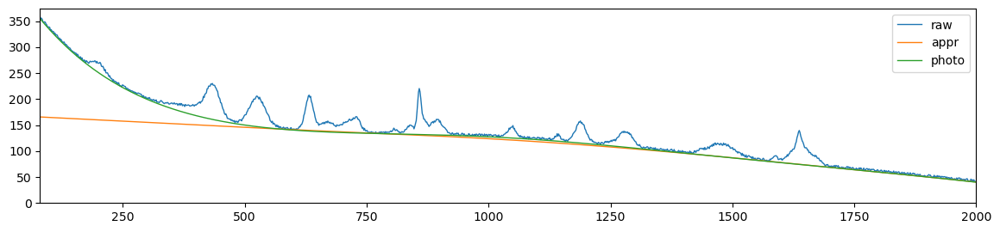

als_lambda: 13738.237958832638,	 als_p_weight: 1.3738237958832637e-05,	 error: 1065.2758231100709, 	 smoothness: 0.5399363041705997, 	 smoothness: -0.552788019785131


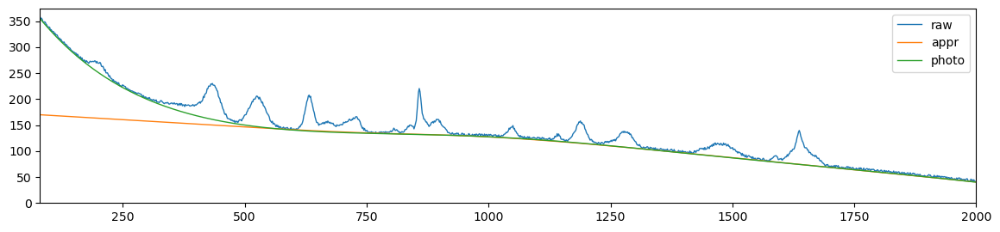

als_lambda: 13738.237958832638,	 als_p_weight: 1e-05,	 error: 1084.821144520779, 	 smoothness: 0.5400183782123801, 	 smoothness: -0.5539500914118655


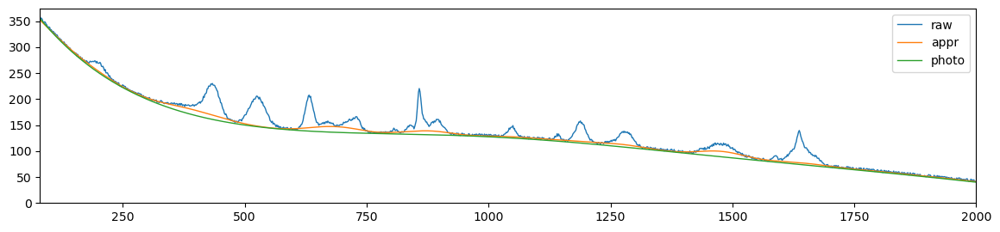

als_lambda: 23950.26619987486,	 als_p_weight: 0.1,	 error: 173.89705103395673, 	 smoothness: 0.29144280210427437, 	 smoothness: -0.3922027363365696


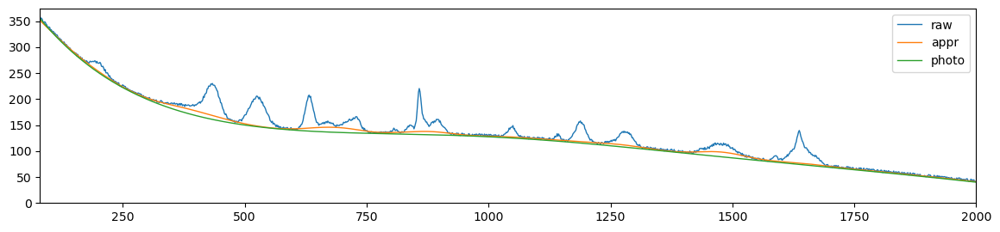

als_lambda: 23950.26619987486,	 als_p_weight: 0.0727895384398315,	 error: 189.93924401636616, 	 smoothness: 0.3171082600691627, 	 smoothness: -0.42224015635450185


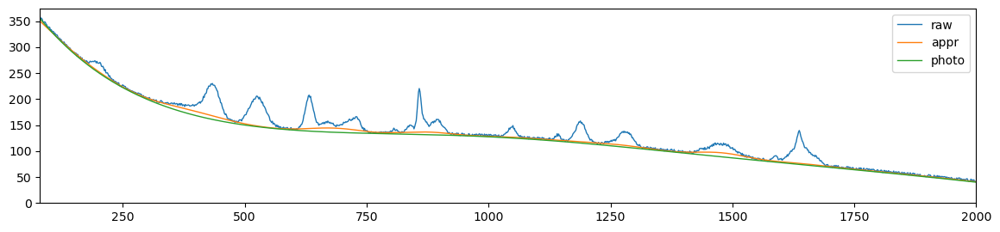

als_lambda: 23950.26619987486,	 als_p_weight: 0.05298316906283707,	 error: 217.5826768813722, 	 smoothness: 0.34915219543409903, 	 smoothness: -0.4544961574377038


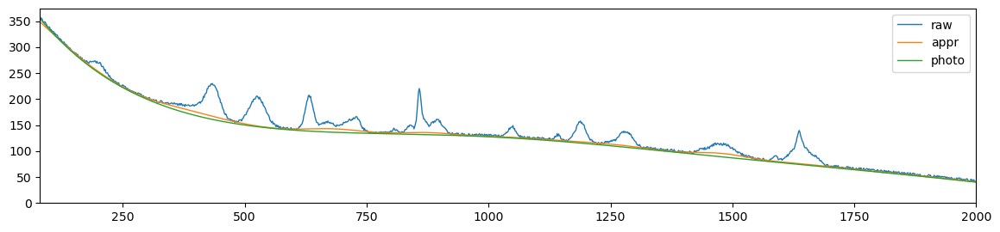

als_lambda: 23950.26619987486,	 als_p_weight: 0.03856620421163472,	 error: 233.2078770906657, 	 smoothness: 0.3640702529246579, 	 smoothness: -0.4699147685797183


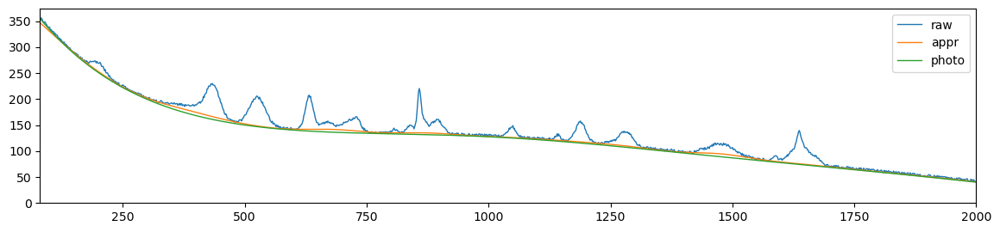

als_lambda: 23950.26619987486,	 als_p_weight: 0.02807216203941177,	 error: 246.00098089092393, 	 smoothness: 0.3739495107676647, 	 smoothness: -0.47957470694114024


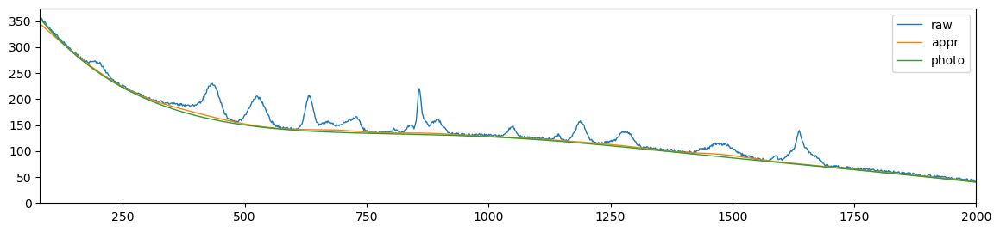

als_lambda: 23950.26619987486,	 als_p_weight: 0.020433597178569417,	 error: 264.85748076189594, 	 smoothness: 0.38562002345038515, 	 smoothness: -0.4892166254931162


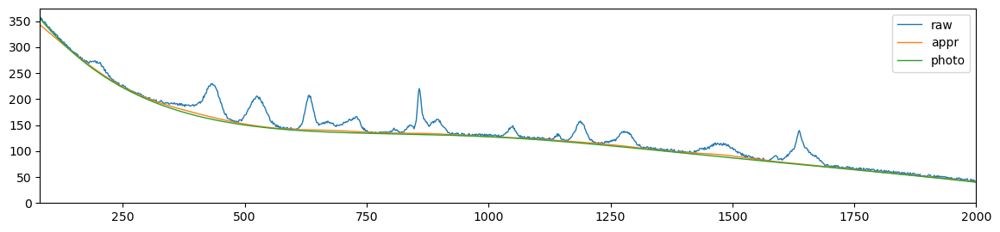

als_lambda: 23950.26619987486,	 als_p_weight: 0.014873521072935119,	 error: 285.8288424962971, 	 smoothness: 0.3964183044486236, 	 smoothness: -0.49665756281178985


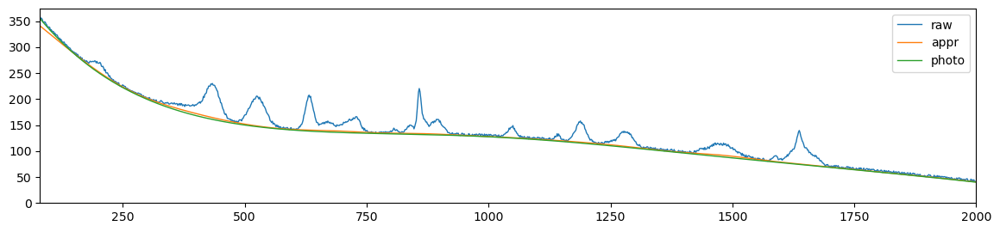

als_lambda: 23950.26619987486,	 als_p_weight: 0.010826367338740546,	 error: 303.87764506159436, 	 smoothness: 0.4054712326081395, 	 smoothness: -0.5019532330022257


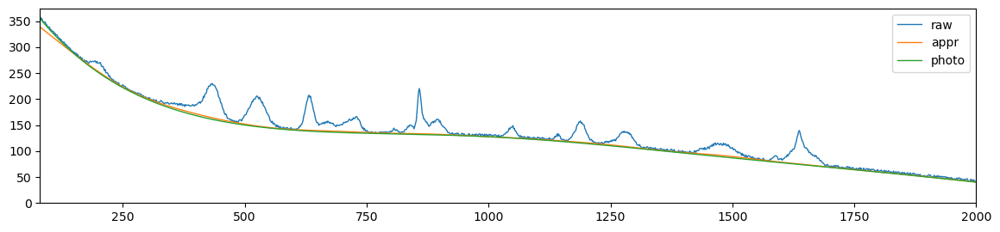

als_lambda: 23950.26619987486,	 als_p_weight: 0.007880462815669913,	 error: 324.55666241235633, 	 smoothness: 0.41508986001607406, 	 smoothness: -0.5074458455914967


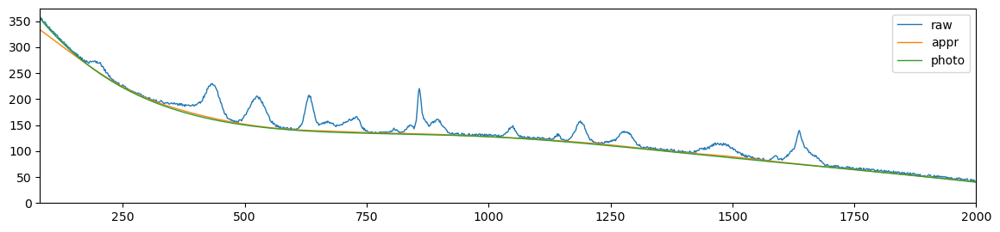

als_lambda: 23950.26619987486,	 als_p_weight: 0.005736152510448681,	 error: 348.91683148701946, 	 smoothness: 0.42508718811779467, 	 smoothness: -0.5127681895629064


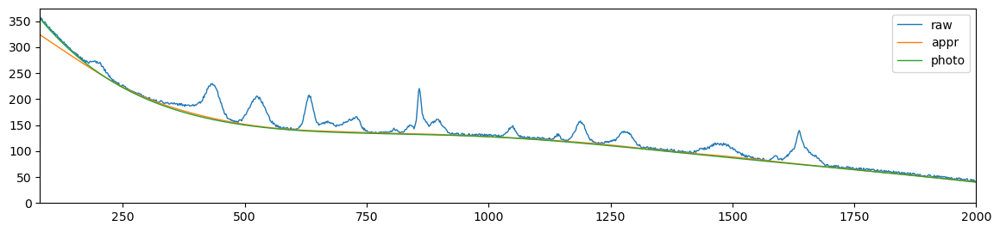

als_lambda: 23950.26619987486,	 als_p_weight: 0.0041753189365604,	 error: 376.0077163162521, 	 smoothness: 0.4350413390799161, 	 smoothness: -0.5175370589069338


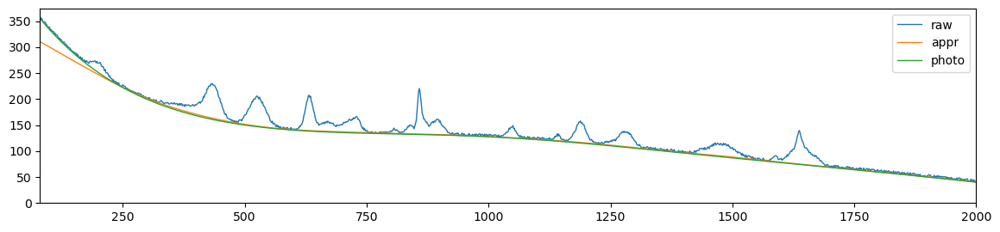

als_lambda: 23950.26619987486,	 als_p_weight: 0.0030391953823131978,	 error: 403.2579251426394, 	 smoothness: 0.4442702954979792, 	 smoothness: -0.5211933709025157


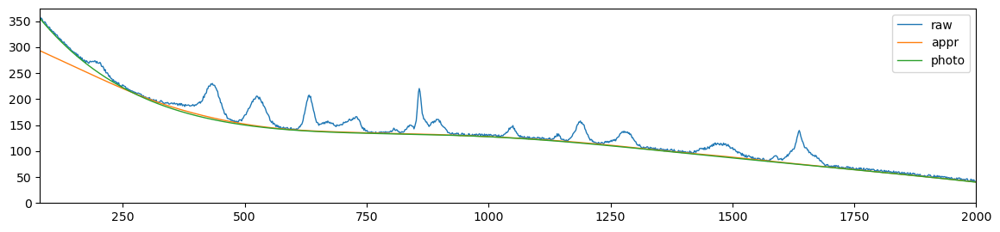

als_lambda: 23950.26619987486,	 als_p_weight: 0.00221221629107045,	 error: 433.34268756447176, 	 smoothness: 0.45353409617473295, 	 smoothness: -0.524814267440932


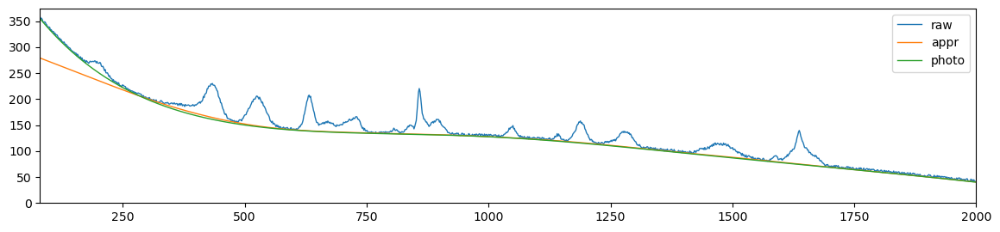

als_lambda: 23950.26619987486,	 als_p_weight: 0.0016102620275609393,	 error: 466.5986332568326, 	 smoothness: 0.46270712048775764, 	 smoothness: -0.5284579328810701


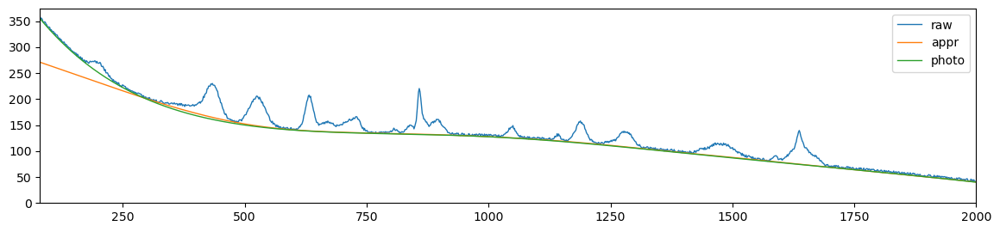

als_lambda: 23950.26619987486,	 als_p_weight: 0.0011721022975334804,	 error: 506.3374217321376, 	 smoothness: 0.4719736854404101, 	 smoothness: -0.5318953770846389


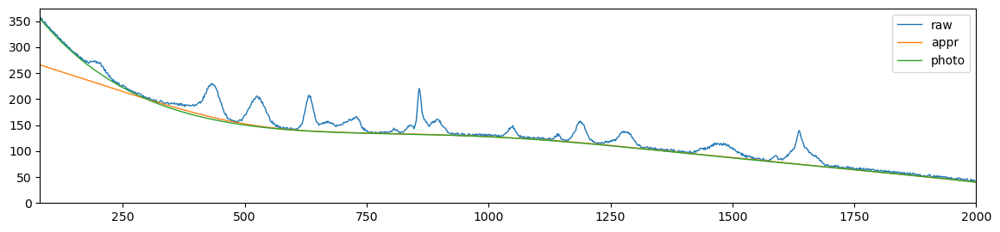

als_lambda: 23950.26619987486,	 als_p_weight: 0.0008531678524172806,	 error: 545.85198283444, 	 smoothness: 0.48036302325257213, 	 smoothness: -0.5346506785531525


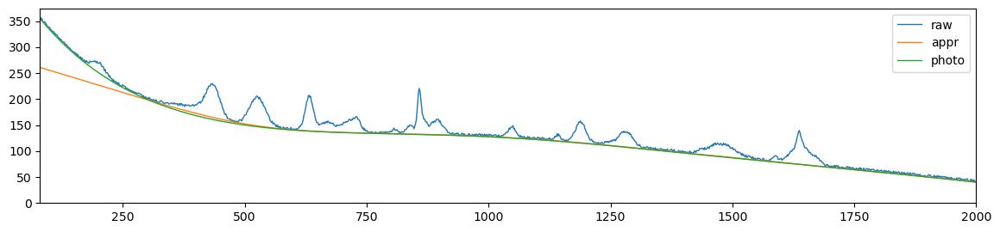

als_lambda: 23950.26619987486,	 als_p_weight: 0.0006210169418915617,	 error: 584.558751201725, 	 smoothness: 0.4879050384954656, 	 smoothness: -0.5369226586650915


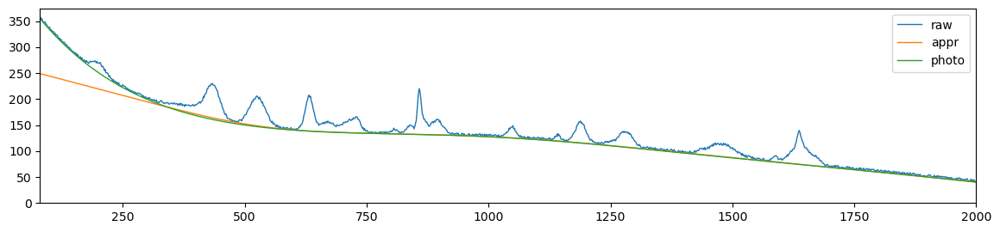

als_lambda: 23950.26619987486,	 als_p_weight: 0.00045203536563602454,	 error: 629.1236764011896, 	 smoothness: 0.49538770901501805, 	 smoothness: -0.5392395750078256


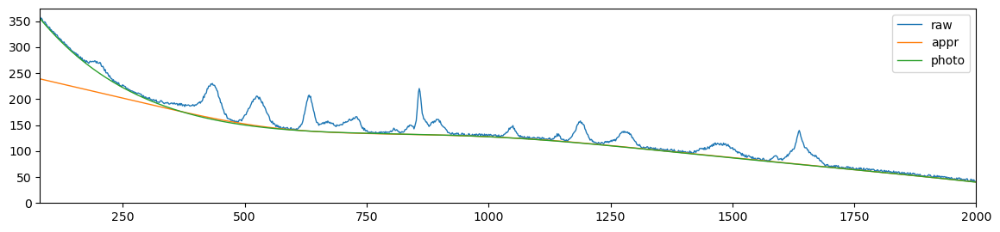

als_lambda: 23950.26619987486,	 als_p_weight: 0.00032903445623126676,	 error: 682.259722823078, 	 smoothness: 0.5029540302705727, 	 smoothness: -0.5418902156476634


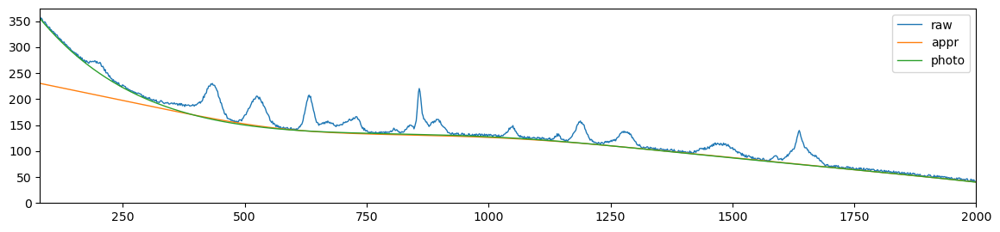

als_lambda: 23950.26619987486,	 als_p_weight: 0.0002395026619987486,	 error: 739.8333289410334, 	 smoothness: 0.5103223120162959, 	 smoothness: -0.5442171437963049


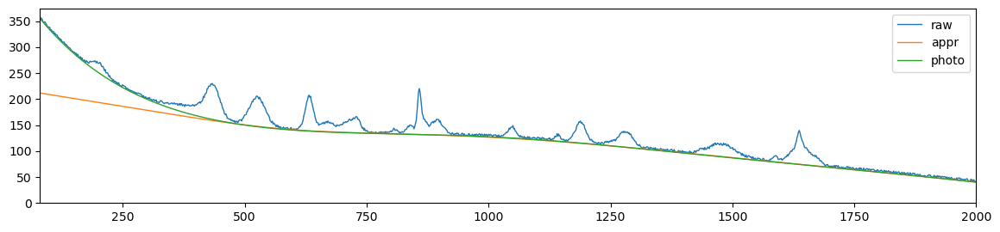

als_lambda: 23950.26619987486,	 als_p_weight: 0.00017433288221999874,	 error: 802.2798198485748, 	 smoothness: 0.5173161402930795, 	 smoothness: -0.5460188579740654


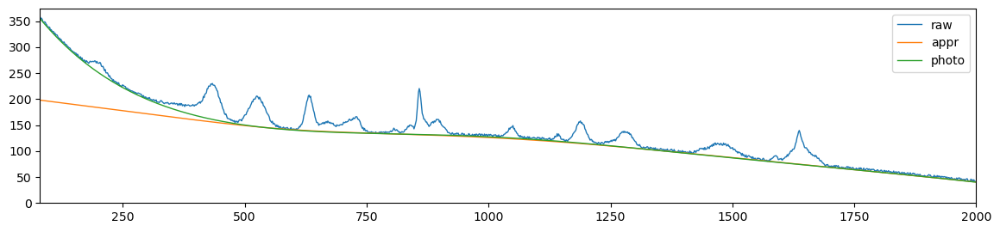

als_lambda: 23950.26619987486,	 als_p_weight: 0.0001268961003167922,	 error: 866.8024271632929, 	 smoothness: 0.5239607902628485, 	 smoothness: -0.5474667032391258


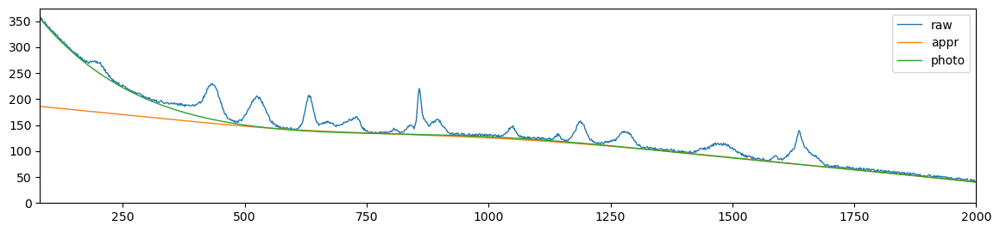

als_lambda: 23950.26619987486,	 als_p_weight: 9.236708571873866e-05,	 error: 928.021210586421, 	 smoothness: 0.5294453564694248, 	 smoothness: -0.5485968381074678


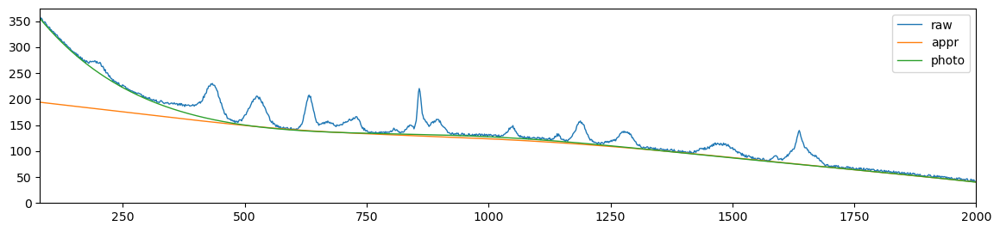

als_lambda: 23950.26619987486,	 als_p_weight: 6.723357536499335e-05,	 error: 964.0554229027555, 	 smoothness: 0.5329573802940935, 	 smoothness: -0.5493037208443114


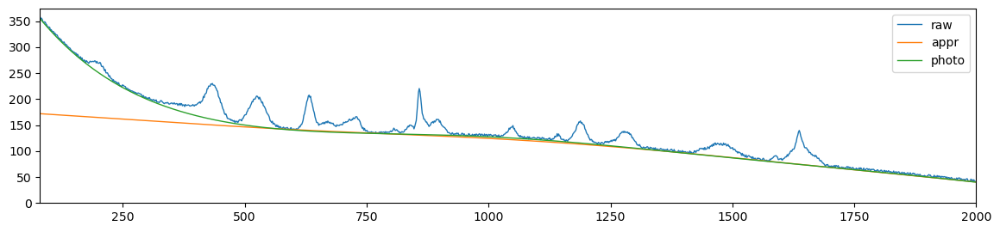

als_lambda: 23950.26619987486,	 als_p_weight: 4.893900918477499e-05,	 error: 1015.0276902051845, 	 smoothness: 0.537379677619241, 	 smoothness: -0.5502809610295583


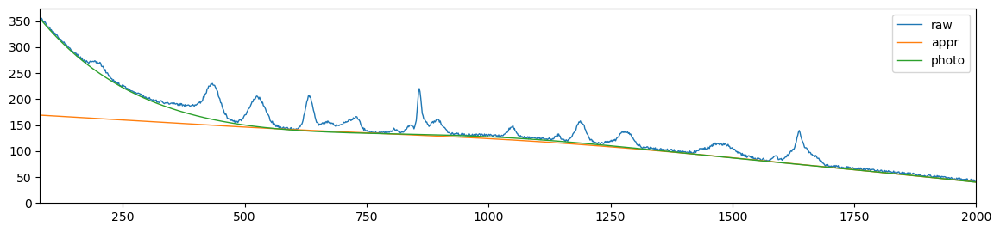

als_lambda: 23950.26619987486,	 als_p_weight: 3.5622478902624444e-05,	 error: 1045.9912132836178, 	 smoothness: 0.5401168405619596, 	 smoothness: -0.5513761182337952


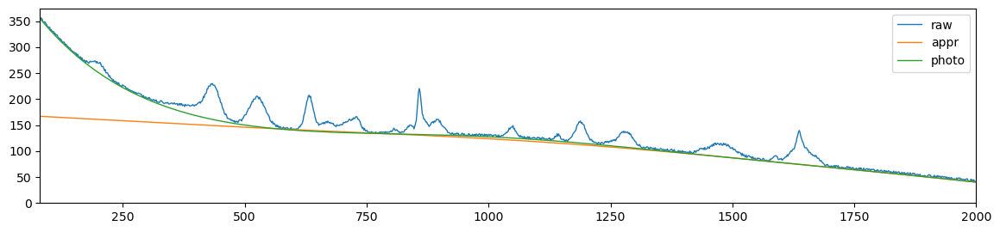

als_lambda: 23950.26619987486,	 als_p_weight: 2.592943797404667e-05,	 error: 1068.7401199711826, 	 smoothness: 0.5413062323417024, 	 smoothness: -0.5526361457705459


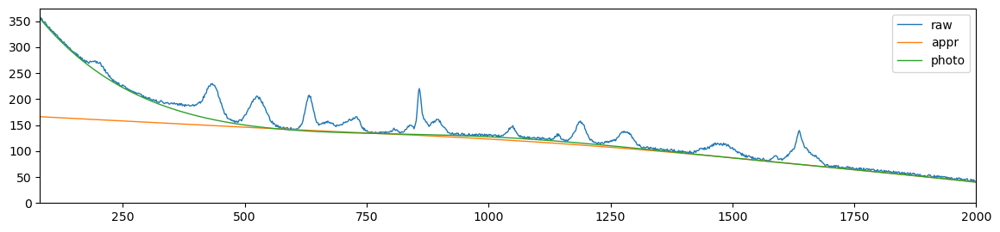

als_lambda: 23950.26619987486,	 als_p_weight: 1.8873918221350995e-05,	 error: 1113.4777688152421, 	 smoothness: 0.5421574084339627, 	 smoothness: -0.5540296902468163


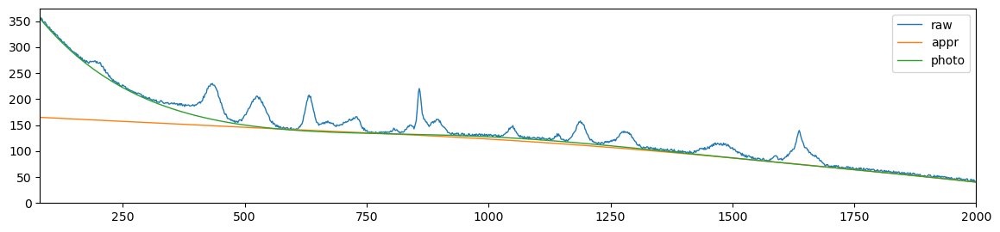

als_lambda: 23950.26619987486,	 als_p_weight: 1.3738237958832637e-05,	 error: 1164.2195330708073, 	 smoothness: 0.5427436698058048, 	 smoothness: -0.5556210860732916


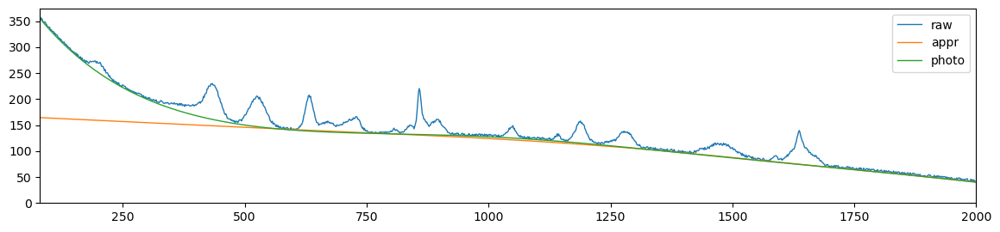

als_lambda: 23950.26619987486,	 als_p_weight: 1e-05,	 error: 1203.0964968393234, 	 smoothness: 0.5419290529582003, 	 smoothness: -0.556798484527891


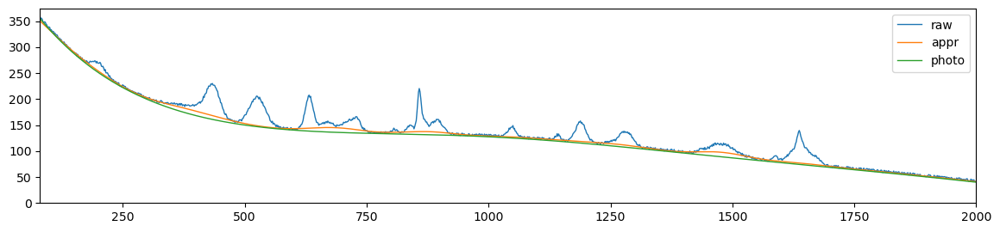

als_lambda: 41753.18936560409,	 als_p_weight: 0.1,	 error: 215.75646950820527, 	 smoothness: 0.34329573006433955, 	 smoothness: -0.44836559434273016


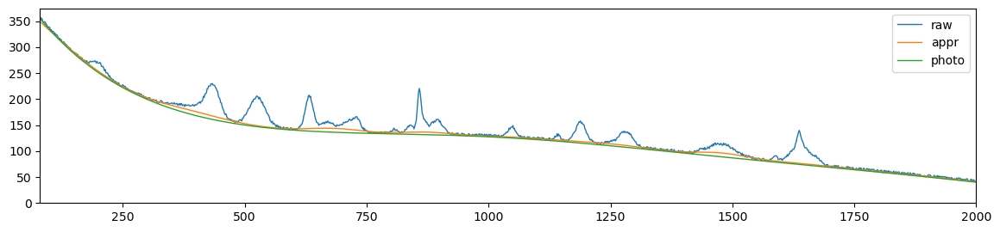

als_lambda: 41753.18936560409,	 als_p_weight: 0.0727895384398315,	 error: 233.56389502562226, 	 smoothness: 0.36166525513200193, 	 smoothness: -0.46693608035542106


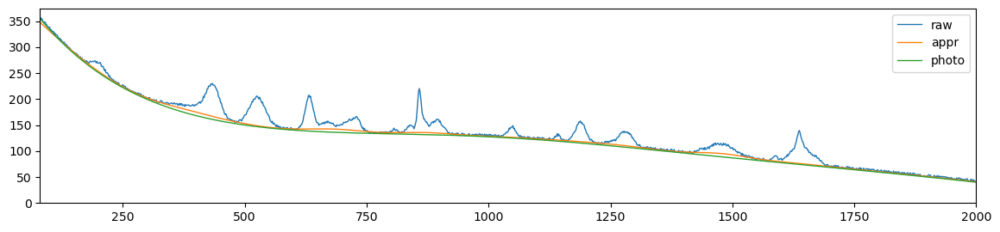

als_lambda: 41753.18936560409,	 als_p_weight: 0.05298316906283707,	 error: 245.2812145757963, 	 smoothness: 0.37202160546708674, 	 smoothness: -0.4770941981307344


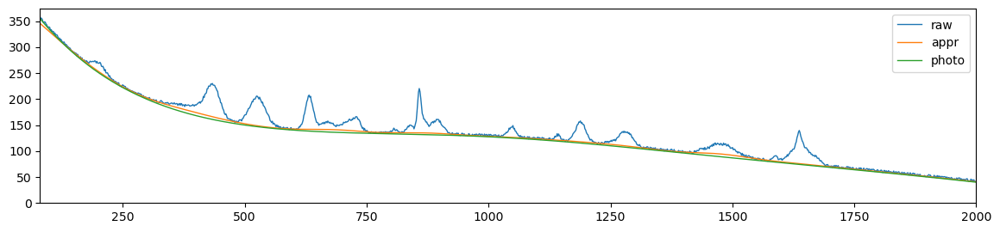

als_lambda: 41753.18936560409,	 als_p_weight: 0.03856620421163472,	 error: 262.6930138528737, 	 smoothness: 0.3839374506873593, 	 smoothness: -0.48766017550305585


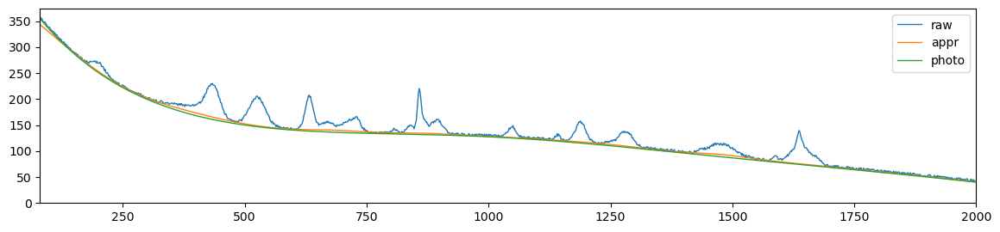

als_lambda: 41753.18936560409,	 als_p_weight: 0.02807216203941177,	 error: 283.5204392623979, 	 smoothness: 0.3950116850860627, 	 smoothness: -0.49540929348354174


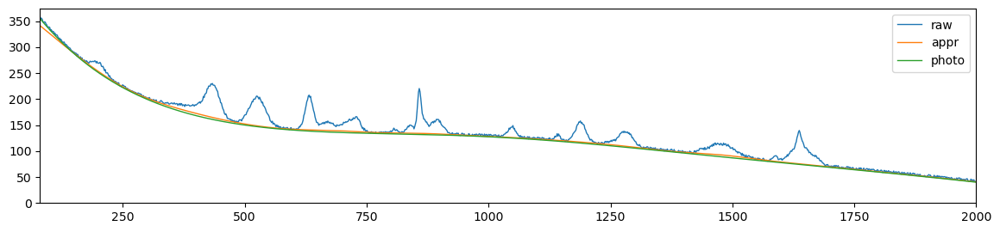

als_lambda: 41753.18936560409,	 als_p_weight: 0.020433597178569417,	 error: 301.00582329939766, 	 smoothness: 0.40402391444381375, 	 smoothness: -0.5009210129761543


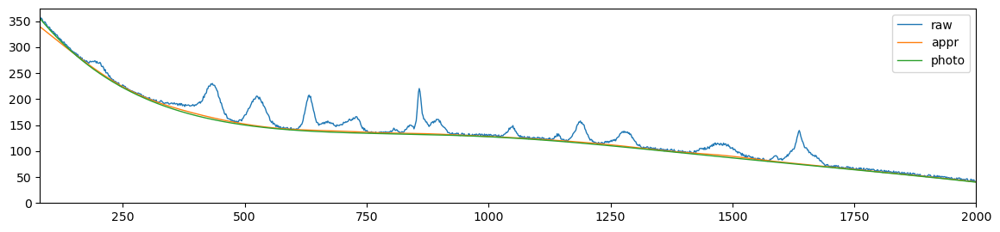

als_lambda: 41753.18936560409,	 als_p_weight: 0.014873521072935119,	 error: 320.1763112033509, 	 smoothness: 0.4132605062916192, 	 smoothness: -0.5062107204365741


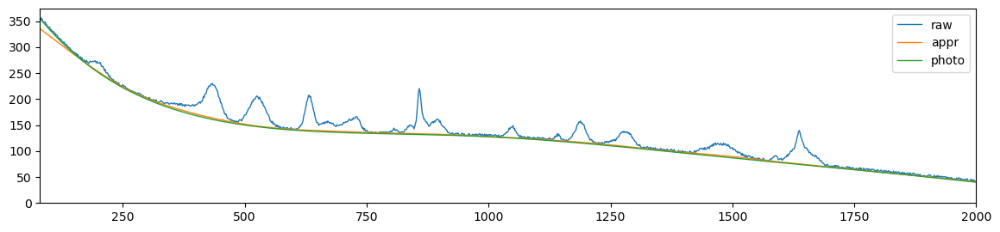

als_lambda: 41753.18936560409,	 als_p_weight: 0.010826367338740546,	 error: 342.9054004999539, 	 smoothness: 0.4230618511838664, 	 smoothness: -0.5116254556718455


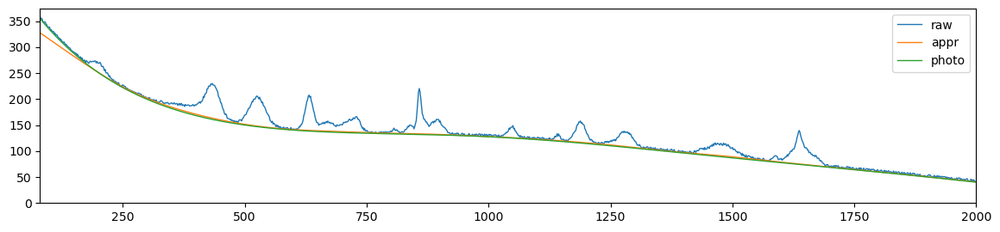

als_lambda: 41753.18936560409,	 als_p_weight: 0.007880462815669913,	 error: 369.06066817264303, 	 smoothness: 0.43298340147165537, 	 smoothness: -0.5165819029254756


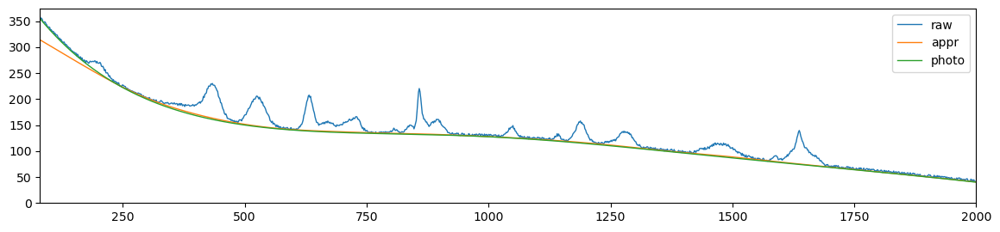

als_lambda: 41753.18936560409,	 als_p_weight: 0.005736152510448681,	 error: 396.06406349036655, 	 smoothness: 0.44229695333576374, 	 smoothness: -0.5204206215434987


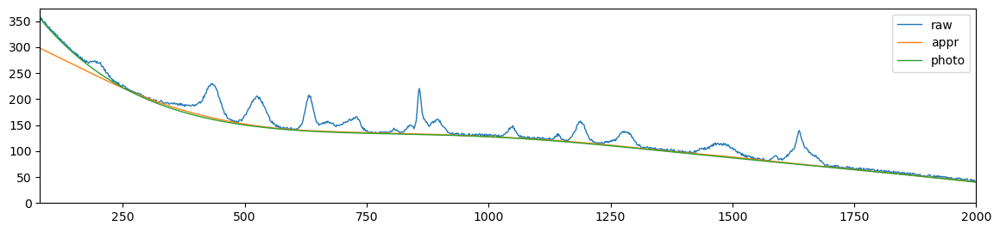

als_lambda: 41753.18936560409,	 als_p_weight: 0.0041753189365604,	 error: 424.9998433255215, 	 smoothness: 0.45146455605586266, 	 smoothness: -0.5240053902160109


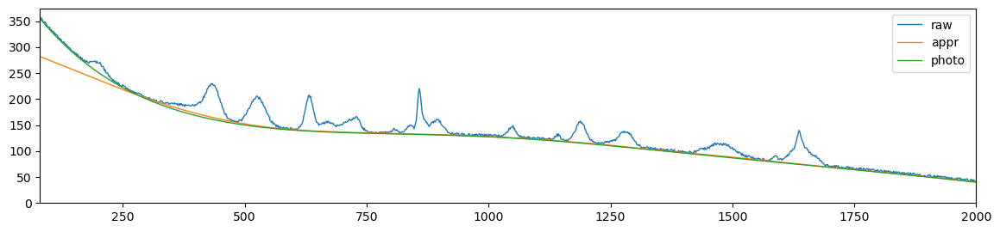

als_lambda: 41753.18936560409,	 als_p_weight: 0.0030391953823131978,	 error: 457.65945446586835, 	 smoothness: 0.460688725692856, 	 smoothness: -0.5276316014100242


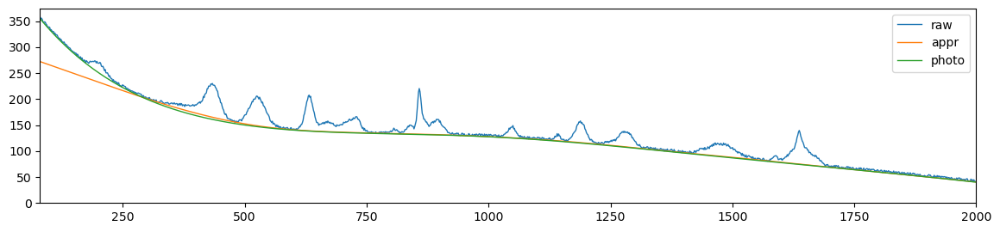

als_lambda: 41753.18936560409,	 als_p_weight: 0.00221221629107045,	 error: 495.29262895791885, 	 smoothness: 0.46985163957041864, 	 smoothness: -0.5311489416153033


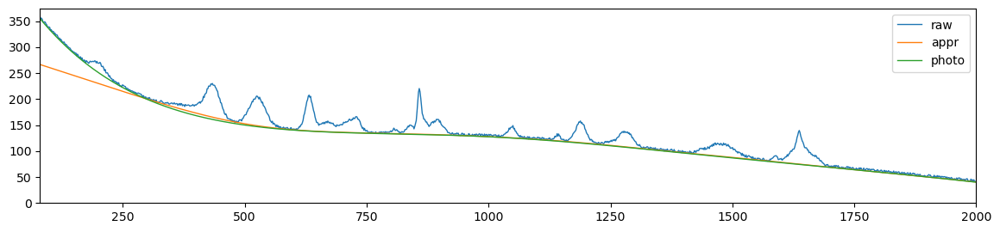

als_lambda: 41753.18936560409,	 als_p_weight: 0.0016102620275609393,	 error: 535.848851678114, 	 smoothness: 0.4785635245611155, 	 smoothness: -0.5340892928279355


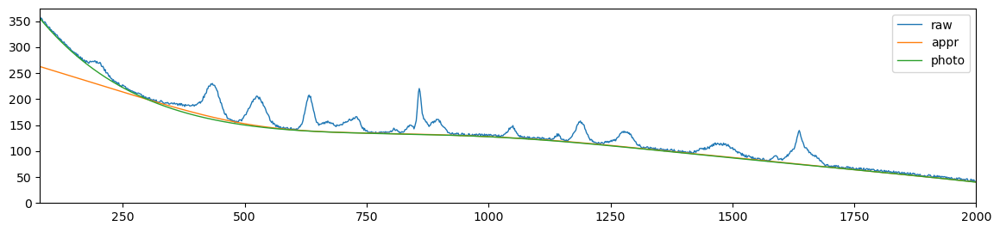

als_lambda: 41753.18936560409,	 als_p_weight: 0.0011721022975334804,	 error: 575.1116817627793, 	 smoothness: 0.4863624189326938, 	 smoothness: -0.5365171642628684


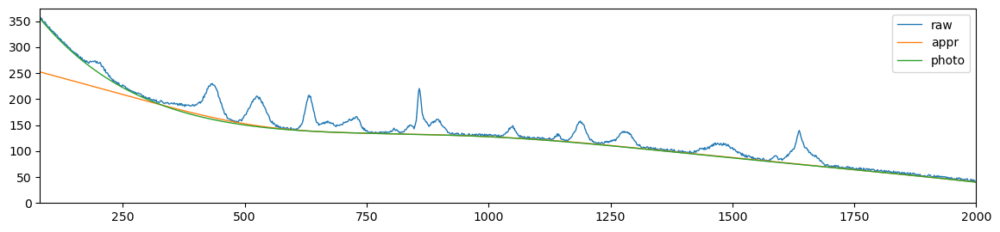

als_lambda: 41753.18936560409,	 als_p_weight: 0.0008531678524172806,	 error: 617.689938083142, 	 smoothness: 0.49373196056513086, 	 smoothness: -0.5387437106197097


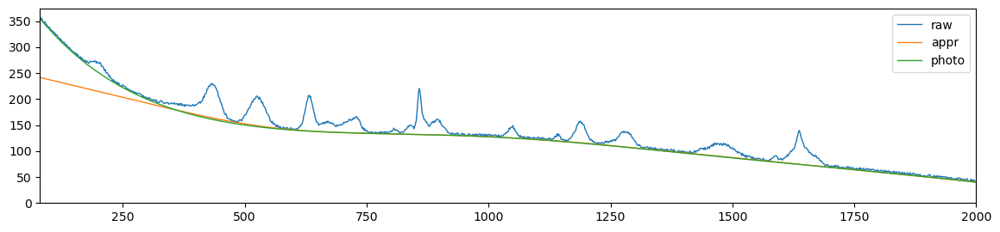

als_lambda: 41753.18936560409,	 als_p_weight: 0.0006210169418915617,	 error: 671.4280584741089, 	 smoothness: 0.5016025448969588, 	 smoothness: -0.5414495146803562


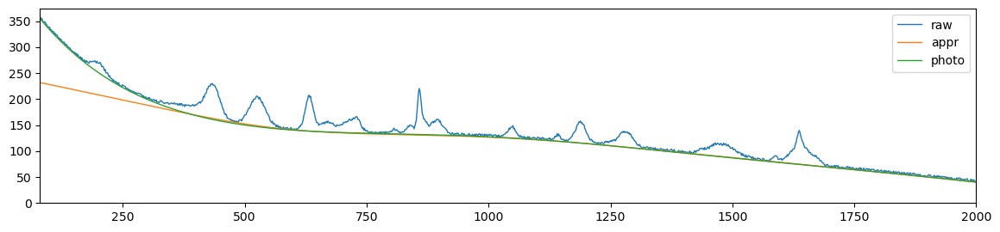

als_lambda: 41753.18936560409,	 als_p_weight: 0.00045203536563602454,	 error: 724.563721474529, 	 smoothness: 0.5086911907625541, 	 smoothness: -0.543657844918841


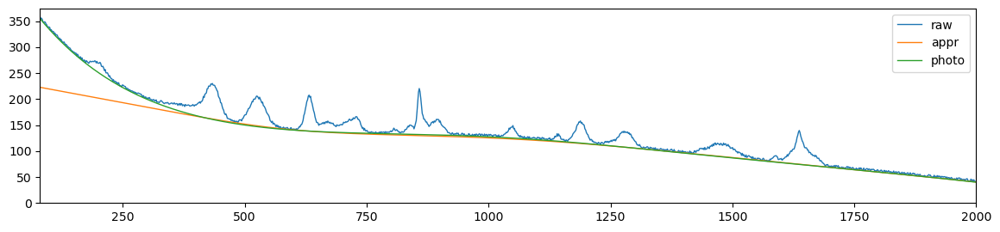

als_lambda: 41753.18936560409,	 als_p_weight: 0.00032903445623126676,	 error: 790.693177977129, 	 smoothness: 0.5161014107237336, 	 smoothness: -0.5457298793964207


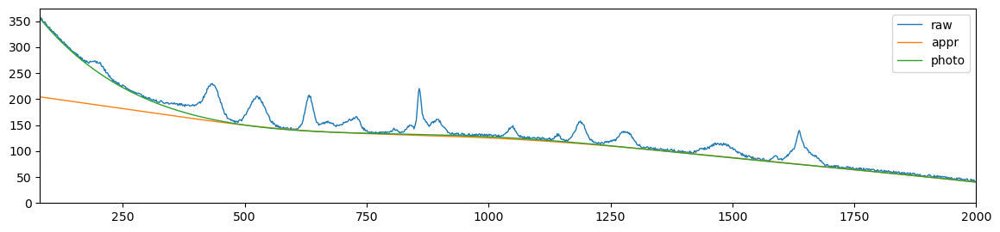

als_lambda: 41753.18936560409,	 als_p_weight: 0.0002395026619987486,	 error: 863.7263757365914, 	 smoothness: 0.5231770145148527, 	 smoothness: -0.5473547805466701


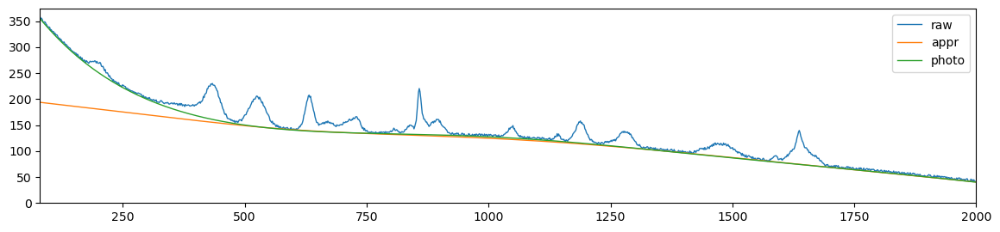

als_lambda: 41753.18936560409,	 als_p_weight: 0.00017433288221999874,	 error: 925.155836644951, 	 smoothness: 0.5291426634874558, 	 smoothness: -0.5485186836833292


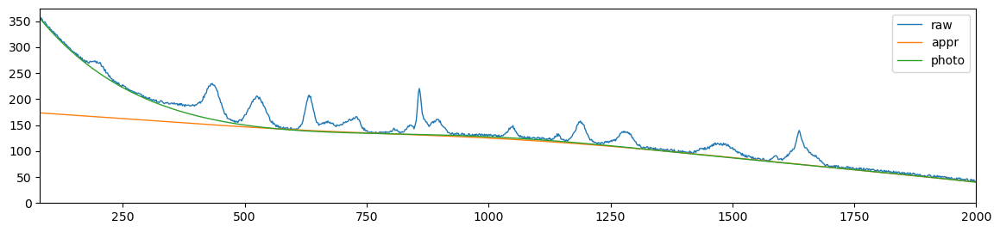

als_lambda: 41753.18936560409,	 als_p_weight: 0.0001268961003167922,	 error: 976.5564777444658, 	 smoothness: 0.5337379579291746, 	 smoothness: -0.5493861456378223


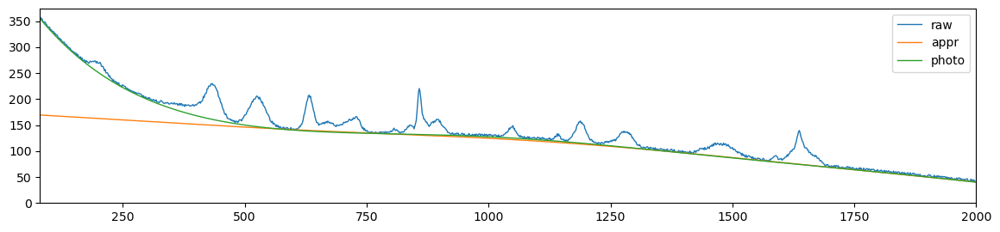

als_lambda: 41753.18936560409,	 als_p_weight: 9.236708571873866e-05,	 error: 1025.3171504254915, 	 smoothness: 0.53776382263664, 	 smoothness: -0.55025931327153


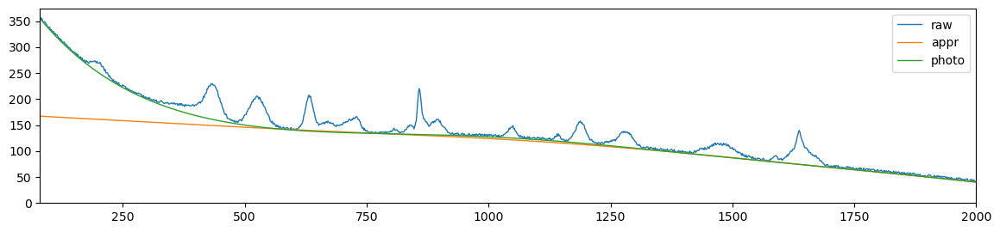

als_lambda: 41753.18936560409,	 als_p_weight: 6.723357536499335e-05,	 error: 1066.5950260644731, 	 smoothness: 0.5412439760897079, 	 smoothness: -0.5513924069633447


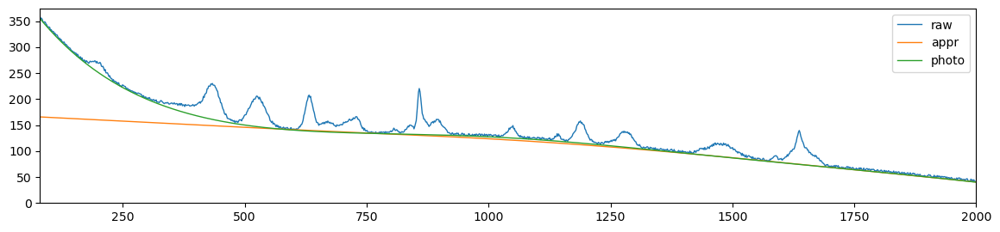

als_lambda: 41753.18936560409,	 als_p_weight: 4.893900918477499e-05,	 error: 1107.9282600271692, 	 smoothness: 0.5434798388106187, 	 smoothness: -0.5527328888223757


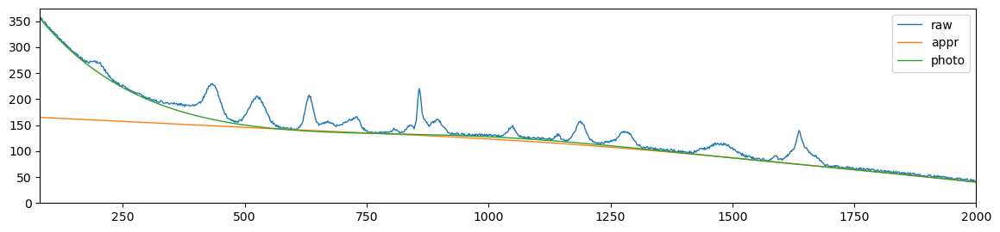

als_lambda: 41753.18936560409,	 als_p_weight: 3.5622478902624444e-05,	 error: 1145.1096185295155, 	 smoothness: 0.5448144709426733, 	 smoothness: -0.5541628742074237


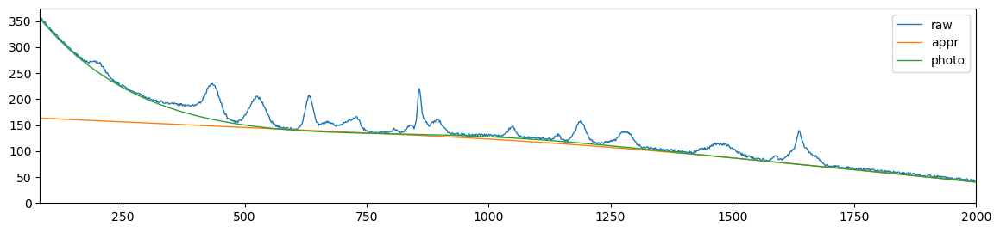

als_lambda: 41753.18936560409,	 als_p_weight: 2.592943797404667e-05,	 error: 1188.856601927333, 	 smoothness: 0.5448978908530306, 	 smoothness: -0.5556273790168375


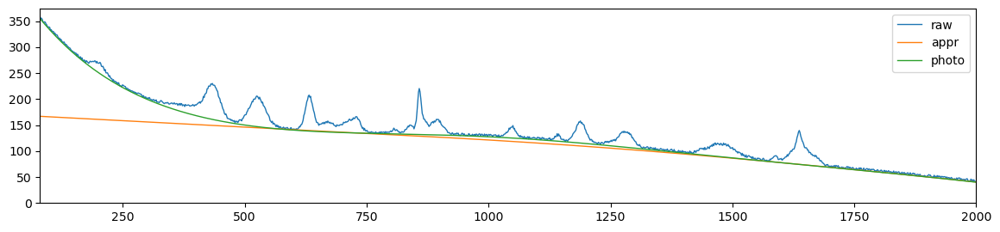

als_lambda: 41753.18936560409,	 als_p_weight: 1.8873918221350995e-05,	 error: 1254.0573669954904, 	 smoothness: 0.5443846210029066, 	 smoothness: -0.5575297165615327


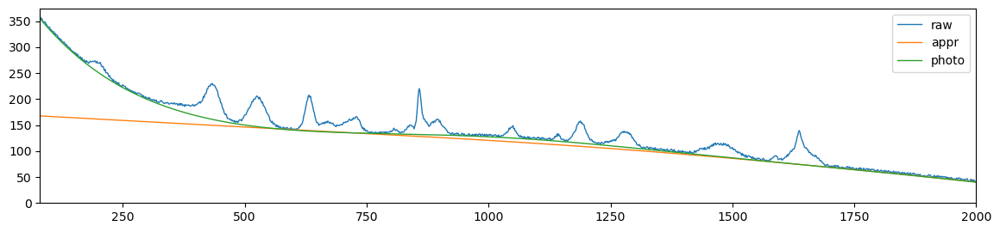

als_lambda: 41753.18936560409,	 als_p_weight: 1.3738237958832637e-05,	 error: 1326.811022258579, 	 smoothness: 0.542823830523348, 	 smoothness: -0.5589535711866518


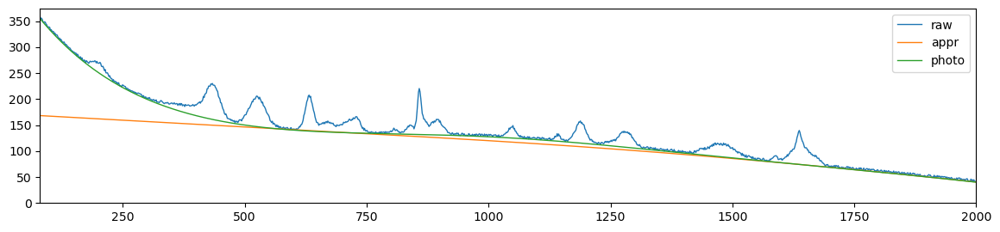

als_lambda: 41753.18936560409,	 als_p_weight: 1e-05,	 error: 1450.841183588939, 	 smoothness: 0.5397182173946522, 	 smoothness: -0.5604208113369327


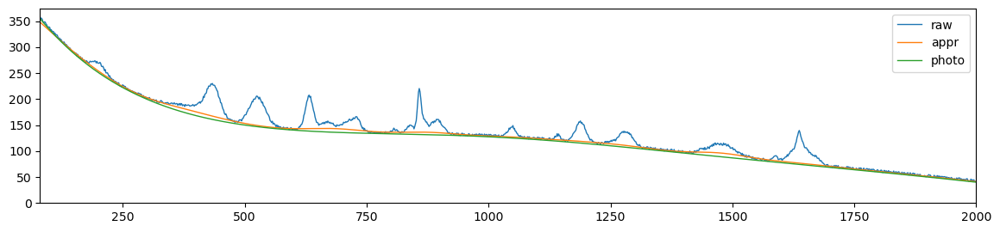

als_lambda: 72789.53843983161,	 als_p_weight: 0.1,	 error: 247.93044971512325, 	 smoothness: 0.37128268106627316, 	 smoothness: -0.4754764360433814


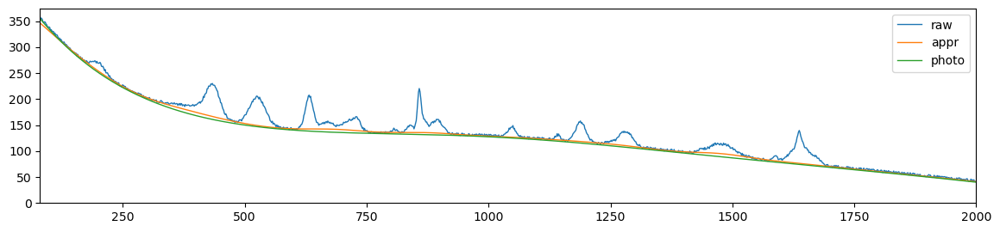

als_lambda: 72789.53843983161,	 als_p_weight: 0.0727895384398315,	 error: 261.4570134221547, 	 smoothness: 0.3819458769254749, 	 smoothness: -0.4854502352316269


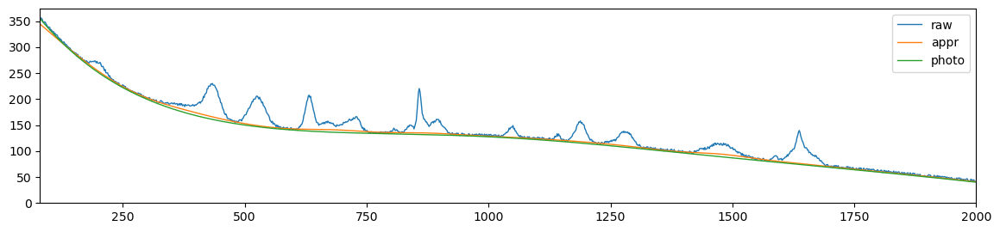

als_lambda: 72789.53843983161,	 als_p_weight: 0.05298316906283707,	 error: 281.49708779744867, 	 smoothness: 0.39368941136019303, 	 smoothness: -0.494361225018824


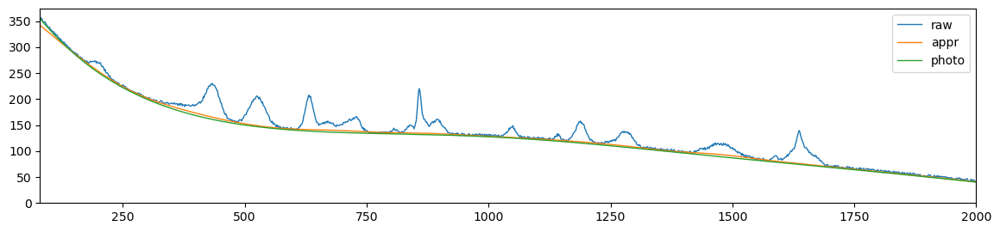

als_lambda: 72789.53843983161,	 als_p_weight: 0.03856620421163472,	 error: 298.9146812491652, 	 smoothness: 0.40280216947059605, 	 smoothness: -0.4999681208773393


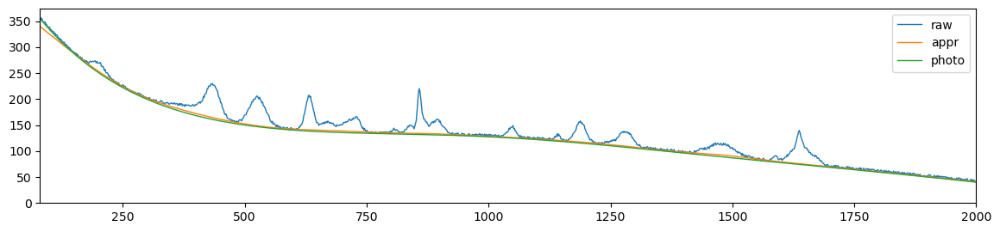

als_lambda: 72789.53843983161,	 als_p_weight: 0.02807216203941177,	 error: 316.7444077973941, 	 smoothness: 0.41174669235941325, 	 smoothness: -0.5052115794488935


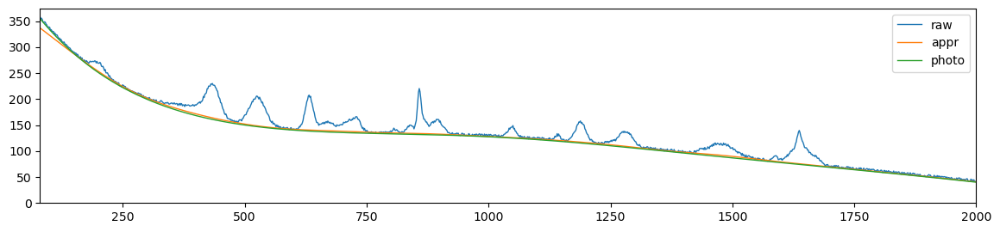

als_lambda: 72789.53843983161,	 als_p_weight: 0.020433597178569417,	 error: 338.1361160089115, 	 smoothness: 0.4213513405490083, 	 smoothness: -0.5106173496814259


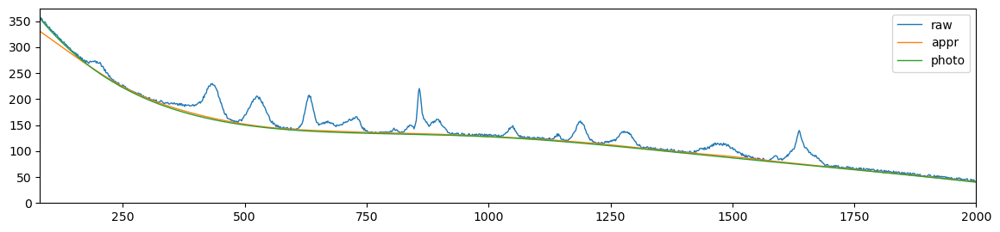

als_lambda: 72789.53843983161,	 als_p_weight: 0.014873521072935119,	 error: 362.3401791975585, 	 smoothness: 0.4310003154283135, 	 smoothness: -0.5155482581051551


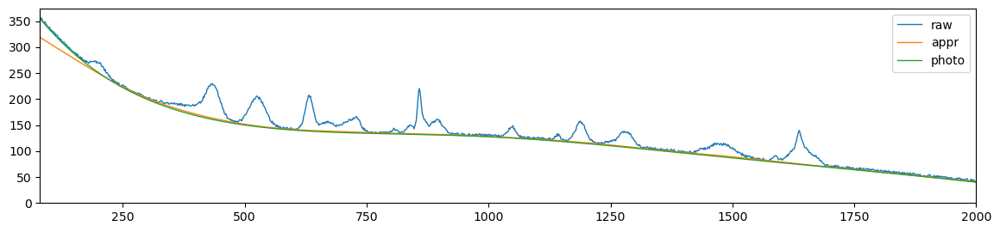

als_lambda: 72789.53843983161,	 als_p_weight: 0.010826367338740546,	 error: 388.94531936334874, 	 smoothness: 0.4403873202665975, 	 smoothness: -0.5195929649372486


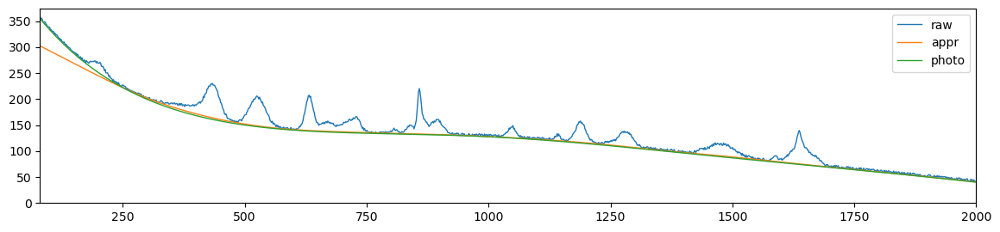

als_lambda: 72789.53843983161,	 als_p_weight: 0.007880462815669913,	 error: 416.78795378287606, 	 smoothness: 0.44946341320904487, 	 smoothness: -0.5231735605177796


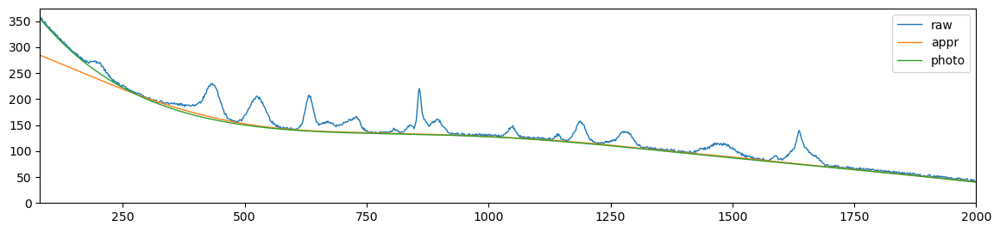

als_lambda: 72789.53843983161,	 als_p_weight: 0.005736152510448681,	 error: 448.0516308027118, 	 smoothness: 0.4586043505148892, 	 smoothness: -0.5267923078078198


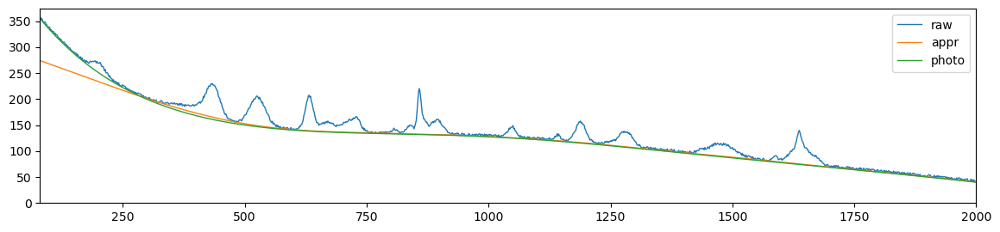

als_lambda: 72789.53843983161,	 als_p_weight: 0.0041753189365604,	 error: 483.86010415535156, 	 smoothness: 0.46771902566495405, 	 smoothness: -0.5303382754154142


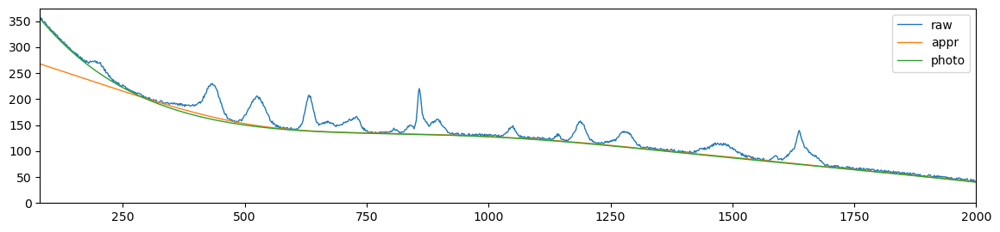

als_lambda: 72789.53843983161,	 als_p_weight: 0.0030391953823131978,	 error: 524.5638784555256, 	 smoothness: 0.47662944209063274, 	 smoothness: -0.5334668639906741


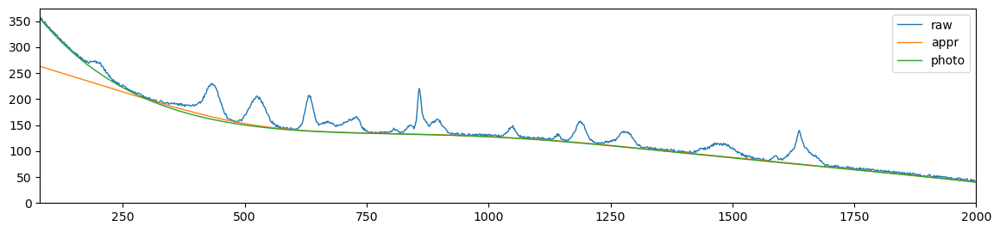

als_lambda: 72789.53843983161,	 als_p_weight: 0.00221221629107045,	 error: 564.0273708392517, 	 smoothness: 0.4846163792936815, 	 smoothness: -0.5360287069010468


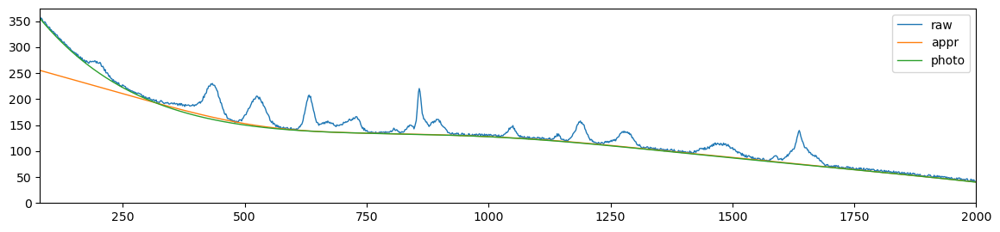

als_lambda: 72789.53843983161,	 als_p_weight: 0.0016102620275609393,	 error: 605.3775676351538, 	 smoothness: 0.49204602247566825, 	 smoothness: -0.538267866921447


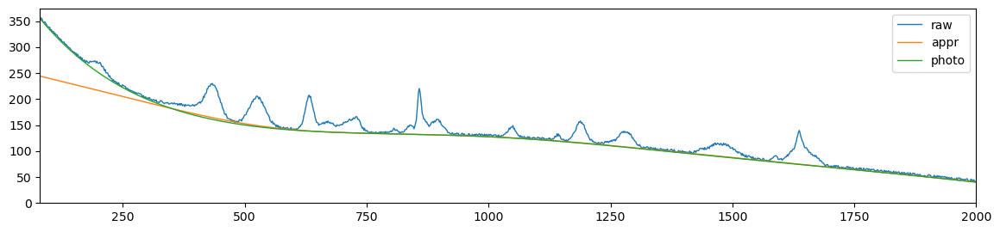

als_lambda: 72789.53843983161,	 als_p_weight: 0.0011721022975334804,	 error: 656.1005962043076, 	 smoothness: 0.4998234212214978, 	 smoothness: -0.5408281877003486


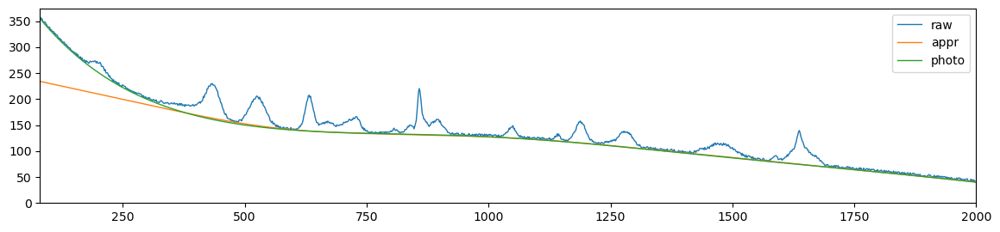

als_lambda: 72789.53843983161,	 als_p_weight: 0.0008531678524172806,	 error: 710.7546580920742, 	 smoothness: 0.507153556749834, 	 smoothness: -0.5431816549259929


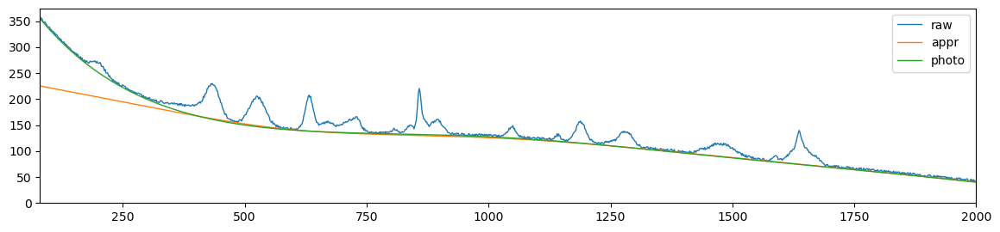

als_lambda: 72789.53843983161,	 als_p_weight: 0.0006210169418915617,	 error: 773.3184847964397, 	 smoothness: 0.5145506601931943, 	 smoothness: -0.5452906113353234


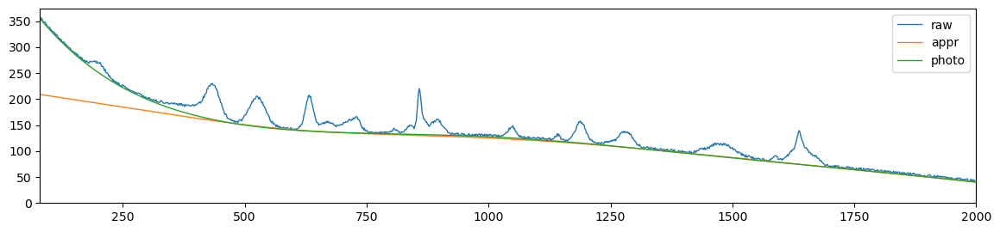

als_lambda: 72789.53843983161,	 als_p_weight: 0.00045203536563602454,	 error: 847.9334957385305, 	 smoothness: 0.5217909162745384, 	 smoothness: -0.5470822794837946


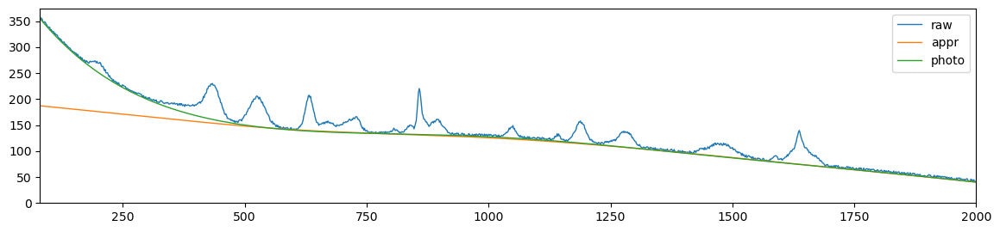

als_lambda: 72789.53843983161,	 als_p_weight: 0.00032903445623126676,	 error: 915.8440187229539, 	 smoothness: 0.5282201778612036, 	 smoothness: -0.548380234789596


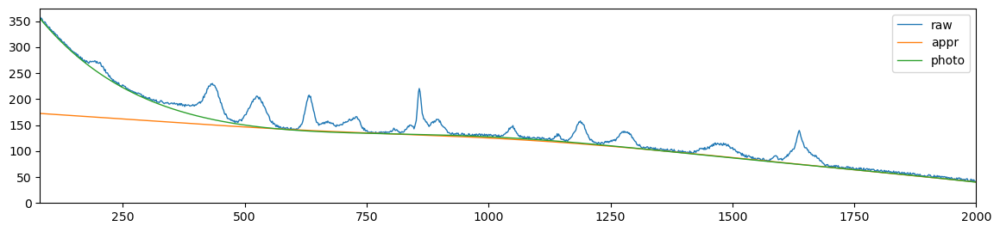

als_lambda: 72789.53843983161,	 als_p_weight: 0.0002395026619987486,	 error: 974.8298927730561, 	 smoothness: 0.5334895891945551, 	 smoothness: -0.5492941724359099


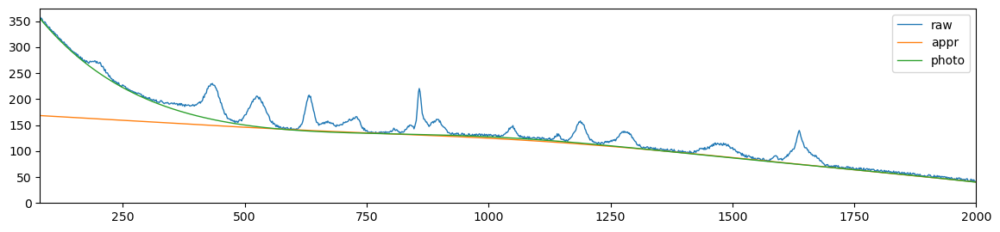

als_lambda: 72789.53843983161,	 als_p_weight: 0.00017433288221999874,	 error: 1025.1619466212571, 	 smoothness: 0.5377508341119189, 	 smoothness: -0.5501399247148151


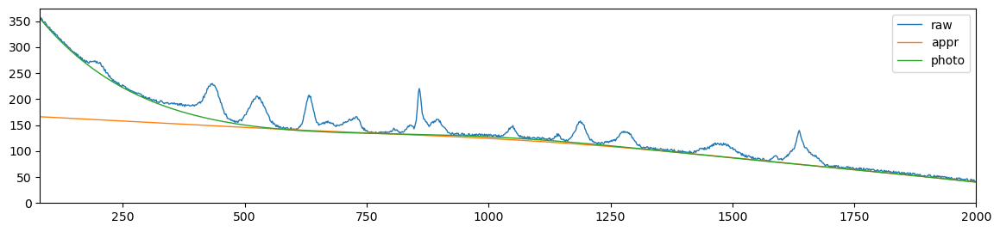

als_lambda: 72789.53843983161,	 als_p_weight: 0.0001268961003167922,	 error: 1066.9217429875007, 	 smoothness: 0.5413062786671281, 	 smoothness: -0.5511733007783731


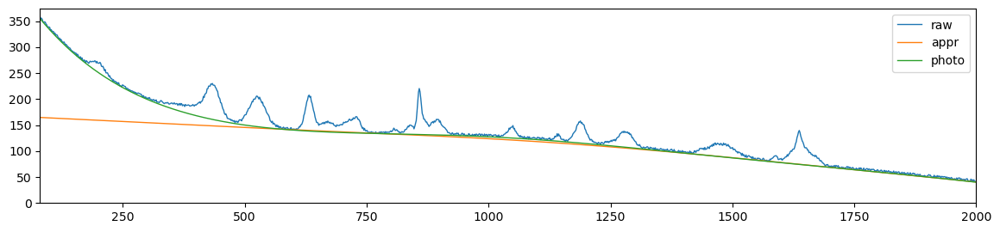

als_lambda: 72789.53843983161,	 als_p_weight: 9.236708571873866e-05,	 error: 1111.158942990148, 	 smoothness: 0.5441688077590071, 	 smoothness: -0.5526120020684456


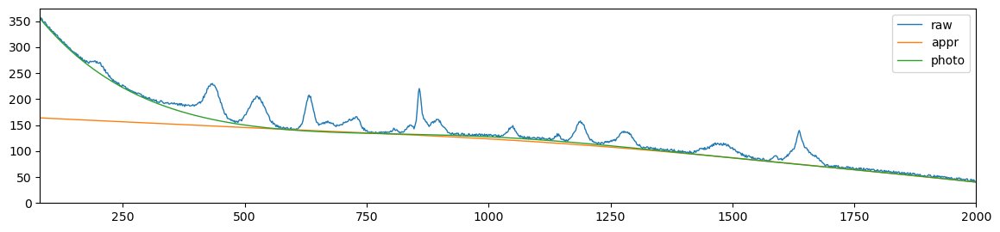

als_lambda: 72789.53843983161,	 als_p_weight: 6.723357536499335e-05,	 error: 1145.577711142016, 	 smoothness: 0.5455305216386226, 	 smoothness: -0.5540350410929532


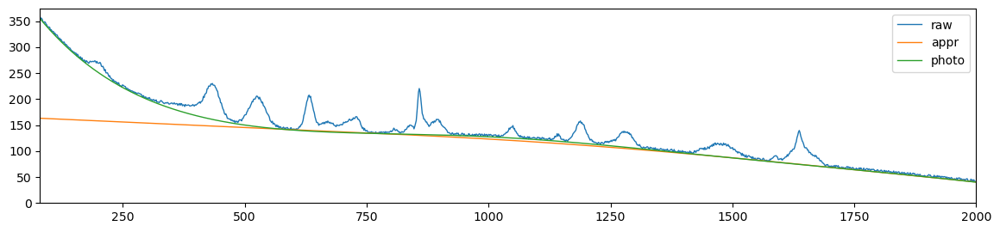

als_lambda: 72789.53843983161,	 als_p_weight: 4.893900918477499e-05,	 error: 1188.5951440640126, 	 smoothness: 0.5460491863999939, 	 smoothness: -0.5556218266403139


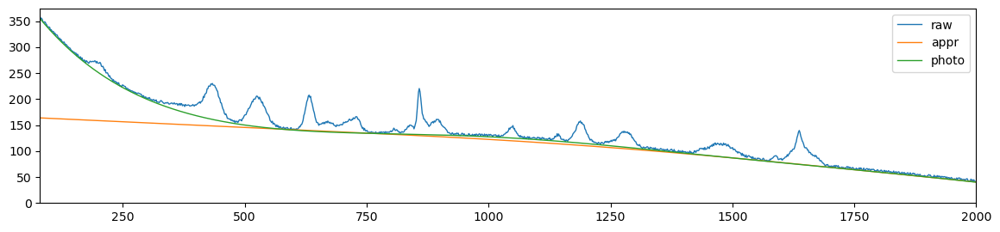

als_lambda: 72789.53843983161,	 als_p_weight: 3.5622478902624444e-05,	 error: 1246.912140409316, 	 smoothness: 0.5454595854194839, 	 smoothness: -0.5572369469300879


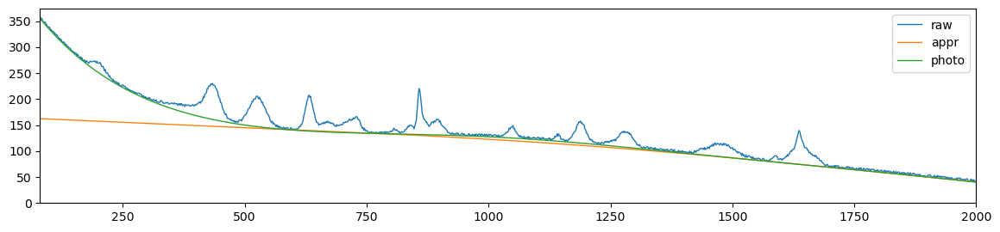

als_lambda: 72789.53843983161,	 als_p_weight: 2.592943797404667e-05,	 error: 1323.02789111788, 	 smoothness: 0.5438112009252862, 	 smoothness: -0.5590357996855322


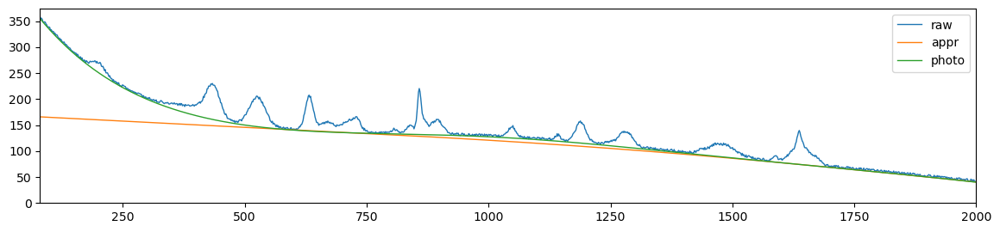

als_lambda: 72789.53843983161,	 als_p_weight: 1.8873918221350995e-05,	 error: 1429.5718790154956, 	 smoothness: 0.5416024209920856, 	 smoothness: -0.5605617794685167


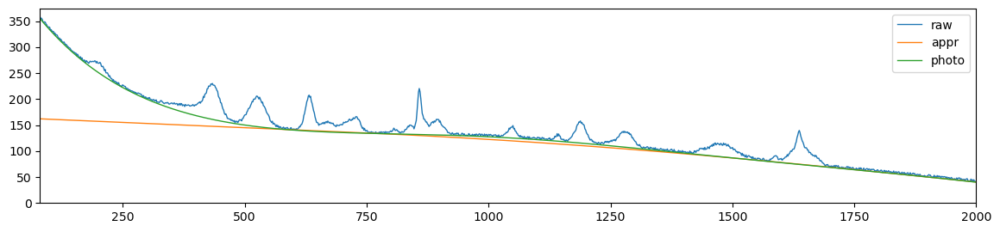

als_lambda: 72789.53843983161,	 als_p_weight: 1.3738237958832637e-05,	 error: 1557.4617806979272, 	 smoothness: 0.5382324122369294, 	 smoothness: -0.5617393547849522


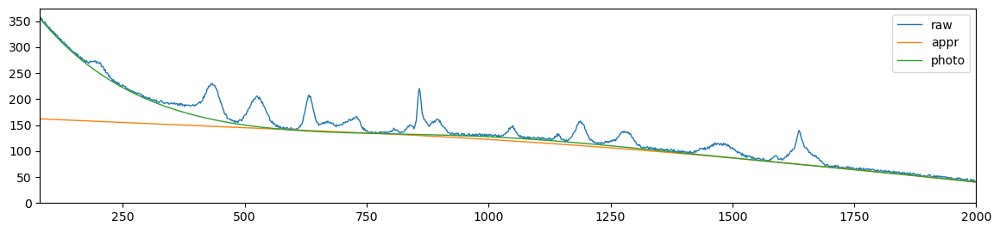

als_lambda: 72789.53843983161,	 als_p_weight: 1e-05,	 error: 1695.1345303393418, 	 smoothness: 0.535974680578944, 	 smoothness: -0.5623869843383369


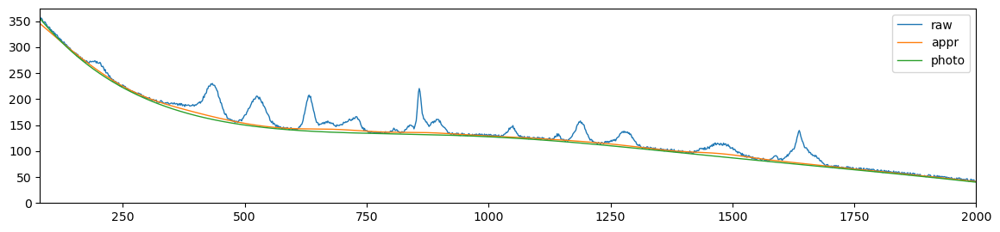

als_lambda: 126896.10031679235,	 als_p_weight: 0.1,	 error: 280.8285180503662, 	 smoothness: 0.3924048247969187, 	 smoothness: -0.4931251809839381


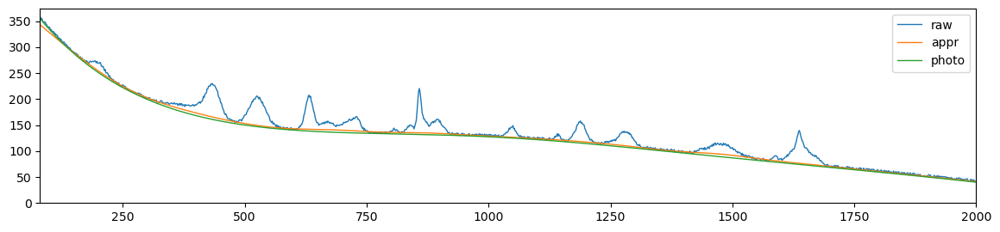

als_lambda: 126896.10031679235,	 als_p_weight: 0.0727895384398315,	 error: 298.4232609441658, 	 smoothness: 0.40193253065197077, 	 smoothness: -0.4990567289734078


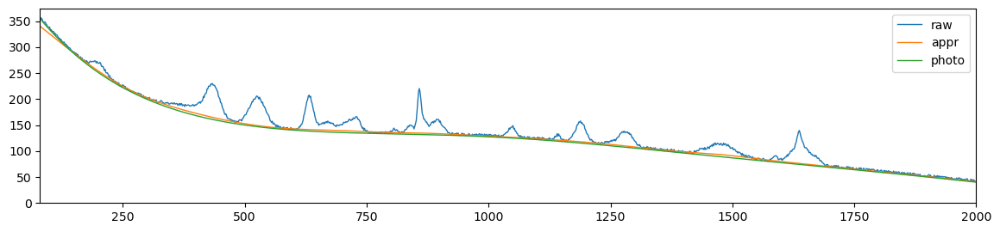

als_lambda: 126896.10031679235,	 als_p_weight: 0.05298316906283707,	 error: 314.3792780786056, 	 smoothness: 0.41046168655581966, 	 smoothness: -0.5042003326838496


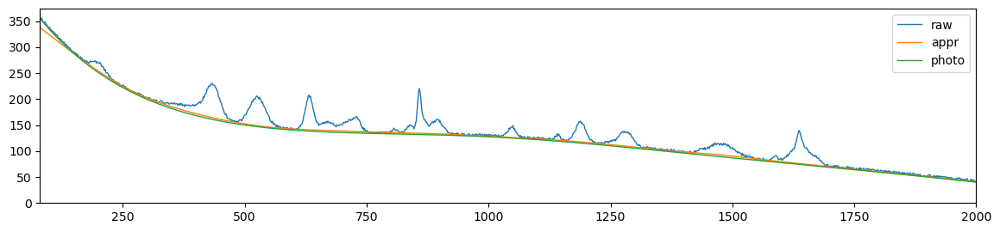

als_lambda: 126896.10031679235,	 als_p_weight: 0.03856620421163472,	 error: 334.1364902886819, 	 smoothness: 0.41980130212917066, 	 smoothness: -0.509548842096612


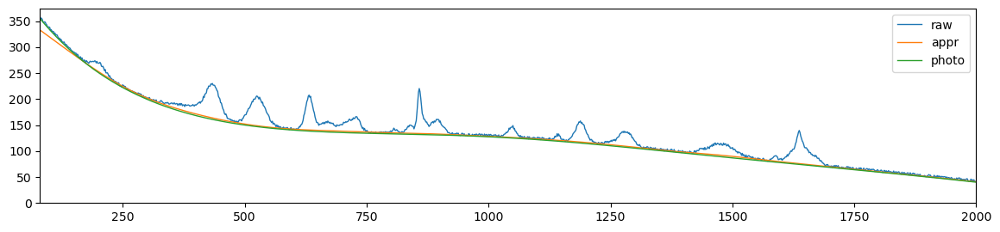

als_lambda: 126896.10031679235,	 als_p_weight: 0.02807216203941177,	 error: 356.5885084105659, 	 smoothness: 0.4291829313364197, 	 smoothness: -0.5144408959061771


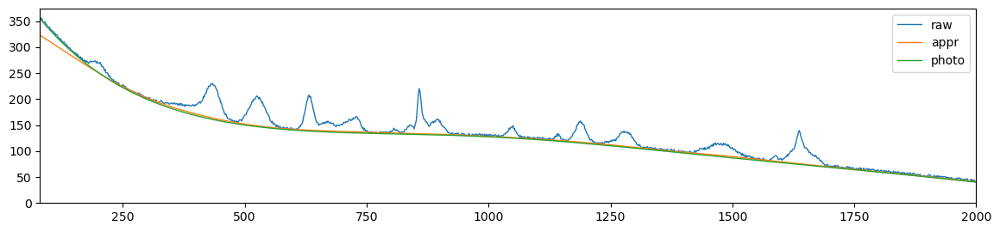

als_lambda: 126896.10031679235,	 als_p_weight: 0.020433597178569417,	 error: 381.9672284184643, 	 smoothness: 0.43854884947474, 	 smoothness: -0.5187266193208601


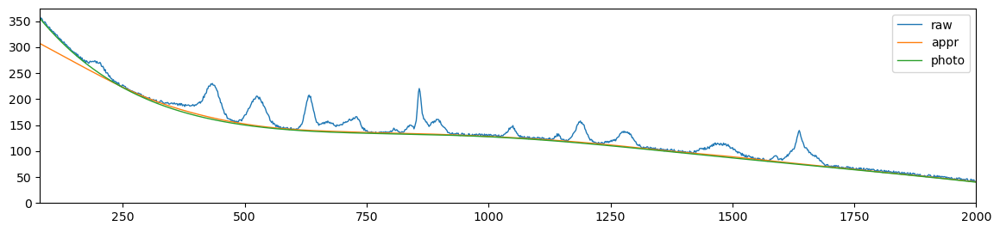

als_lambda: 126896.10031679235,	 als_p_weight: 0.014873521072935119,	 error: 409.1068910041834, 	 smoothness: 0.44759341232541133, 	 smoothness: -0.5223822239524644


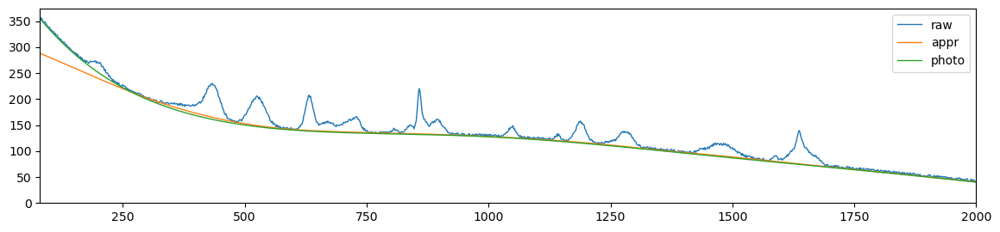

als_lambda: 126896.10031679235,	 als_p_weight: 0.010826367338740546,	 error: 438.8928914947848, 	 smoothness: 0.4565887159876352, 	 smoothness: -0.5259611773410685


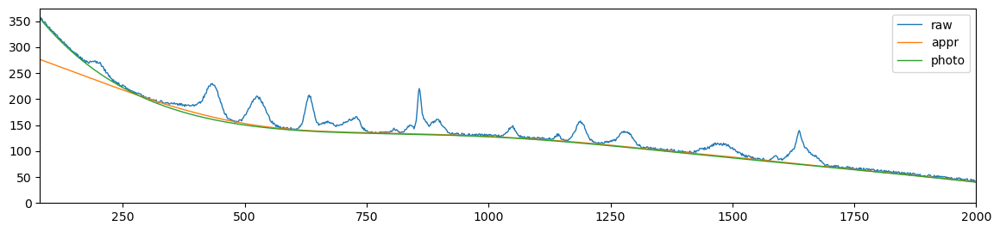

als_lambda: 126896.10031679235,	 als_p_weight: 0.007880462815669913,	 error: 473.02968779493006, 	 smoothness: 0.4656723731437155, 	 smoothness: -0.5295278365299596


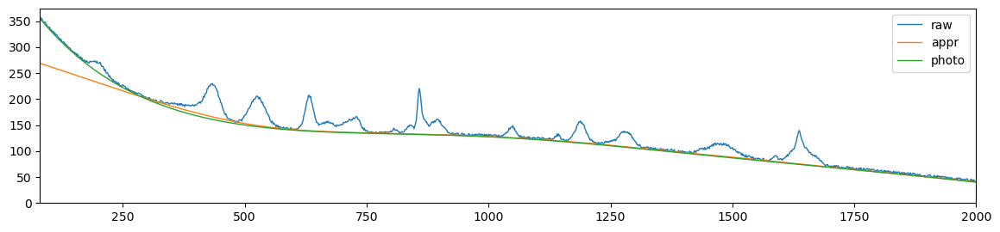

als_lambda: 126896.10031679235,	 als_p_weight: 0.005736152510448681,	 error: 512.5338411630811, 	 smoothness: 0.47461453368910506, 	 smoothness: -0.5327661708871776


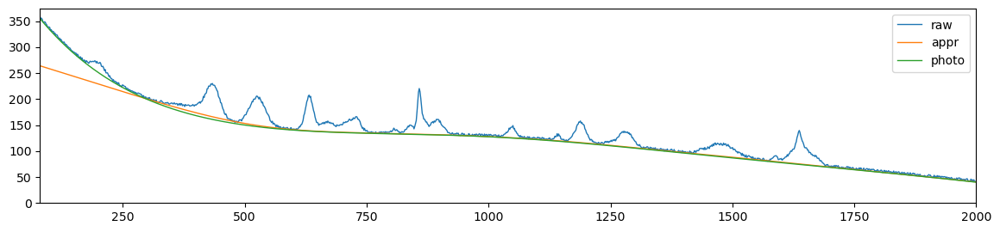

als_lambda: 126896.10031679235,	 als_p_weight: 0.0041753189365604,	 error: 553.3352353708382, 	 smoothness: 0.48292848396804217, 	 smoothness: -0.535548222446451


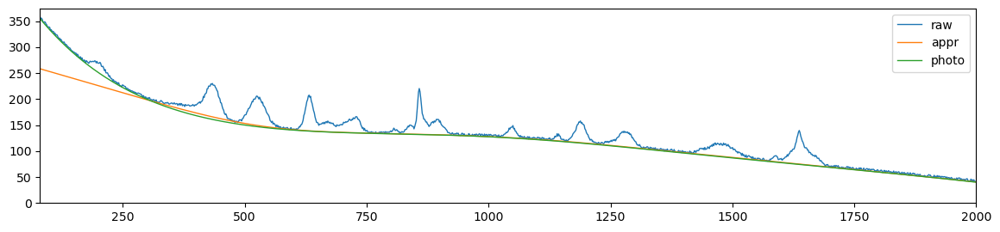

als_lambda: 126896.10031679235,	 als_p_weight: 0.0030391953823131978,	 error: 593.7905237865027, 	 smoothness: 0.49043737378649077, 	 smoothness: -0.5378258272561689


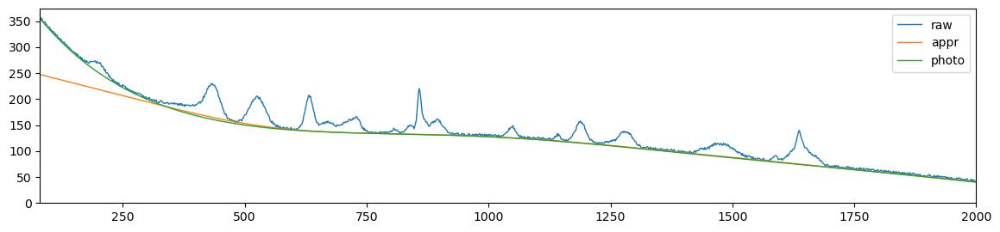

als_lambda: 126896.10031679235,	 als_p_weight: 0.00221221629107045,	 error: 641.1219308842412, 	 smoothness: 0.49800299733001985, 	 smoothness: -0.5402625610137483


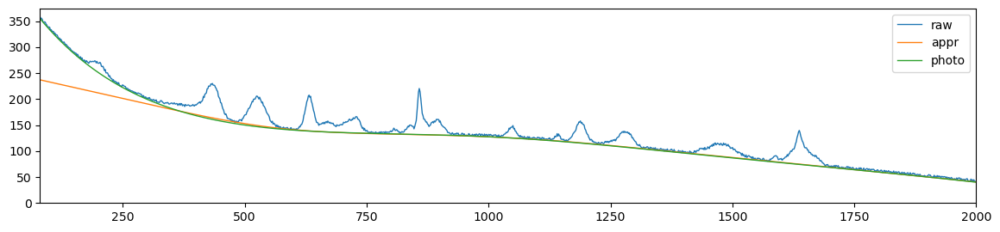

als_lambda: 126896.10031679235,	 als_p_weight: 0.0016102620275609393,	 error: 697.027151870415, 	 smoothness: 0.505671720957056, 	 smoothness: -0.5427091939142061


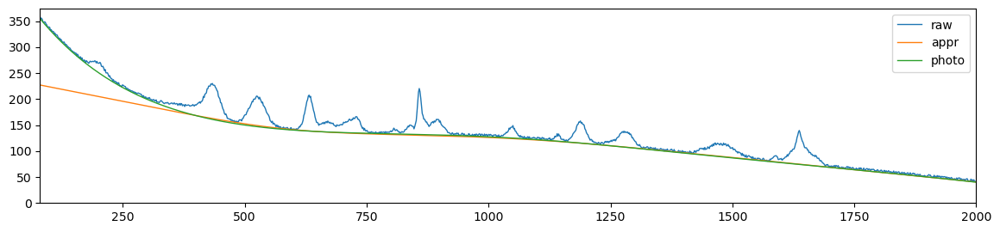

als_lambda: 126896.10031679235,	 als_p_weight: 0.0011721022975334804,	 error: 757.8606660764592, 	 smoothness: 0.5130035783570666, 	 smoothness: -0.5449703989584054


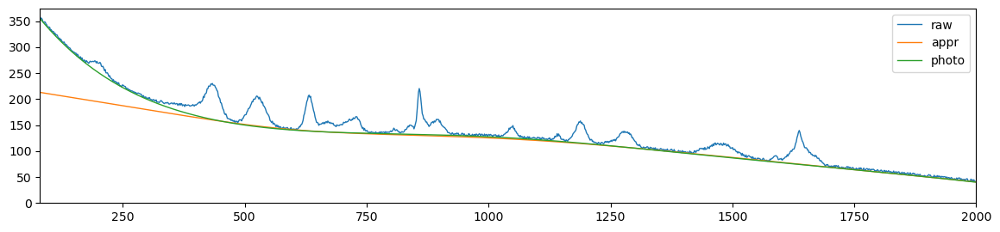

als_lambda: 126896.10031679235,	 als_p_weight: 0.0008531678524172806,	 error: 828.5414968244072, 	 smoothness: 0.5201997110253985, 	 smoothness: -0.5467570145922158


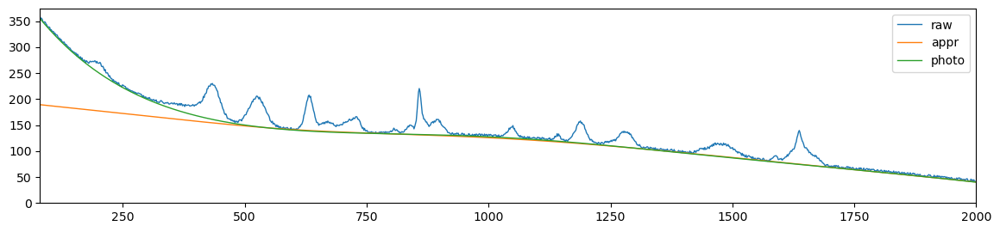

als_lambda: 126896.10031679235,	 als_p_weight: 0.0006210169418915617,	 error: 899.1771281956803, 	 smoothness: 0.5268806863145582, 	 smoothness: -0.5481631044595142


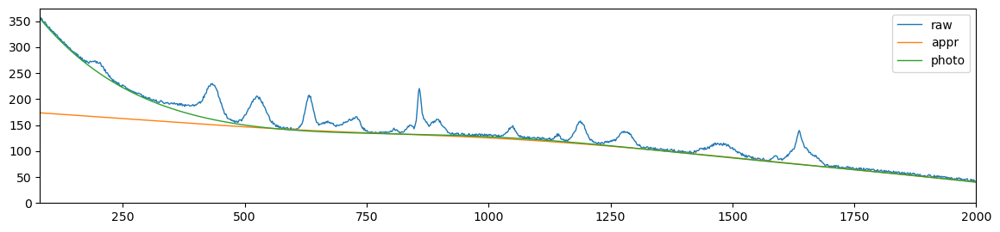

als_lambda: 126896.10031679235,	 als_p_weight: 0.00045203536563602454,	 error: 962.3622952667474, 	 smoothness: 0.5325091633782358, 	 smoothness: -0.5492006829872903


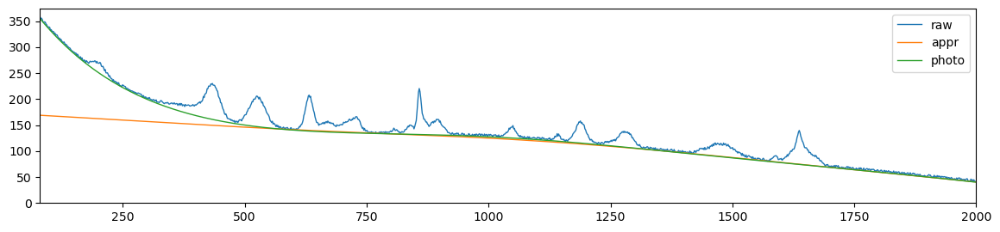

als_lambda: 126896.10031679235,	 als_p_weight: 0.00032903445623126676,	 error: 1011.1603968579773, 	 smoothness: 0.5368582798090027, 	 smoothness: -0.5499829101550866


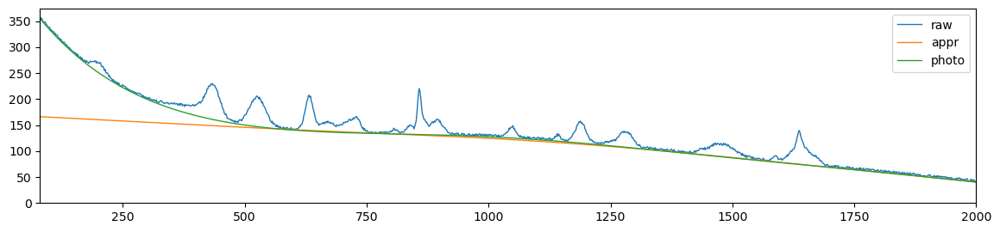

als_lambda: 126896.10031679235,	 als_p_weight: 0.0002395026619987486,	 error: 1061.3075509648581, 	 smoothness: 0.5408162409953886, 	 smoothness: -0.5510248563674868


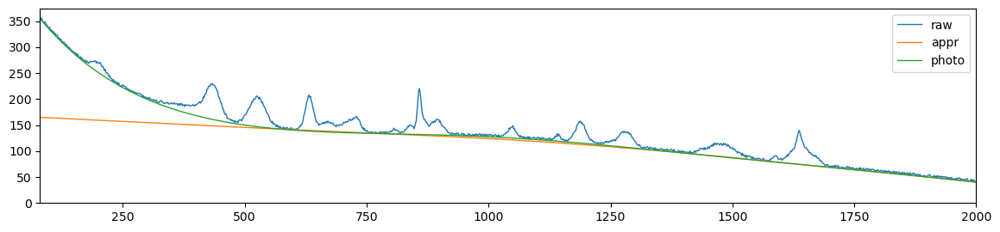

als_lambda: 126896.10031679235,	 als_p_weight: 0.00017433288221999874,	 error: 1103.2455719462105, 	 smoothness: 0.5438751250151292, 	 smoothness: -0.552373707013269


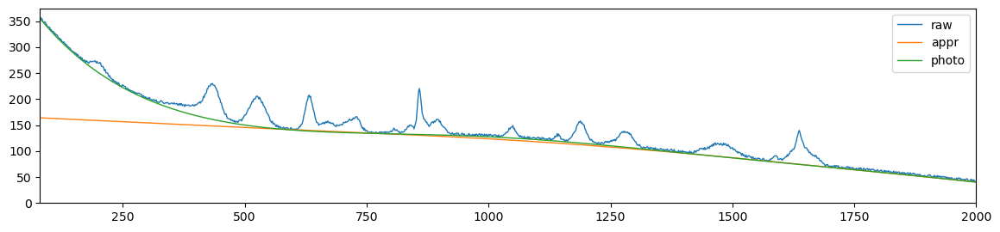

als_lambda: 126896.10031679235,	 als_p_weight: 0.0001268961003167922,	 error: 1146.557447310194, 	 smoothness: 0.545768759679965, 	 smoothness: -0.5539214716537352


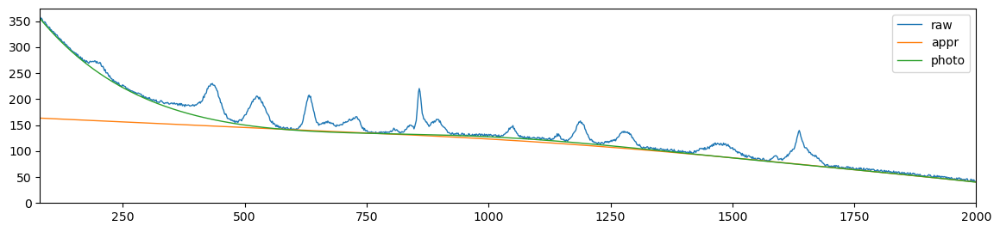

als_lambda: 126896.10031679235,	 als_p_weight: 9.236708571873866e-05,	 error: 1191.8524276792045, 	 smoothness: 0.545737796850756, 	 smoothness: -0.5554767279770649


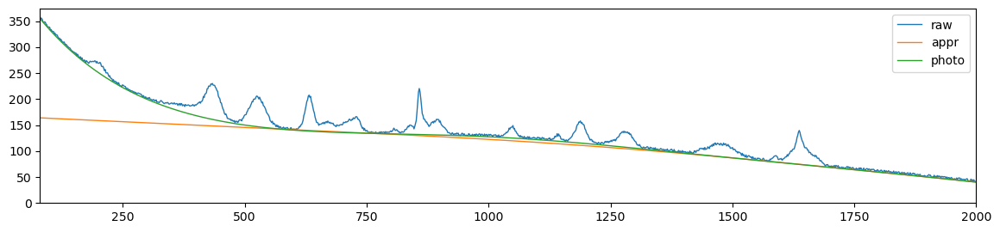

als_lambda: 126896.10031679235,	 als_p_weight: 6.723357536499335e-05,	 error: 1242.208469385022, 	 smoothness: 0.5447314062636445, 	 smoothness: -0.5571259685300726


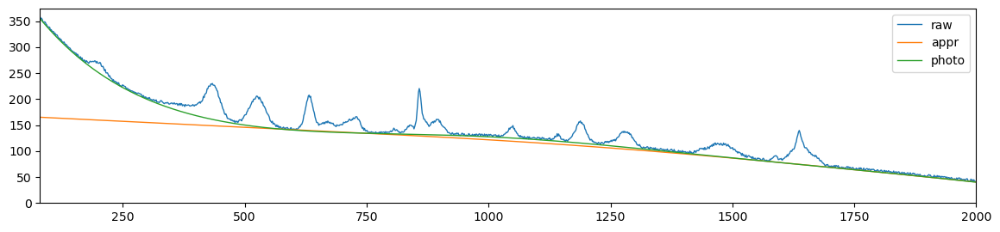

als_lambda: 126896.10031679235,	 als_p_weight: 4.893900918477499e-05,	 error: 1314.6557344609027, 	 smoothness: 0.5435138013086073, 	 smoothness: -0.558850651918909


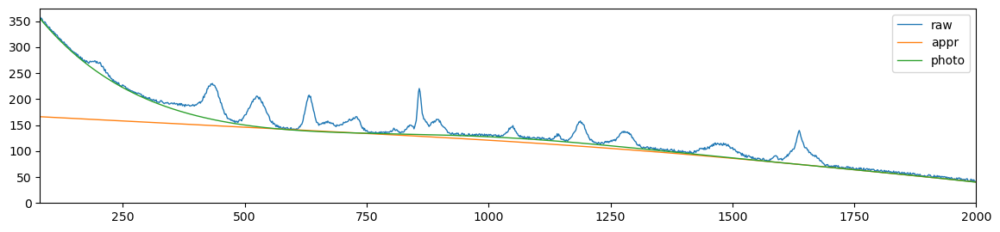

als_lambda: 126896.10031679235,	 als_p_weight: 3.5622478902624444e-05,	 error: 1421.4758220559993, 	 smoothness: 0.5406427955089503, 	 smoothness: -0.5606047481184381


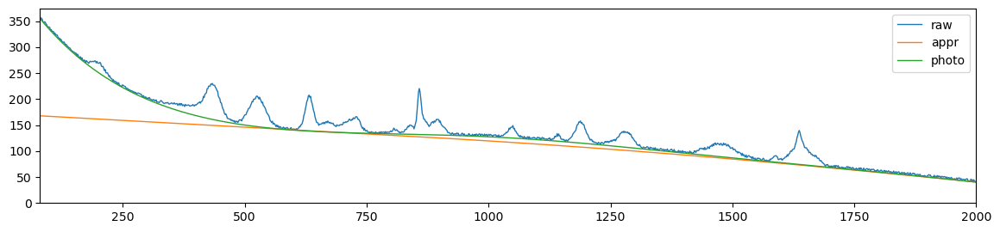

als_lambda: 126896.10031679235,	 als_p_weight: 2.592943797404667e-05,	 error: 1576.6715691734635, 	 smoothness: 0.536851898544815, 	 smoothness: -0.5619676941095387


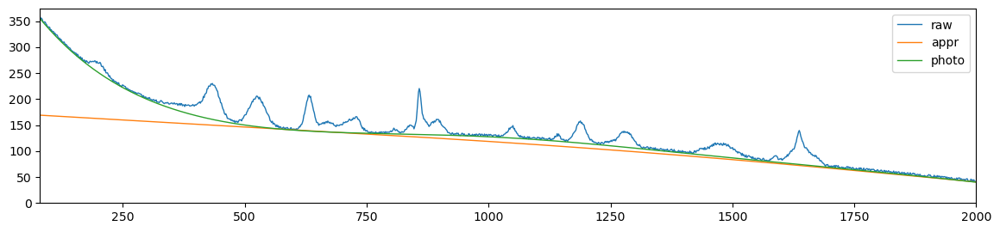

als_lambda: 126896.10031679235,	 als_p_weight: 1.8873918221350995e-05,	 error: 1708.4175425675662, 	 smoothness: 0.5337966351096523, 	 smoothness: -0.562374136348517


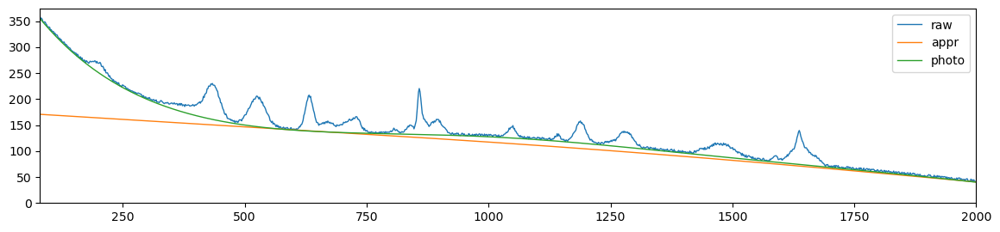

als_lambda: 126896.10031679235,	 als_p_weight: 1.3738237958832637e-05,	 error: 1837.745760496484, 	 smoothness: 0.5311075583727294, 	 smoothness: -0.5627636379577426


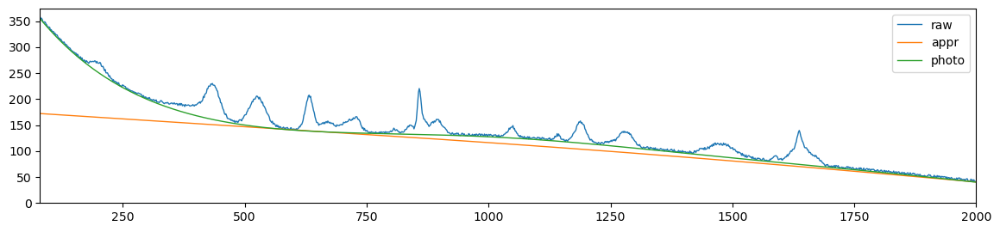

als_lambda: 126896.10031679235,	 als_p_weight: 1e-05,	 error: 1918.3739283229634, 	 smoothness: 0.5299425855938577, 	 smoothness: -0.562976028537488


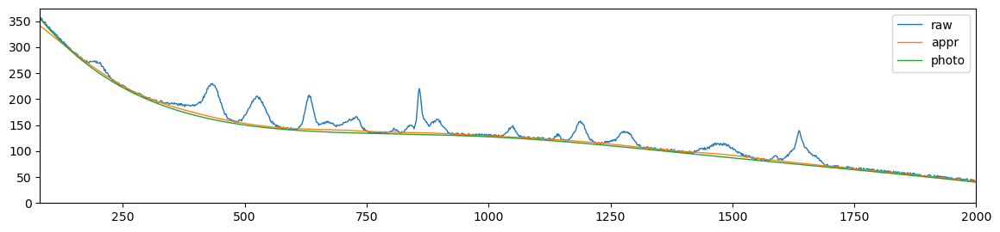

als_lambda: 221221.629107045,	 als_p_weight: 0.1,	 error: 314.2938919284588, 	 smoothness: 0.4097214359875349, 	 smoothness: -0.5033238812187745


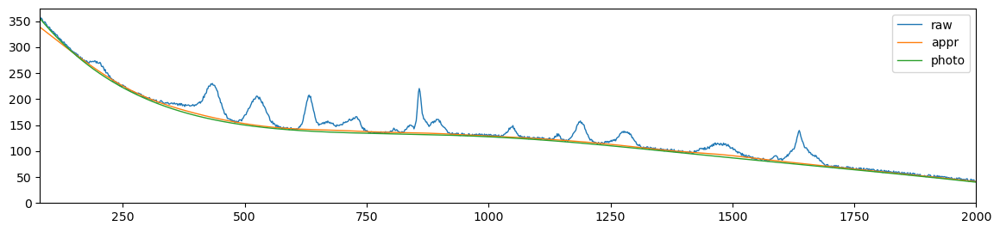

als_lambda: 221221.629107045,	 als_p_weight: 0.0727895384398315,	 error: 331.411407162663, 	 smoothness: 0.41846511732710817, 	 smoothness: -0.5084193006884393


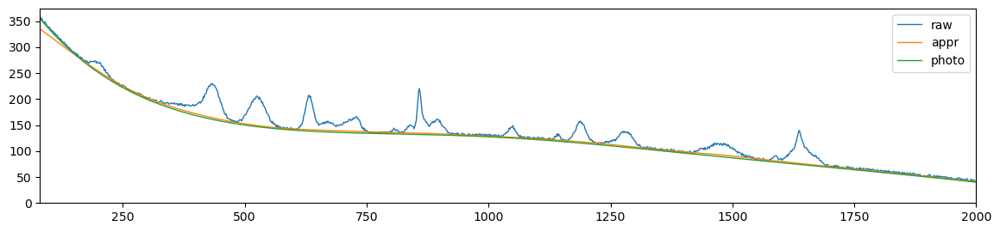

als_lambda: 221221.629107045,	 als_p_weight: 0.05298316906283707,	 error: 352.187305455821, 	 smoothness: 0.4276475080286031, 	 smoothness: -0.5133380766224765


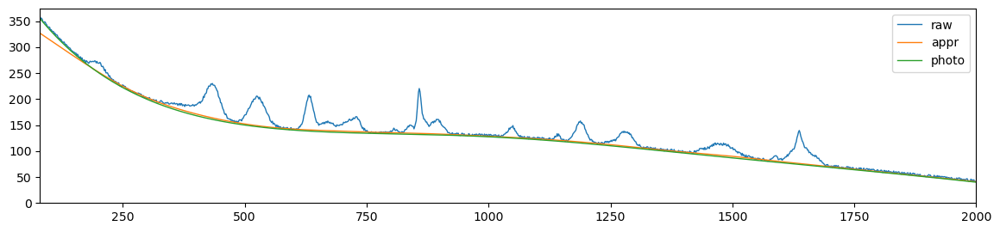

als_lambda: 221221.629107045,	 als_p_weight: 0.03856620421163472,	 error: 376.0096518395279, 	 smoothness: 0.43691233254632555, 	 smoothness: -0.5178679144662761


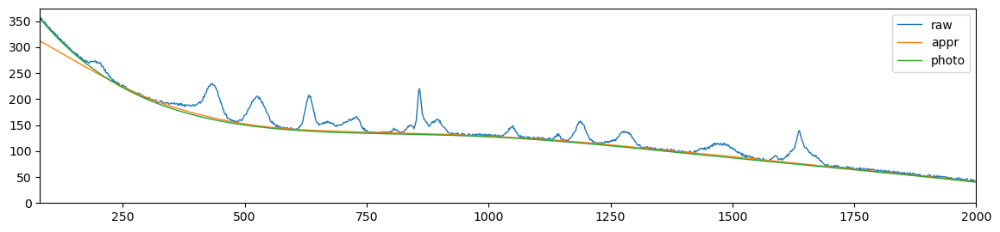

als_lambda: 221221.629107045,	 als_p_weight: 0.02807216203941177,	 error: 401.6824589993301, 	 smoothness: 0.44580178276703913, 	 smoothness: -0.5215715900722119


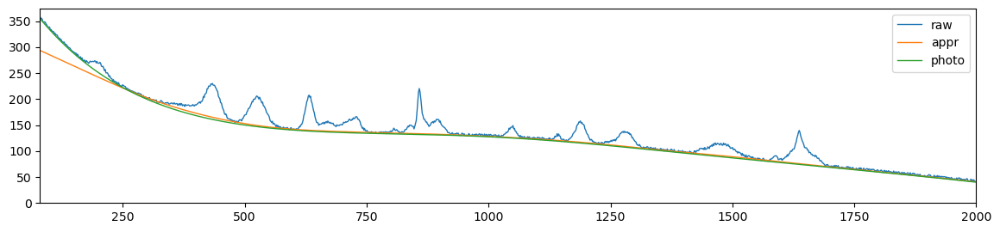

als_lambda: 221221.629107045,	 als_p_weight: 0.020433597178569417,	 error: 430.1142406188059, 	 smoothness: 0.4546926961578838, 	 smoothness: -0.5251386987768304


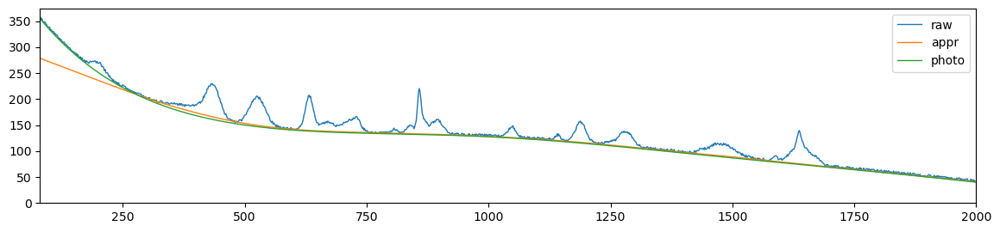

als_lambda: 221221.629107045,	 als_p_weight: 0.014873521072935119,	 error: 462.7930327236434, 	 smoothness: 0.46369304647895093, 	 smoothness: -0.5287514647891499


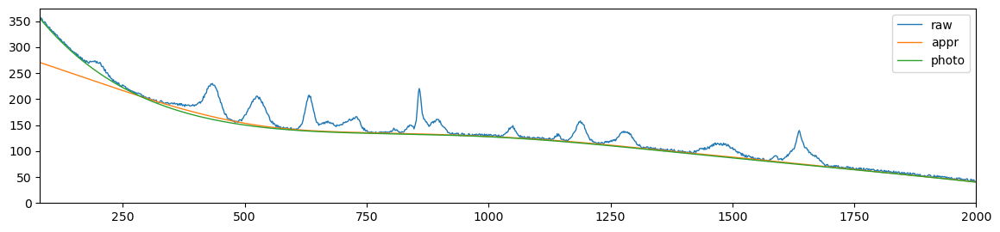

als_lambda: 221221.629107045,	 als_p_weight: 0.010826367338740546,	 error: 500.09990626952487, 	 smoothness: 0.47254698461222694, 	 smoothness: -0.5320331345260783


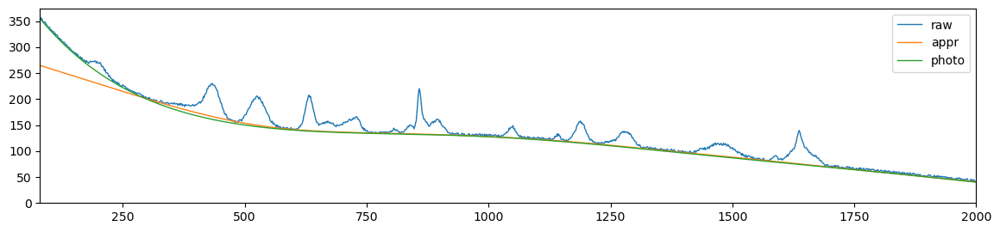

als_lambda: 221221.629107045,	 als_p_weight: 0.007880462815669913,	 error: 541.3898151290564, 	 smoothness: 0.48110595734800204, 	 smoothness: -0.5349897918007963


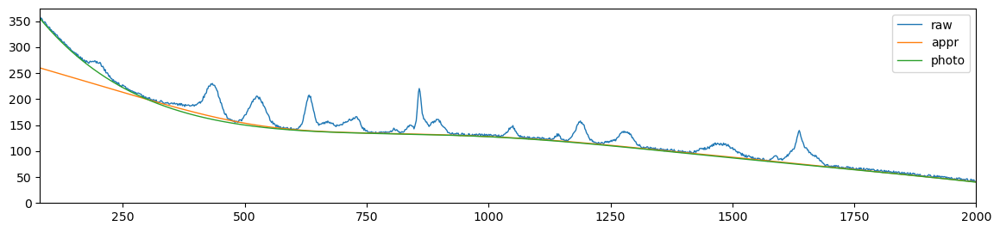

als_lambda: 221221.629107045,	 als_p_weight: 0.005736152510448681,	 error: 581.771635127669, 	 smoothness: 0.48880536842793004, 	 smoothness: -0.5373748278784832


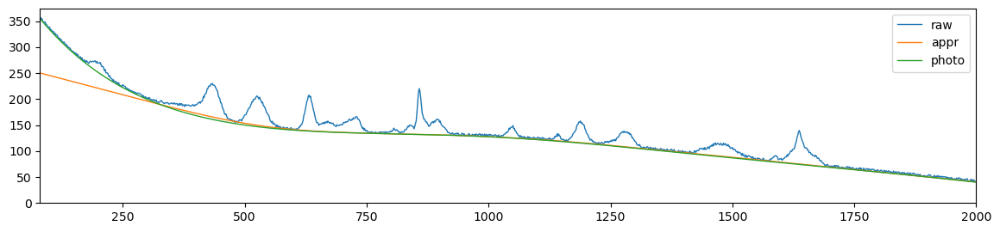

als_lambda: 221221.629107045,	 als_p_weight: 0.0041753189365604,	 error: 626.2535271128187, 	 smoothness: 0.49620662180252745, 	 smoothness: -0.539702233073398


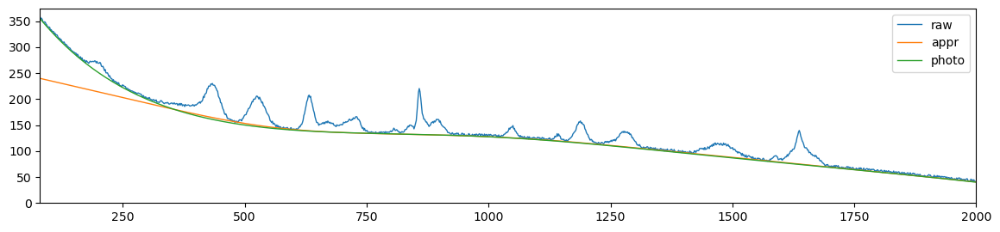

als_lambda: 221221.629107045,	 als_p_weight: 0.0030391953823131978,	 error: 681.292518575094, 	 smoothness: 0.5039786239528177, 	 smoothness: -0.5422362703476833


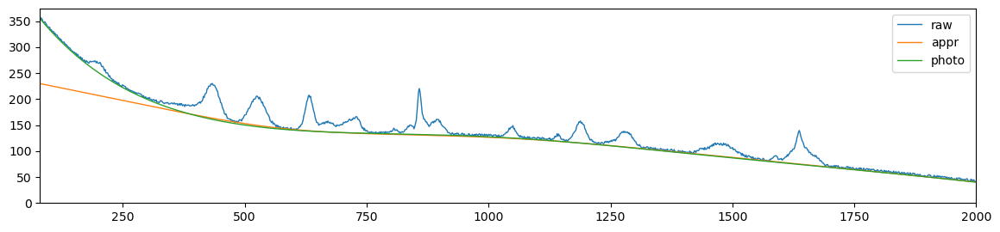

als_lambda: 221221.629107045,	 als_p_weight: 0.00221221629107045,	 error: 739.9702433422633, 	 smoothness: 0.5112896400293672, 	 smoothness: -0.544595470782171


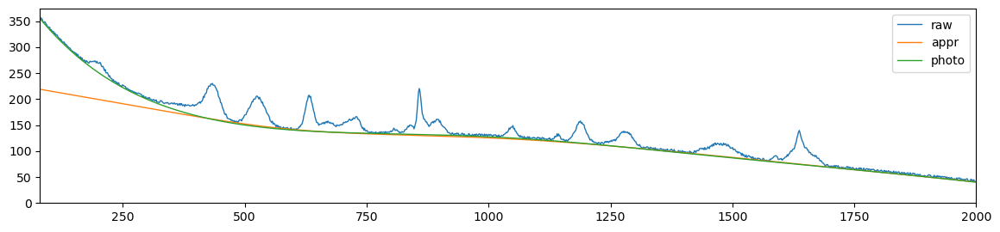

als_lambda: 221221.629107045,	 als_p_weight: 0.0016102620275609393,	 error: 804.581156327582, 	 smoothness: 0.5184205062591939, 	 smoothness: -0.5463717991919597


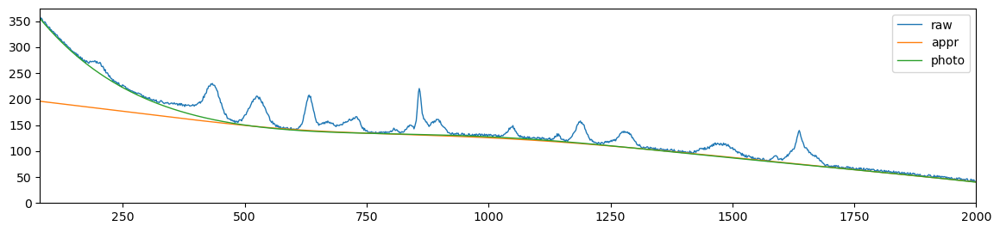

als_lambda: 221221.629107045,	 als_p_weight: 0.0011721022975334804,	 error: 879.5815228188762, 	 smoothness: 0.5253571916148996, 	 smoothness: -0.5479100016042796


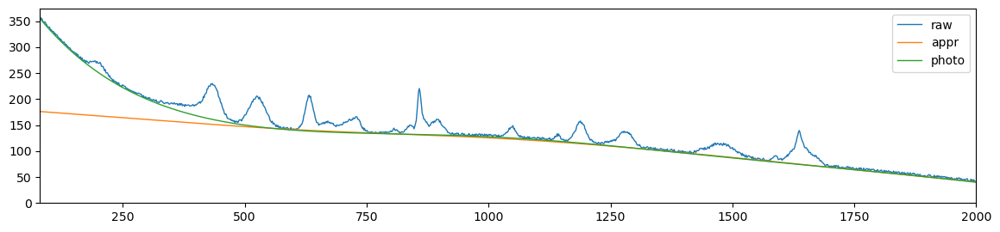

als_lambda: 221221.629107045,	 als_p_weight: 0.0008531678524172806,	 error: 945.5015569298017, 	 smoothness: 0.5313066846706407, 	 smoothness: -0.549056673479949


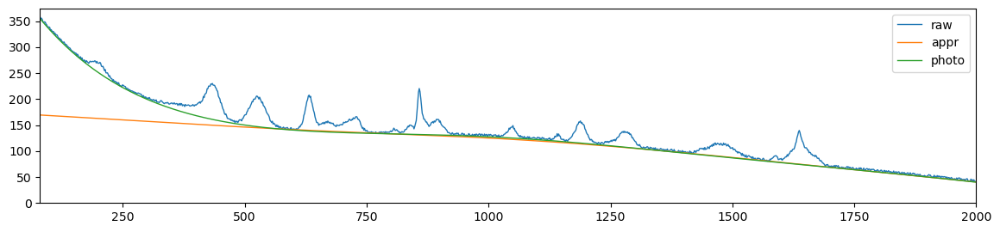

als_lambda: 221221.629107045,	 als_p_weight: 0.0006210169418915617,	 error: 997.3384564995109, 	 smoothness: 0.5359409553349528, 	 smoothness: -0.5498580855888593


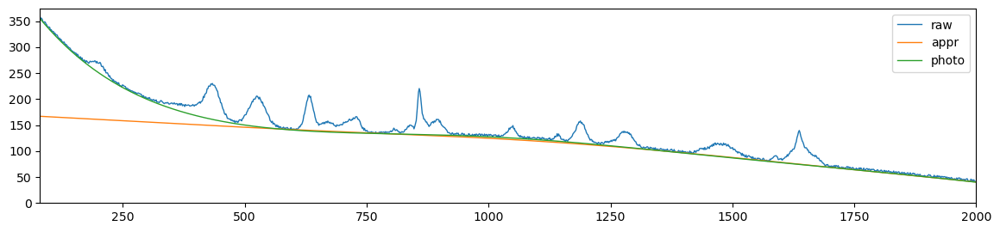

als_lambda: 221221.629107045,	 als_p_weight: 0.00045203536563602454,	 error: 1047.3339597834001, 	 smoothness: 0.5400064122185816, 	 smoothness: -0.5508305668775524


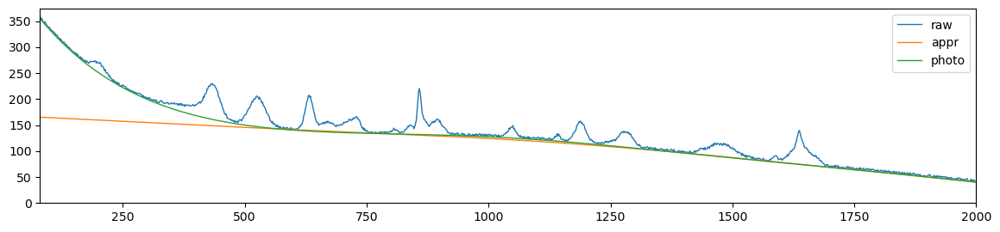

als_lambda: 221221.629107045,	 als_p_weight: 0.00032903445623126676,	 error: 1092.6690797017277, 	 smoothness: 0.5433219009728534, 	 smoothness: -0.5520854142628315


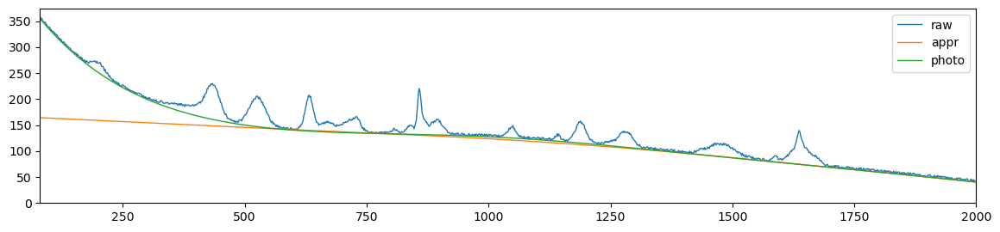

als_lambda: 221221.629107045,	 als_p_weight: 0.0002395026619987486,	 error: 1137.143605384463, 	 smoothness: 0.5455143488263511, 	 smoothness: -0.5536064347330472


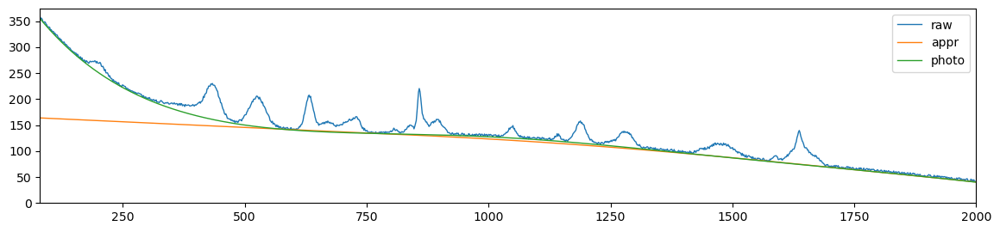

als_lambda: 221221.629107045,	 als_p_weight: 0.00017433288221999874,	 error: 1181.0921190156937, 	 smoothness: 0.5457913152439472, 	 smoothness: -0.5551195137836803


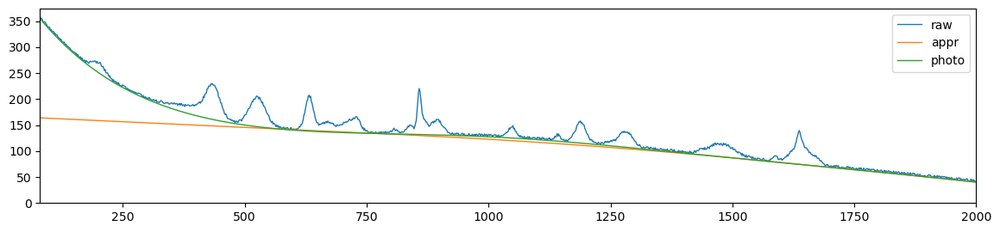

als_lambda: 221221.629107045,	 als_p_weight: 0.0001268961003167922,	 error: 1227.770765619358, 	 smoothness: 0.5451176730563956, 	 smoothness: -0.5566794488284126


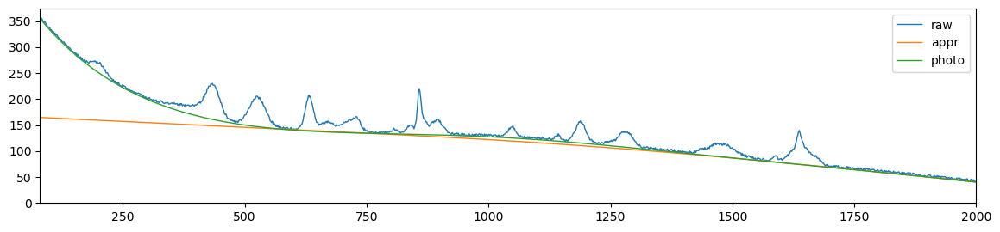

als_lambda: 221221.629107045,	 als_p_weight: 9.236708571873866e-05,	 error: 1290.5639889626718, 	 smoothness: 0.5436423413152525, 	 smoothness: -0.5584207003488801


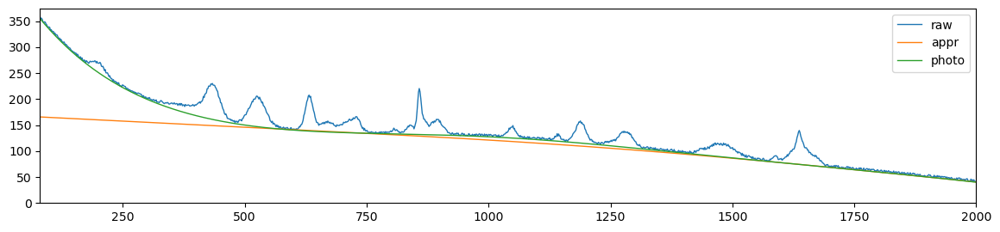

als_lambda: 221221.629107045,	 als_p_weight: 6.723357536499335e-05,	 error: 1392.2566975667987, 	 smoothness: 0.5411641733228268, 	 smoothness: -0.560187447387353


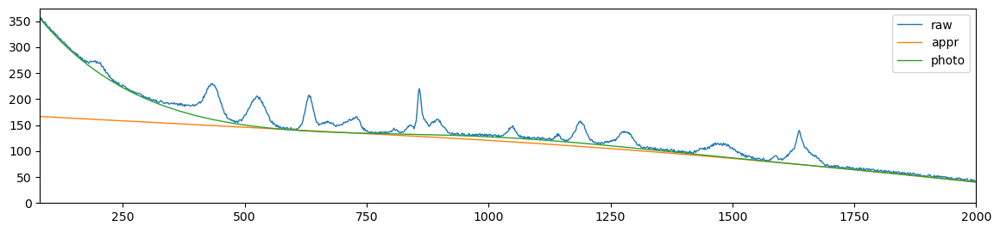

als_lambda: 221221.629107045,	 als_p_weight: 4.893900918477499e-05,	 error: 1542.6529976810862, 	 smoothness: 0.5372794516453543, 	 smoothness: -0.5617376719687587


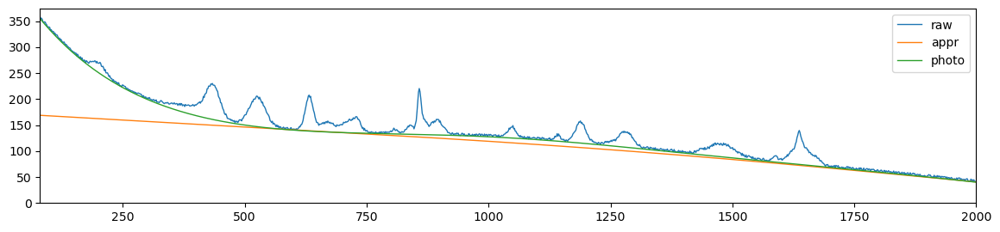

als_lambda: 221221.629107045,	 als_p_weight: 3.5622478902624444e-05,	 error: 1695.9684033244184, 	 smoothness: 0.5341767571824055, 	 smoothness: -0.562579712437292


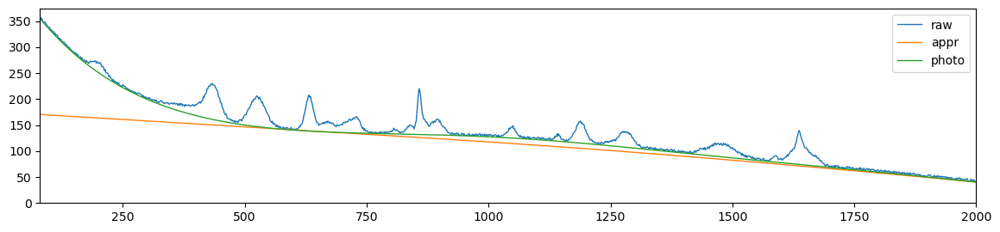

als_lambda: 221221.629107045,	 als_p_weight: 2.592943797404667e-05,	 error: 1837.3868870419908, 	 smoothness: 0.5316941955322994, 	 smoothness: -0.56313905910485


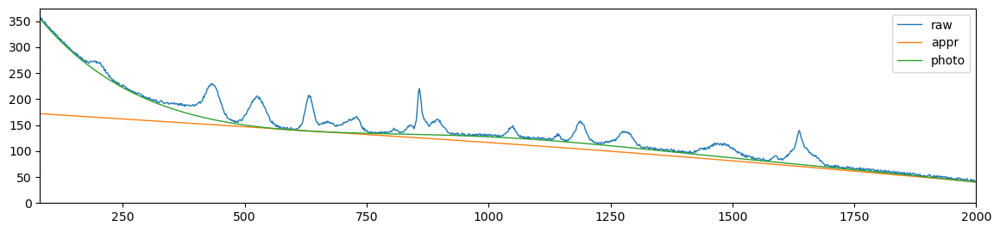

als_lambda: 221221.629107045,	 als_p_weight: 1.8873918221350995e-05,	 error: 1947.7865409631993, 	 smoothness: 0.5293165014164384, 	 smoothness: -0.5633228255836027


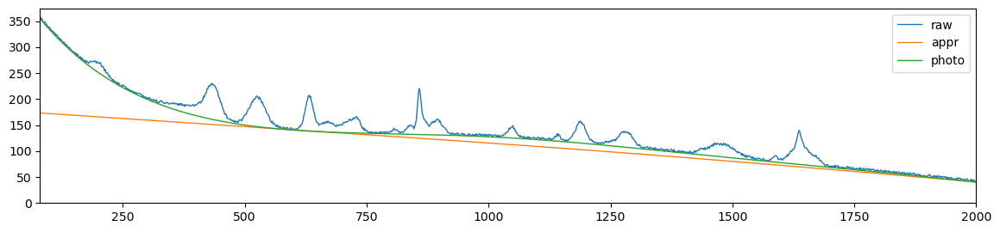

als_lambda: 221221.629107045,	 als_p_weight: 1.3738237958832637e-05,	 error: 2006.3257204512108, 	 smoothness: 0.5278813472028074, 	 smoothness: -0.5631855908564272


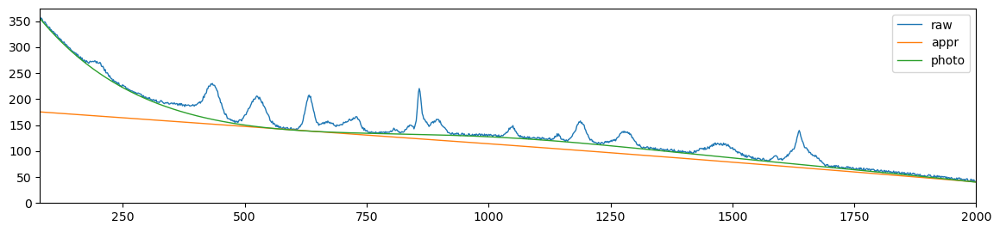

als_lambda: 221221.629107045,	 als_p_weight: 1e-05,	 error: 2073.073807992572, 	 smoothness: 0.5262547816380636, 	 smoothness: -0.5633949995419101


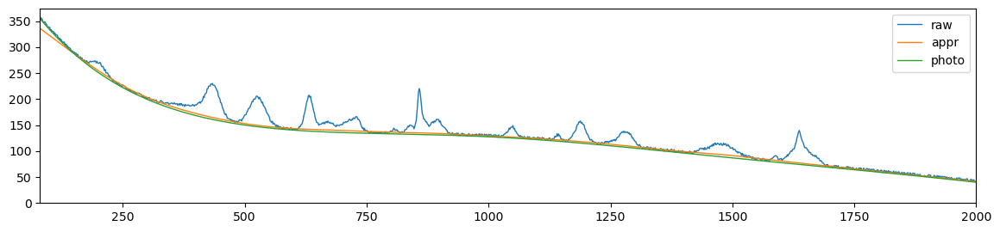

als_lambda: 385662.04211634723,	 als_p_weight: 0.1,	 error: 349.65633708708634, 	 smoothness: 0.4265581806532226, 	 smoothness: -0.512480005331738


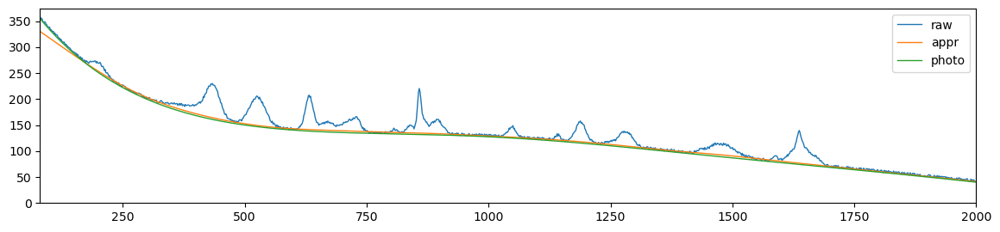

als_lambda: 385662.04211634723,	 als_p_weight: 0.0727895384398315,	 error: 371.2278081805335, 	 smoothness: 0.4355021745820924, 	 smoothness: -0.5169865272462669


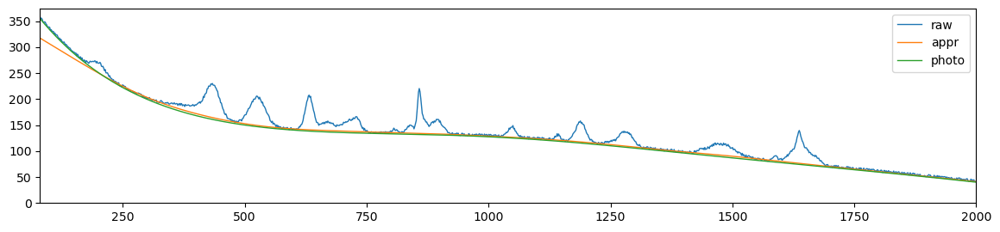

als_lambda: 385662.04211634723,	 als_p_weight: 0.05298316906283707,	 error: 395.3340354447911, 	 smoothness: 0.4442544134433607, 	 smoothness: -0.5207862768411873


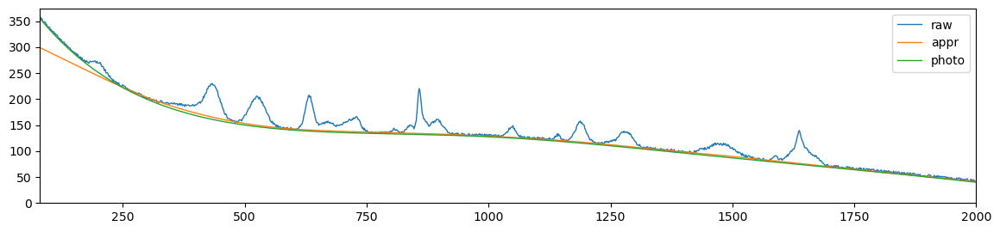

als_lambda: 385662.04211634723,	 als_p_weight: 0.03856620421163472,	 error: 421.94178200097826, 	 smoothness: 0.4529178056121099, 	 smoothness: -0.5243308604740293


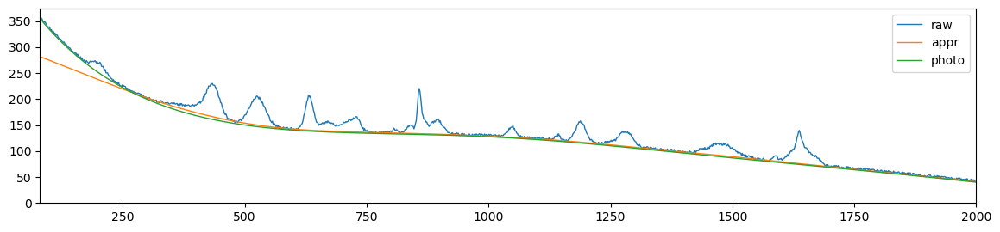

als_lambda: 385662.04211634723,	 als_p_weight: 0.02807216203941177,	 error: 452.6121284824153, 	 smoothness: 0.46173221563624217, 	 smoothness: -0.5278946540331686


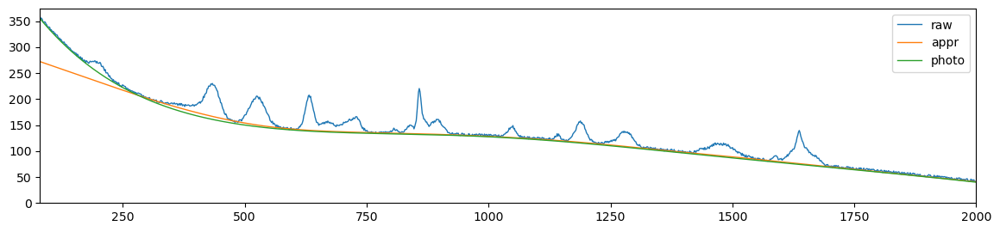

als_lambda: 385662.04211634723,	 als_p_weight: 0.020433597178569417,	 error: 489.08238825775845, 	 smoothness: 0.47067727812344917, 	 smoothness: -0.5313846251781507


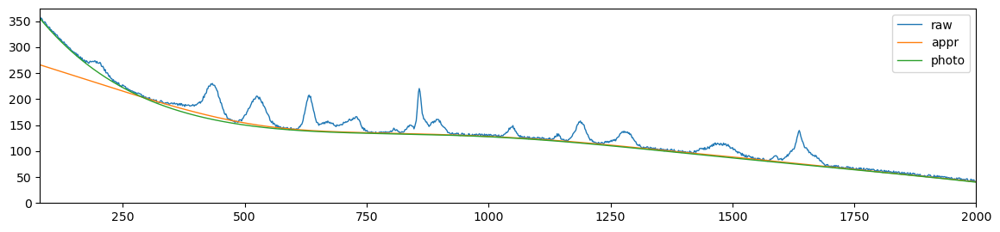

als_lambda: 385662.04211634723,	 als_p_weight: 0.014873521072935119,	 error: 528.8750672487892, 	 smoothness: 0.479253786870945, 	 smoothness: -0.5343889711971096


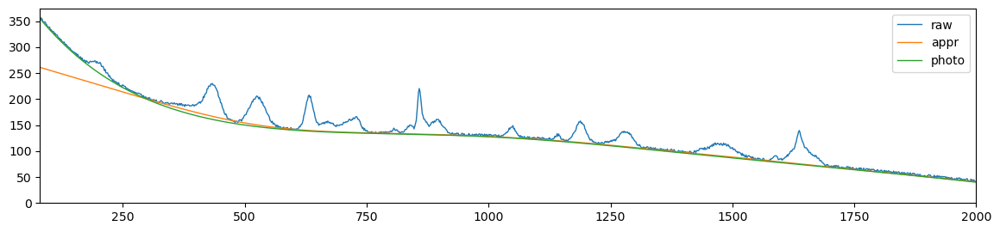

als_lambda: 385662.04211634723,	 als_p_weight: 0.010826367338740546,	 error: 569.921404426903, 	 smoothness: 0.4872177272500264, 	 smoothness: -0.5369509914122544


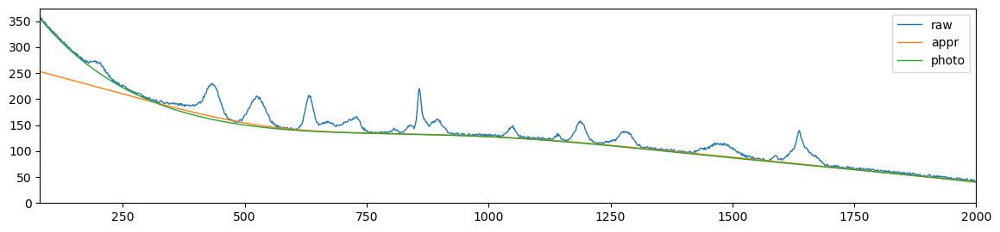

als_lambda: 385662.04211634723,	 als_p_weight: 0.007880462815669913,	 error: 612.6663974047639, 	 smoothness: 0.49461685265792066, 	 smoothness: -0.5392446523613106


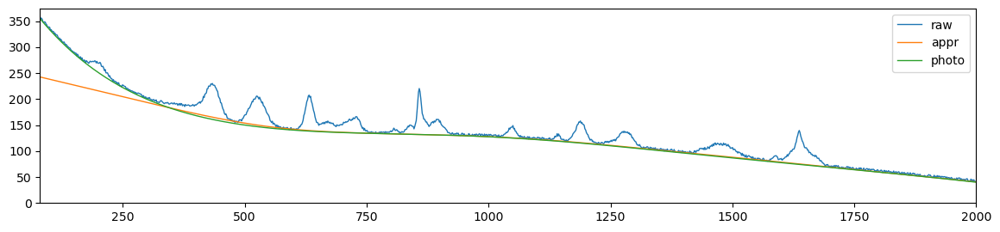

als_lambda: 385662.04211634723,	 als_p_weight: 0.005736152510448681,	 error: 665.3468983660282, 	 smoothness: 0.502283501302505, 	 smoothness: -0.5417972993738099


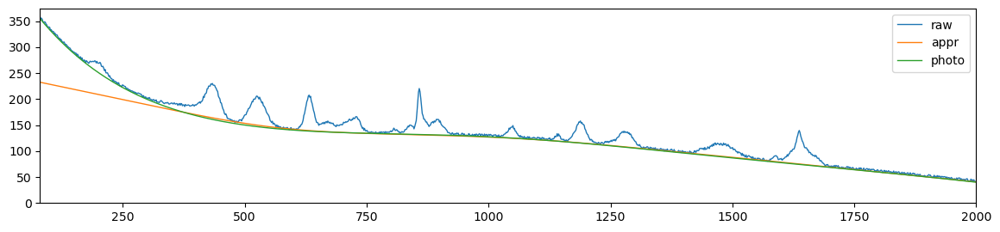

als_lambda: 385662.04211634723,	 als_p_weight: 0.0041753189365604,	 error: 718.6835161803984, 	 smoothness: 0.5094441122377757, 	 smoothness: -0.5439428746923263


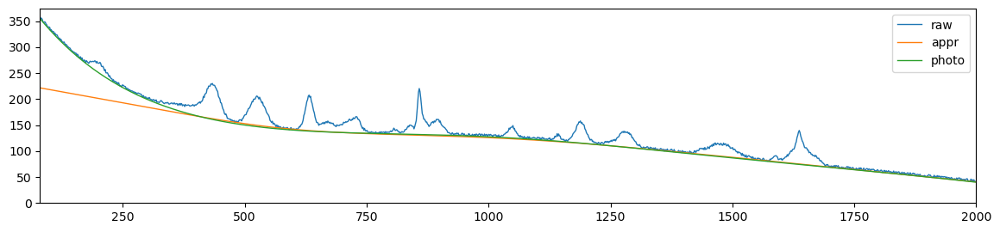

als_lambda: 385662.04211634723,	 als_p_weight: 0.0030391953823131978,	 error: 785.5424717284887, 	 smoothness: 0.5168360572866836, 	 smoothness: -0.5460554038079124


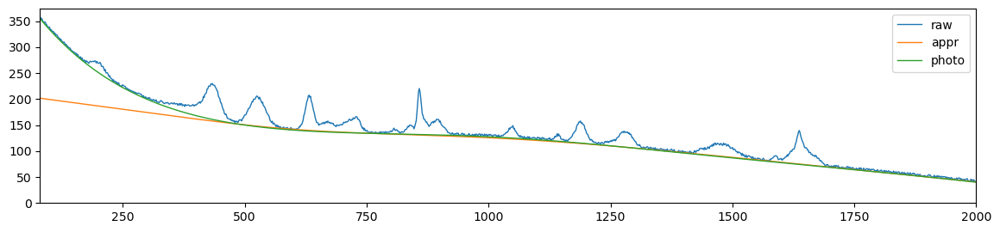

als_lambda: 385662.04211634723,	 als_p_weight: 0.00221221629107045,	 error: 859.4232801571067, 	 smoothness: 0.5238274820455873, 	 smoothness: -0.5476327307590229


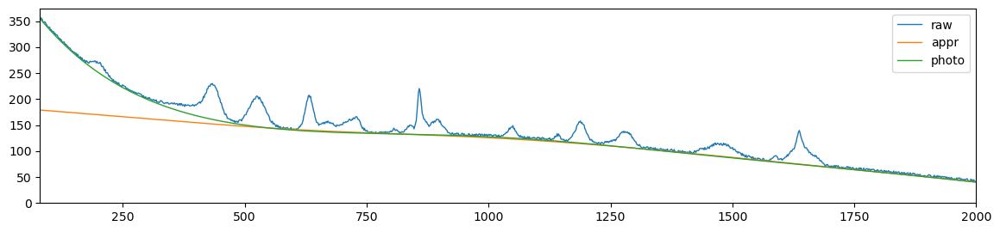

als_lambda: 385662.04211634723,	 als_p_weight: 0.0016102620275609393,	 error: 927.0779903064736, 	 smoothness: 0.5300479306919795, 	 smoothness: -0.5488980137799985


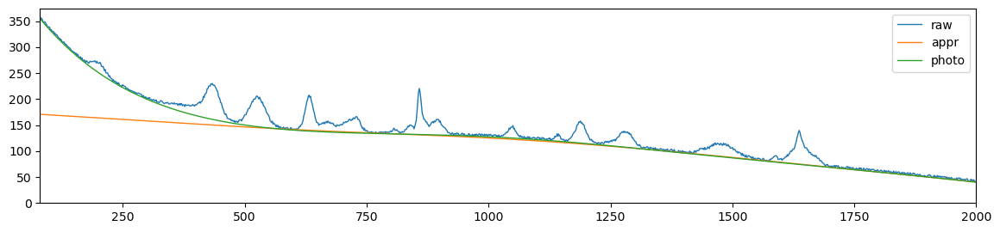

als_lambda: 385662.04211634723,	 als_p_weight: 0.0011721022975334804,	 error: 981.6812789100956, 	 smoothness: 0.5349324431262911, 	 smoothness: -0.5497655921541509


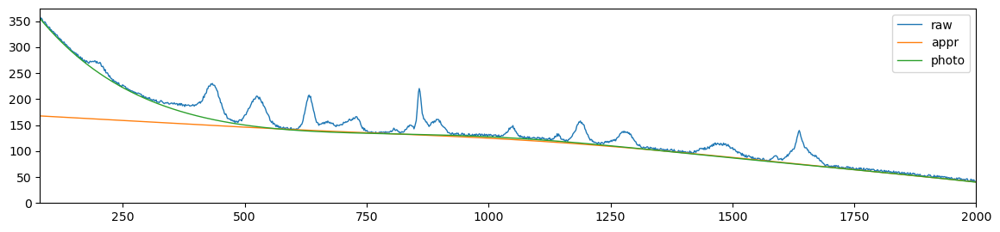

als_lambda: 385662.04211634723,	 als_p_weight: 0.0008531678524172806,	 error: 1030.402101423364, 	 smoothness: 0.5390554436170182, 	 smoothness: -0.5506569197231387


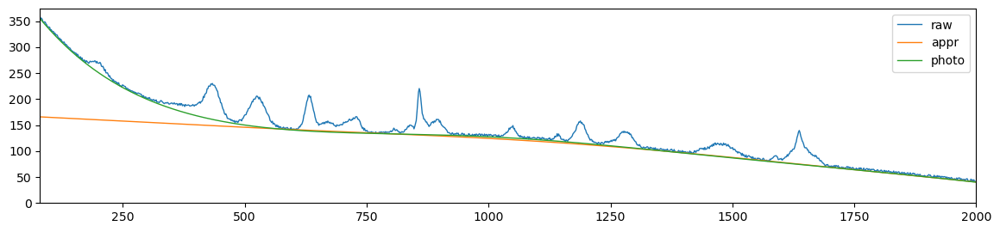

als_lambda: 385662.04211634723,	 als_p_weight: 0.0006210169418915617,	 error: 1079.867057815417, 	 smoothness: 0.5425961038435055, 	 smoothness: -0.5518702943393088


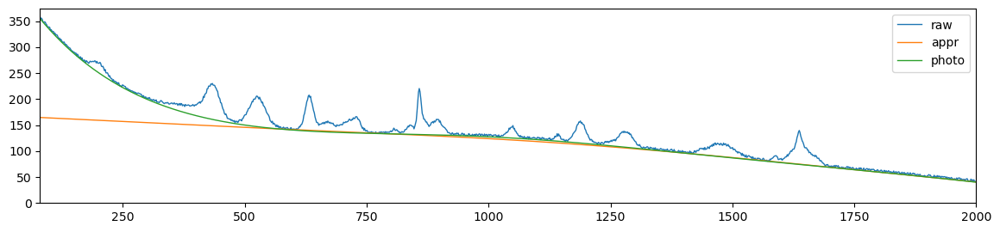

als_lambda: 385662.04211634723,	 als_p_weight: 0.00045203536563602454,	 error: 1123.8166650429391, 	 smoothness: 0.5451008636899475, 	 smoothness: -0.5532651343670478


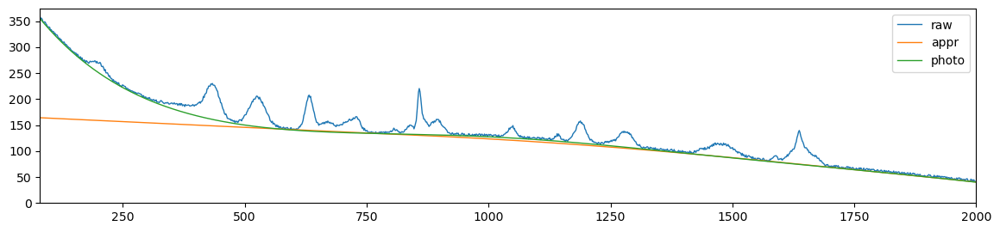

als_lambda: 385662.04211634723,	 als_p_weight: 0.00032903445623126676,	 error: 1161.9783324794394, 	 smoothness: 0.5457125357542179, 	 smoothness: -0.5548459523260244


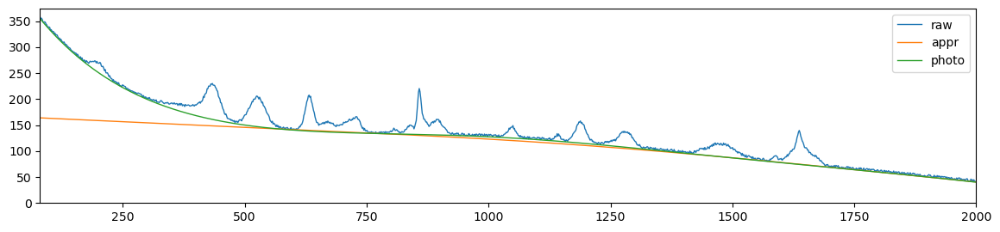

als_lambda: 385662.04211634723,	 als_p_weight: 0.0002395026619987486,	 error: 1209.374545037177, 	 smoothness: 0.5453510498091694, 	 smoothness: -0.5562926652521655


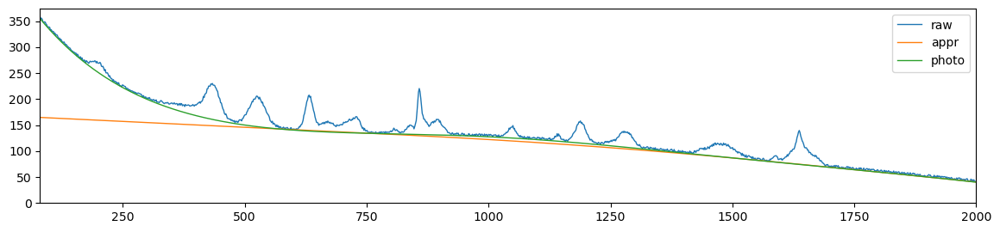

als_lambda: 385662.04211634723,	 als_p_weight: 0.00017433288221999874,	 error: 1266.4049130171704, 	 smoothness: 0.5440796075266797, 	 smoothness: -0.5580547260030121


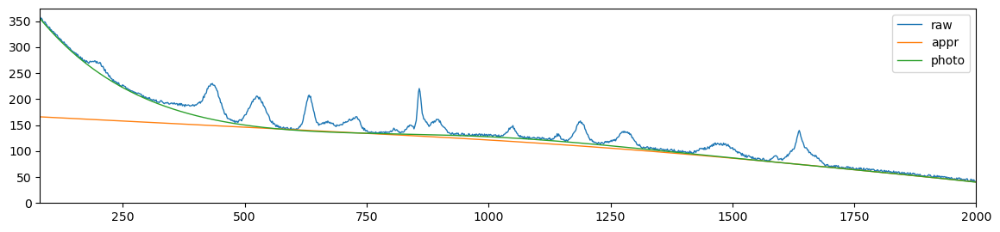

als_lambda: 385662.04211634723,	 als_p_weight: 0.0001268961003167922,	 error: 1364.4381565265098, 	 smoothness: 0.5419712716673726, 	 smoothness: -0.5599511478408185


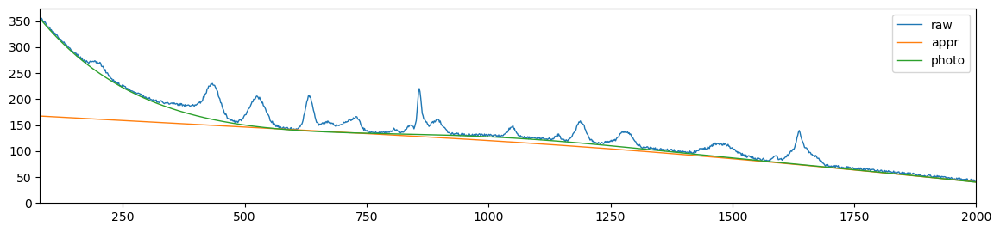

als_lambda: 385662.04211634723,	 als_p_weight: 9.236708571873866e-05,	 error: 1528.2078459331249, 	 smoothness: 0.5379147281382423, 	 smoothness: -0.5616573166821727


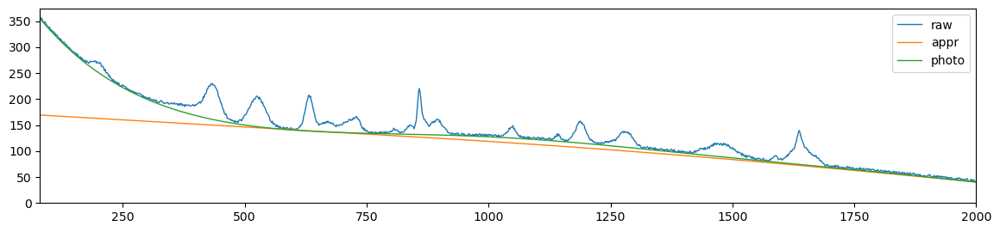

als_lambda: 385662.04211634723,	 als_p_weight: 6.723357536499335e-05,	 error: 1714.4363608280553, 	 smoothness: 0.5337717343093166, 	 smoothness: -0.5627558489326221


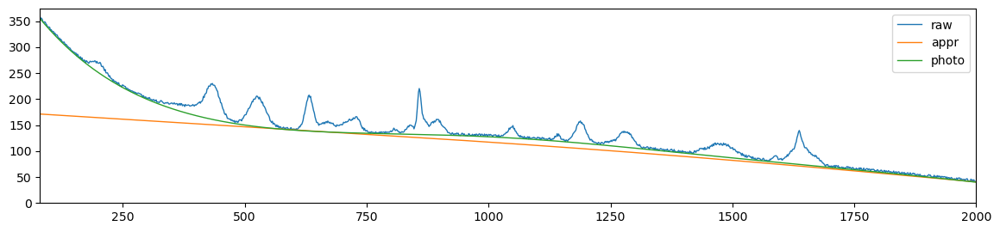

als_lambda: 385662.04211634723,	 als_p_weight: 4.893900918477499e-05,	 error: 1882.8847649501206, 	 smoothness: 0.53050863970083, 	 smoothness: -0.5633005663112898


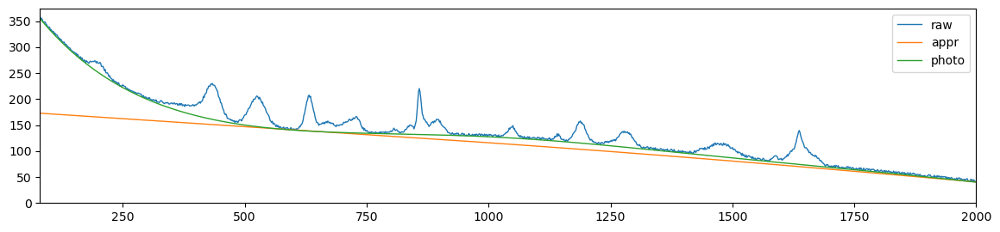

als_lambda: 385662.04211634723,	 als_p_weight: 3.5622478902624444e-05,	 error: 2006.7692370172037, 	 smoothness: 0.52816562496997, 	 smoothness: -0.5634874333551646


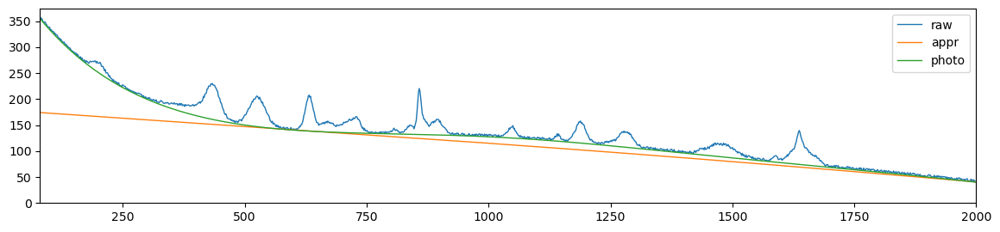

als_lambda: 385662.04211634723,	 als_p_weight: 2.592943797404667e-05,	 error: 2096.765897945684, 	 smoothness: 0.5266989319431569, 	 smoothness: -0.5636011289861721


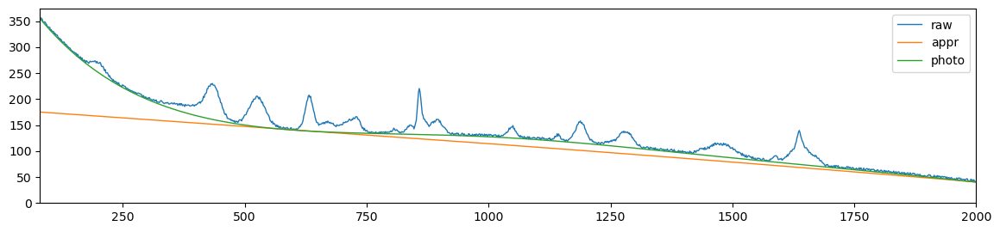

als_lambda: 385662.04211634723,	 als_p_weight: 1.8873918221350995e-05,	 error: 2148.326928536685, 	 smoothness: 0.5245286972241346, 	 smoothness: -0.5633371701360639


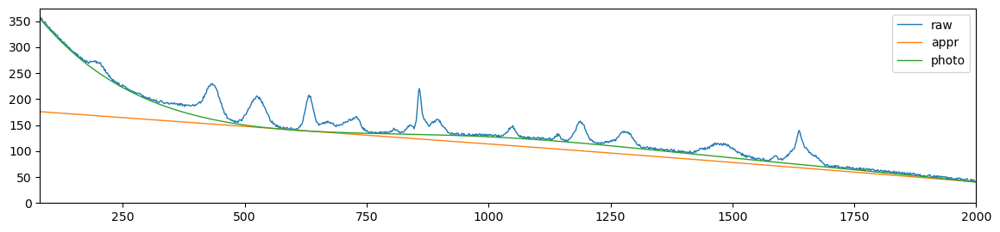

als_lambda: 385662.04211634723,	 als_p_weight: 1.3738237958832637e-05,	 error: 2187.3804347066034, 	 smoothness: 0.5242840919025457, 	 smoothness: -0.5634760857460706


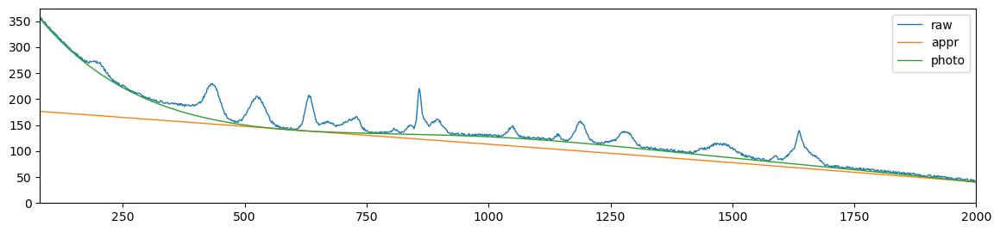

als_lambda: 385662.04211634723,	 als_p_weight: 1e-05,	 error: 2225.916357961584, 	 smoothness: 0.5239014885058446, 	 smoothness: -0.5635231081480321


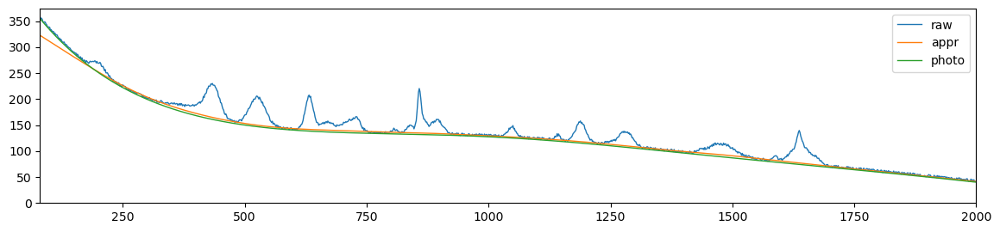

als_lambda: 672335.7536499335,	 als_p_weight: 0.1,	 error: 390.29986977050567, 	 smoothness: 0.4429245340174275, 	 smoothness: -0.5199817275627973


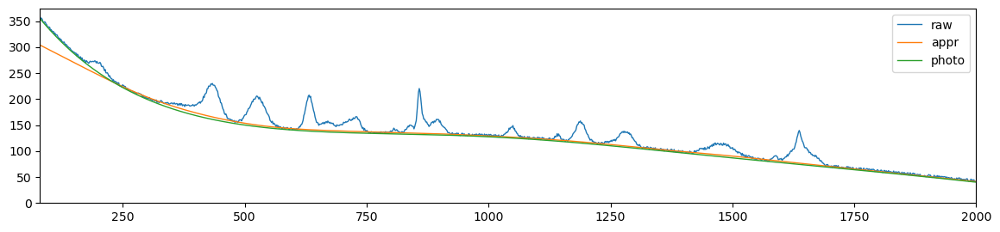

als_lambda: 672335.7536499335,	 als_p_weight: 0.0727895384398315,	 error: 415.09812236855504, 	 smoothness: 0.45140759210226283, 	 smoothness: -0.5235757705530325


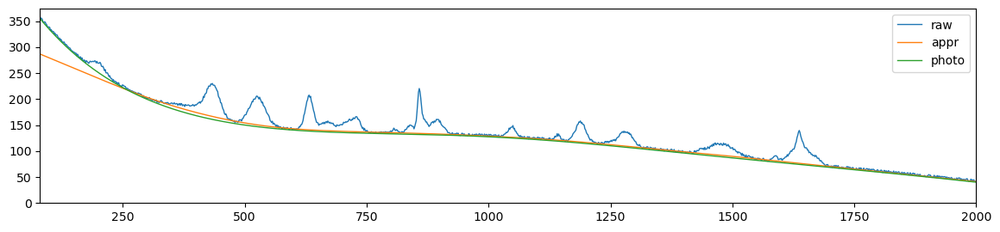

als_lambda: 672335.7536499335,	 als_p_weight: 0.05298316906283707,	 error: 443.2397035304057, 	 smoothness: 0.4599278149365126, 	 smoothness: -0.5270444854675174


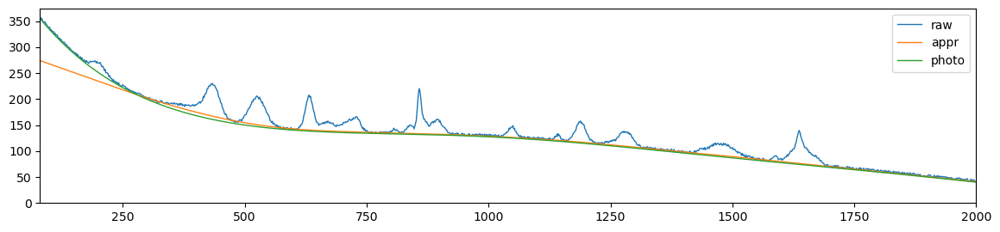

als_lambda: 672335.7536499335,	 als_p_weight: 0.03856620421163472,	 error: 478.362650501684, 	 smoothness: 0.4688712372678205, 	 smoothness: -0.5307010470670619


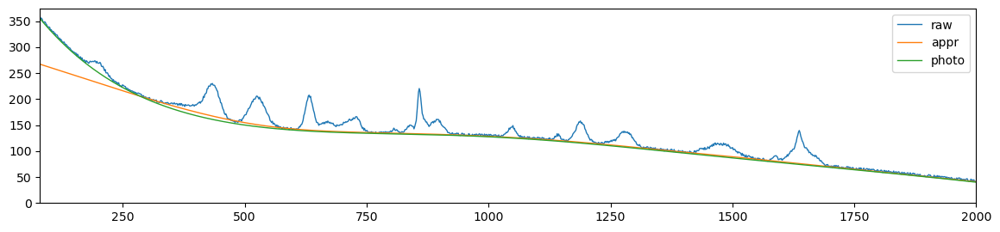

als_lambda: 672335.7536499335,	 als_p_weight: 0.02807216203941177,	 error: 516.2574553537041, 	 smoothness: 0.4774144320477064, 	 smoothness: -0.5337387098590323


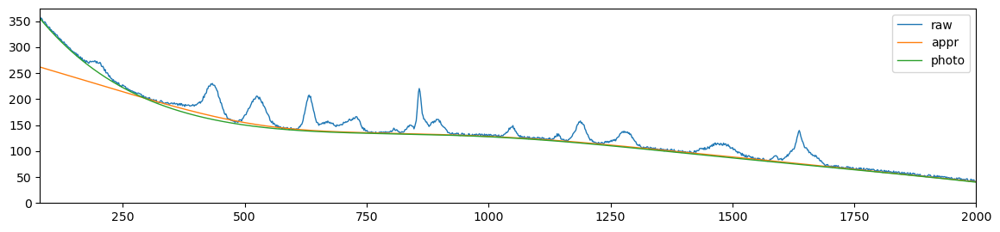

als_lambda: 672335.7536499335,	 als_p_weight: 0.020433597178569417,	 error: 557.8832372647983, 	 smoothness: 0.4856249070110733, 	 smoothness: -0.5365067883095606


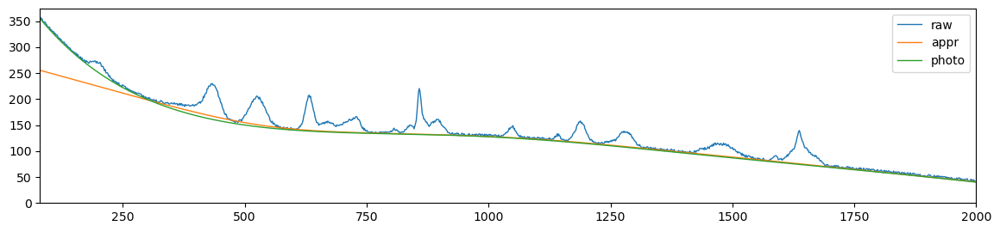

als_lambda: 672335.7536499335,	 als_p_weight: 0.014873521072935119,	 error: 599.3556365191622, 	 smoothness: 0.49308606699114593, 	 smoothness: -0.5388001253931047


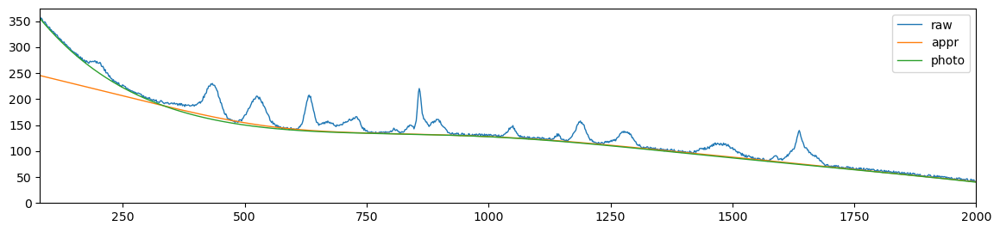

als_lambda: 672335.7536499335,	 als_p_weight: 0.010826367338740546,	 error: 649.1548682572667, 	 smoothness: 0.5006269237907475, 	 smoothness: -0.5413475735642668


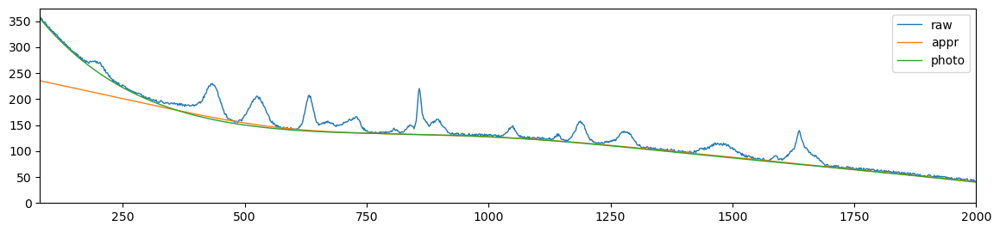

als_lambda: 672335.7536499335,	 als_p_weight: 0.007880462815669913,	 error: 701.3060949252063, 	 smoothness: 0.507839001673473, 	 smoothness: -0.5434461680493797


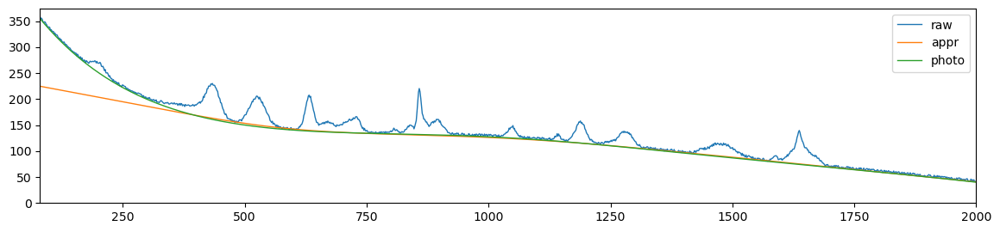

als_lambda: 672335.7536499335,	 als_p_weight: 0.005736152510448681,	 error: 764.7799405990222, 	 smoothness: 0.5151426608856294, 	 smoothness: -0.545693728864988


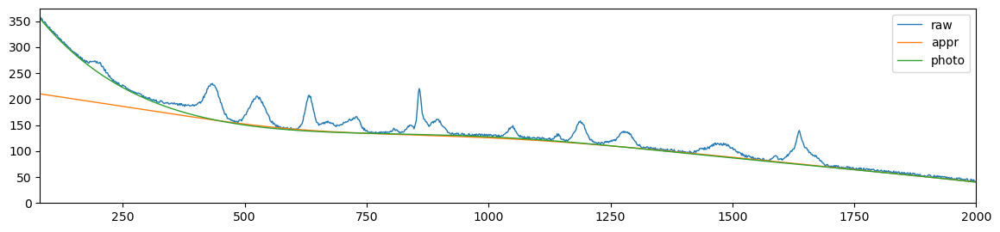

als_lambda: 672335.7536499335,	 als_p_weight: 0.0041753189365604,	 error: 838.8920458151838, 	 smoothness: 0.522320655336708, 	 smoothness: -0.547367586737805


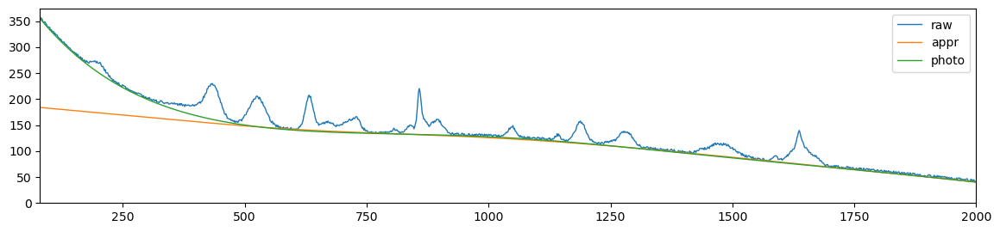

als_lambda: 672335.7536499335,	 als_p_weight: 0.0030391953823131978,	 error: 906.8295730813385, 	 smoothness: 0.5286969663438552, 	 smoothness: -0.548711923044429


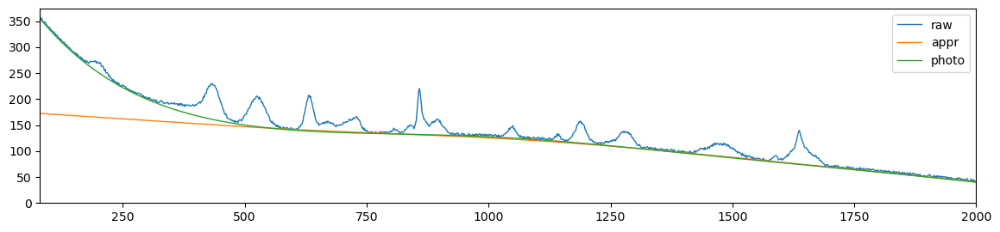

als_lambda: 672335.7536499335,	 als_p_weight: 0.00221221629107045,	 error: 965.637140331521, 	 smoothness: 0.533952796478635, 	 smoothness: -0.5496758385374162


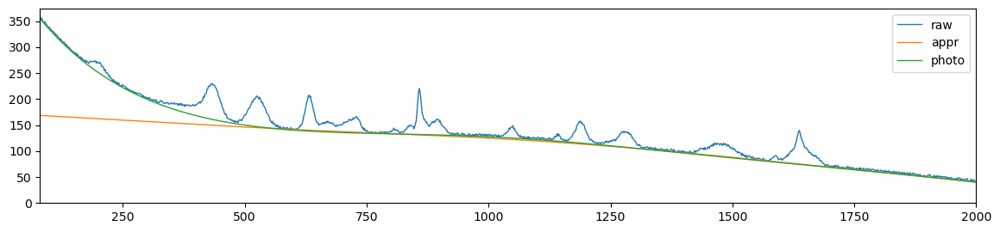

als_lambda: 672335.7536499335,	 als_p_weight: 0.0016102620275609393,	 error: 1013.9412735271237, 	 smoothness: 0.5381599025545267, 	 smoothness: -0.5505238603273961


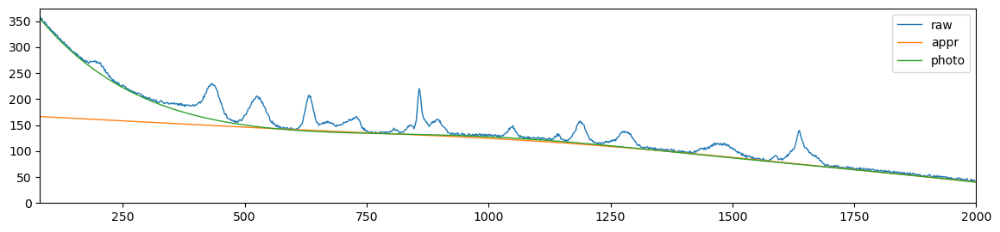

als_lambda: 672335.7536499335,	 als_p_weight: 0.0011721022975334804,	 error: 1061.7501379766677, 	 smoothness: 0.5418469672798876, 	 smoothness: -0.5516267936724946


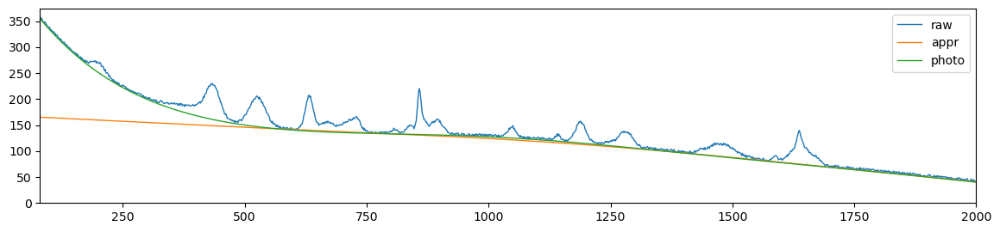

als_lambda: 672335.7536499335,	 als_p_weight: 0.0008531678524172806,	 error: 1109.3953082471648, 	 smoothness: 0.5446071500151313, 	 smoothness: -0.5530268729316192


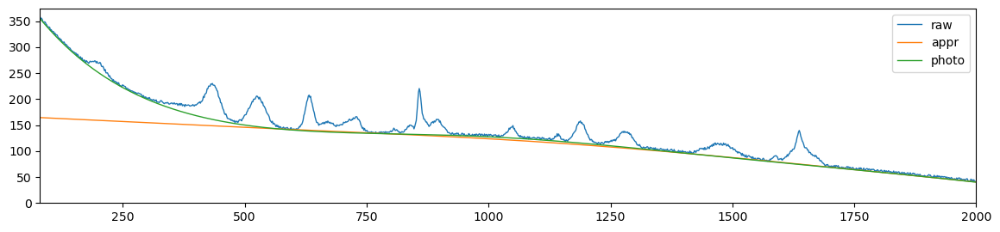

als_lambda: 672335.7536499335,	 als_p_weight: 0.0006210169418915617,	 error: 1145.016221153404, 	 smoothness: 0.5456500684202035, 	 smoothness: -0.5545748893110939


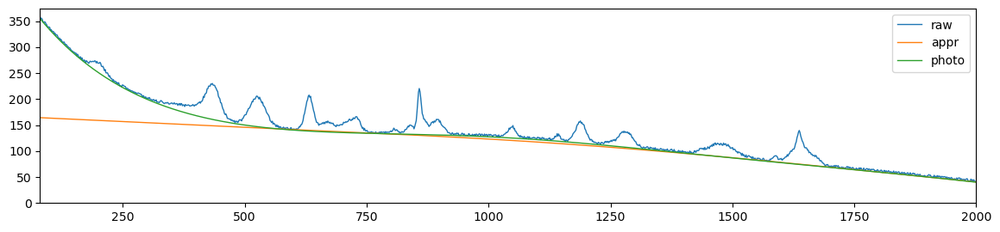

als_lambda: 672335.7536499335,	 als_p_weight: 0.00045203536563602454,	 error: 1192.8641638821052, 	 smoothness: 0.5454301084562104, 	 smoothness: -0.5559635331793102


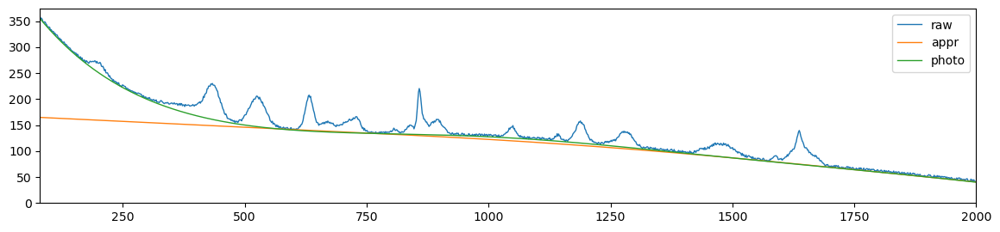

als_lambda: 672335.7536499335,	 als_p_weight: 0.00032903445623126676,	 error: 1243.9430828019003, 	 smoothness: 0.5444796069765151, 	 smoothness: -0.557674944315169


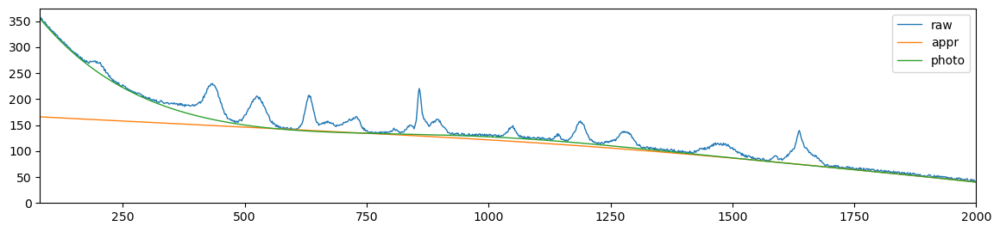

als_lambda: 672335.7536499335,	 als_p_weight: 0.0002395026619987486,	 error: 1328.446994668318, 	 smoothness: 0.5425981782480779, 	 smoothness: -0.5595066196141976


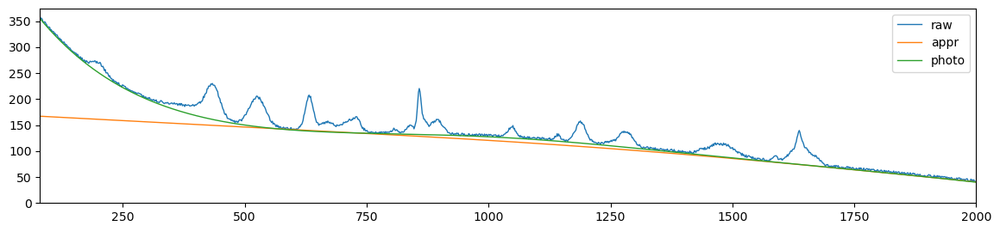

als_lambda: 672335.7536499335,	 als_p_weight: 0.00017433288221999874,	 error: 1472.810506647809, 	 smoothness: 0.5391148248032619, 	 smoothness: -0.5613016345073587


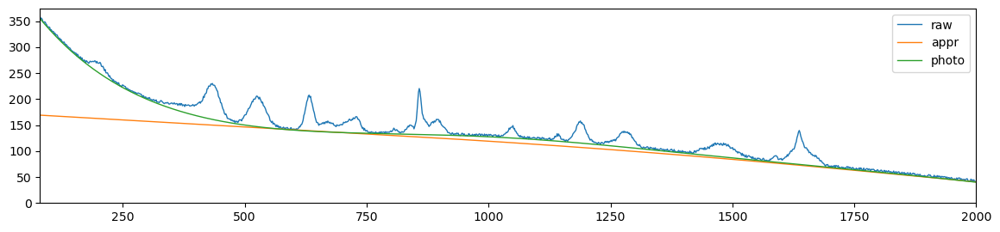

als_lambda: 672335.7536499335,	 als_p_weight: 0.0001268961003167922,	 error: 1667.9575204945022, 	 smoothness: 0.5347494333952096, 	 smoothness: -0.5626163373475097


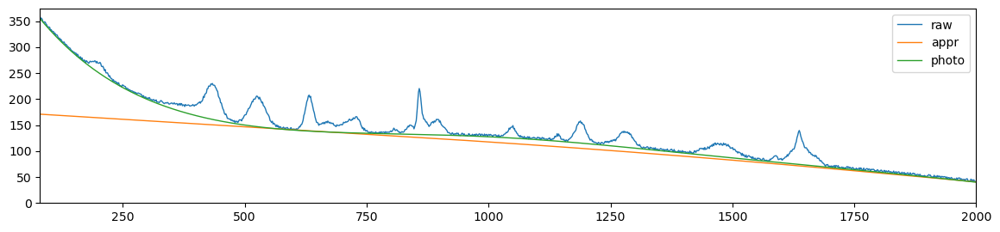

als_lambda: 672335.7536499335,	 als_p_weight: 9.236708571873866e-05,	 error: 1859.3277305520583, 	 smoothness: 0.5310138166039552, 	 smoothness: -0.5632971809964501


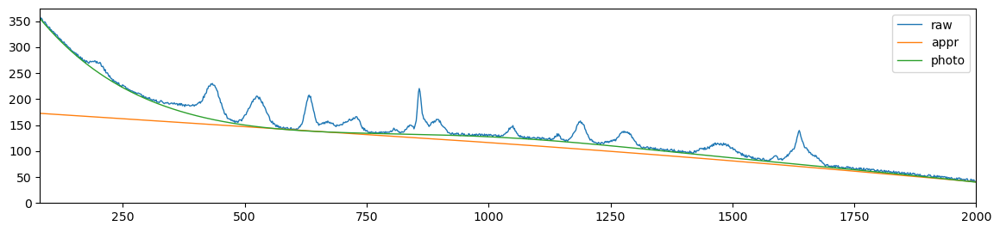

als_lambda: 672335.7536499335,	 als_p_weight: 6.723357536499335e-05,	 error: 2002.7531783541383, 	 smoothness: 0.5282193928334494, 	 smoothness: -0.5635593255402367


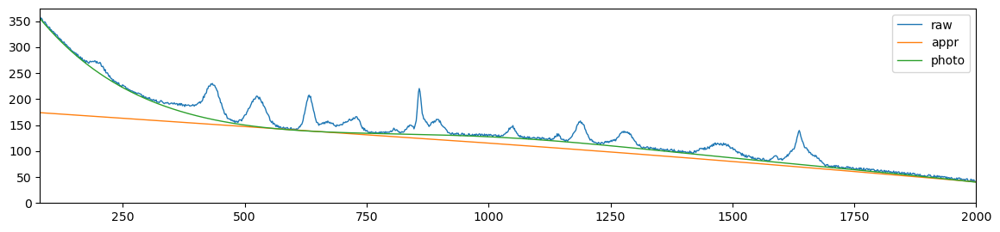

als_lambda: 672335.7536499335,	 als_p_weight: 4.893900918477499e-05,	 error: 2104.909207079552, 	 smoothness: 0.5263466262604607, 	 smoothness: -0.5636600807016863


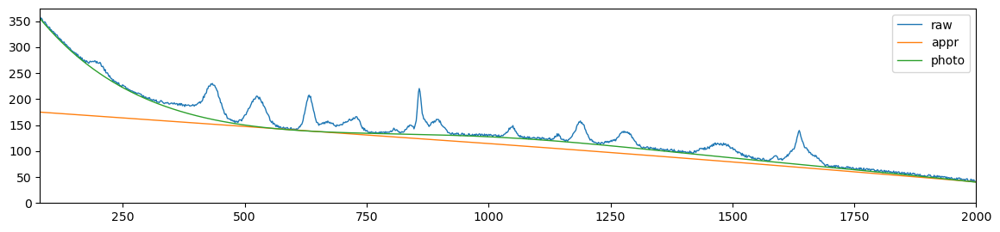

als_lambda: 672335.7536499335,	 als_p_weight: 3.5622478902624444e-05,	 error: 2175.741184385406, 	 smoothness: 0.524953738712883, 	 smoothness: -0.5635478495431598


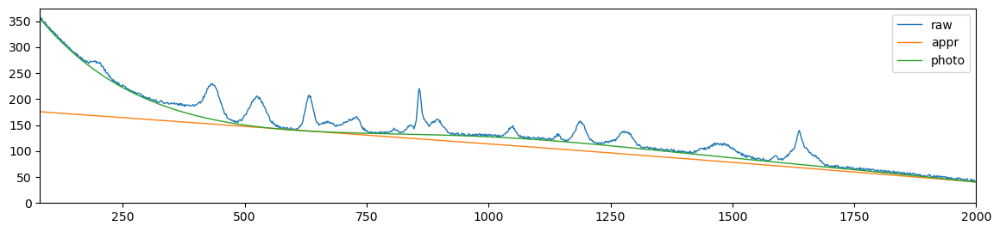

als_lambda: 672335.7536499335,	 als_p_weight: 2.592943797404667e-05,	 error: 2244.9861524947987, 	 smoothness: 0.5239617201449669, 	 smoothness: -0.5635590213194435


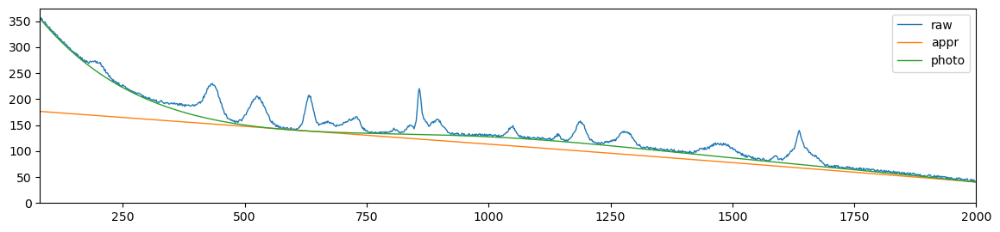

als_lambda: 672335.7536499335,	 als_p_weight: 1.8873918221350995e-05,	 error: 2295.199890540663, 	 smoothness: 0.5229463996102107, 	 smoothness: -0.5635668966924413


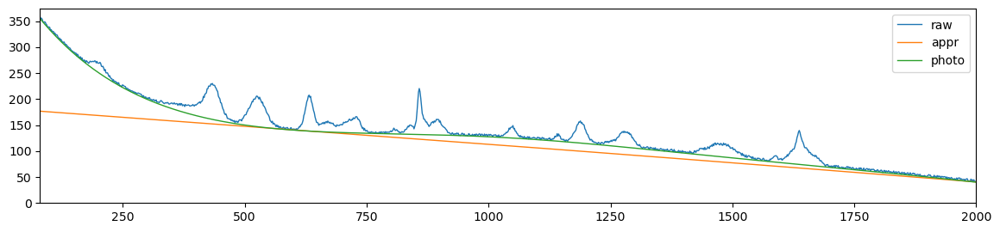

als_lambda: 672335.7536499335,	 als_p_weight: 1.3738237958832637e-05,	 error: 2331.721529581601, 	 smoothness: 0.5224621200738935, 	 smoothness: -0.5635336436717269


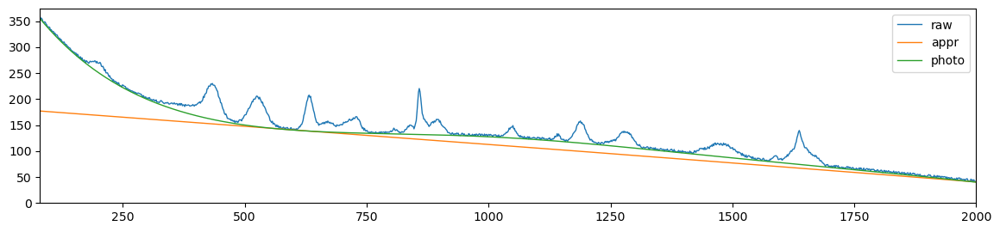

als_lambda: 672335.7536499335,	 als_p_weight: 1e-05,	 error: 2353.9513377575295, 	 smoothness: 0.5224383790367407, 	 smoothness: -0.5635318675869392


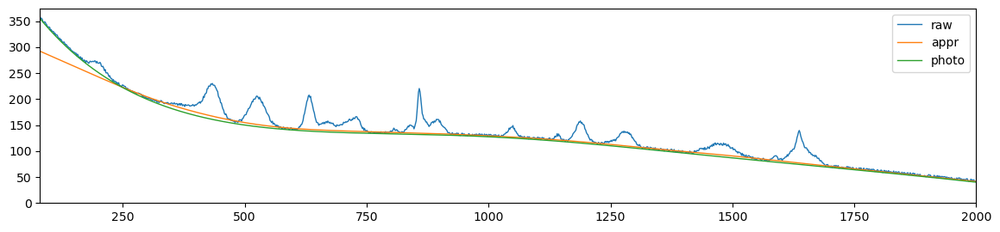

als_lambda: 1172102.2975334818,	 als_p_weight: 0.1,	 error: 435.58204165543475, 	 smoothness: 0.4583904553535585, 	 smoothness: -0.5262604667545977


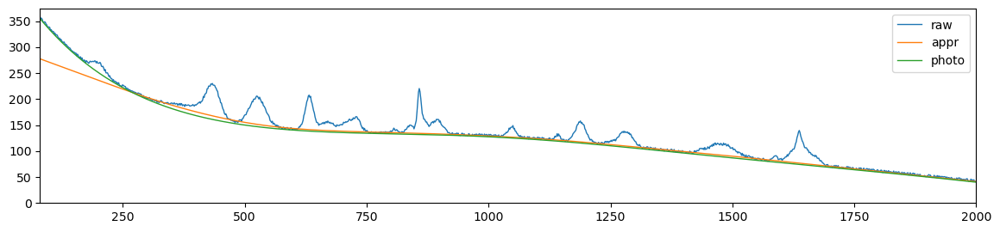

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0727895384398315,	 error: 467.2375642014161, 	 smoothness: 0.46701423365219014, 	 smoothness: -0.5299237843667881


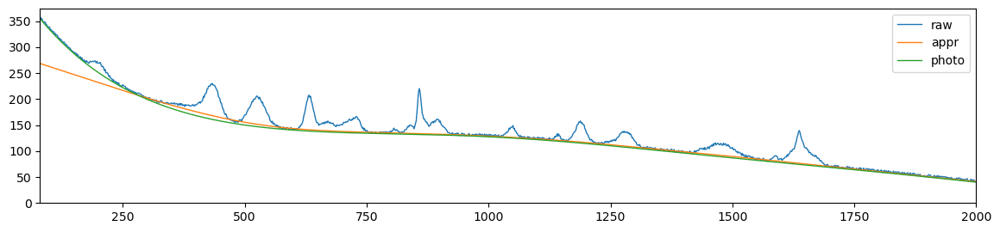

als_lambda: 1172102.2975334818,	 als_p_weight: 0.05298316906283707,	 error: 504.1106118297947, 	 smoothness: 0.4756096399882195, 	 smoothness: -0.5330940101008357


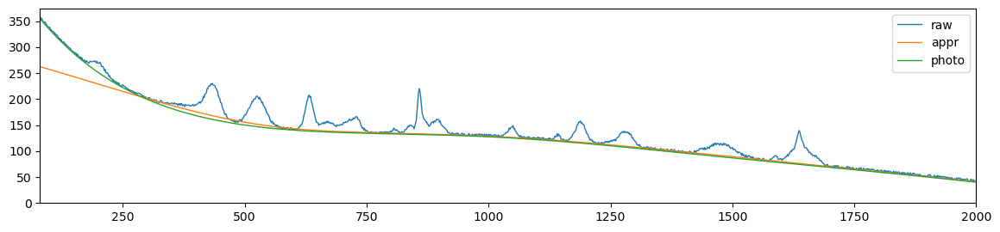

als_lambda: 1172102.2975334818,	 als_p_weight: 0.03856620421163472,	 error: 545.1406268280629, 	 smoothness: 0.4839702175296967, 	 smoothness: -0.5360023369398577


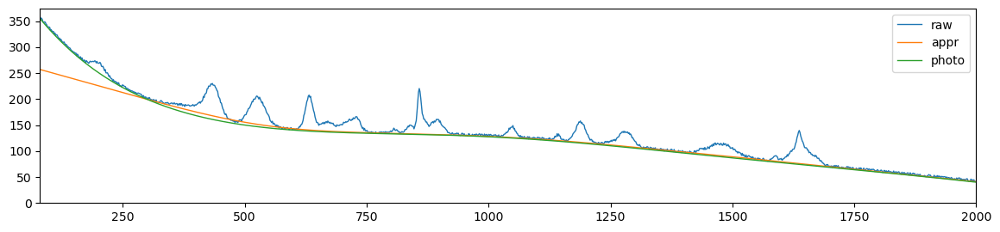

als_lambda: 1172102.2975334818,	 als_p_weight: 0.02807216203941177,	 error: 586.2829649975001, 	 smoothness: 0.4915960123895627, 	 smoothness: -0.538393509958571


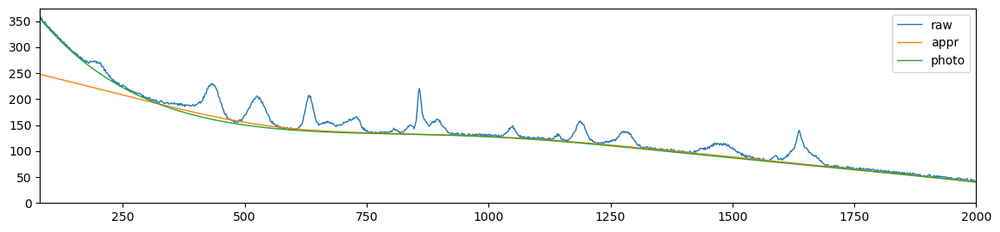

als_lambda: 1172102.2975334818,	 als_p_weight: 0.020433597178569417,	 error: 632.578330809818, 	 smoothness: 0.49902988964500644, 	 smoothness: -0.5408910560074385


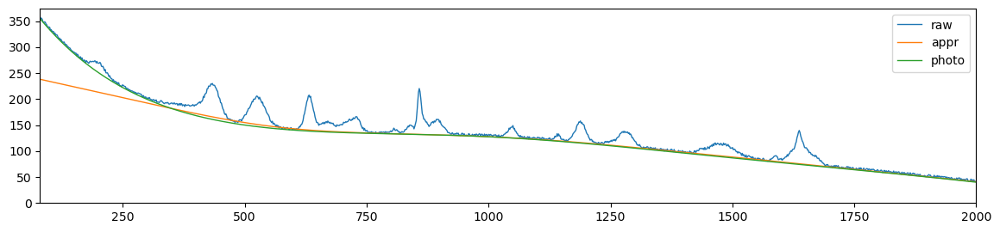

als_lambda: 1172102.2975334818,	 als_p_weight: 0.014873521072935119,	 error: 684.0906349829759, 	 smoothness: 0.5062789931256514, 	 smoothness: -0.5430026496320296


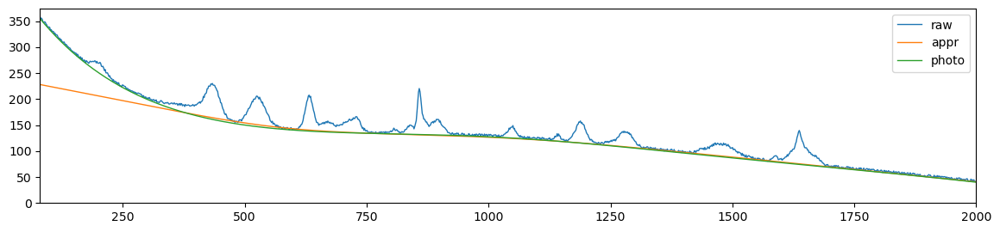

als_lambda: 1172102.2975334818,	 als_p_weight: 0.010826367338740546,	 error: 745.5351094541642, 	 smoothness: 0.5136245888824675, 	 smoothness: -0.5453681285166815


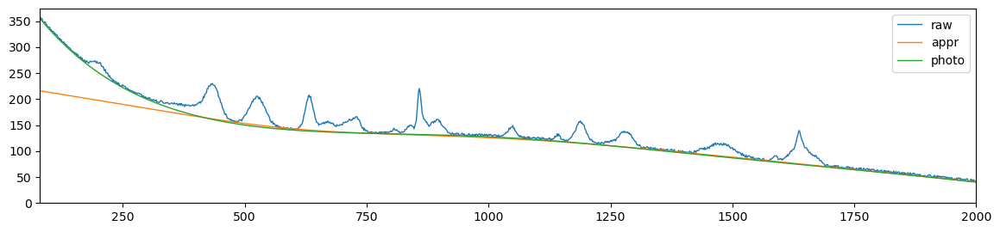

als_lambda: 1172102.2975334818,	 als_p_weight: 0.007880462815669913,	 error: 816.6600220533056, 	 smoothness: 0.5207801728036962, 	 smoothness: -0.5471075435399856


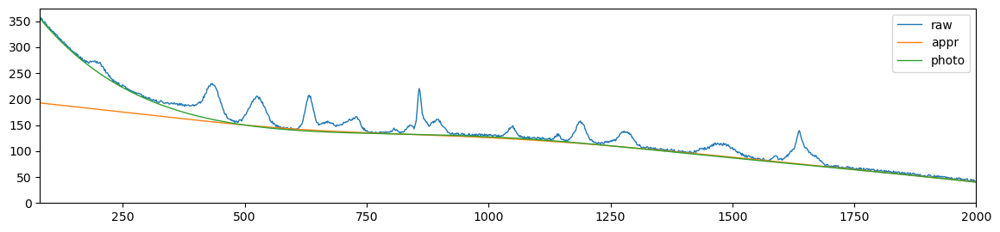

als_lambda: 1172102.2975334818,	 als_p_weight: 0.005736152510448681,	 error: 884.5805546953619, 	 smoothness: 0.5272683259512239, 	 smoothness: -0.5484674705550432


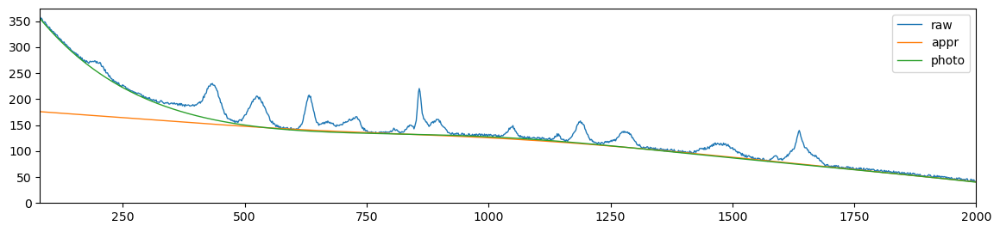

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0041753189365604,	 error: 946.9037704799027, 	 smoothness: 0.5328575816634556, 	 smoothness: -0.5495750800709334


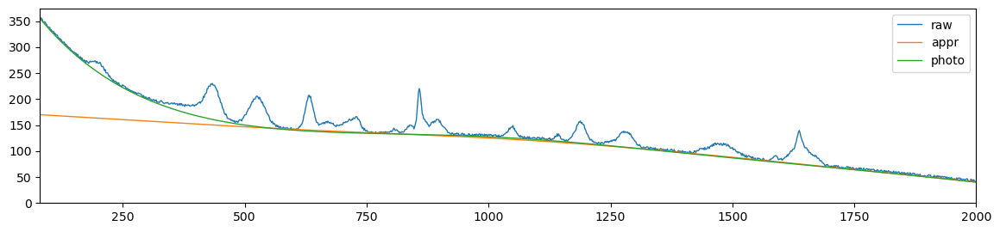

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0030391953823131978,	 error: 997.136392739229, 	 smoothness: 0.5372964786847207, 	 smoothness: -0.5504168063454277


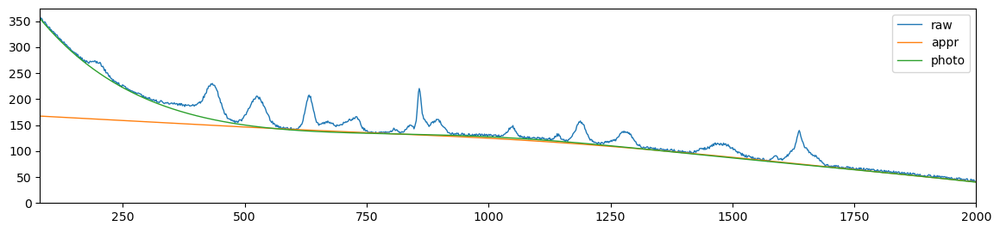

als_lambda: 1172102.2975334818,	 als_p_weight: 0.00221221629107045,	 error: 1043.7157705132183, 	 smoothness: 0.5410537152566409, 	 smoothness: -0.5514483338113839


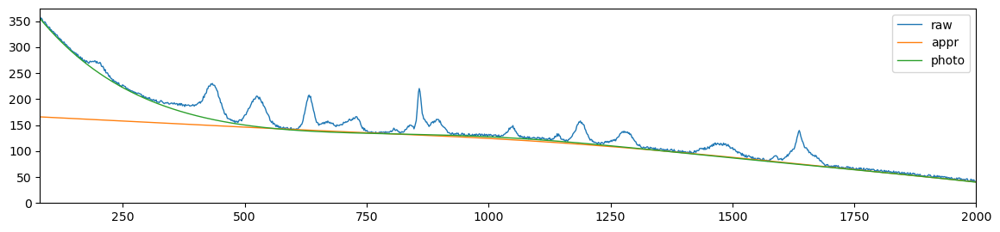

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0016102620275609393,	 error: 1093.9099425853371, 	 smoothness: 0.5440723664558298, 	 smoothness: -0.552771619464603


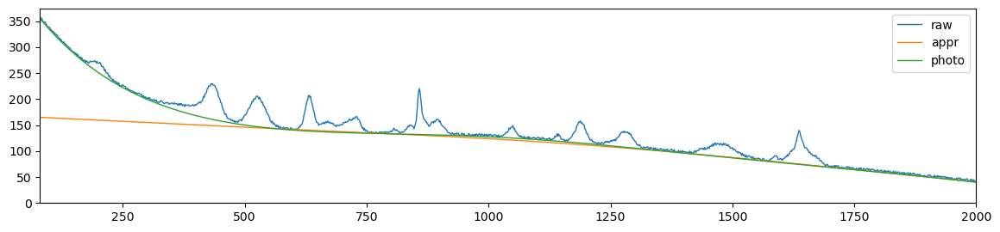

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0011721022975334804,	 error: 1128.4985838288626, 	 smoothness: 0.5458404055309367, 	 smoothness: -0.5542785557538427


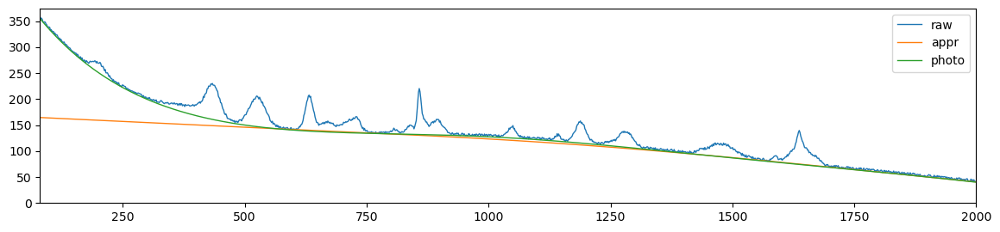

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0008531678524172806,	 error: 1171.3643640545704, 	 smoothness: 0.5456555125785045, 	 smoothness: -0.5557090030270573


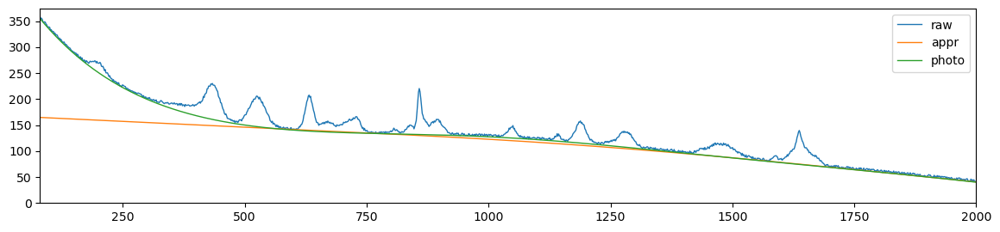

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0006210169418915617,	 error: 1220.0013364299018, 	 smoothness: 0.5447885223992855, 	 smoothness: -0.5572922389326636


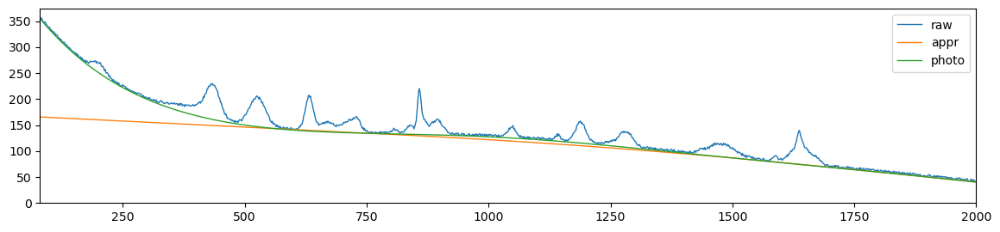

als_lambda: 1172102.2975334818,	 als_p_weight: 0.00045203536563602454,	 error: 1295.1972625529165, 	 smoothness: 0.5431712947074682, 	 smoothness: -0.5591046911310952


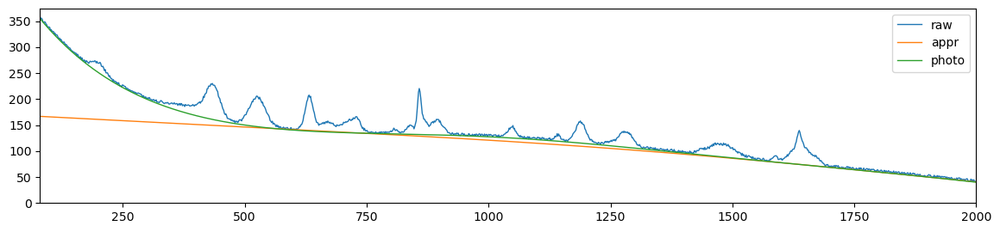

als_lambda: 1172102.2975334818,	 als_p_weight: 0.00032903445623126676,	 error: 1429.1654721504733, 	 smoothness: 0.5399184357882194, 	 smoothness: -0.5609542684046656


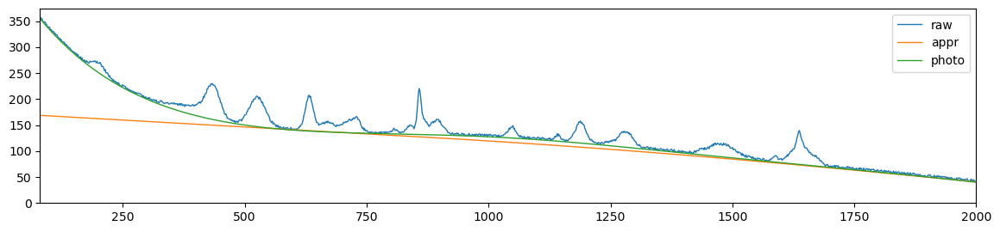

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0002395026619987486,	 error: 1630.8136093962194, 	 smoothness: 0.5351797835012705, 	 smoothness: -0.5624761074113801


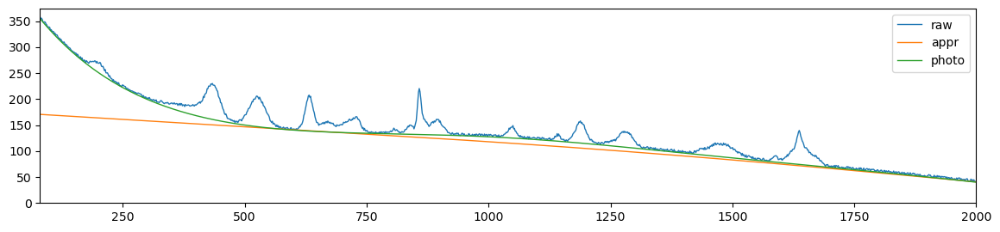

als_lambda: 1172102.2975334818,	 als_p_weight: 0.00017433288221999874,	 error: 1827.6116247341529, 	 smoothness: 0.5312168727134474, 	 smoothness: -0.5632636434920726


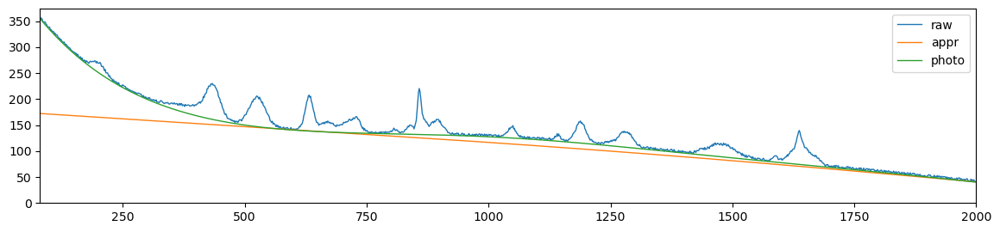

als_lambda: 1172102.2975334818,	 als_p_weight: 0.0001268961003167922,	 error: 1993.2944392726297, 	 smoothness: 0.5280792643029283, 	 smoothness: -0.5636016866589961


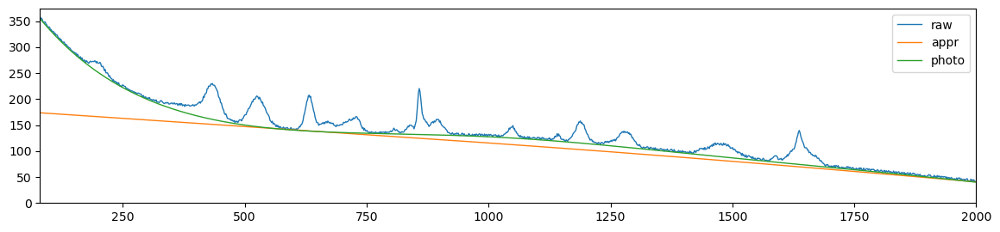

als_lambda: 1172102.2975334818,	 als_p_weight: 9.236708571873866e-05,	 error: 2120.0219674557798, 	 smoothness: 0.5257812796608401, 	 smoothness: -0.5636782667890895


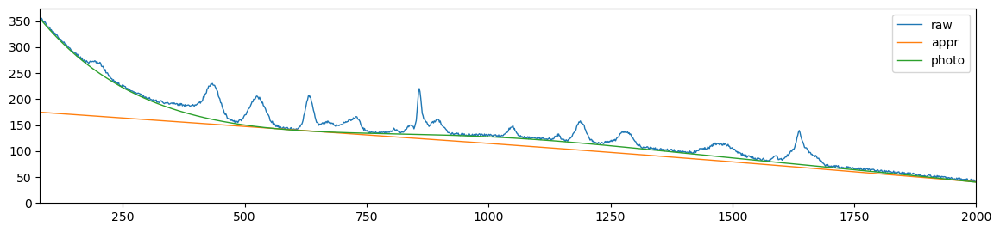

als_lambda: 1172102.2975334818,	 als_p_weight: 6.723357536499335e-05,	 error: 2209.630529113753, 	 smoothness: 0.524228803588873, 	 smoothness: -0.5636581720858276


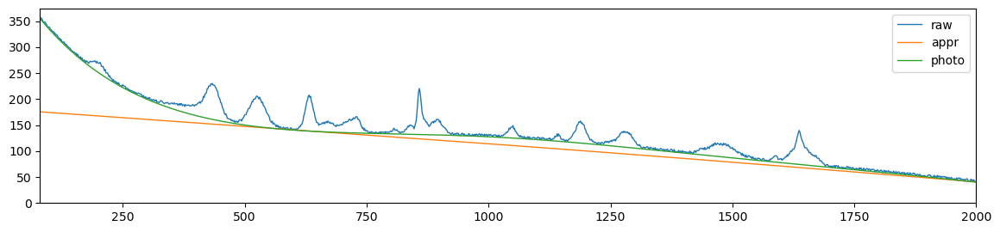

als_lambda: 1172102.2975334818,	 als_p_weight: 4.893900918477499e-05,	 error: 2273.31540944535, 	 smoothness: 0.5232362722824774, 	 smoothness: -0.5636105545093332


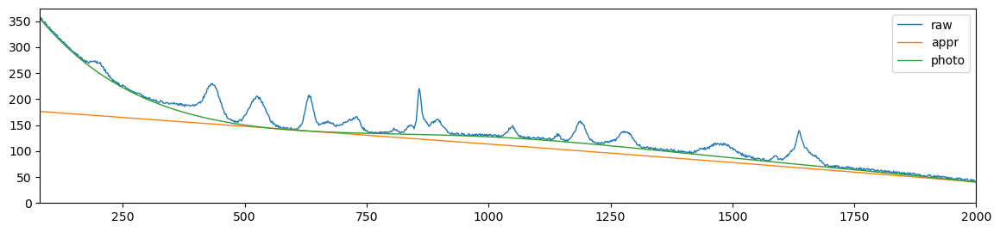

als_lambda: 1172102.2975334818,	 als_p_weight: 3.5622478902624444e-05,	 error: 2318.231458457185, 	 smoothness: 0.5225918710000166, 	 smoothness: -0.5635679167558372


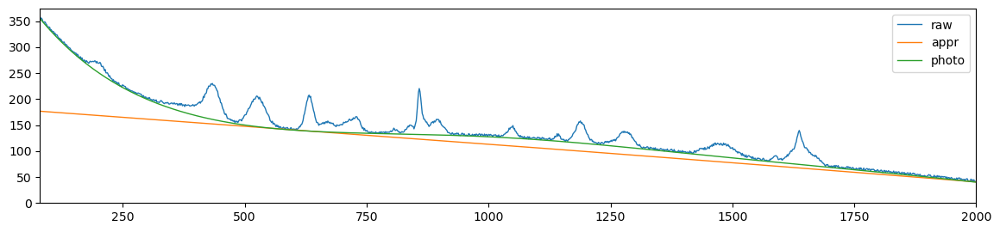

als_lambda: 1172102.2975334818,	 als_p_weight: 2.592943797404667e-05,	 error: 2350.565629434475, 	 smoothness: 0.5221225493443207, 	 smoothness: -0.5635176761202448


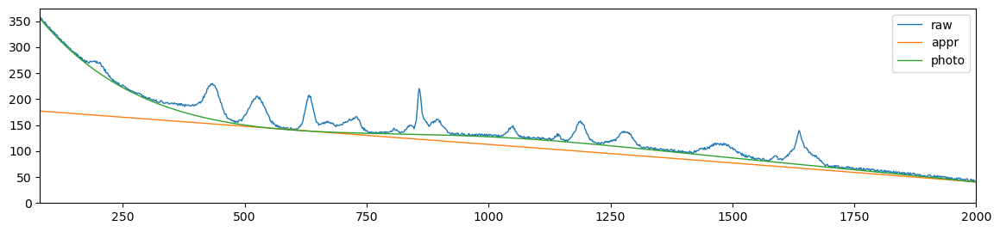

als_lambda: 1172102.2975334818,	 als_p_weight: 1.8873918221350995e-05,	 error: 2374.6811059474003, 	 smoothness: 0.5217818468454919, 	 smoothness: -0.563481298240029


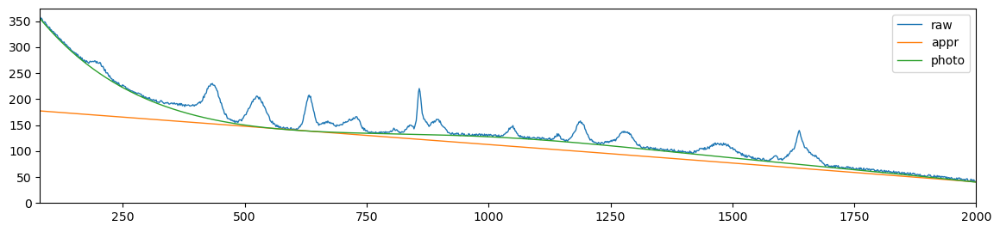

als_lambda: 1172102.2975334818,	 als_p_weight: 1.3738237958832637e-05,	 error: 2385.6329260817556, 	 smoothness: 0.5216581721743604, 	 smoothness: -0.5634918807037408


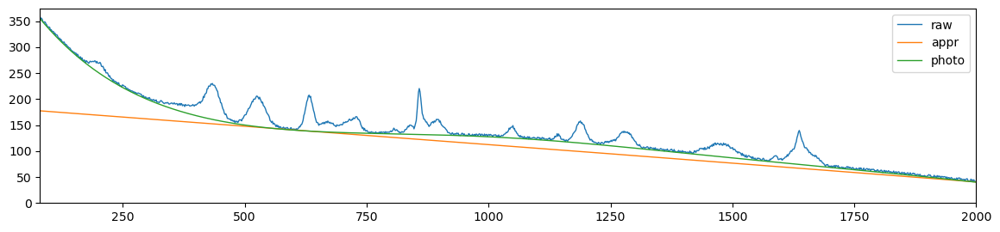

als_lambda: 1172102.2975334818,	 als_p_weight: 1e-05,	 error: 2398.1515227364257, 	 smoothness: 0.5214903765494493, 	 smoothness: -0.5634698393815902


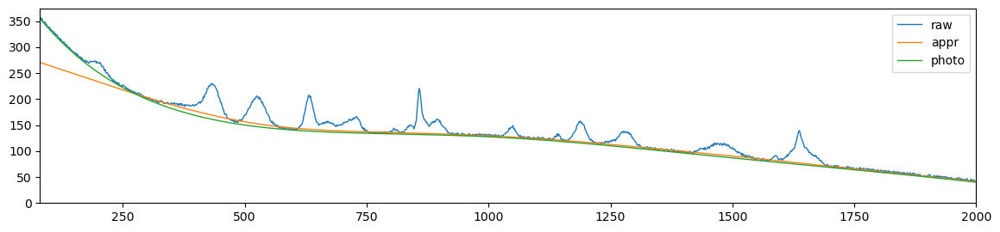

als_lambda: 2043359.7178569438,	 als_p_weight: 0.1,	 error: 492.4888263912858, 	 smoothness: 0.47385779798917577, 	 smoothness: -0.532422655310028


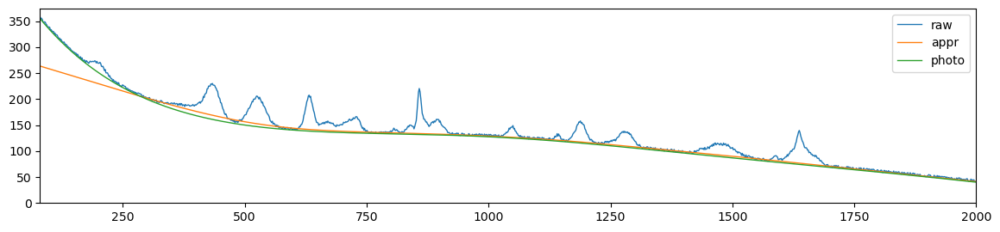

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0727895384398315,	 error: 532.1439302442914, 	 smoothness: 0.4822762854230327, 	 smoothness: -0.5354358496614656


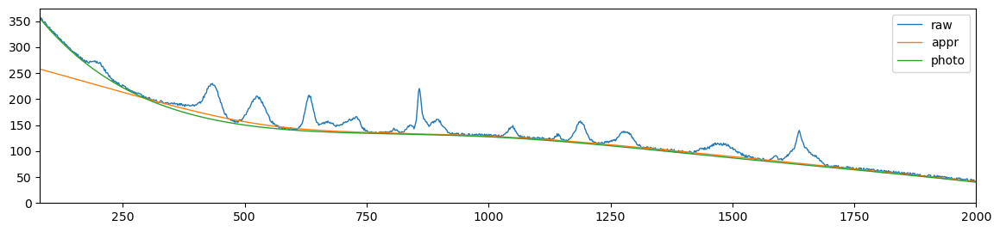

als_lambda: 2043359.7178569438,	 als_p_weight: 0.05298316906283707,	 error: 573.7181480188106, 	 smoothness: 0.4901573333738446, 	 smoothness: -0.5380247272477845


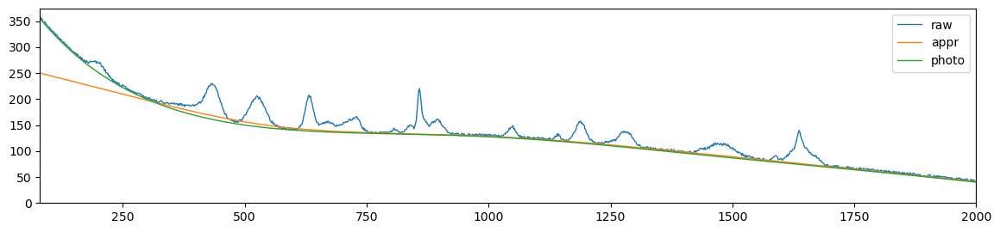

als_lambda: 2043359.7178569438,	 als_p_weight: 0.03856620421163472,	 error: 616.337916692972, 	 smoothness: 0.49745776632014155, 	 smoothness: -0.5403574935161309


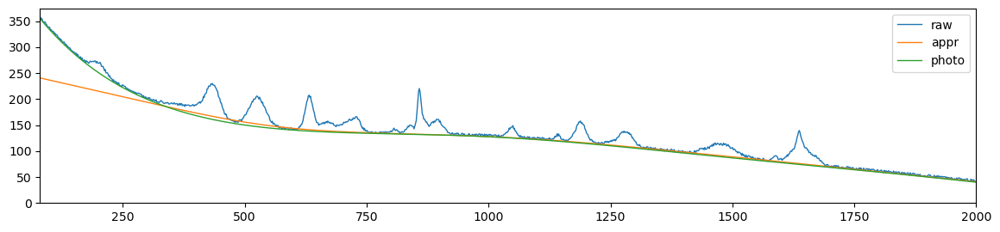

als_lambda: 2043359.7178569438,	 als_p_weight: 0.02807216203941177,	 error: 667.0958919557975, 	 smoothness: 0.5048029655775355, 	 smoothness: -0.5426363124336921


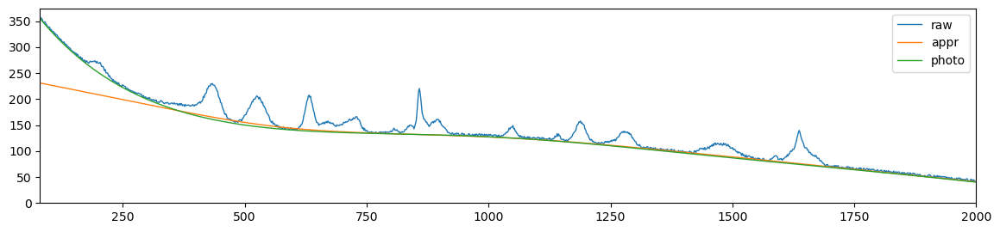

als_lambda: 2043359.7178569438,	 als_p_weight: 0.020433597178569417,	 error: 723.039031168568, 	 smoothness: 0.5120005493971926, 	 smoothness: -0.5449335097427532


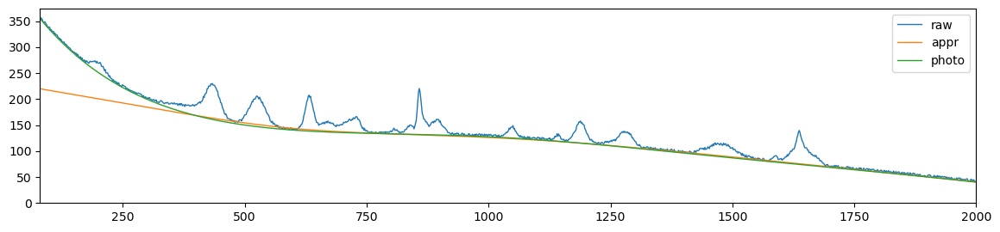

als_lambda: 2043359.7178569438,	 als_p_weight: 0.014873521072935119,	 error: 793.7766383229421, 	 smoothness: 0.5192772773838432, 	 smoothness: -0.5468715621211218


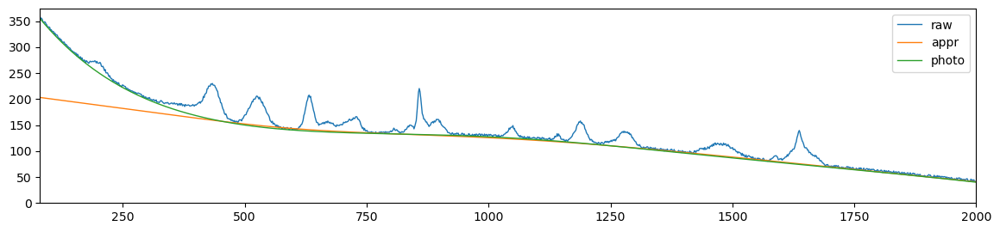

als_lambda: 2043359.7178569438,	 als_p_weight: 0.010826367338740546,	 error: 860.8782662876033, 	 smoothness: 0.5257653475205575, 	 smoothness: -0.5482370149620193


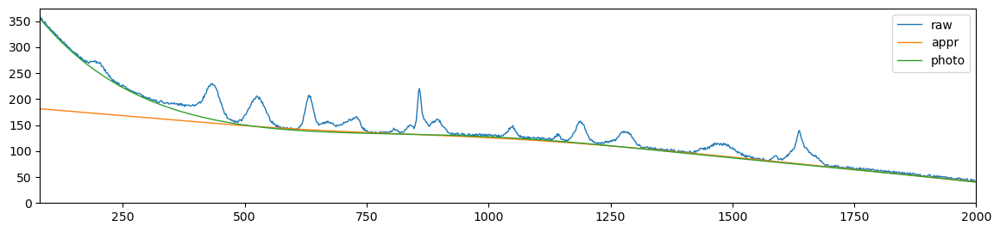

als_lambda: 2043359.7178569438,	 als_p_weight: 0.007880462815669913,	 error: 925.6670649970488, 	 smoothness: 0.5316726740609362, 	 smoothness: -0.5494676643203296


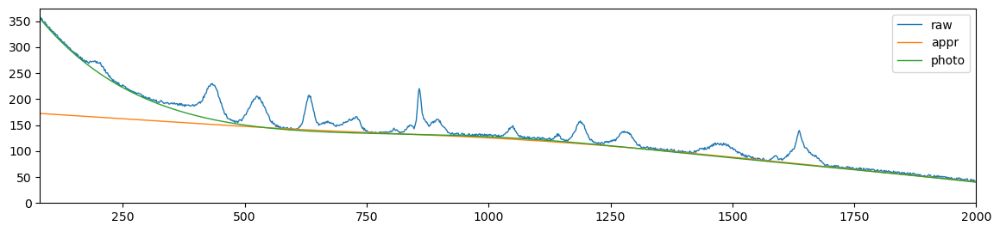

als_lambda: 2043359.7178569438,	 als_p_weight: 0.005736152510448681,	 error: 978.6253133097807, 	 smoothness: 0.53634676403851, 	 smoothness: -0.5503518878764291


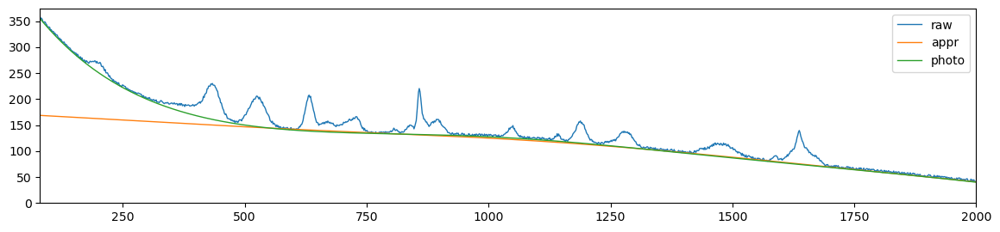

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0041753189365604,	 error: 1025.1245681963978, 	 smoothness: 0.540243011714862, 	 smoothness: -0.5513111630380823


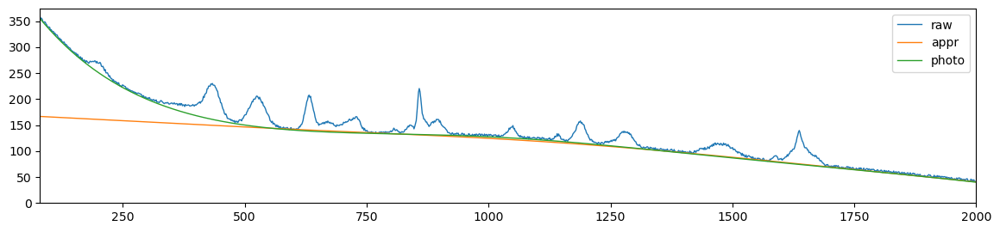

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0030391953823131978,	 error: 1073.2513929323516, 	 smoothness: 0.5434578495876402, 	 smoothness: -0.5525735492991295


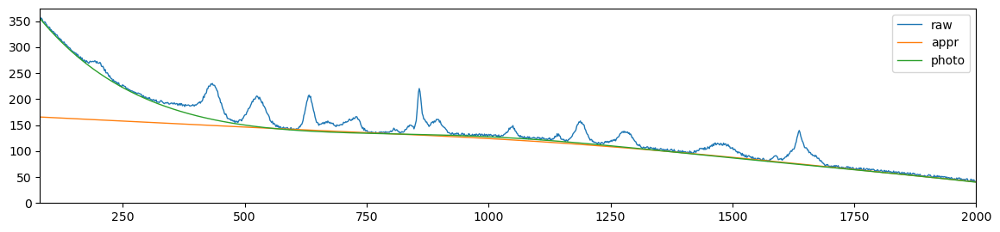

als_lambda: 2043359.7178569438,	 als_p_weight: 0.00221221629107045,	 error: 1112.152639728561, 	 smoothness: 0.5455625183406603, 	 smoothness: -0.553997775882329


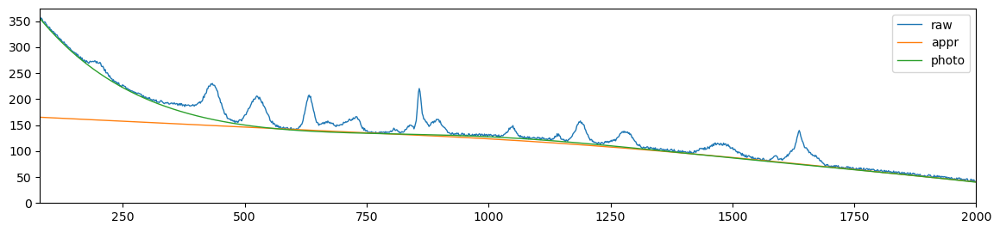

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0016102620275609393,	 error: 1151.178408928149, 	 smoothness: 0.5457068286070952, 	 smoothness: -0.555460413501202


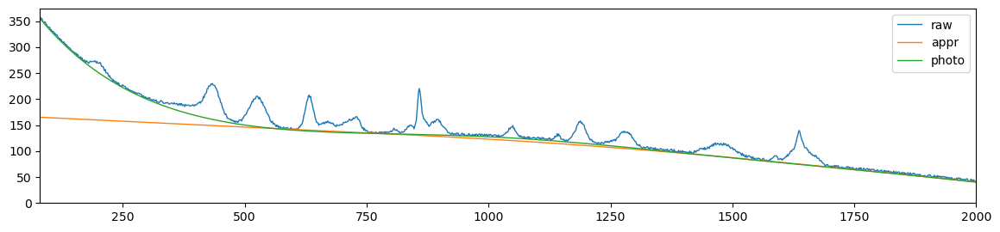

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0011721022975334804,	 error: 1197.9934912785723, 	 smoothness: 0.5451183474121837, 	 smoothness: -0.5569512394135947


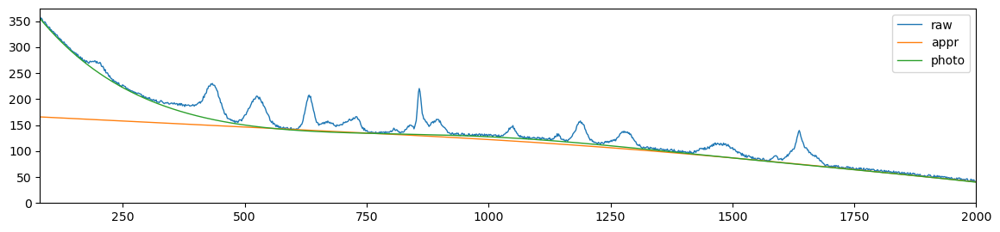

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0008531678524172806,	 error: 1261.7981567646252, 	 smoothness: 0.5437034096488896, 	 smoothness: -0.5587163921917602


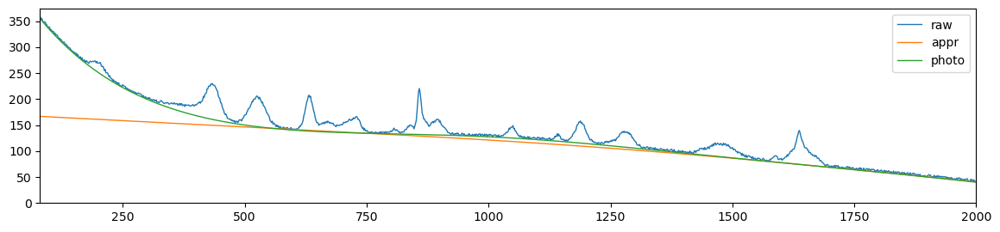

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0006210169418915617,	 error: 1381.693485608678, 	 smoothness: 0.5407627091164435, 	 smoothness: -0.5606091419035691


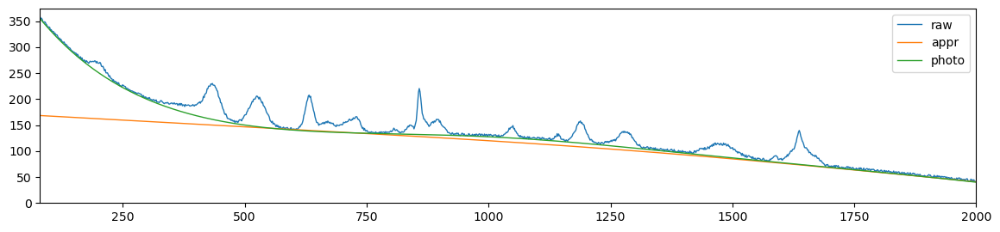

als_lambda: 2043359.7178569438,	 als_p_weight: 0.00045203536563602454,	 error: 1575.410957057457, 	 smoothness: 0.5362688629058414, 	 smoothness: -0.5621983415432685


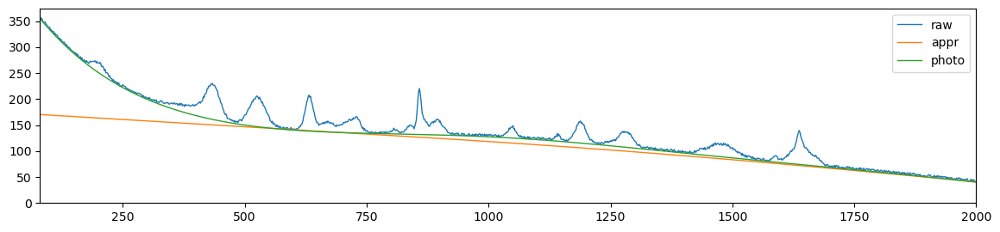

als_lambda: 2043359.7178569438,	 als_p_weight: 0.00032903445623126676,	 error: 1784.9060723056173, 	 smoothness: 0.5318765794538596, 	 smoothness: -0.563175262899613


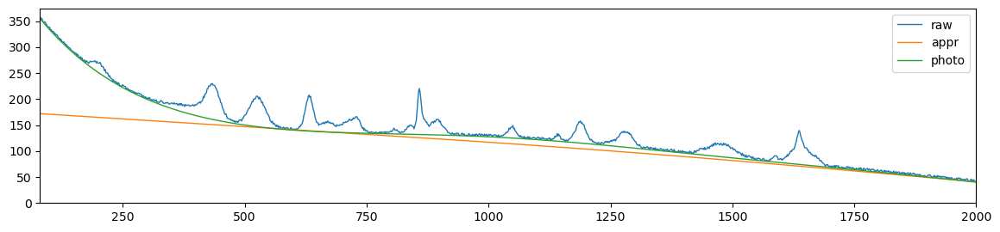

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0002395026619987486,	 error: 1957.801732094849, 	 smoothness: 0.528558026617499, 	 smoothness: -0.5635570829790236


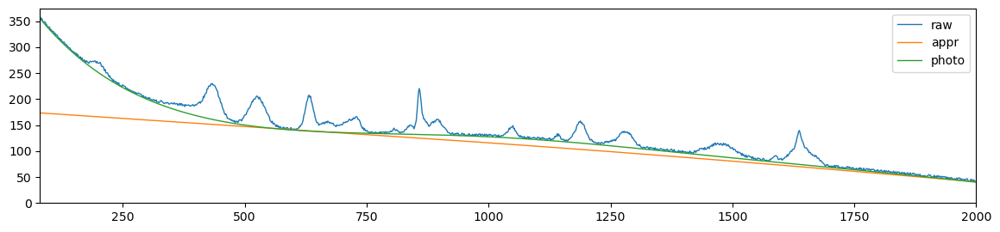

als_lambda: 2043359.7178569438,	 als_p_weight: 0.00017433288221999874,	 error: 2089.4182812788163, 	 smoothness: 0.5261221886350769, 	 smoothness: -0.5636645190655077


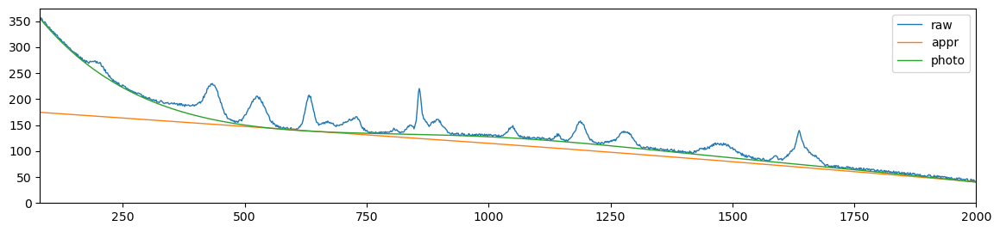

als_lambda: 2043359.7178569438,	 als_p_weight: 0.0001268961003167922,	 error: 2186.79790111415, 	 smoothness: 0.5244393075833964, 	 smoothness: -0.5636531755118367


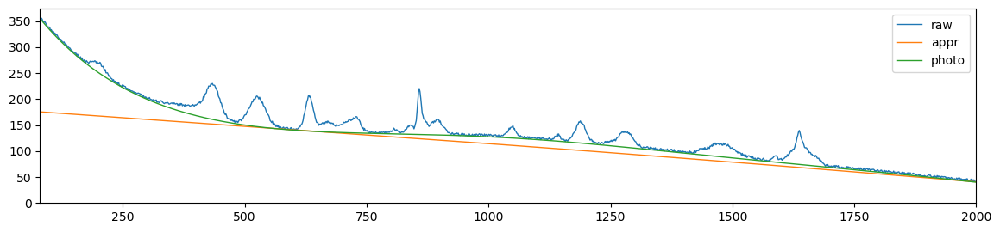

als_lambda: 2043359.7178569438,	 als_p_weight: 9.236708571873866e-05,	 error: 2257.3043877861815, 	 smoothness: 0.5233292019001364, 	 smoothness: -0.5636050527249187


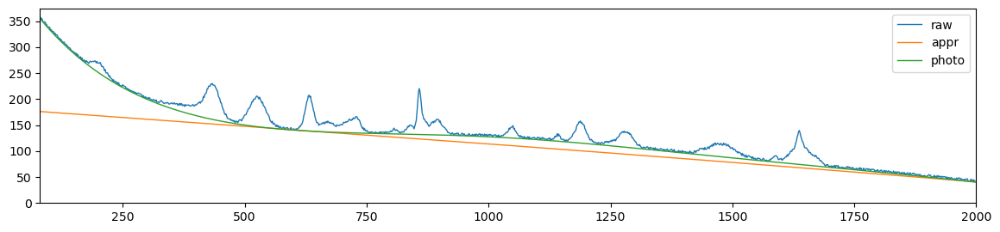

als_lambda: 2043359.7178569438,	 als_p_weight: 6.723357536499335e-05,	 error: 2307.8116475143675, 	 smoothness: 0.5225927909006016, 	 smoothness: -0.5635553418068088


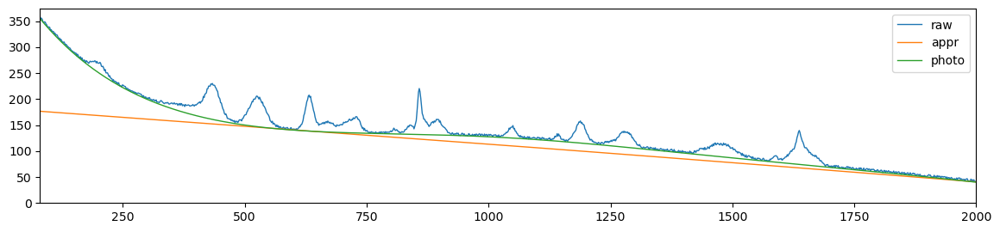

als_lambda: 2043359.7178569438,	 als_p_weight: 4.893900918477499e-05,	 error: 2345.1539937783277, 	 smoothness: 0.5220722279724778, 	 smoothness: -0.5635034054345437


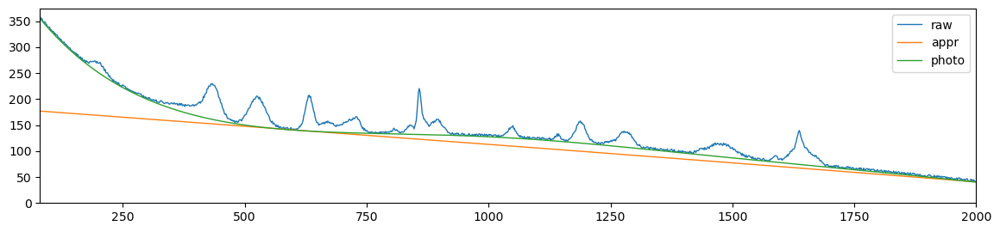

als_lambda: 2043359.7178569438,	 als_p_weight: 3.5622478902624444e-05,	 error: 2372.4537201071266, 	 smoothness: 0.521700766639931, 	 smoothness: -0.5634640216438941


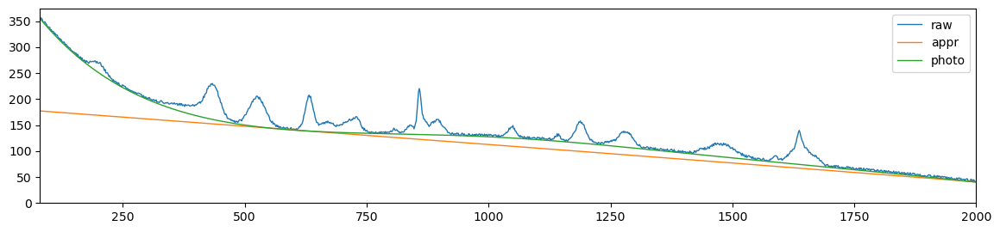

als_lambda: 2043359.7178569438,	 als_p_weight: 2.592943797404667e-05,	 error: 2392.595752715264, 	 smoothness: 0.5214366237822428, 	 smoothness: -0.5634330374042984


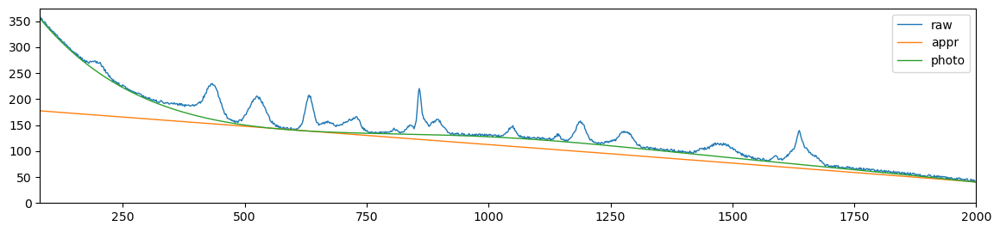

als_lambda: 2043359.7178569438,	 als_p_weight: 1.8873918221350995e-05,	 error: 2408.049888795464, 	 smoothness: 0.5212810692260262, 	 smoothness: -0.5634329229385162


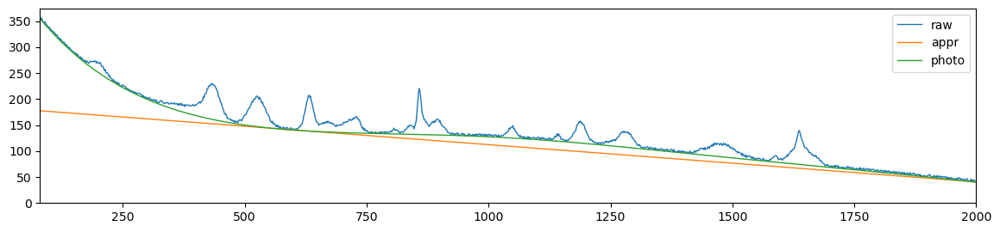

als_lambda: 2043359.7178569438,	 als_p_weight: 1.3738237958832637e-05,	 error: 2418.5210245914895, 	 smoothness: 0.5211411588571425, 	 smoothness: -0.5634127061959611


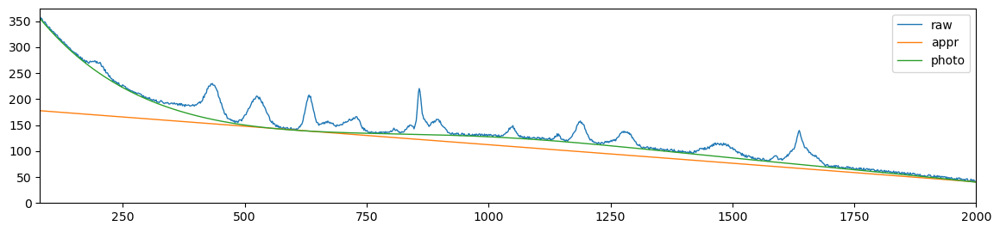

als_lambda: 2043359.7178569438,	 als_p_weight: 1e-05,	 error: 2424.95165142446, 	 smoothness: 0.521032244985175, 	 smoothness: -0.5633921730903944


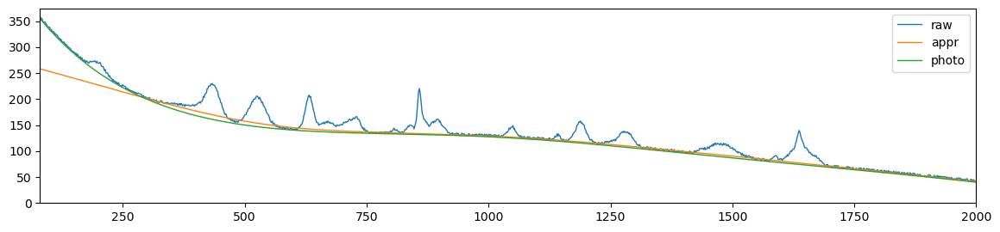

als_lambda: 3562247.890262444,	 als_p_weight: 0.1,	 error: 560.9221533458642, 	 smoothness: 0.4887252770824737, 	 smoothness: -0.537634738257609


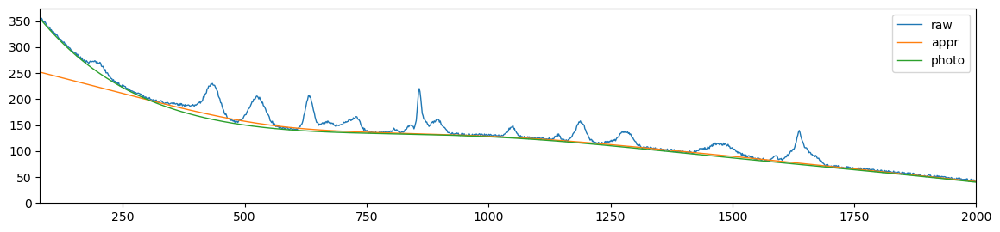

als_lambda: 3562247.890262444,	 als_p_weight: 0.0727895384398315,	 error: 602.426927757776, 	 smoothness: 0.4960978435575718, 	 smoothness: -0.5399415788747097


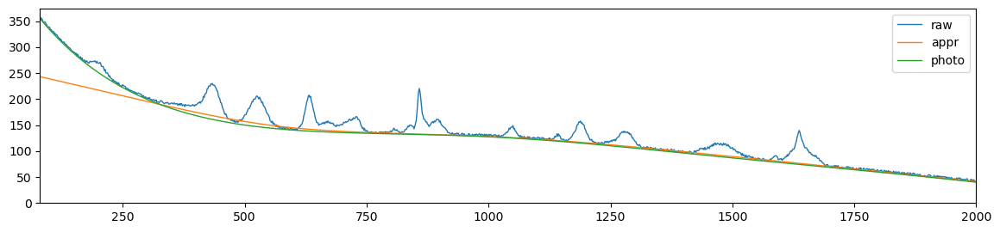

als_lambda: 3562247.890262444,	 als_p_weight: 0.05298316906283707,	 error: 650.66467217399, 	 smoothness: 0.503416507112081, 	 smoothness: -0.5423228016105053


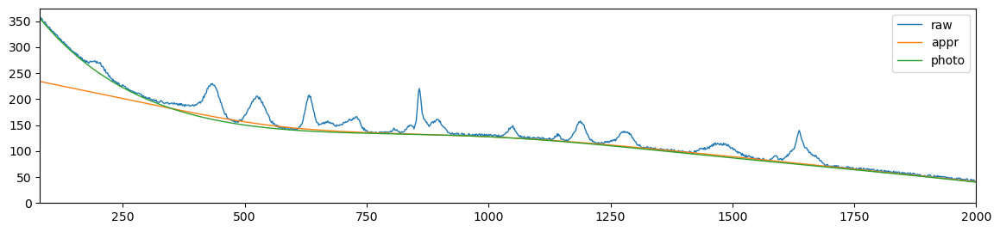

als_lambda: 3562247.890262444,	 als_p_weight: 0.03856620421163472,	 error: 701.3578889256082, 	 smoothness: 0.5103748992685555, 	 smoothness: -0.5443041654824905


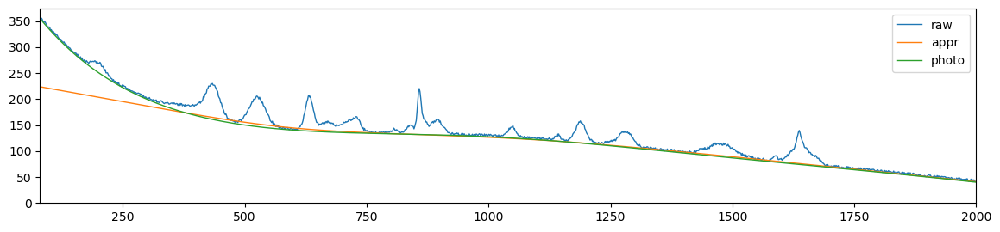

als_lambda: 3562247.890262444,	 als_p_weight: 0.02807216203941177,	 error: 767.2105920037413, 	 smoothness: 0.5176598600922161, 	 smoothness: -0.5465792138288136


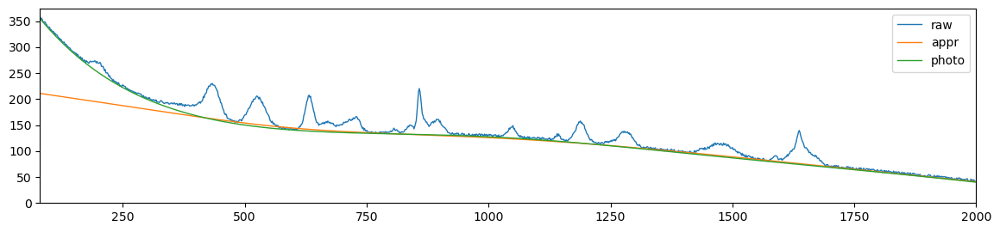

als_lambda: 3562247.890262444,	 als_p_weight: 0.020433597178569417,	 error: 837.7523954580175, 	 smoothness: 0.5243826404656073, 	 smoothness: -0.5480612808593278


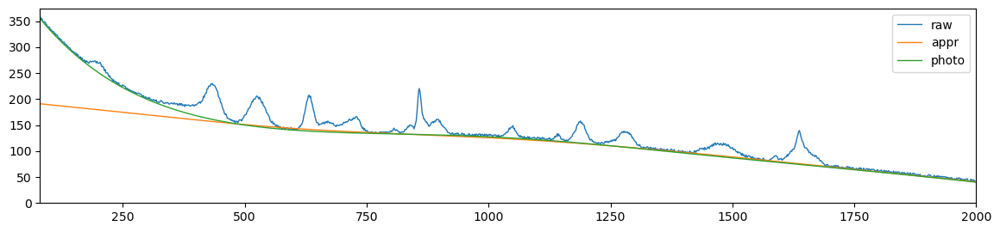

als_lambda: 3562247.890262444,	 als_p_weight: 0.014873521072935119,	 error: 900.4447800633023, 	 smoothness: 0.530313662897144, 	 smoothness: -0.5493162511623455


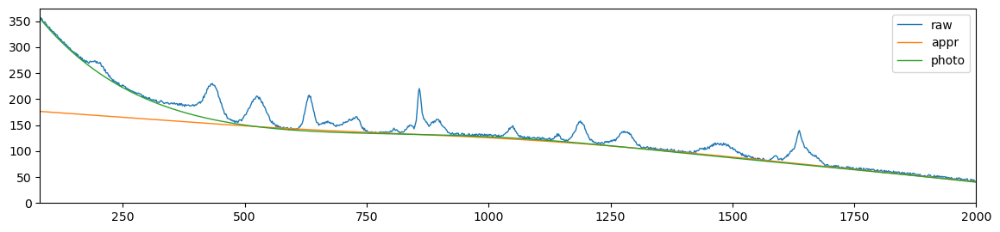

als_lambda: 3562247.890262444,	 als_p_weight: 0.010826367338740546,	 error: 958.2342811221009, 	 smoothness: 0.5353821042488043, 	 smoothness: -0.5503139171686189


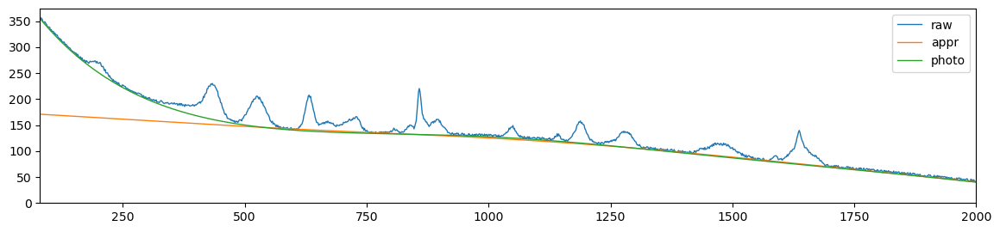

als_lambda: 3562247.890262444,	 als_p_weight: 0.007880462815669913,	 error: 1005.3834834892705, 	 smoothness: 0.5394071262161166, 	 smoothness: -0.5512332172946247


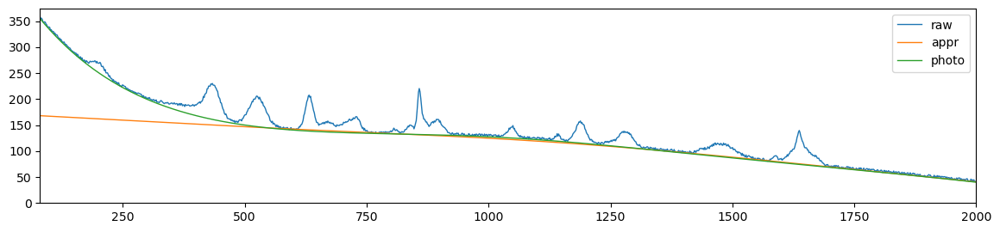

als_lambda: 3562247.890262444,	 als_p_weight: 0.005736152510448681,	 error: 1048.854755407338, 	 smoothness: 0.5427355296931075, 	 smoothness: -0.552400195382702


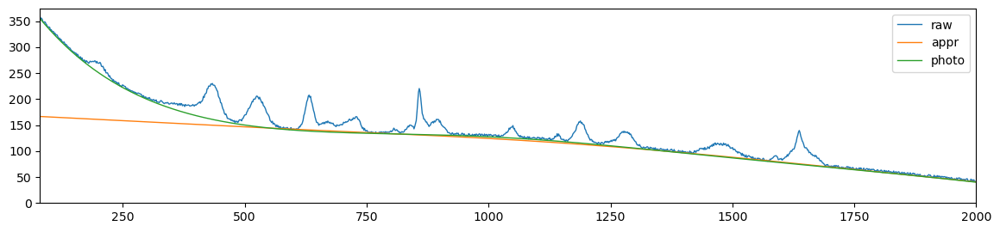

als_lambda: 3562247.890262444,	 als_p_weight: 0.0041753189365604,	 error: 1092.3762295139159, 	 smoothness: 0.5451191204527372, 	 smoothness: -0.5537678756169107


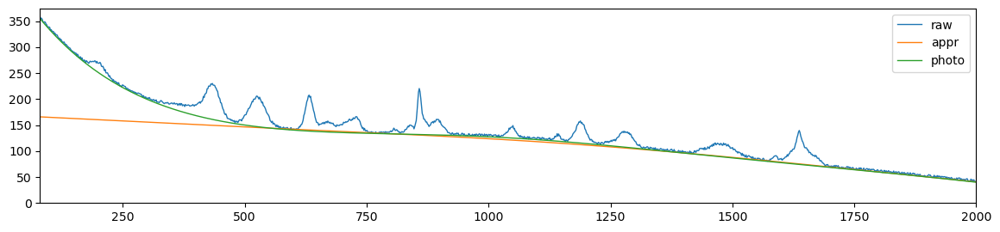

als_lambda: 3562247.890262444,	 als_p_weight: 0.0030391953823131978,	 error: 1122.953168329245, 	 smoothness: 0.5458863894093937, 	 smoothness: -0.5553035390438746


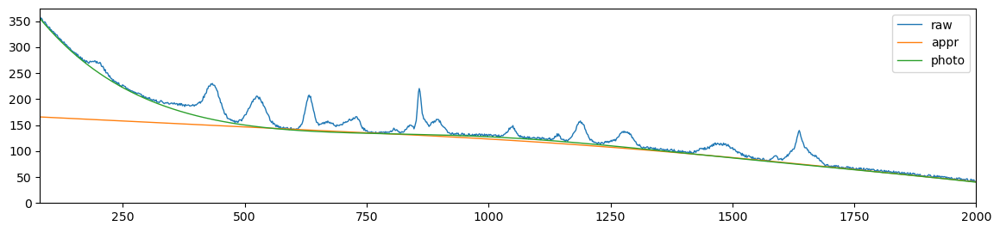

als_lambda: 3562247.890262444,	 als_p_weight: 0.00221221629107045,	 error: 1173.5293502021593, 	 smoothness: 0.5453580243817907, 	 smoothness: -0.5566615201200016


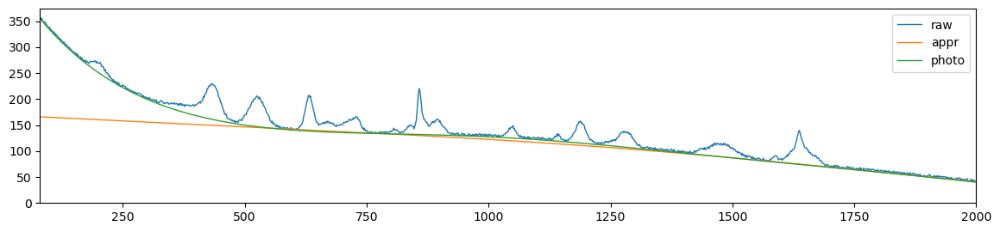

als_lambda: 3562247.890262444,	 als_p_weight: 0.0016102620275609393,	 error: 1228.7151795539178, 	 smoothness: 0.5441439323038635, 	 smoothness: -0.5583548953186284


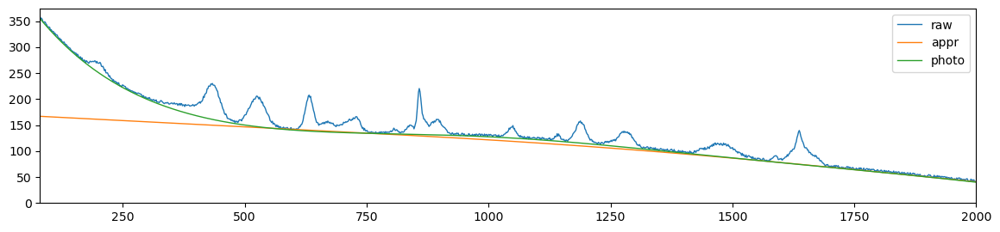

als_lambda: 3562247.890262444,	 als_p_weight: 0.0011721022975334804,	 error: 1327.8605089375792, 	 smoothness: 0.5415671133005642, 	 smoothness: -0.560217645018069


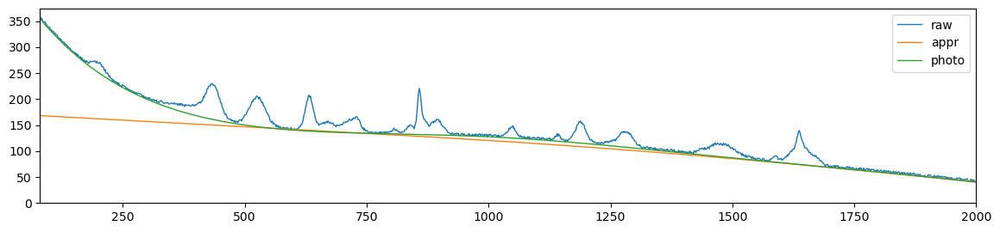

als_lambda: 3562247.890262444,	 als_p_weight: 0.0008531678524172806,	 error: 1509.0758962461225, 	 smoothness: 0.5374104185169067, 	 smoothness: -0.5618954507742887


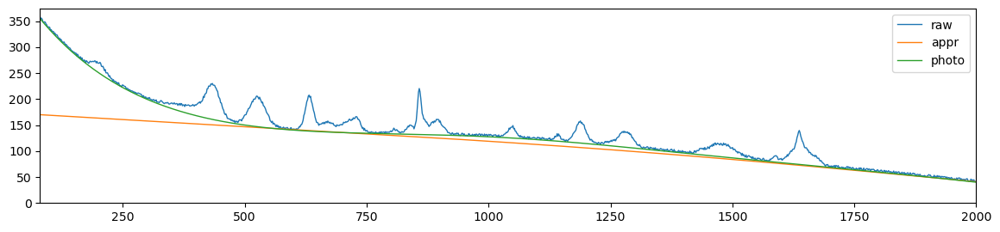

als_lambda: 3562247.890262444,	 als_p_weight: 0.0006210169418915617,	 error: 1719.0601602089007, 	 smoothness: 0.5328244575887798, 	 smoothness: -0.5630407476423325


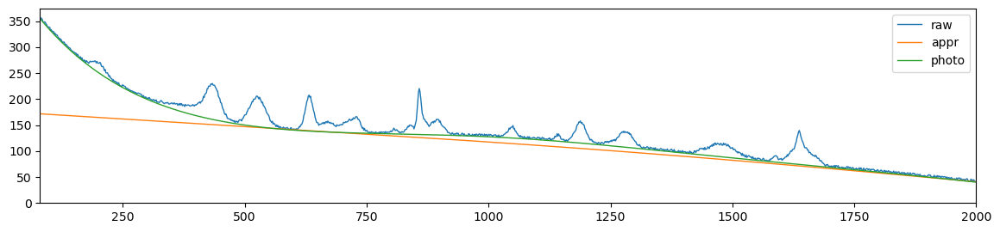

als_lambda: 3562247.890262444,	 als_p_weight: 0.00045203536563602454,	 error: 1903.1506942080925, 	 smoothness: 0.529282531062868, 	 smoothness: -0.5635214561450865


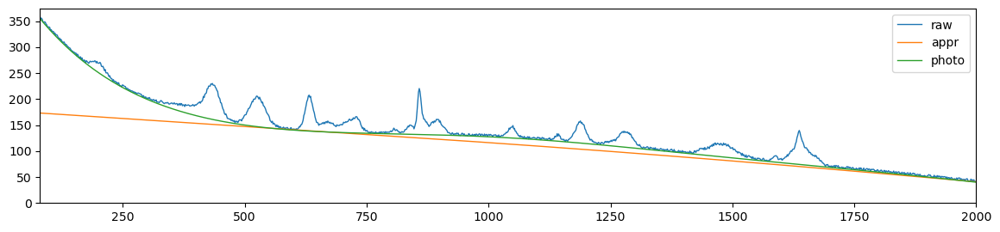

als_lambda: 3562247.890262444,	 als_p_weight: 0.00032903445623126676,	 error: 2044.8418372972073, 	 smoothness: 0.5266563907127897, 	 smoothness: -0.5636713694804374


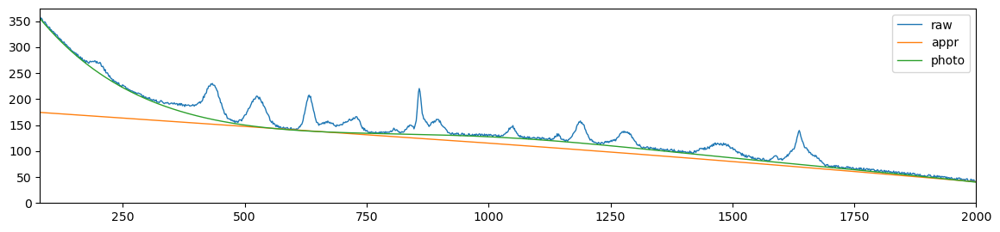

als_lambda: 3562247.890262444,	 als_p_weight: 0.0002395026619987486,	 error: 2151.686915847542, 	 smoothness: 0.5248291677536497, 	 smoothness: -0.5636758295740268


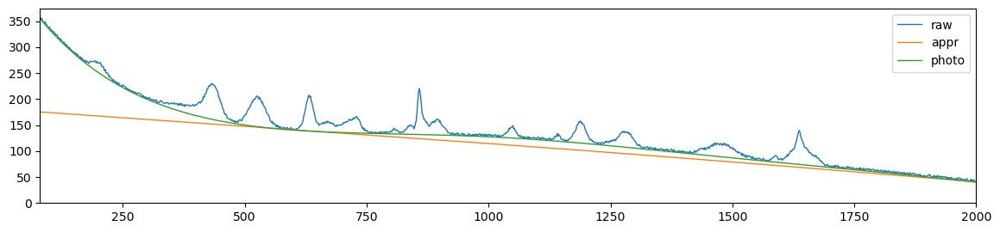

als_lambda: 3562247.890262444,	 als_p_weight: 0.00017433288221999874,	 error: 2230.1366541730677, 	 smoothness: 0.523586860155664, 	 smoothness: -0.5636275246900309


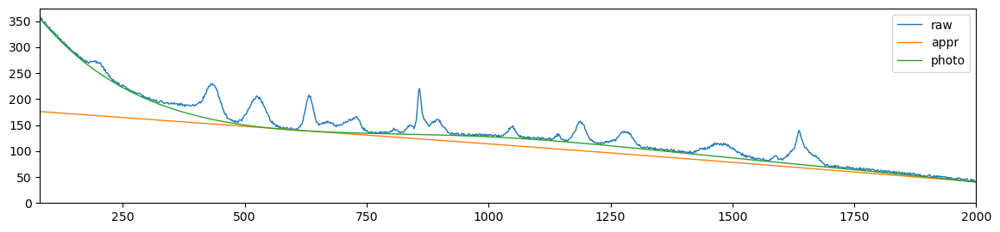

als_lambda: 3562247.890262444,	 als_p_weight: 0.0001268961003167922,	 error: 2287.0141174537853, 	 smoothness: 0.5227518703995934, 	 smoothness: -0.5635604848572499


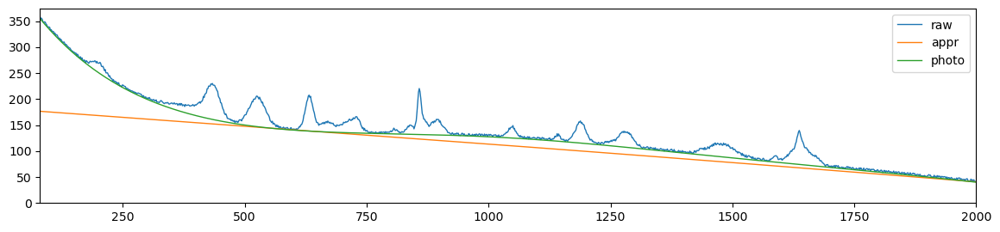

als_lambda: 3562247.890262444,	 als_p_weight: 9.236708571873866e-05,	 error: 2329.9935947493836, 	 smoothness: 0.5221883679241158, 	 smoothness: -0.5635206098895312


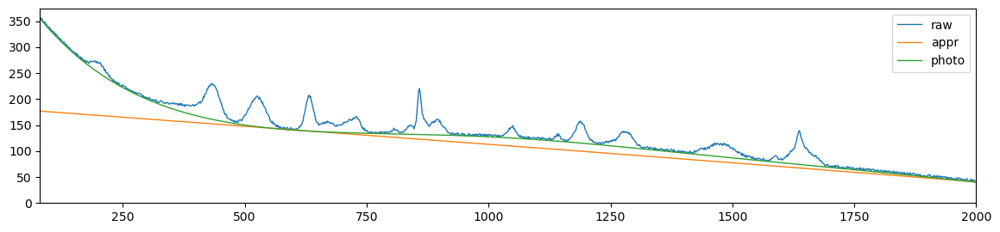

als_lambda: 3562247.890262444,	 als_p_weight: 6.723357536499335e-05,	 error: 2360.2058642846973, 	 smoothness: 0.5217692106544796, 	 smoothness: -0.5634497457643579


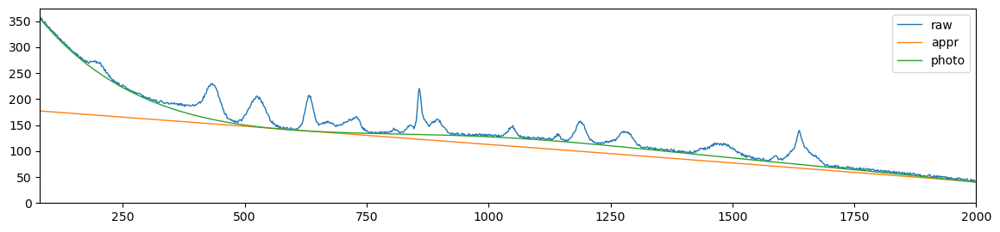

als_lambda: 3562247.890262444,	 als_p_weight: 4.893900918477499e-05,	 error: 2383.4342285683374, 	 smoothness: 0.5214871471263731, 	 smoothness: -0.5634239629650569


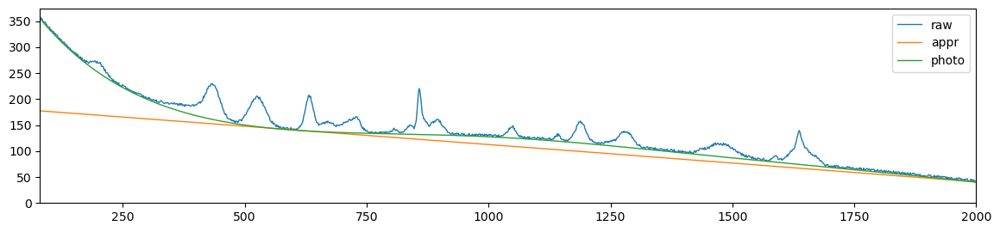

als_lambda: 3562247.890262444,	 als_p_weight: 3.5622478902624444e-05,	 error: 2400.938909420759, 	 smoothness: 0.5212879957327544, 	 smoothness: -0.5634118644458387


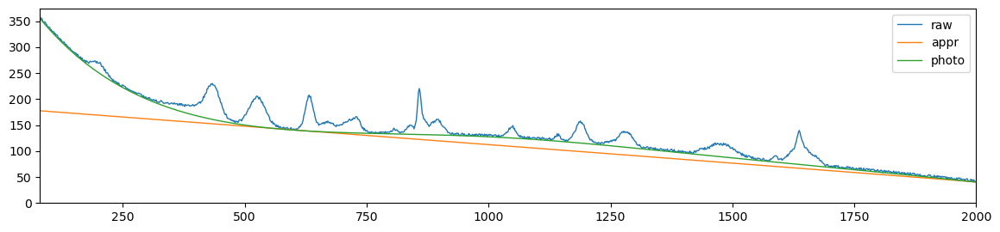

als_lambda: 3562247.890262444,	 als_p_weight: 2.592943797404667e-05,	 error: 2413.619540871746, 	 smoothness: 0.5211441120152854, 	 smoothness: -0.5633966114026684


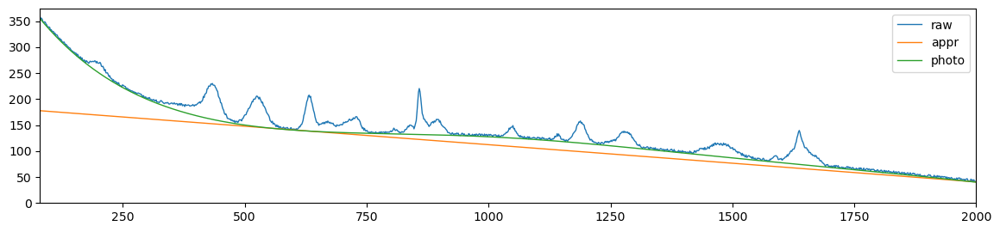

als_lambda: 3562247.890262444,	 als_p_weight: 1.8873918221350995e-05,	 error: 2422.9175930552583, 	 smoothness: 0.5210477374468916, 	 smoothness: -0.5633943525213669


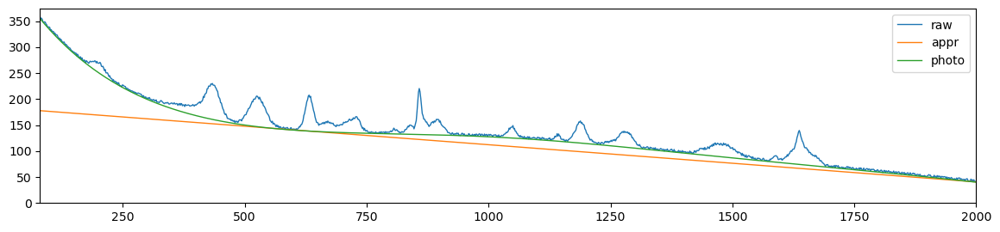

als_lambda: 3562247.890262444,	 als_p_weight: 1.3738237958832637e-05,	 error: 2429.665210567991, 	 smoothness: 0.5209698017166301, 	 smoothness: -0.5633852074149348


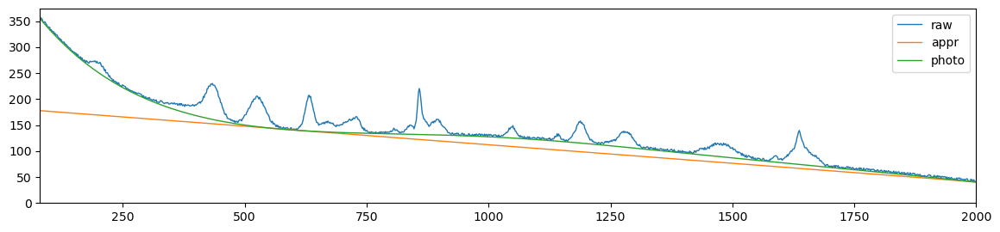

als_lambda: 3562247.890262444,	 als_p_weight: 1e-05,	 error: 2434.425734667188, 	 smoothness: 0.520909841421703, 	 smoothness: -0.5633736076216456


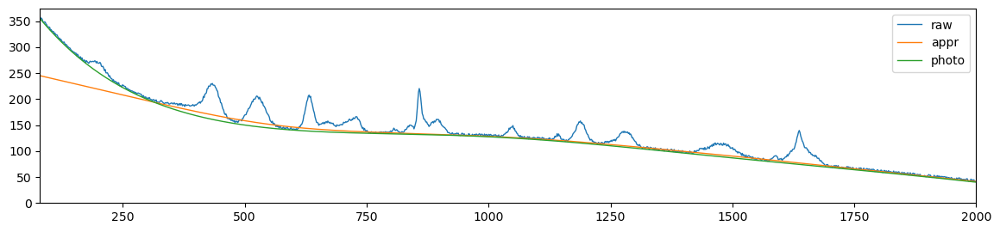

als_lambda: 6210169.418915616,	 als_p_weight: 0.1,	 error: 635.0724170772705, 	 smoothness: 0.5021824604747295, 	 smoothness: -0.5420646196754201


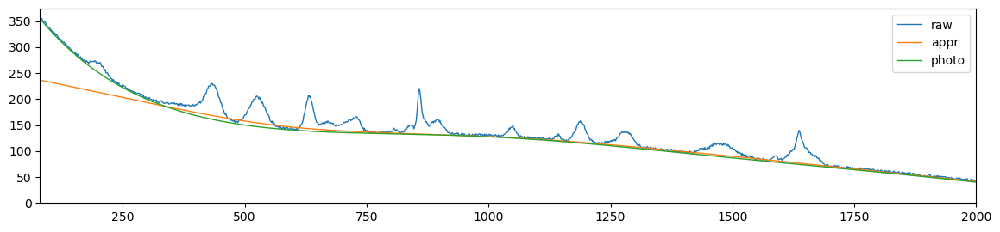

als_lambda: 6210169.418915616,	 als_p_weight: 0.0727895384398315,	 error: 682.6643020827221, 	 smoothness: 0.5090346221806655, 	 smoothness: -0.5439772094562875


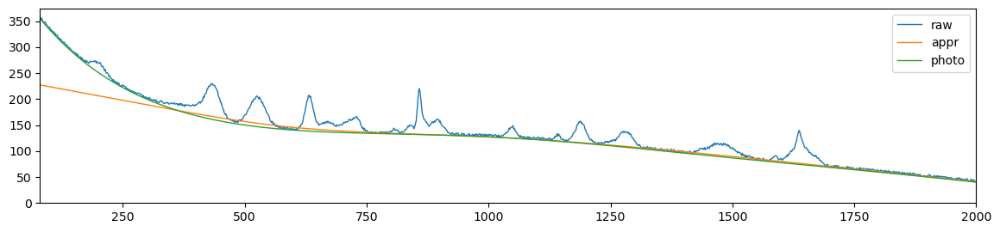

als_lambda: 6210169.418915616,	 als_p_weight: 0.05298316906283707,	 error: 744.4313736658697, 	 smoothness: 0.5162607908533063, 	 smoothness: -0.5463050667271997


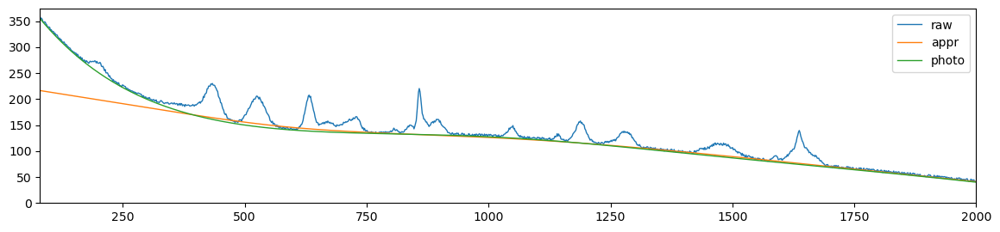

als_lambda: 6210169.418915616,	 als_p_weight: 0.03856620421163472,	 error: 814.5989797768624, 	 smoothness: 0.5230889024581907, 	 smoothness: -0.5479353922309107


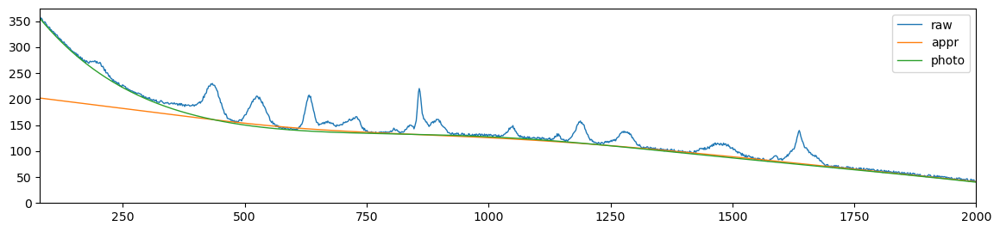

als_lambda: 6210169.418915616,	 als_p_weight: 0.02807216203941177,	 error: 874.134414861144, 	 smoothness: 0.5289213830656196, 	 smoothness: -0.549155285699645


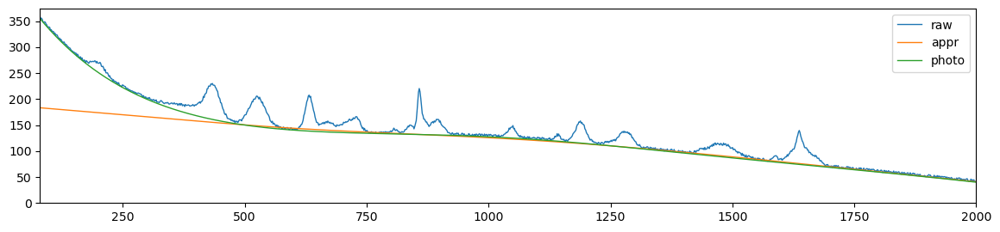

als_lambda: 6210169.418915616,	 als_p_weight: 0.020433597178569417,	 error: 934.3765765046004, 	 smoothness: 0.5342813766560526, 	 smoothness: -0.5502916425822293


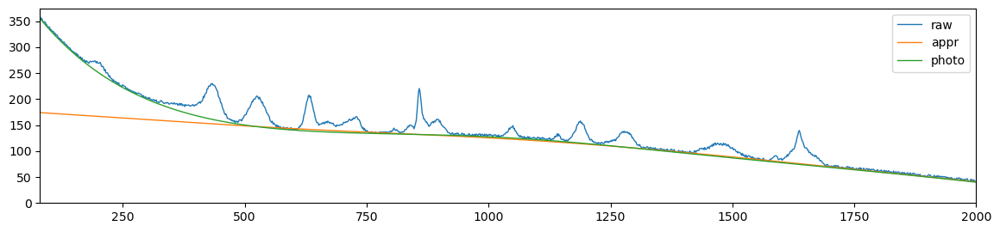

als_lambda: 6210169.418915616,	 als_p_weight: 0.014873521072935119,	 error: 984.343690924159, 	 smoothness: 0.5385666129592247, 	 smoothness: -0.5512181885661723


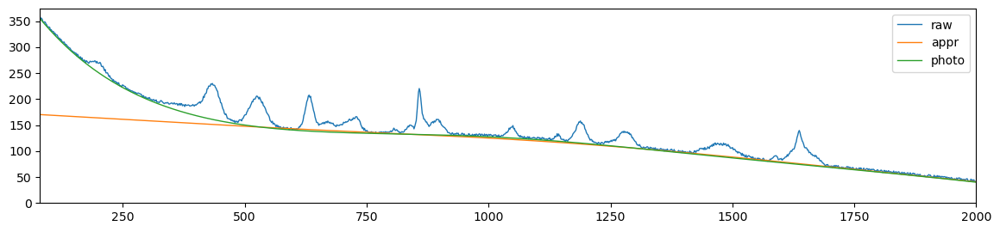

als_lambda: 6210169.418915616,	 als_p_weight: 0.010826367338740546,	 error: 1026.7426317365137, 	 smoothness: 0.5420196861584791, 	 smoothness: -0.552282839439241


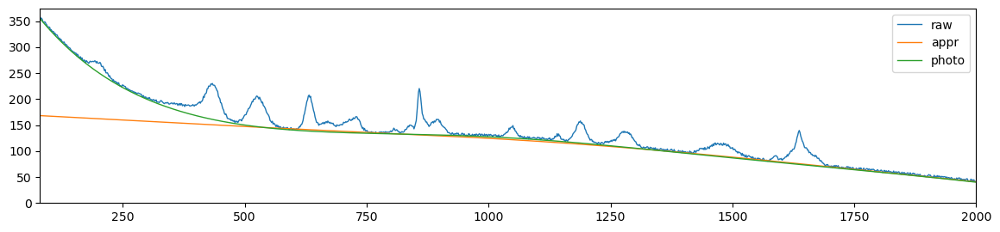

als_lambda: 6210169.418915616,	 als_p_weight: 0.007880462815669913,	 error: 1070.9957112160641, 	 smoothness: 0.5446280593708196, 	 smoothness: -0.5535888176009139


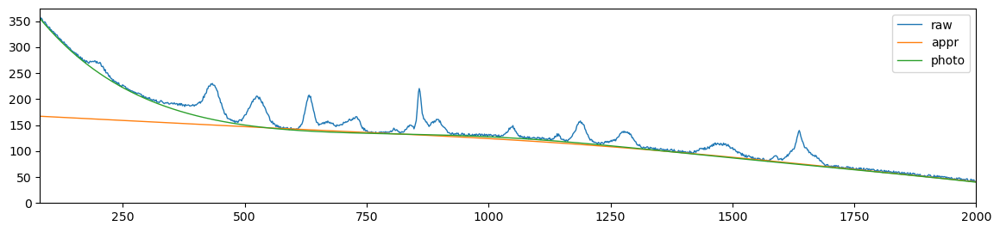

als_lambda: 6210169.418915616,	 als_p_weight: 0.005736152510448681,	 error: 1100.4505846797078, 	 smoothness: 0.5459128556340588, 	 smoothness: -0.5551076584515006


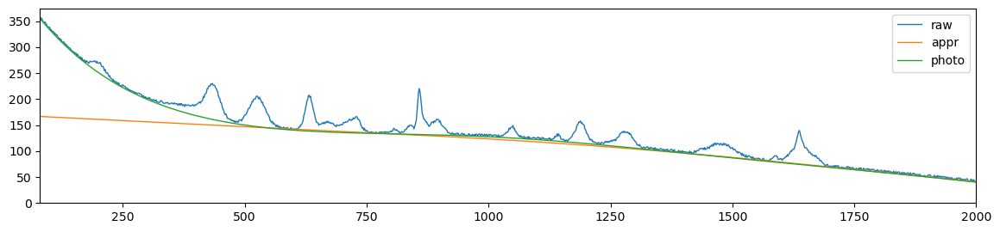

als_lambda: 6210169.418915616,	 als_p_weight: 0.0041753189365604,	 error: 1148.3120824869302, 	 smoothness: 0.5455041608302159, 	 smoothness: -0.5564211120154136


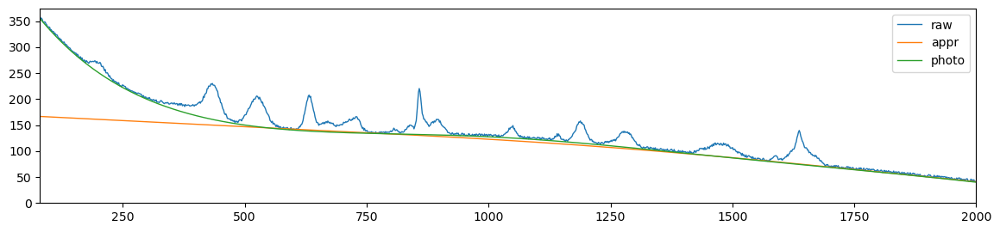

als_lambda: 6210169.418915616,	 als_p_weight: 0.0030391953823131978,	 error: 1196.1526221454012, 	 smoothness: 0.5445587491890147, 	 smoothness: -0.5580265562210577


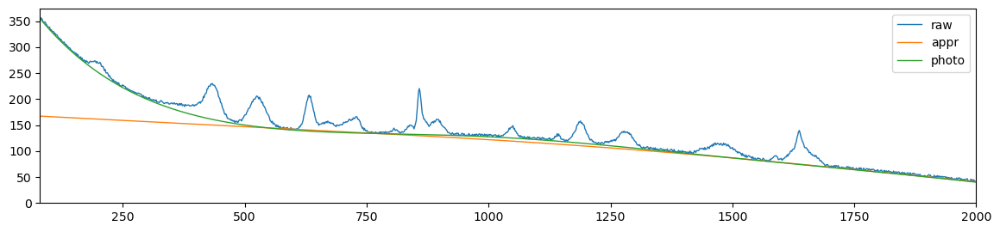

als_lambda: 6210169.418915616,	 als_p_weight: 0.00221221629107045,	 error: 1278.5984294758616, 	 smoothness: 0.5422751477174153, 	 smoothness: -0.5598372447831125


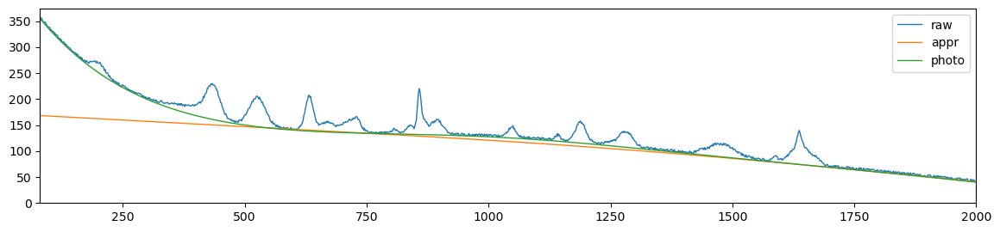

als_lambda: 6210169.418915616,	 als_p_weight: 0.0016102620275609393,	 error: 1441.7758742640642, 	 smoothness: 0.5384663024249323, 	 smoothness: -0.5615821757211957


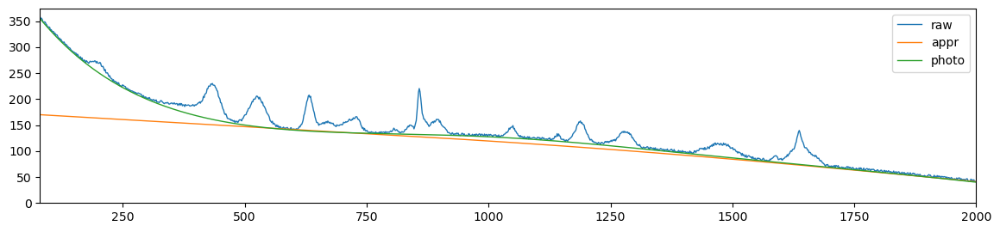

als_lambda: 6210169.418915616,	 als_p_weight: 0.0011721022975334804,	 error: 1642.9457048081772, 	 smoothness: 0.5339032780701423, 	 smoothness: -0.5628686177656489


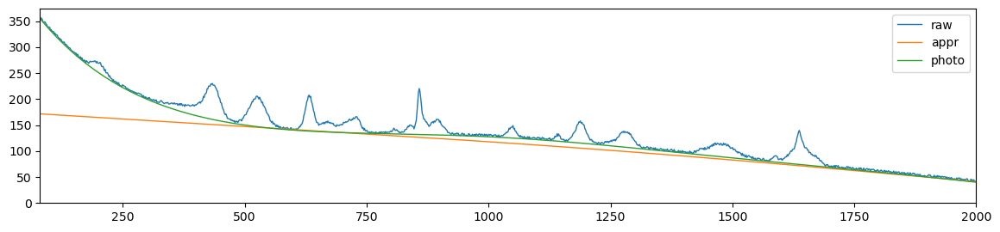

als_lambda: 6210169.418915616,	 als_p_weight: 0.0008531678524172806,	 error: 1839.118957289405, 	 smoothness: 0.5300694508416052, 	 smoothness: -0.5634780109930465


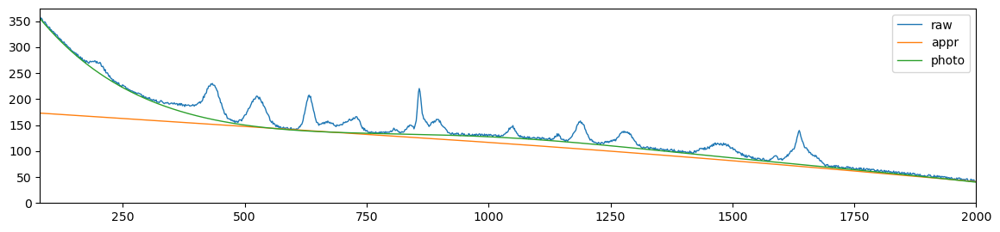

als_lambda: 6210169.418915616,	 als_p_weight: 0.0006210169418915617,	 error: 1990.812804276345, 	 smoothness: 0.5272748449513821, 	 smoothness: -0.5636816560323739


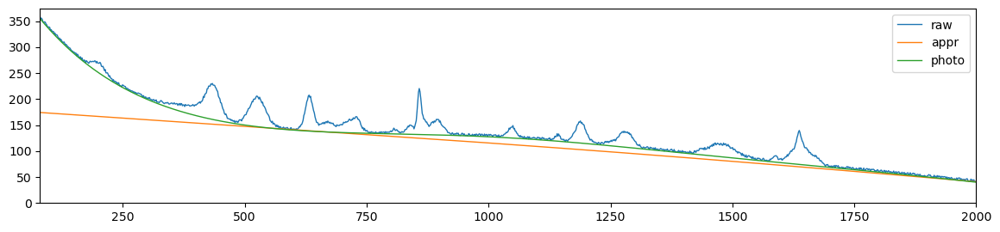

als_lambda: 6210169.418915616,	 als_p_weight: 0.00045203536563602454,	 error: 2108.070543483749, 	 smoothness: 0.5252660101978354, 	 smoothness: -0.5637058249576519


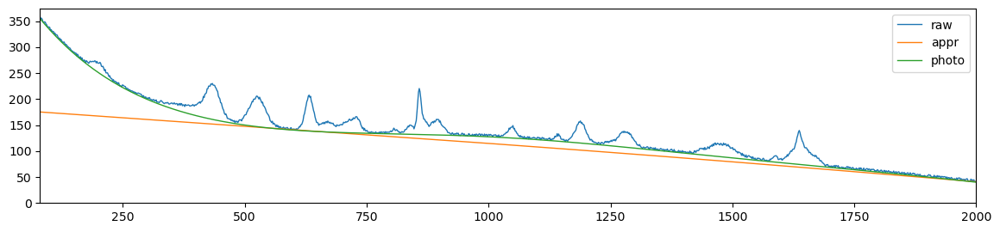

als_lambda: 6210169.418915616,	 als_p_weight: 0.00032903445623126676,	 error: 2195.3058261546603, 	 smoothness: 0.5238993066108413, 	 smoothness: -0.563662246842343


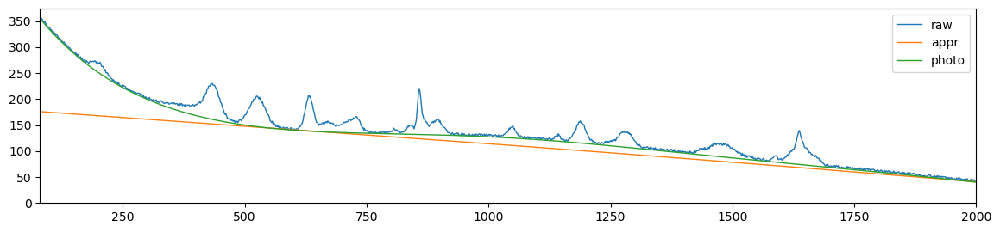

als_lambda: 6210169.418915616,	 als_p_weight: 0.0002395026619987486,	 error: 2260.1500353182305, 	 smoothness: 0.5229650915654682, 	 smoothness: -0.563597704302913


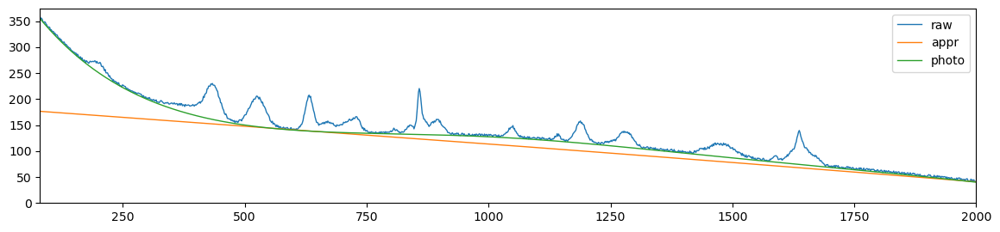

als_lambda: 6210169.418915616,	 als_p_weight: 0.00017433288221999874,	 error: 2308.382565604452, 	 smoothness: 0.522326827333002, 	 smoothness: -0.563536958510841


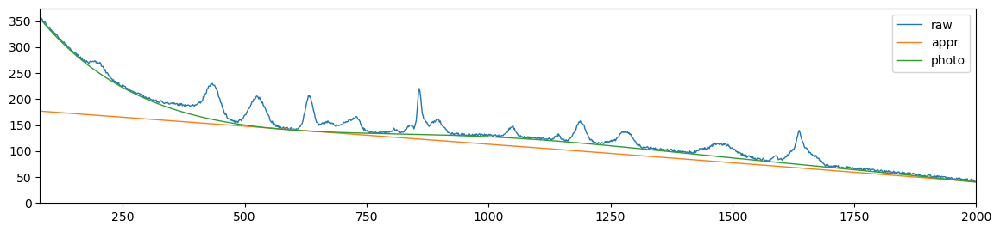

als_lambda: 6210169.418915616,	 als_p_weight: 0.0001268961003167922,	 error: 2344.5573675507762, 	 smoothness: 0.5218805685705936, 	 smoothness: -0.5634899232328519


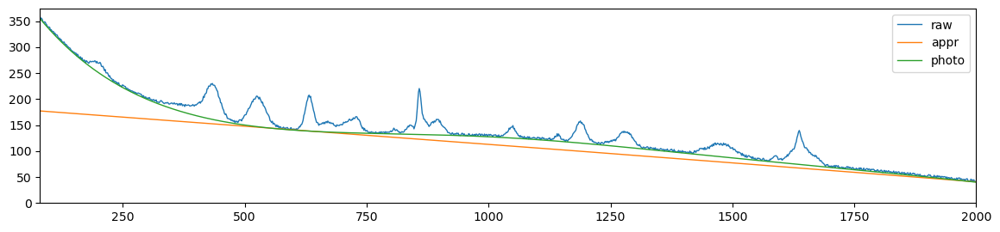

als_lambda: 6210169.418915616,	 als_p_weight: 9.236708571873866e-05,	 error: 2371.046658784737, 	 smoothness: 0.5215643586115867, 	 smoothness: -0.5634419519379202


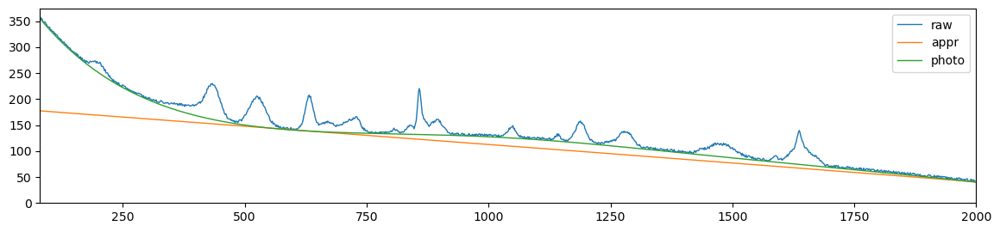

als_lambda: 6210169.418915616,	 als_p_weight: 6.723357536499335e-05,	 error: 2391.1873124992494, 	 smoothness: 0.5213388818606061, 	 smoothness: -0.5634189443307362


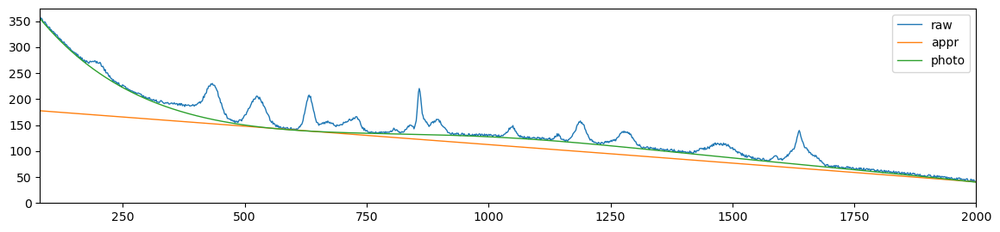

als_lambda: 6210169.418915616,	 als_p_weight: 4.893900918477499e-05,	 error: 2405.957670673895, 	 smoothness: 0.5211759637507647, 	 smoothness: -0.5633977906437753


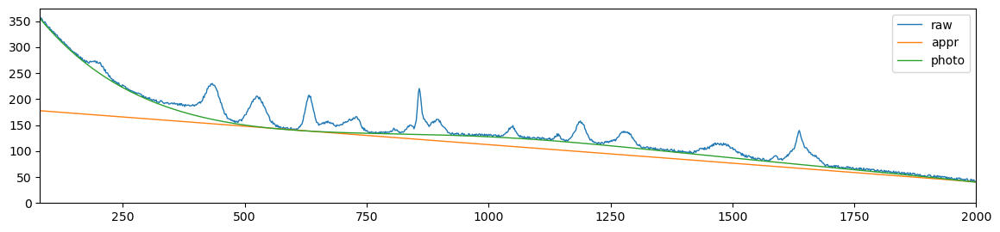

als_lambda: 6210169.418915616,	 als_p_weight: 3.5622478902624444e-05,	 error: 2417.1923867109917, 	 smoothness: 0.5210621574555616, 	 smoothness: -0.5633875237042512


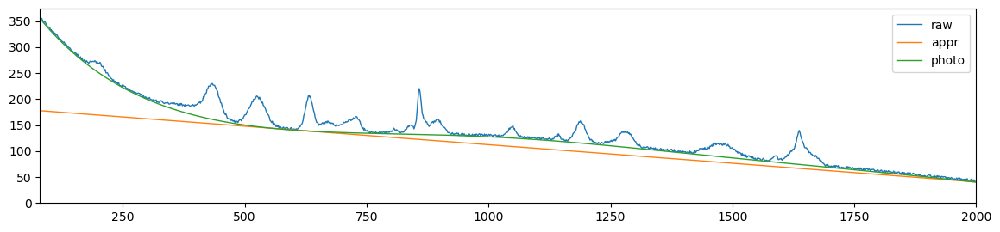

als_lambda: 6210169.418915616,	 als_p_weight: 2.592943797404667e-05,	 error: 2425.3344398707577, 	 smoothness: 0.5209785852641953, 	 smoothness: -0.563376775543892


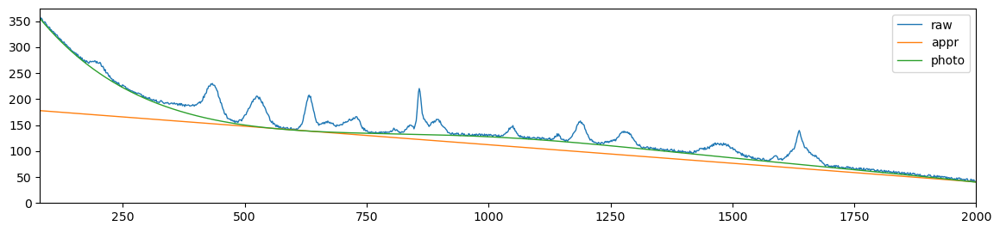

als_lambda: 6210169.418915616,	 als_p_weight: 1.8873918221350995e-05,	 error: 2431.394774134343, 	 smoothness: 0.5209191975512083, 	 smoothness: -0.5633709400469377


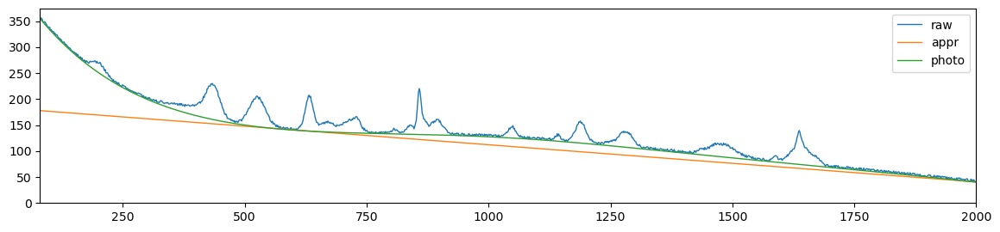

als_lambda: 6210169.418915616,	 als_p_weight: 1.3738237958832637e-05,	 error: 2435.765568740657, 	 smoothness: 0.5208754346283446, 	 smoothness: -0.5633653016006486


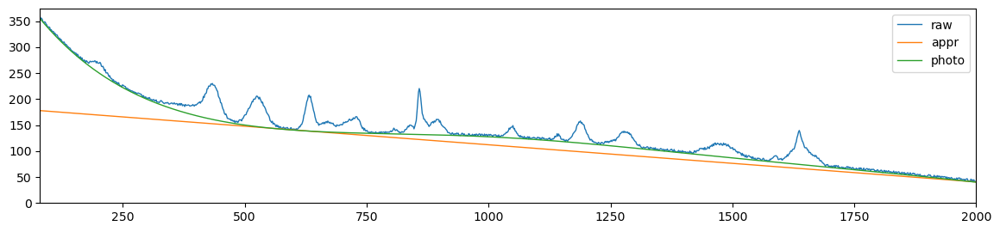

als_lambda: 6210169.418915616,	 als_p_weight: 1e-05,	 error: 2438.9501469257684, 	 smoothness: 0.5208433603765485, 	 smoothness: -0.5633604855567481


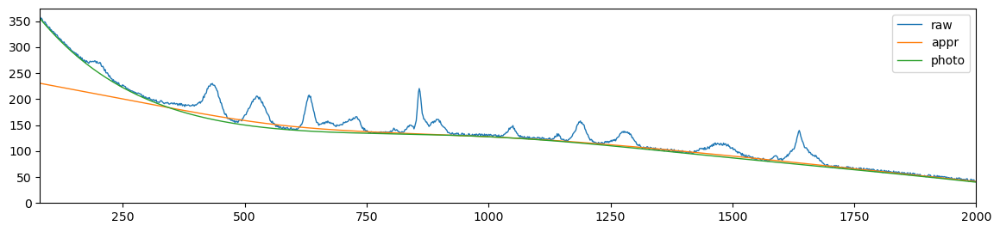

als_lambda: 10826367.33874054,	 als_p_weight: 0.1,	 error: 717.0305197945946, 	 smoothness: 0.5146976959316658, 	 smoothness: -0.5458398059634417


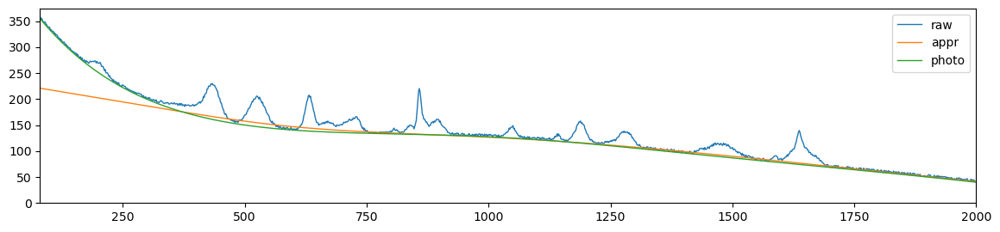

als_lambda: 10826367.33874054,	 als_p_weight: 0.0727895384398315,	 error: 790.2542692500508, 	 smoothness: 0.5218827041299324, 	 smoothness: -0.5478583290963984


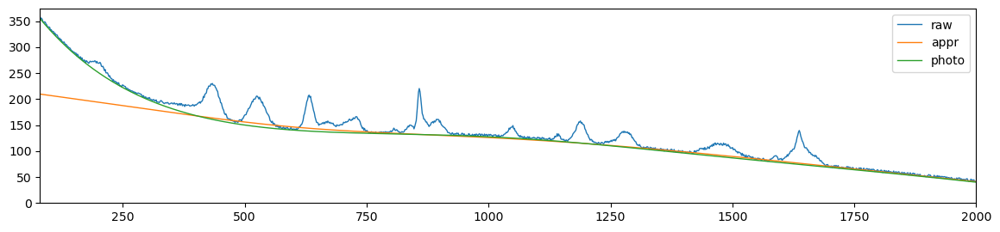

als_lambda: 10826367.33874054,	 als_p_weight: 0.05298316906283707,	 error: 849.4563413375129, 	 smoothness: 0.5277346681315086, 	 smoothness: -0.5491037091186535


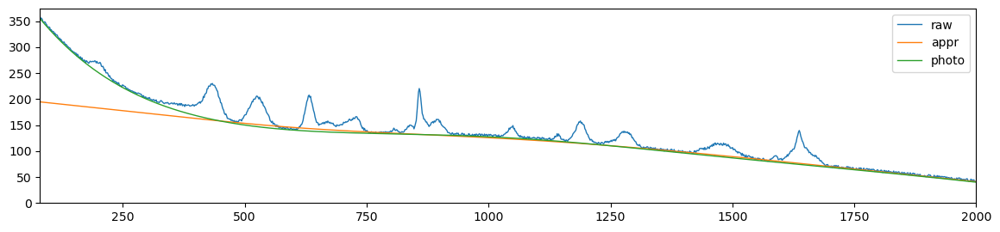

als_lambda: 10826367.33874054,	 als_p_weight: 0.03856620421163472,	 error: 906.7363528176575, 	 smoothness: 0.5330597323112398, 	 smoothness: -0.5502837156119401


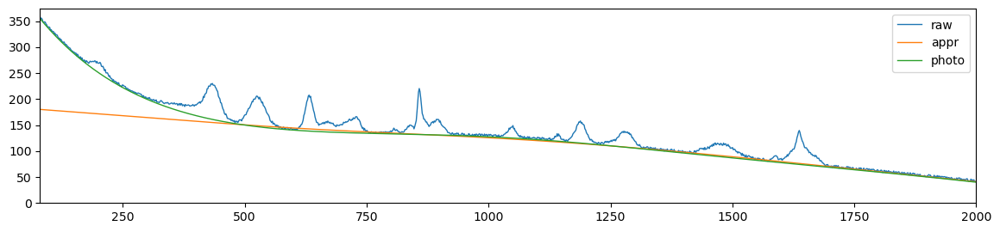

als_lambda: 10826367.33874054,	 als_p_weight: 0.02807216203941177,	 error: 959.9286648036039, 	 smoothness: 0.5376292828385011, 	 smoothness: -0.5512633876266593


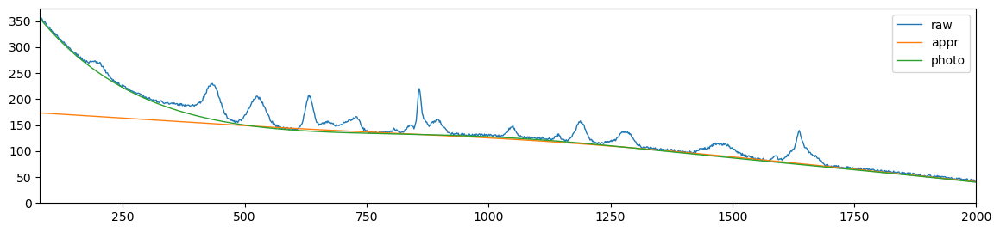

als_lambda: 10826367.33874054,	 als_p_weight: 0.020433597178569417,	 error: 1003.8894281300705, 	 smoothness: 0.5412775534504081, 	 smoothness: -0.552275168659478


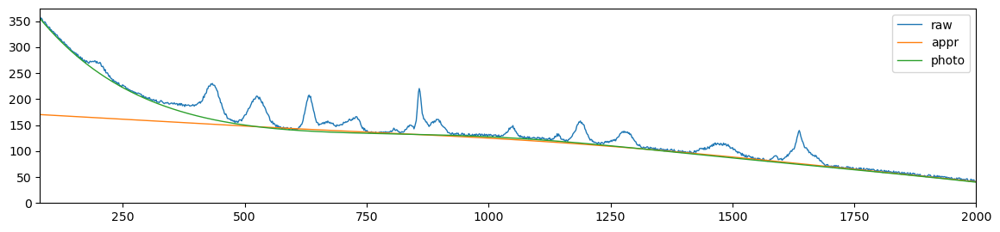

als_lambda: 10826367.33874054,	 als_p_weight: 0.014873521072935119,	 error: 1047.3353029538216, 	 smoothness: 0.544062145768403, 	 smoothness: -0.5534893777599081


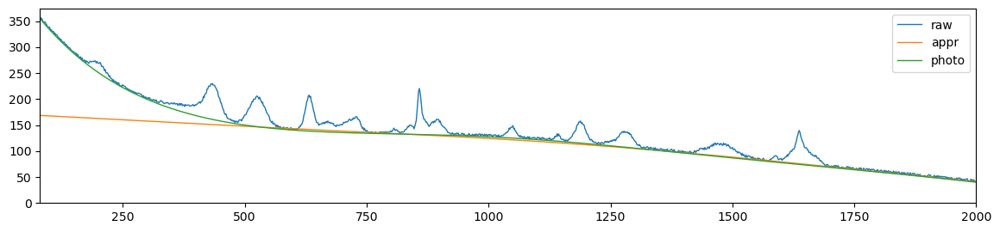

als_lambda: 10826367.33874054,	 als_p_weight: 0.010826367338740546,	 error: 1078.4890796692264, 	 smoothness: 0.5457190117031856, 	 smoothness: -0.5549100193425686


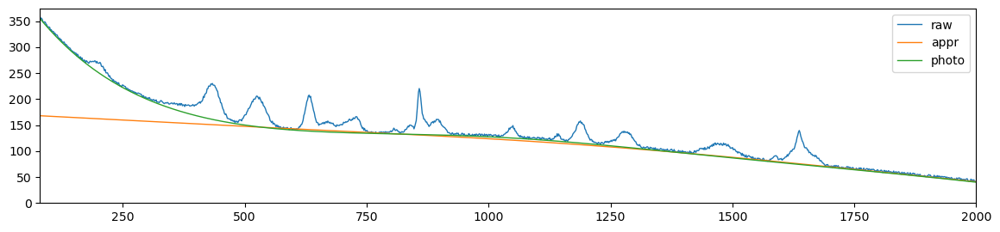

als_lambda: 10826367.33874054,	 als_p_weight: 0.007880462815669913,	 error: 1117.7106399769746, 	 smoothness: 0.5455659934940463, 	 smoothness: -0.5562966590046085


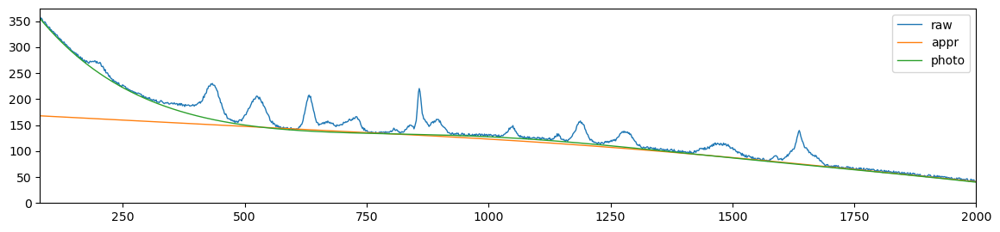

als_lambda: 10826367.33874054,	 als_p_weight: 0.005736152510448681,	 error: 1164.235123548829, 	 smoothness: 0.544851134605382, 	 smoothness: -0.5577627139551015


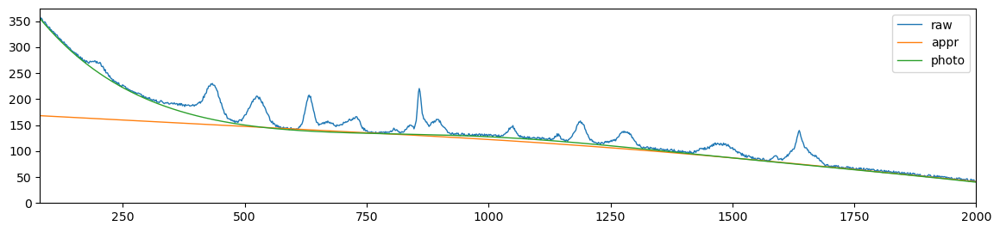

als_lambda: 10826367.33874054,	 als_p_weight: 0.0041753189365604,	 error: 1231.1467988307963, 	 smoothness: 0.5428814786494145, 	 smoothness: -0.5594902454760338


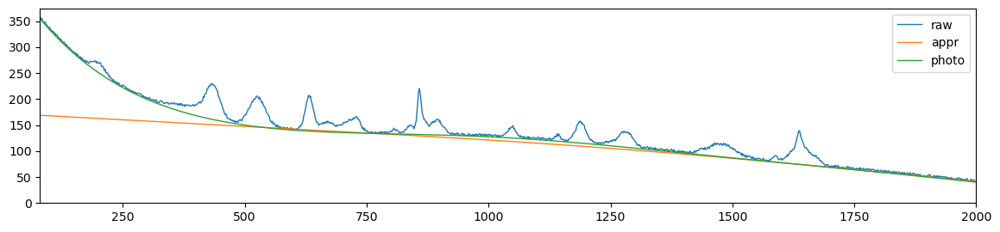

als_lambda: 10826367.33874054,	 als_p_weight: 0.0030391953823131978,	 error: 1369.988700688746, 	 smoothness: 0.5394126053660915, 	 smoothness: -0.5612845970258199


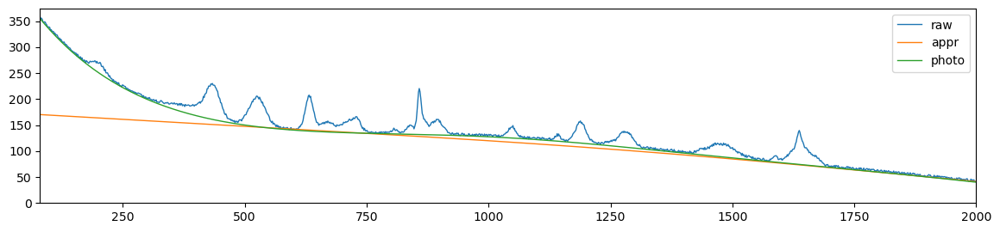

als_lambda: 10826367.33874054,	 als_p_weight: 0.00221221629107045,	 error: 1561.7726252341154, 	 smoothness: 0.5350224152275834, 	 smoothness: -0.5626545535641163


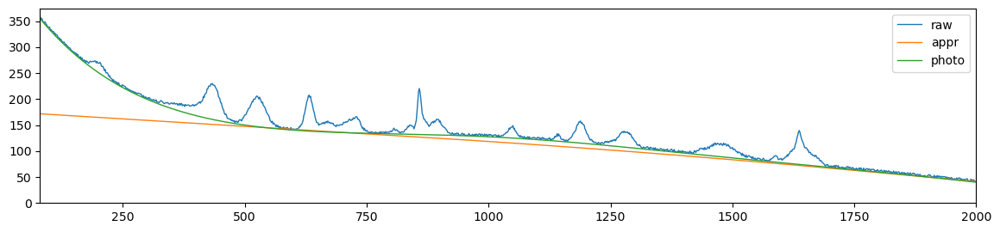

als_lambda: 10826367.33874054,	 als_p_weight: 0.0016102620275609393,	 error: 1763.742059460552, 	 smoothness: 0.5309463937892817, 	 smoothness: -0.563422702465335


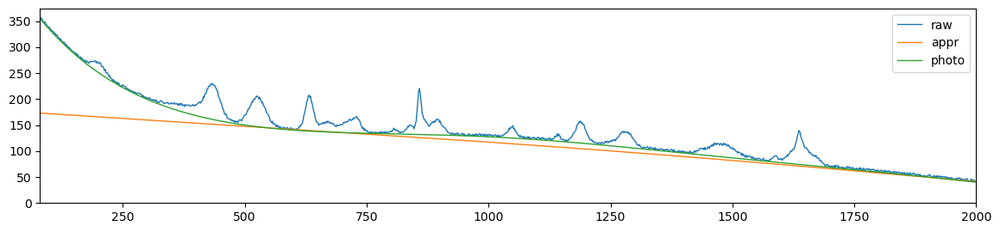

als_lambda: 10826367.33874054,	 als_p_weight: 0.0011721022975334804,	 error: 1927.5438888665622, 	 smoothness: 0.5279292659660132, 	 smoothness: -0.5636941643192674


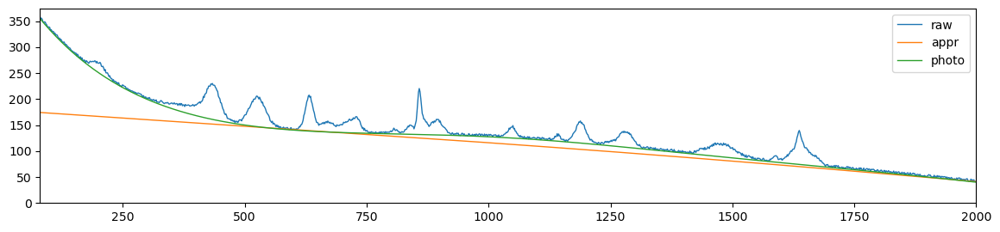

als_lambda: 10826367.33874054,	 als_p_weight: 0.0008531678524172806,	 error: 2055.1085405963577, 	 smoothness: 0.5257569284269099, 	 smoothness: -0.5637455851102665


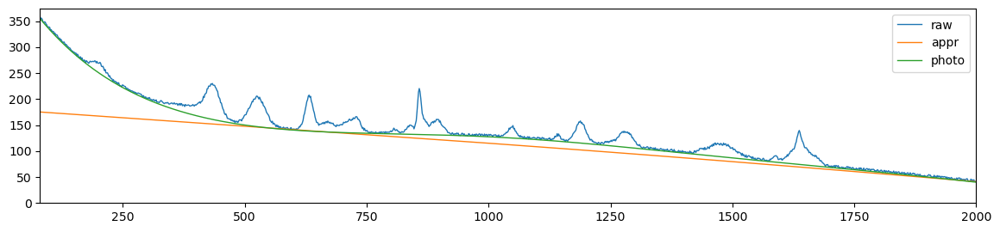

als_lambda: 10826367.33874054,	 als_p_weight: 0.0006210169418915617,	 error: 2152.2760988911973, 	 smoothness: 0.5242538248477944, 	 smoothness: -0.5637074558360847


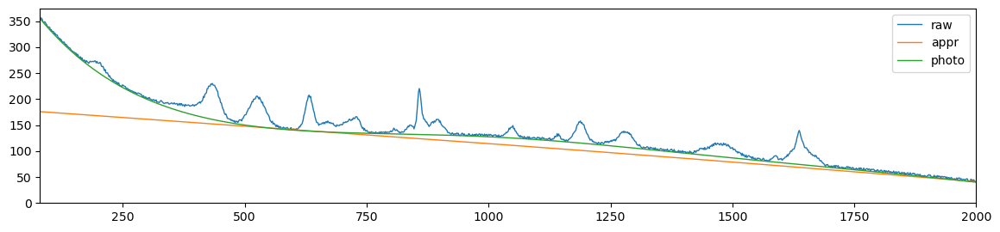

als_lambda: 10826367.33874054,	 als_p_weight: 0.00045203536563602454,	 error: 2225.425661355761, 	 smoothness: 0.5232151433292553, 	 smoothness: -0.5636409420076488


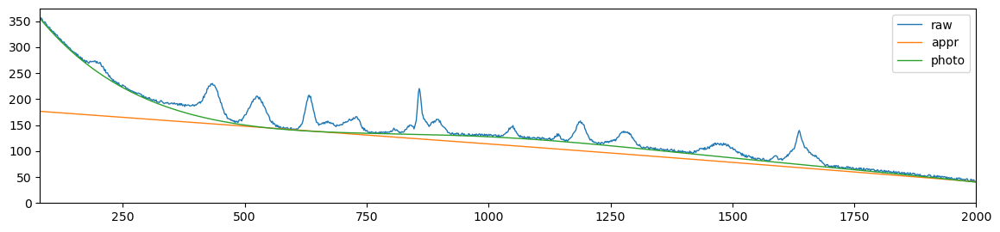

als_lambda: 10826367.33874054,	 als_p_weight: 0.00032903445623126676,	 error: 2280.2168582613313, 	 smoothness: 0.5224997696333894, 	 smoothness: -0.5635734951650877


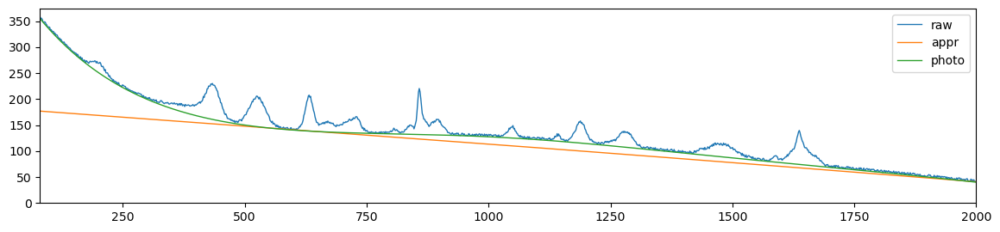

als_lambda: 10826367.33874054,	 als_p_weight: 0.0002395026619987486,	 error: 2321.577353974439, 	 smoothness: 0.522002717061372, 	 smoothness: -0.5635140979954761


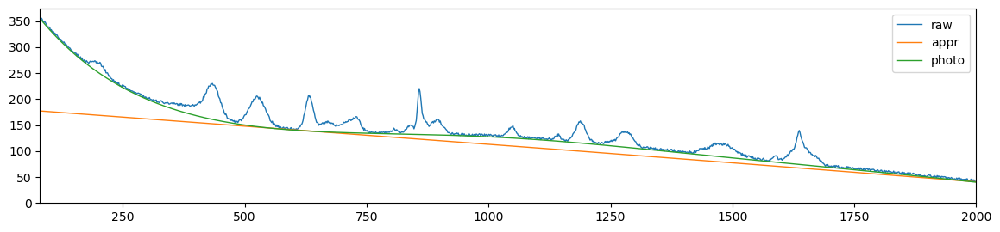

als_lambda: 10826367.33874054,	 als_p_weight: 0.00017433288221999874,	 error: 2353.208536020861, 	 smoothness: 0.5216483936044507, 	 smoothness: -0.563467387457401


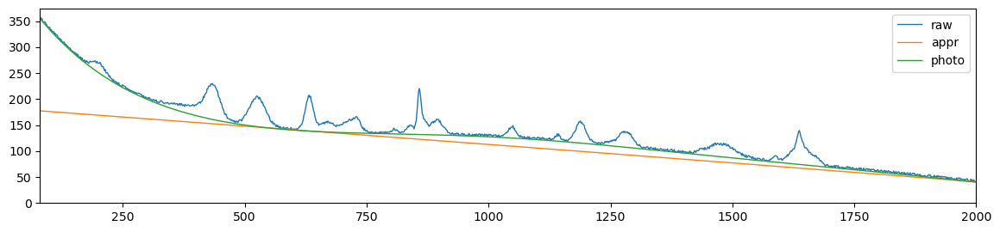

als_lambda: 10826367.33874054,	 als_p_weight: 0.0001268961003167922,	 error: 2376.9905350664217, 	 smoothness: 0.5213984680213334, 	 smoothness: -0.5634340161233197


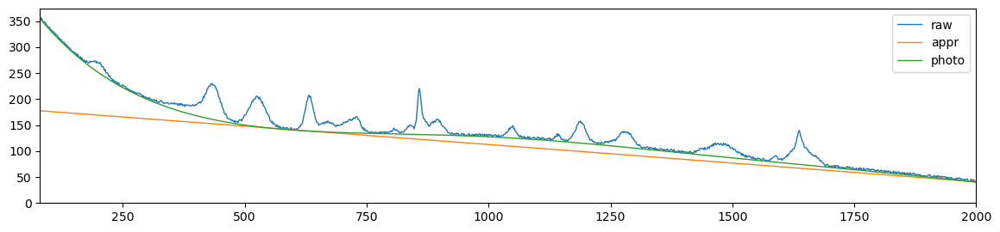

als_lambda: 10826367.33874054,	 als_p_weight: 9.236708571873866e-05,	 error: 2394.965134762051, 	 smoothness: 0.5212192289368064, 	 smoothness: -0.563409861502378


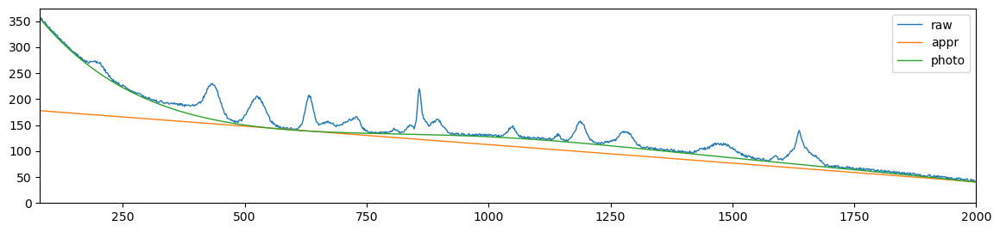

als_lambda: 10826367.33874054,	 als_p_weight: 6.723357536499335e-05,	 error: 2408.504162479465, 	 smoothness: 0.5210908660370296, 	 smoothness: -0.56339229597484


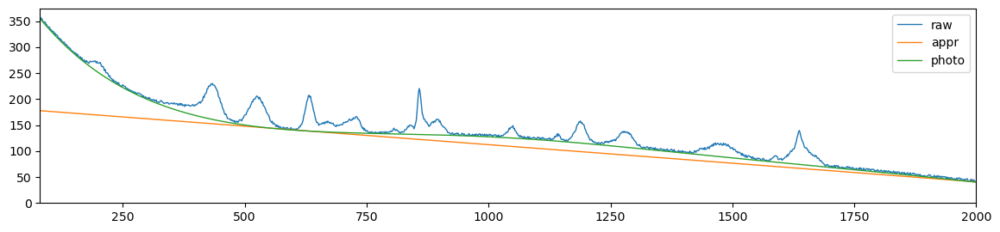

als_lambda: 10826367.33874054,	 als_p_weight: 4.893900918477499e-05,	 error: 2418.650335170459, 	 smoothness: 0.5209988408139234, 	 smoothness: -0.5633799625441172


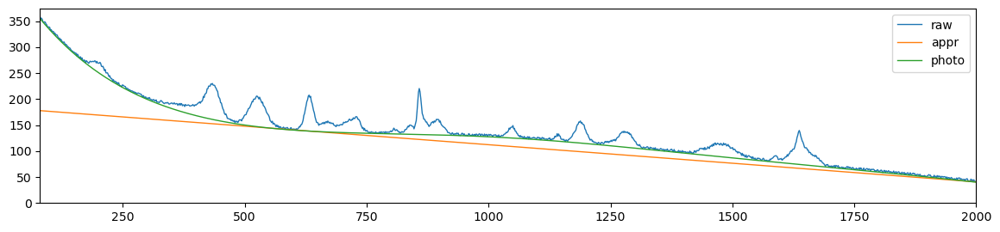

als_lambda: 10826367.33874054,	 als_p_weight: 3.5622478902624444e-05,	 error: 2426.252645106765, 	 smoothness: 0.5209322824057766, 	 smoothness: -0.5633710151122979


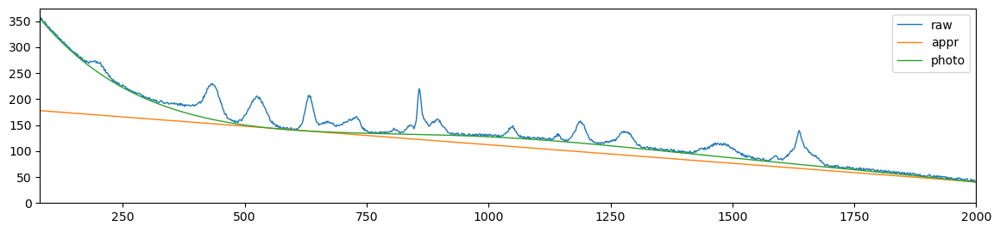

als_lambda: 10826367.33874054,	 als_p_weight: 2.592943797404667e-05,	 error: 2431.906336031366, 	 smoothness: 0.5208848203547368, 	 smoothness: -0.5633649343905777


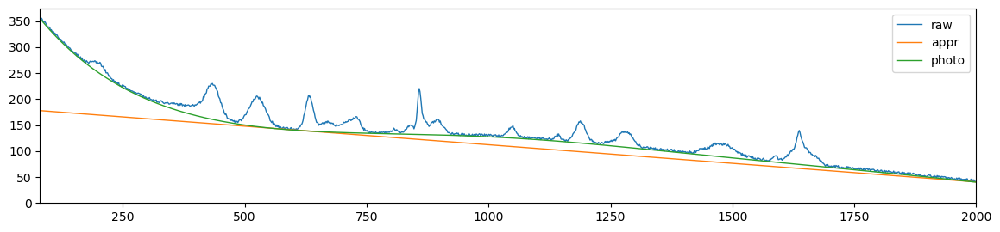

als_lambda: 10826367.33874054,	 als_p_weight: 1.8873918221350995e-05,	 error: 2436.086694522306, 	 smoothness: 0.5208505872361245, 	 smoothness: -0.5633607419335565


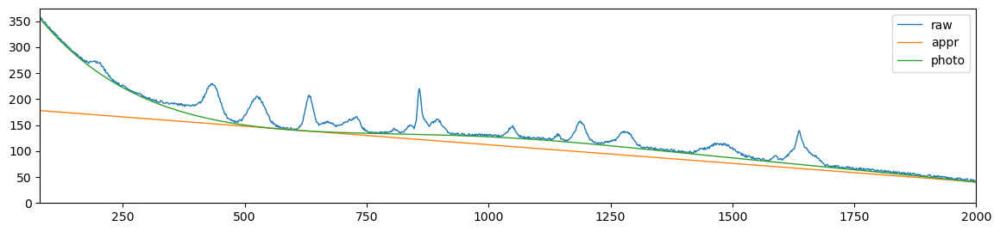

als_lambda: 10826367.33874054,	 als_p_weight: 1.3738237958832637e-05,	 error: 2439.139678507852, 	 smoothness: 0.5208257135077624, 	 smoothness: -0.5633576178241324


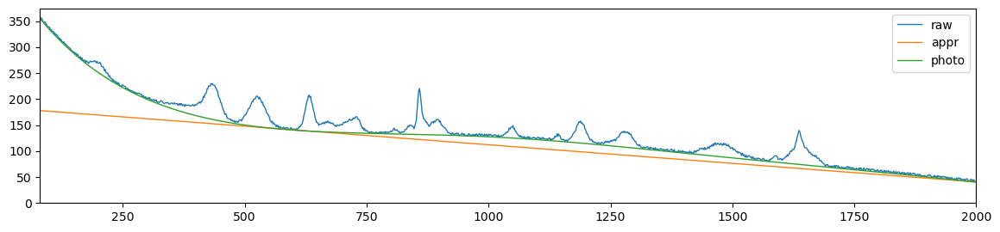

als_lambda: 10826367.33874054,	 als_p_weight: 1e-05,	 error: 2440.311445081615, 	 smoothness: 0.520816745947726, 	 smoothness: -0.5633657403005242


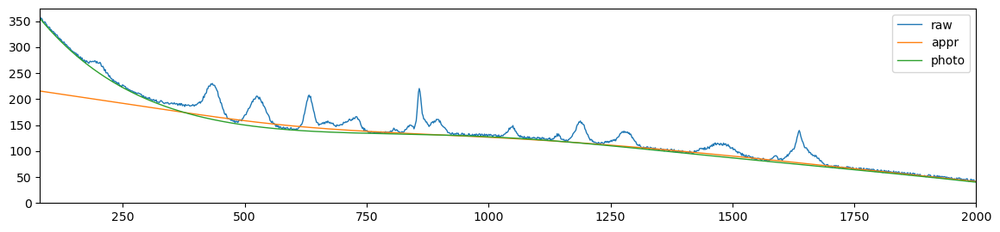

als_lambda: 18873918.221350998,	 als_p_weight: 0.1,	 error: 824.1729179392723, 	 smoothness: 0.5266766665465981, 	 smoothness: -0.5491517716819443


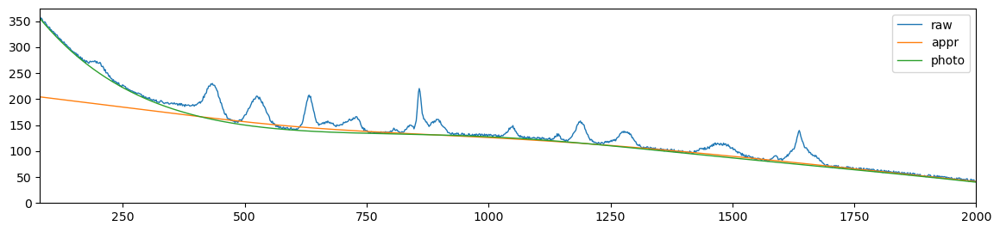

als_lambda: 18873918.221350998,	 als_p_weight: 0.0727895384398315,	 error: 878.3061424162129, 	 smoothness: 0.531899762246862, 	 smoothness: -0.550312774531137


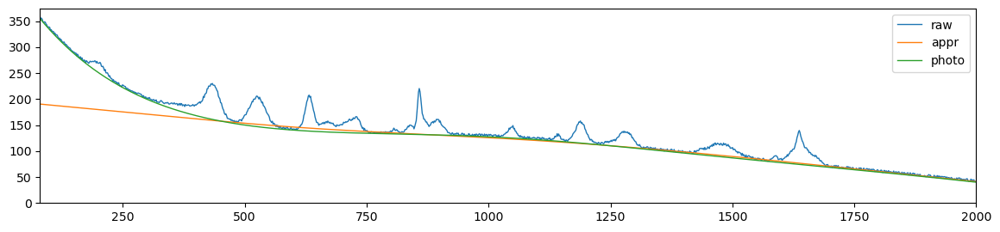

als_lambda: 18873918.221350998,	 als_p_weight: 0.05298316906283707,	 error: 931.7496277104952, 	 smoothness: 0.5366029830655533, 	 smoothness: -0.5513803560626507


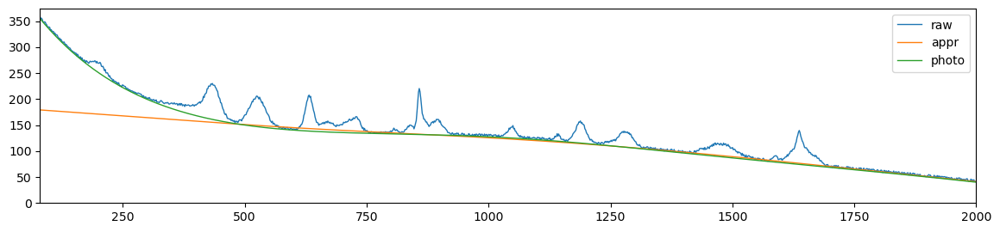

als_lambda: 18873918.221350998,	 als_p_weight: 0.03856620421163472,	 error: 977.4477031594569, 	 smoothness: 0.540439664014808, 	 smoothness: -0.5523789485123388


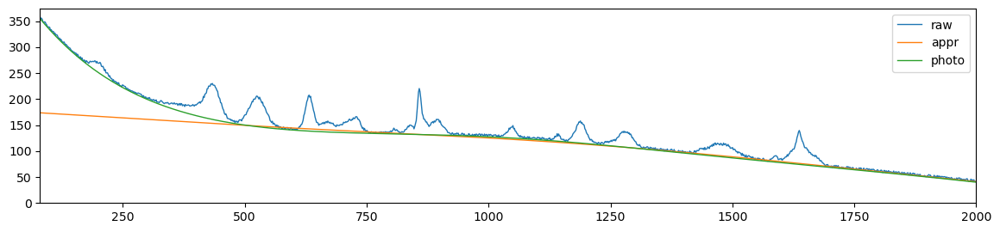

als_lambda: 18873918.221350998,	 als_p_weight: 0.02807216203941177,	 error: 1015.3946570017526, 	 smoothness: 0.5433979287359361, 	 smoothness: -0.553518251632071


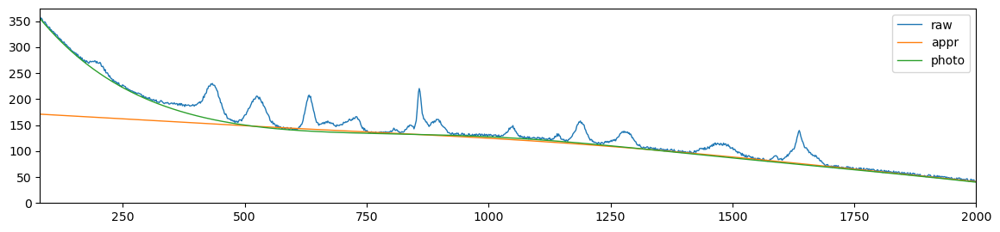

als_lambda: 18873918.221350998,	 als_p_weight: 0.020433597178569417,	 error: 1052.399519624053, 	 smoothness: 0.545326684170186, 	 smoothness: -0.5548140630131172


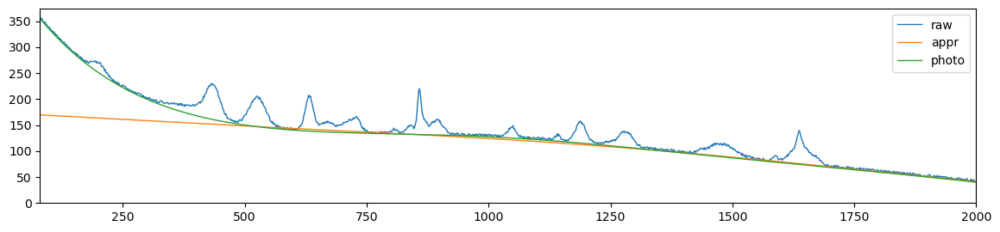

als_lambda: 18873918.221350998,	 als_p_weight: 0.014873521072935119,	 error: 1081.5316753730133, 	 smoothness: 0.5455701828041648, 	 smoothness: -0.5562722082085654


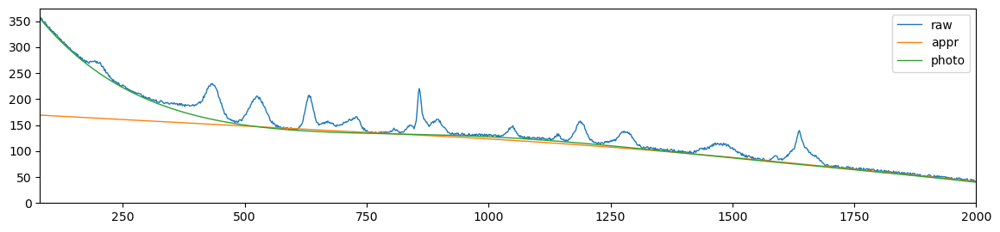

als_lambda: 18873918.221350998,	 als_p_weight: 0.010826367338740546,	 error: 1130.8421063039941, 	 smoothness: 0.5449803196299695, 	 smoothness: -0.5575781611906132


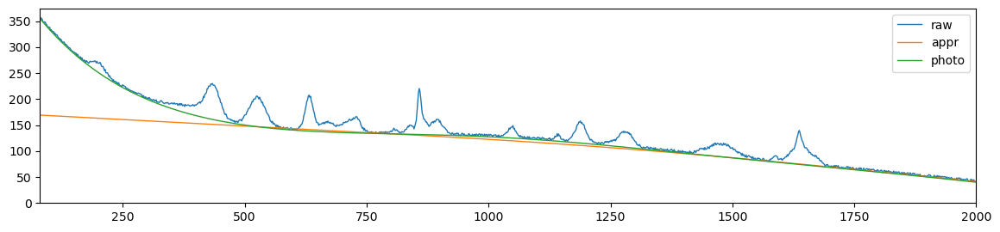

als_lambda: 18873918.221350998,	 als_p_weight: 0.007880462815669913,	 error: 1186.2191030329654, 	 smoothness: 0.5433606458742163, 	 smoothness: -0.5592076763300647


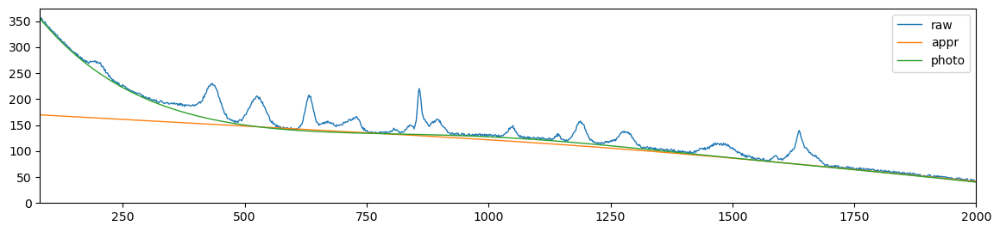

als_lambda: 18873918.221350998,	 als_p_weight: 0.005736152510448681,	 error: 1295.191396924119, 	 smoothness: 0.5402813964692085, 	 smoothness: -0.5609876231175572


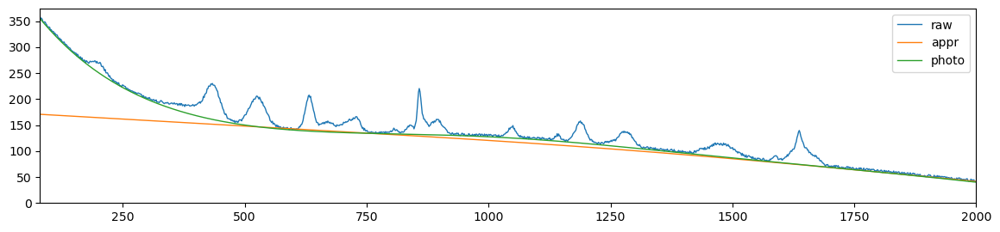

als_lambda: 18873918.221350998,	 als_p_weight: 0.0041753189365604,	 error: 1476.5829504629605, 	 smoothness: 0.5361390066785563, 	 smoothness: -0.5624257802141954


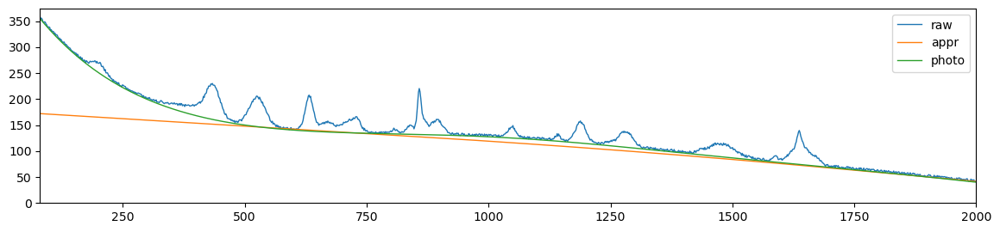

als_lambda: 18873918.221350998,	 als_p_weight: 0.0030391953823131978,	 error: 1679.426108856874, 	 smoothness: 0.5319038405633205, 	 smoothness: -0.5633484638305715


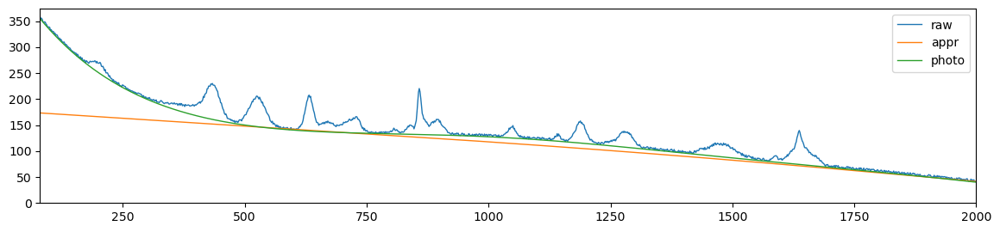

als_lambda: 18873918.221350998,	 als_p_weight: 0.00221221629107045,	 error: 1854.4607352200514, 	 smoothness: 0.5286379214516996, 	 smoothness: -0.5637048485948492


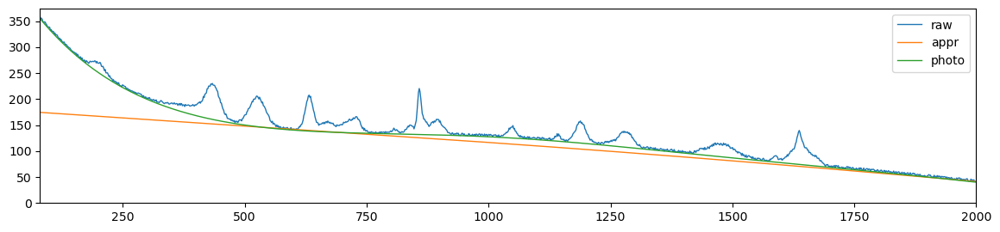

als_lambda: 18873918.221350998,	 als_p_weight: 0.0016102620275609393,	 error: 1992.1574582764608, 	 smoothness: 0.5262917144315518, 	 smoothness: -0.5637890297013517


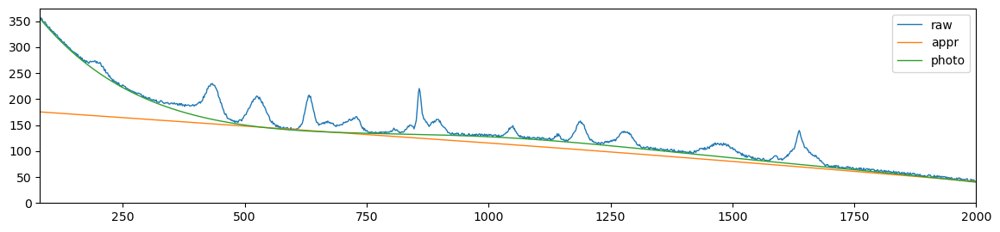

als_lambda: 18873918.221350998,	 als_p_weight: 0.0011721022975334804,	 error: 2099.5707955811226, 	 smoothness: 0.5246419972412943, 	 smoothness: -0.5637614386514912


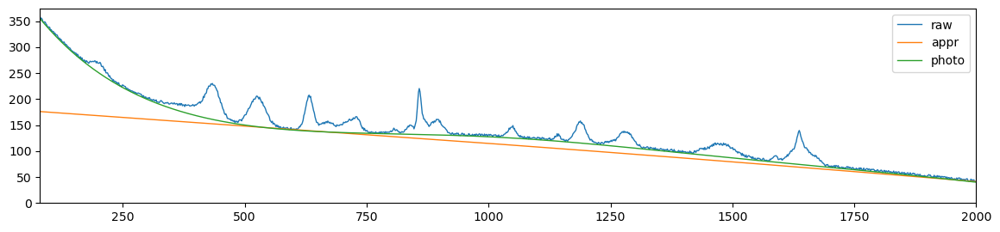

als_lambda: 18873918.221350998,	 als_p_weight: 0.0008531678524172806,	 error: 2181.8080549129177, 	 smoothness: 0.5234996297524871, 	 smoothness: -0.5636949449328841


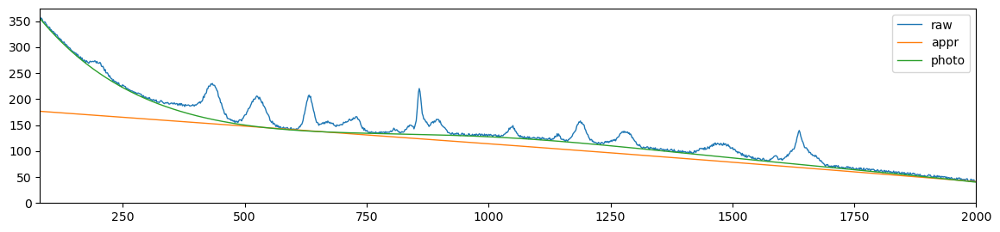

als_lambda: 18873918.221350998,	 als_p_weight: 0.0006210169418915617,	 error: 2244.696415326485, 	 smoothness: 0.522702984930076, 	 smoothness: -0.5636205220289089


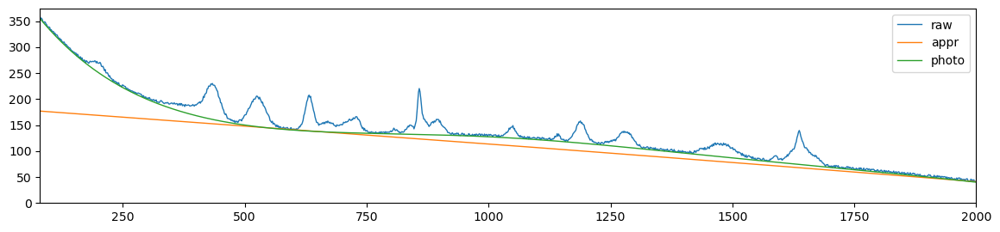

als_lambda: 18873918.221350998,	 als_p_weight: 0.00045203536563602454,	 error: 2292.2983437320663, 	 smoothness: 0.5221483989633651, 	 smoothness: -0.5635534242557162


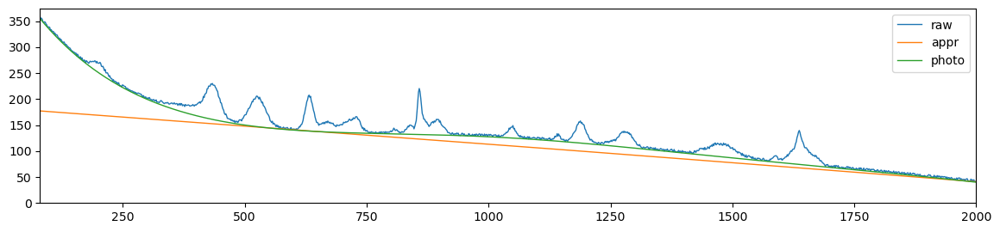

als_lambda: 18873918.221350998,	 als_p_weight: 0.00032903445623126676,	 error: 2328.6688924829227, 	 smoothness: 0.52175709903363, 	 smoothness: -0.5634986877679973


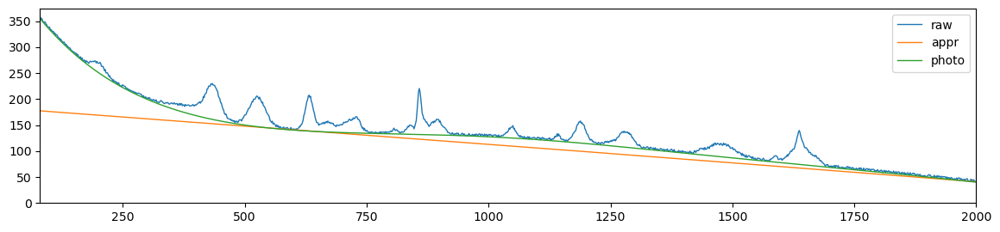

als_lambda: 18873918.221350998,	 als_p_weight: 0.0002395026619987486,	 error: 2356.8945914947826, 	 smoothness: 0.5214748604322201, 	 smoothness: -0.5634543394440965


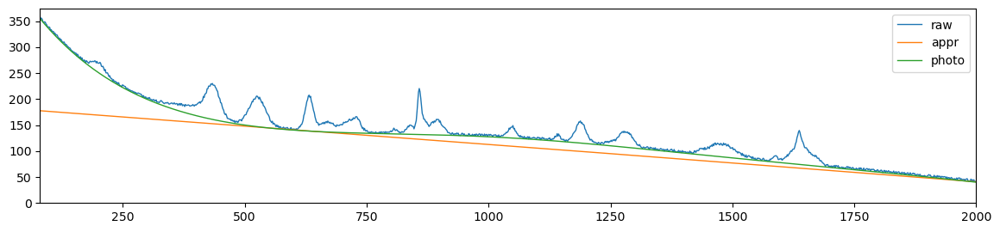

als_lambda: 18873918.221350998,	 als_p_weight: 0.00017433288221999874,	 error: 2378.9086311838596, 	 smoothness: 0.5212711252873926, 	 smoothness: -0.5634215743179978


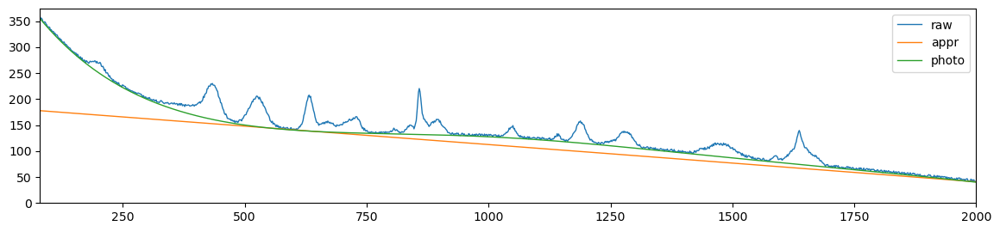

als_lambda: 18873918.221350998,	 als_p_weight: 0.0001268961003167922,	 error: 2395.706869639796, 	 smoothness: 0.5211263786843555, 	 smoothness: -0.5633994319716359


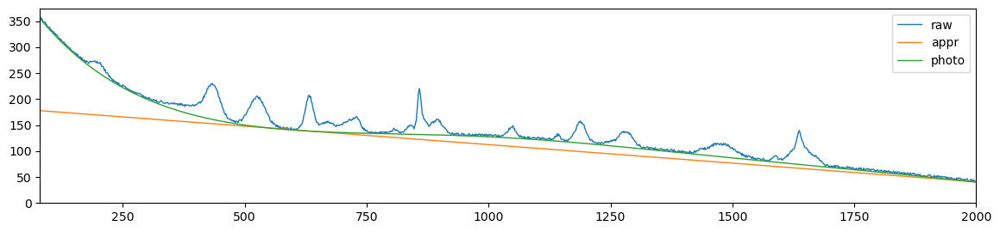

als_lambda: 18873918.221350998,	 als_p_weight: 9.236708571873866e-05,	 error: 2408.5952113264807, 	 smoothness: 0.5210229665096378, 	 smoothness: -0.5633841010724691


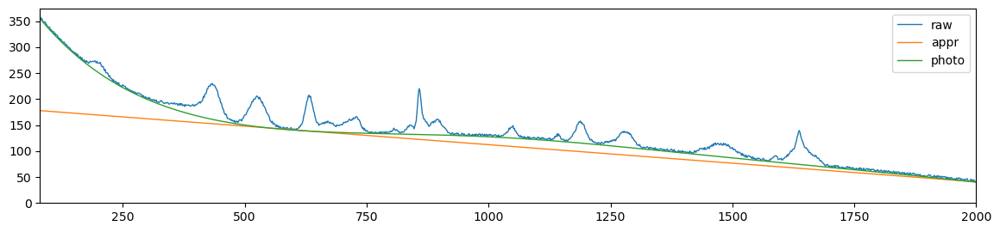

als_lambda: 18873918.221350998,	 als_p_weight: 6.723357536499335e-05,	 error: 2418.421143864893, 	 smoothness: 0.5209483674092877, 	 smoothness: -0.5633731333914944


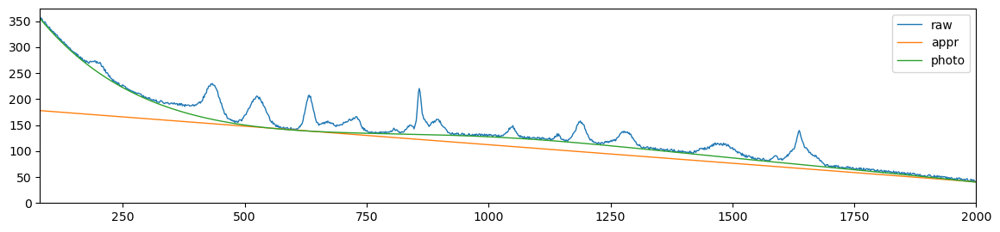

als_lambda: 18873918.221350998,	 als_p_weight: 4.893900918477499e-05,	 error: 2425.875148612215, 	 smoothness: 0.5208957408173515, 	 smoothness: -0.563365874441343


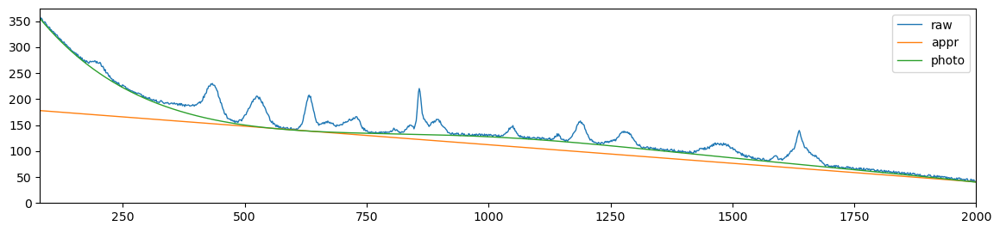

als_lambda: 18873918.221350998,	 als_p_weight: 3.5622478902624444e-05,	 error: 2431.513500056352, 	 smoothness: 0.5208576072357152, 	 smoothness: -0.5633606845010656


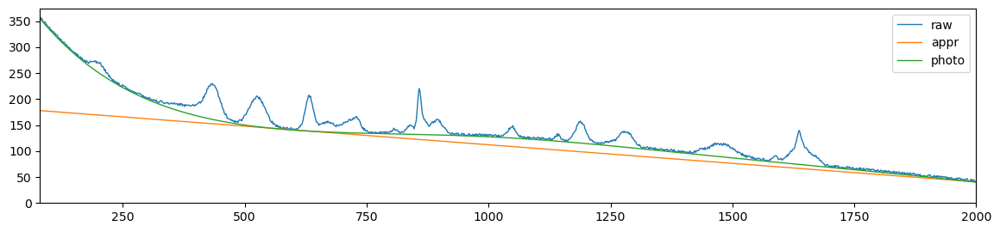

als_lambda: 18873918.221350998,	 als_p_weight: 2.592943797404667e-05,	 error: 2435.7548013240075, 	 smoothness: 0.5208306244040205, 	 smoothness: -0.5633574267554307


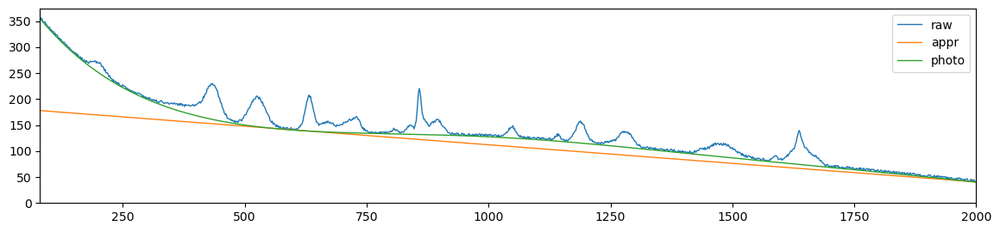

als_lambda: 18873918.221350998,	 als_p_weight: 1.8873918221350995e-05,	 error: 2438.8956428090924, 	 smoothness: 0.520811242342054, 	 smoothness: -0.5633552659143214


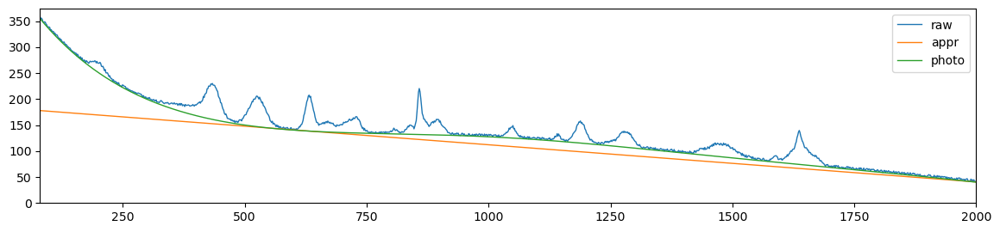

als_lambda: 18873918.221350998,	 als_p_weight: 1.3738237958832637e-05,	 error: 2441.1967182593303, 	 smoothness: 0.52079711971193, 	 smoothness: -0.5633536367891412


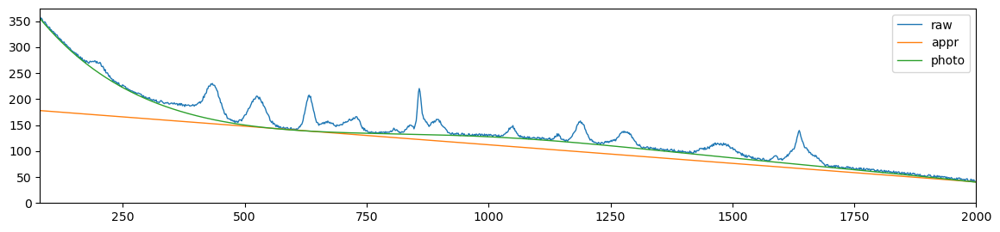

als_lambda: 18873918.221350998,	 als_p_weight: 1e-05,	 error: 2442.885657400361, 	 smoothness: 0.5207868737758425, 	 smoothness: -0.5633524488988452


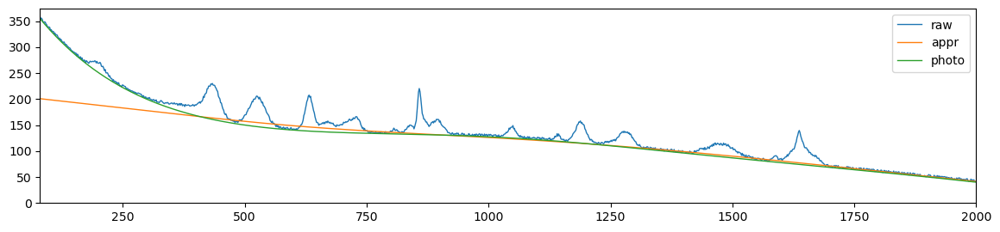

als_lambda: 32903445.62312671,	 als_p_weight: 0.1,	 error: 901.1592498852191, 	 smoothness: 0.5355995363605143, 	 smoothness: -0.551594855611378


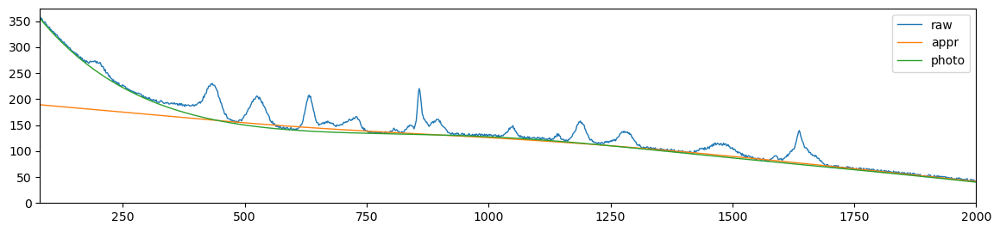

als_lambda: 32903445.62312671,	 als_p_weight: 0.0727895384398315,	 error: 947.6395061450644, 	 smoothness: 0.5395606169455588, 	 smoothness: -0.55260262930531


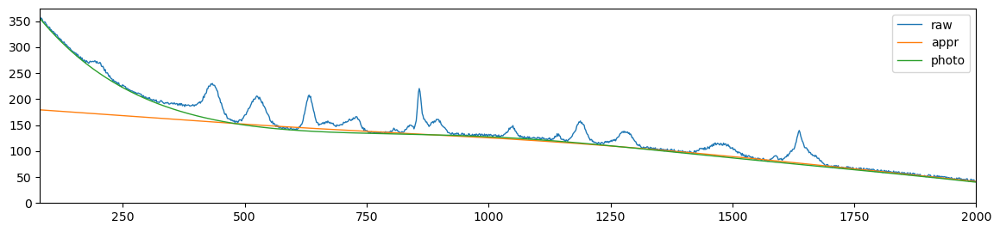

als_lambda: 32903445.62312671,	 als_p_weight: 0.05298316906283707,	 error: 985.7976073408929, 	 smoothness: 0.54265673354012, 	 smoothness: -0.5536719227241593


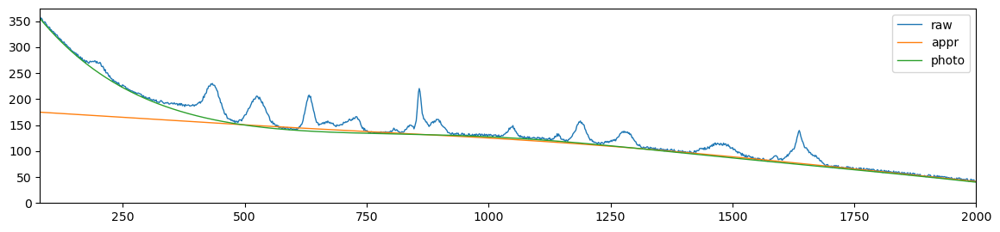

als_lambda: 32903445.62312671,	 als_p_weight: 0.03856620421163472,	 error: 1022.4960663096927, 	 smoothness: 0.5447859135941002, 	 smoothness: -0.5548641959542308


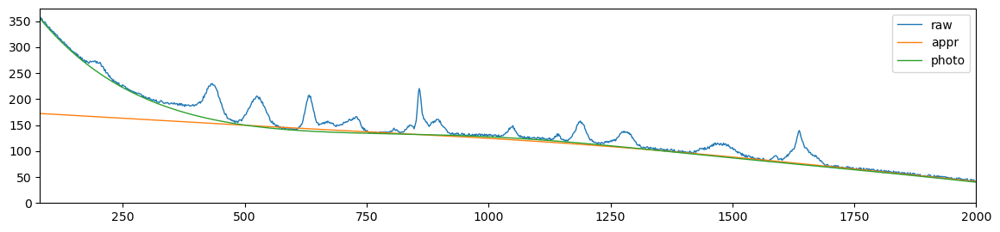

als_lambda: 32903445.62312671,	 als_p_weight: 0.02807216203941177,	 error: 1047.4810465110788, 	 smoothness: 0.5455977647863953, 	 smoothness: -0.5562609599413253


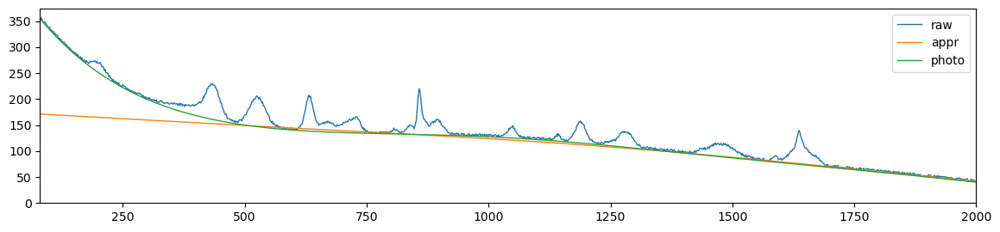

als_lambda: 32903445.62312671,	 als_p_weight: 0.020433597178569417,	 error: 1093.043631822763, 	 smoothness: 0.5449925077875402, 	 smoothness: -0.5575168605330235


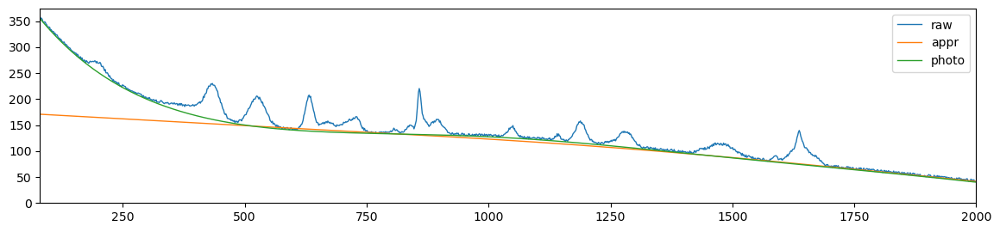

als_lambda: 32903445.62312671,	 als_p_weight: 0.014873521072935119,	 error: 1141.1736072736892, 	 smoothness: 0.5437258497536023, 	 smoothness: -0.5590177689201744


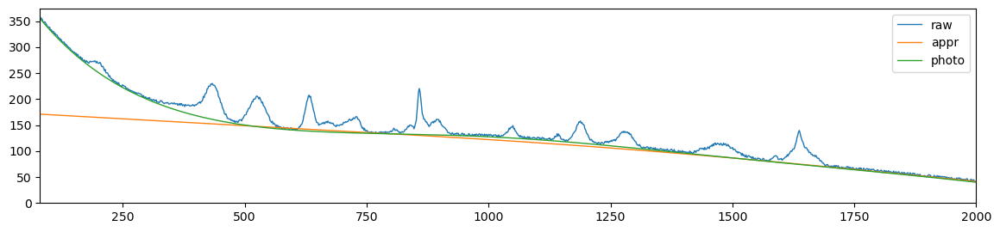

als_lambda: 32903445.62312671,	 als_p_weight: 0.010826367338740546,	 error: 1226.385568416246, 	 smoothness: 0.5410467027077125, 	 smoothness: -0.5606994942692183


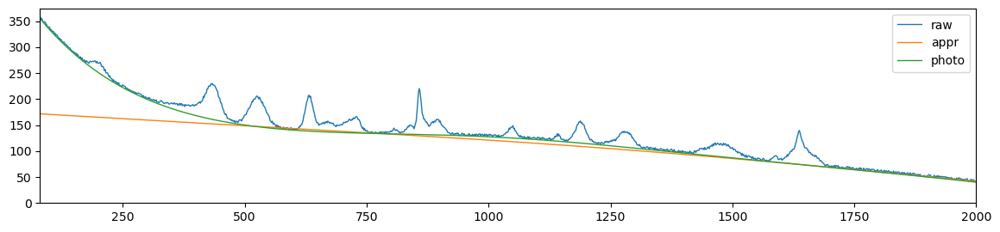

als_lambda: 32903445.62312671,	 als_p_weight: 0.007880462815669913,	 error: 1390.080237172725, 	 smoothness: 0.5371906869708454, 	 smoothness: -0.5622028165080115


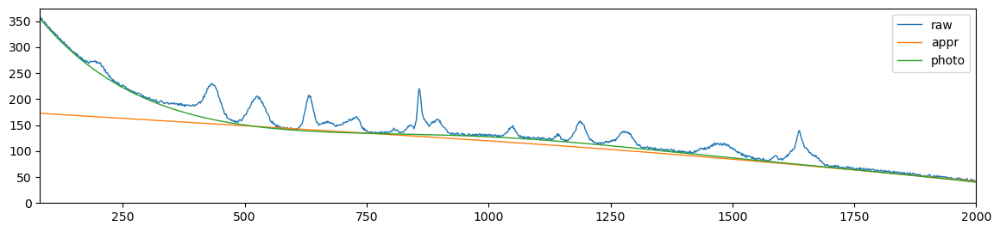

als_lambda: 32903445.62312671,	 als_p_weight: 0.005736152510448681,	 error: 1584.1676787080744, 	 smoothness: 0.532943149063866, 	 smoothness: -0.5632514782304333


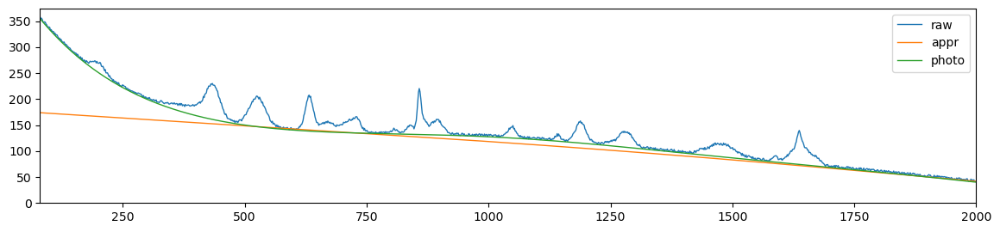

als_lambda: 32903445.62312671,	 als_p_weight: 0.0041753189365604,	 error: 1770.413728945202, 	 smoothness: 0.5294278280011012, 	 smoothness: -0.5637160127404357


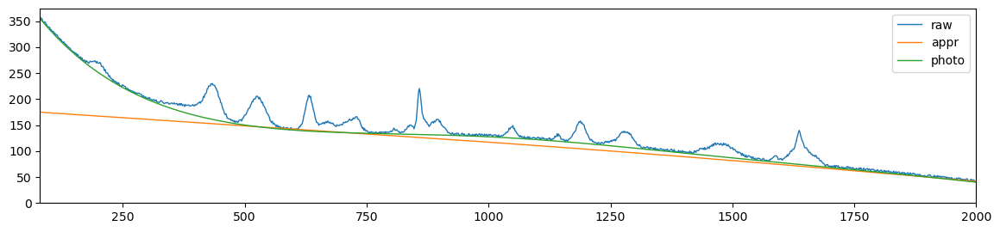

als_lambda: 32903445.62312671,	 als_p_weight: 0.0030391953823131978,	 error: 1920.2173726607, 	 smoothness: 0.5268687383771183, 	 smoothness: -0.5638417006251197


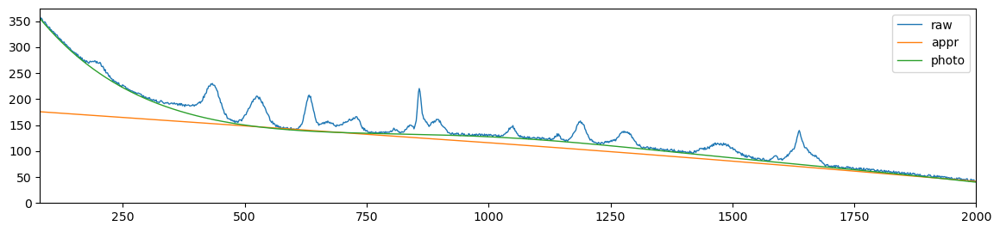

als_lambda: 32903445.62312671,	 als_p_weight: 0.00221221629107045,	 error: 2036.9737732066785, 	 smoothness: 0.525071501333061, 	 smoothness: -0.5638243948046617


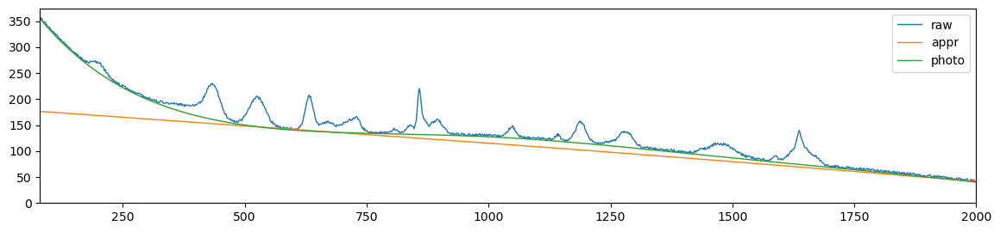

als_lambda: 32903445.62312671,	 als_p_weight: 0.0016102620275609393,	 error: 2128.2331817041113, 	 smoothness: 0.5238113226588044, 	 smoothness: -0.5637561763181939


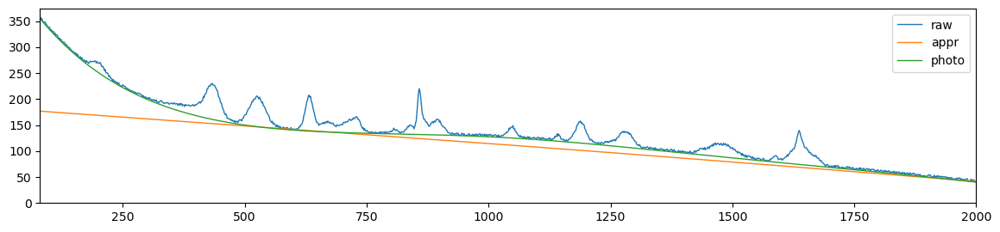

als_lambda: 32903445.62312671,	 als_p_weight: 0.0011721022975334804,	 error: 2199.2930440250293, 	 smoothness: 0.5229360185239392, 	 smoothness: -0.5636778283573757


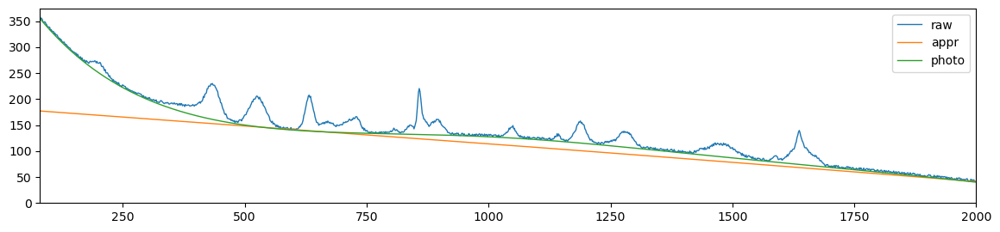

als_lambda: 32903445.62312671,	 als_p_weight: 0.0008531678524172806,	 error: 2254.4023250681394, 	 smoothness: 0.5223211550625814, 	 smoothness: -0.5636055424824793


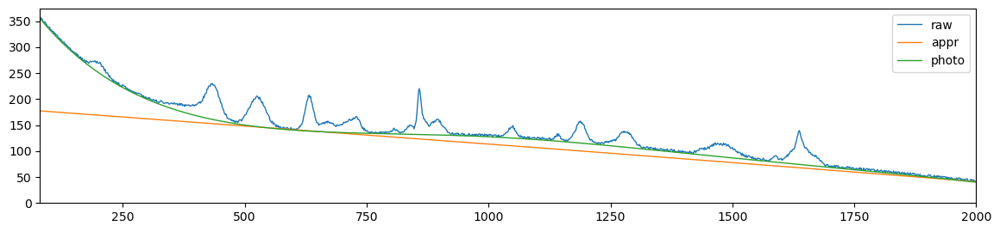

als_lambda: 32903445.62312671,	 als_p_weight: 0.0006210169418915617,	 error: 2297.146278594309, 	 smoothness: 0.521884362022142, 	 smoothness: -0.5635416380555667


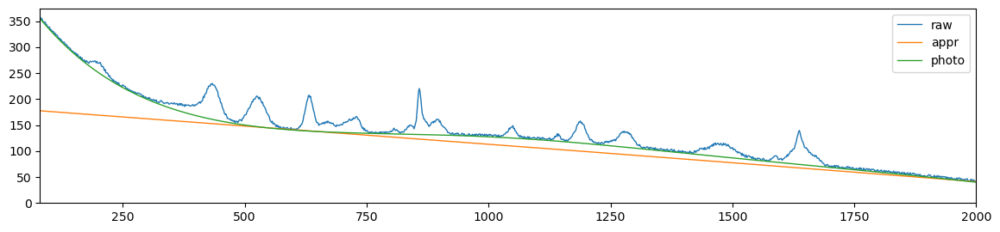

als_lambda: 32903445.62312671,	 als_p_weight: 0.00045203536563602454,	 error: 2330.3693171372997, 	 smoothness: 0.5215710353862097, 	 smoothness: -0.5634896113872019


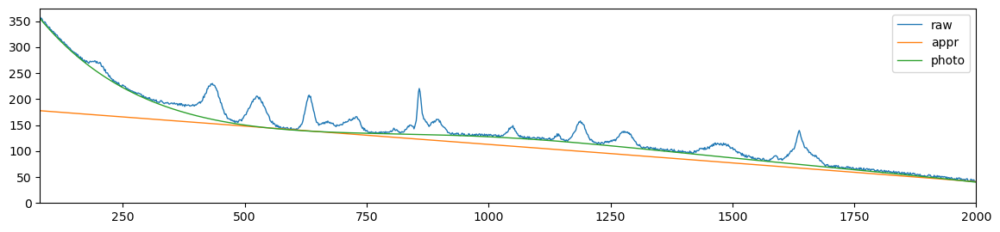

als_lambda: 32903445.62312671,	 als_p_weight: 0.00032903445623126676,	 error: 2356.312484129241, 	 smoothness: 0.521344559340011, 	 smoothness: -0.5634489633002753


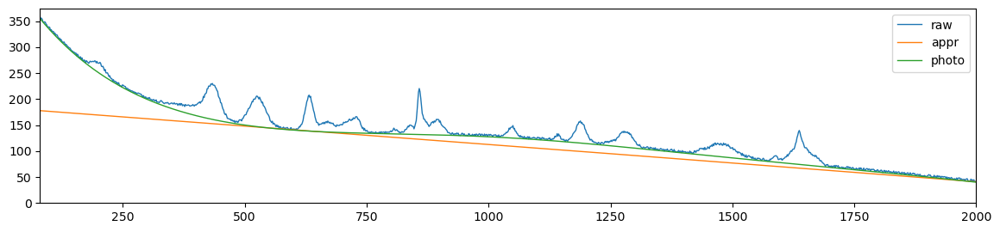

als_lambda: 32903445.62312671,	 als_p_weight: 0.0002395026619987486,	 error: 2377.0642732595084, 	 smoothness: 0.521178471396501, 	 smoothness: -0.5634167317492509


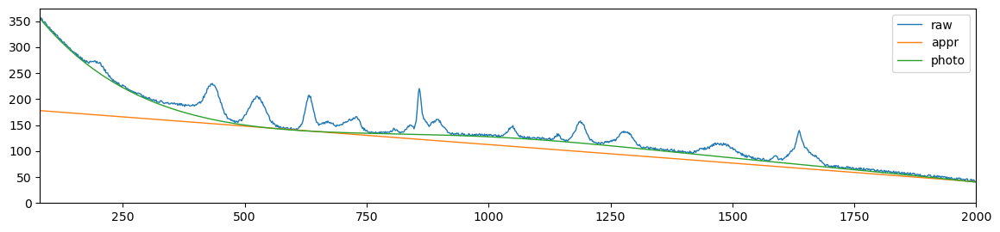

als_lambda: 32903445.62312671,	 als_p_weight: 0.00017433288221999874,	 error: 2393.5515269734683, 	 smoothness: 0.5210574375366673, 	 smoothness: -0.5633934260010214


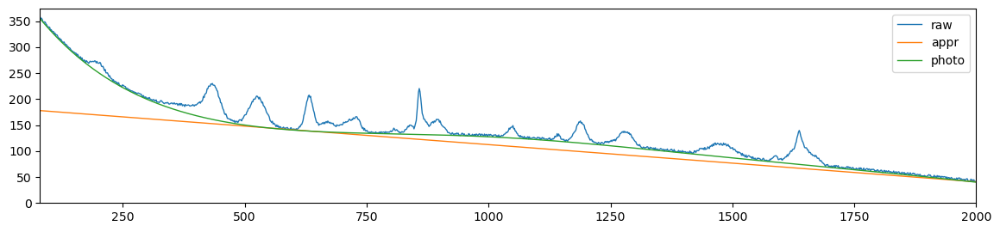

als_lambda: 32903445.62312671,	 als_p_weight: 0.0001268961003167922,	 error: 2406.347081161168, 	 smoothness: 0.5209719991207199, 	 smoothness: -0.5633785808346399


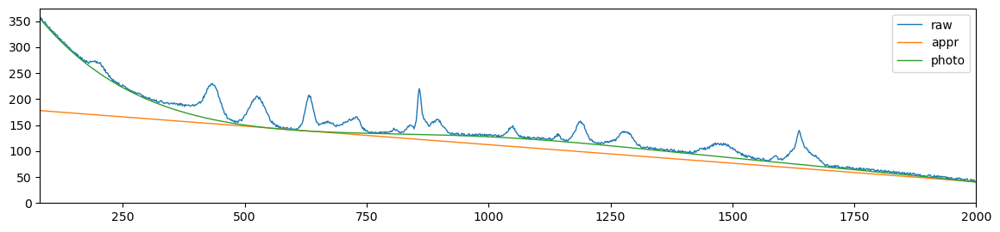

als_lambda: 32903445.62312671,	 als_p_weight: 9.236708571873866e-05,	 error: 2416.332676247747, 	 smoothness: 0.5209112996075705, 	 smoothness: -0.5633687984345496


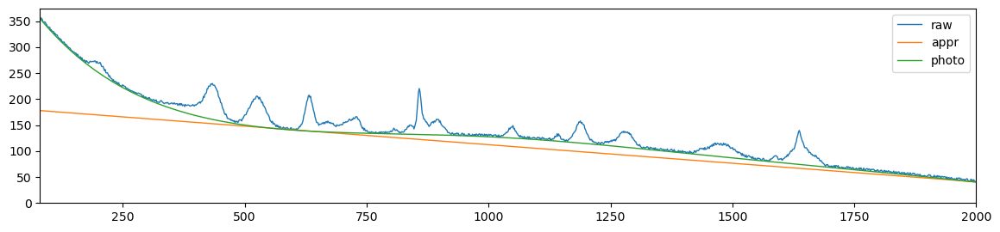

als_lambda: 32903445.62312671,	 als_p_weight: 6.723357536499335e-05,	 error: 2424.0139387954414, 	 smoothness: 0.5208675203675788, 	 smoothness: -0.5633618017859056


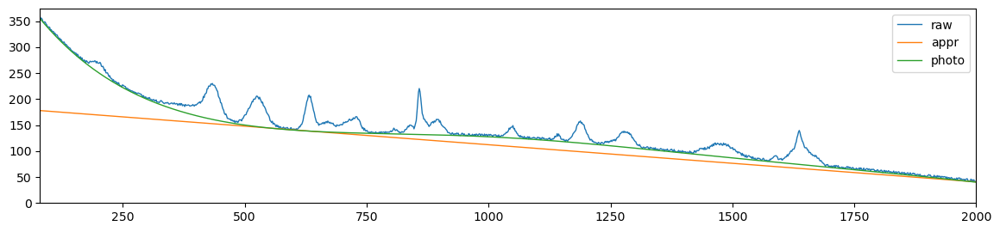

als_lambda: 32903445.62312671,	 als_p_weight: 4.893900918477499e-05,	 error: 2429.9231826235455, 	 smoothness: 0.5208371099347294, 	 smoothness: -0.5633575322955887


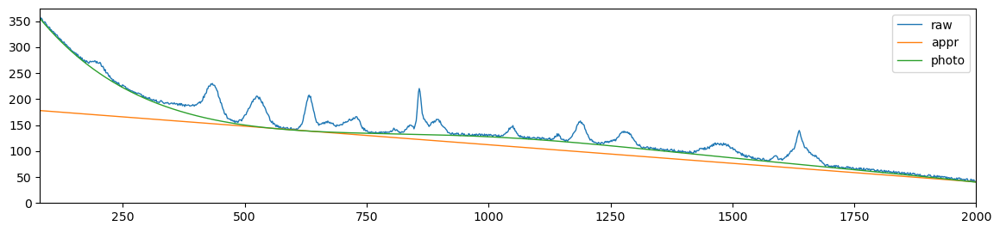

als_lambda: 32903445.62312671,	 als_p_weight: 3.5622478902624444e-05,	 error: 2434.4410589817808, 	 smoothness: 0.5208150530645229, 	 smoothness: -0.5633545643479568


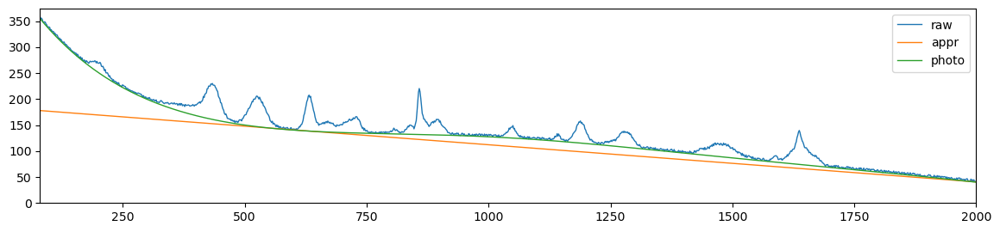

als_lambda: 32903445.62312671,	 als_p_weight: 2.592943797404667e-05,	 error: 2437.06792294611, 	 smoothness: 0.5207972416581969, 	 smoothness: -0.5633518495037211


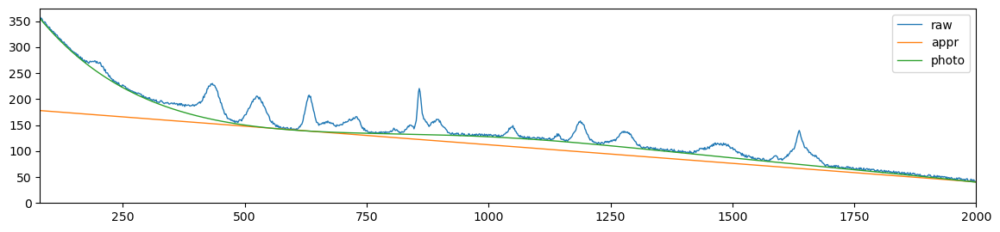

als_lambda: 32903445.62312671,	 als_p_weight: 1.8873918221350995e-05,	 error: 2439.5988382021196, 	 smoothness: 0.520786280055147, 	 smoothness: -0.5633508314245074


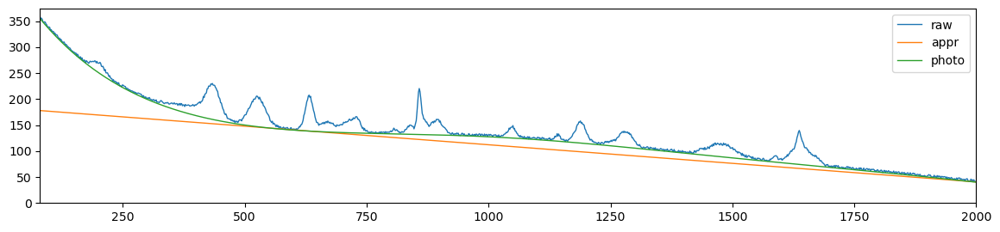

als_lambda: 32903445.62312671,	 als_p_weight: 1.3738237958832637e-05,	 error: 2441.4583417051904, 	 smoothness: 0.5207782553504614, 	 smoothness: -0.5633500446338324


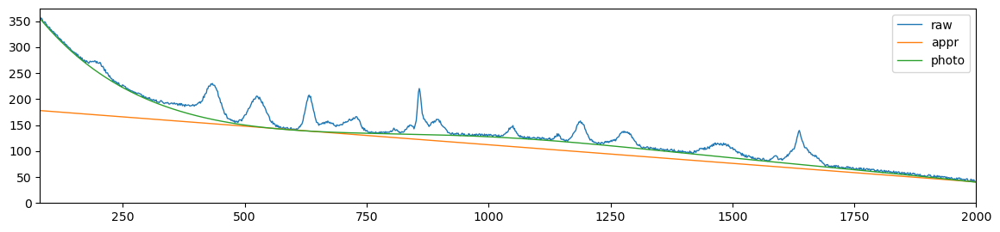

als_lambda: 32903445.62312671,	 als_p_weight: 1e-05,	 error: 2442.703142793157, 	 smoothness: 0.5207724679244075, 	 smoothness: -0.5633490054311109


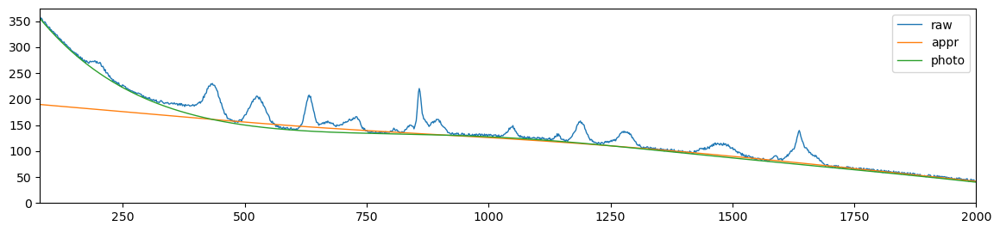

als_lambda: 57361525.104486816,	 als_p_weight: 0.1,	 error: 952.6820339580433, 	 smoothness: 0.5418821949035724, 	 smoothness: -0.5539990384788858


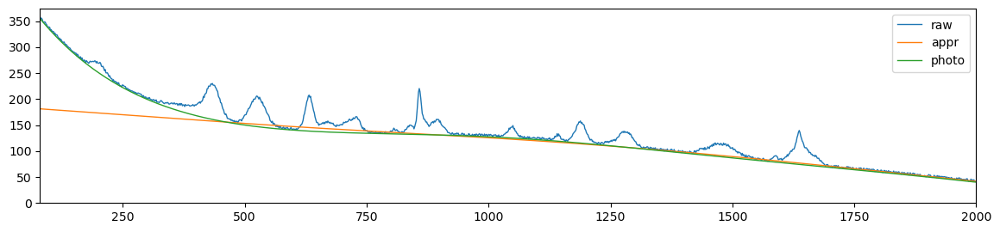

als_lambda: 57361525.104486816,	 als_p_weight: 0.0727895384398315,	 error: 985.6365201129412, 	 smoothness: 0.5441619999748981, 	 smoothness: -0.5551367247952449


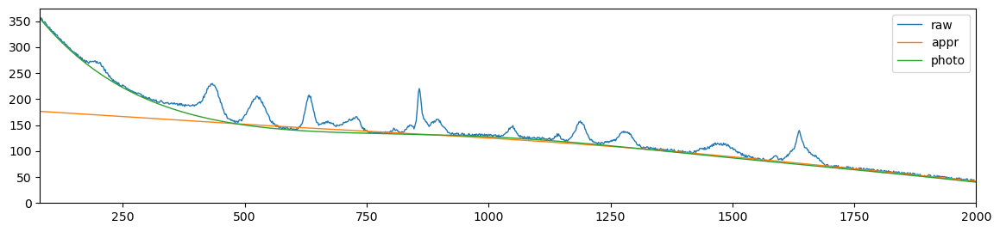

als_lambda: 57361525.104486816,	 als_p_weight: 0.05298316906283707,	 error: 1013.8439509729234, 	 smoothness: 0.5453123409174875, 	 smoothness: -0.5563717912682593


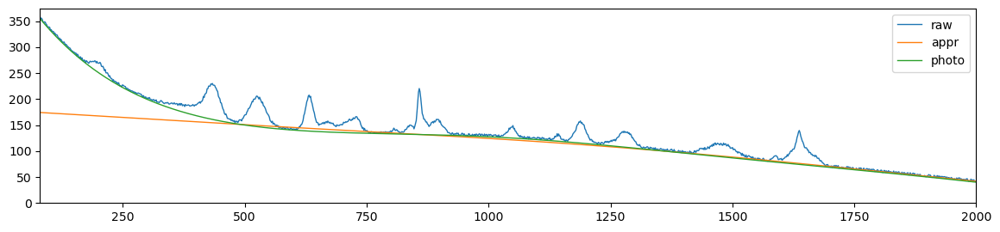

als_lambda: 57361525.104486816,	 als_p_weight: 0.03856620421163472,	 error: 1048.7433915613406, 	 smoothness: 0.5449211549622597, 	 smoothness: -0.5576165639169449


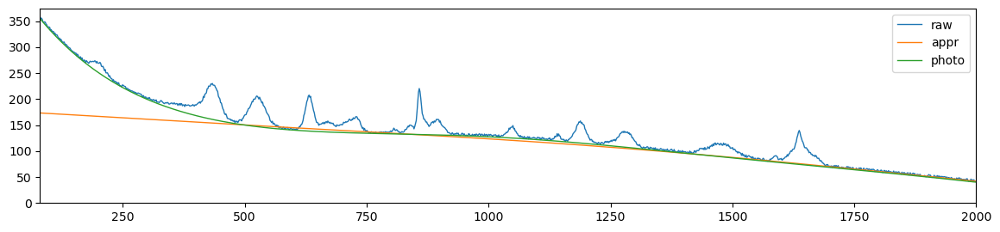

als_lambda: 57361525.104486816,	 als_p_weight: 0.02807216203941177,	 error: 1094.397093371621, 	 smoothness: 0.543883964056019, 	 smoothness: -0.5589646380924485


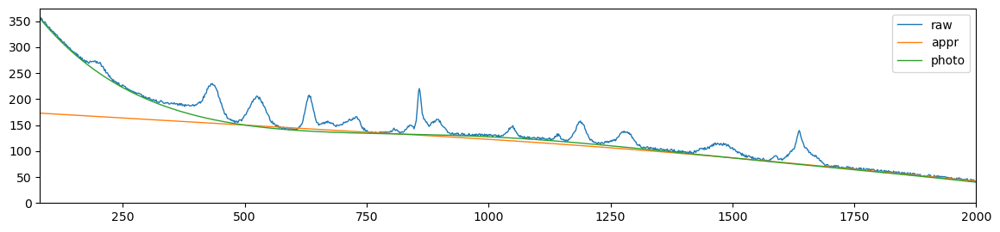

als_lambda: 57361525.104486816,	 als_p_weight: 0.020433597178569417,	 error: 1161.1667284530783, 	 smoothness: 0.5416653479619079, 	 smoothness: -0.5605002999144597


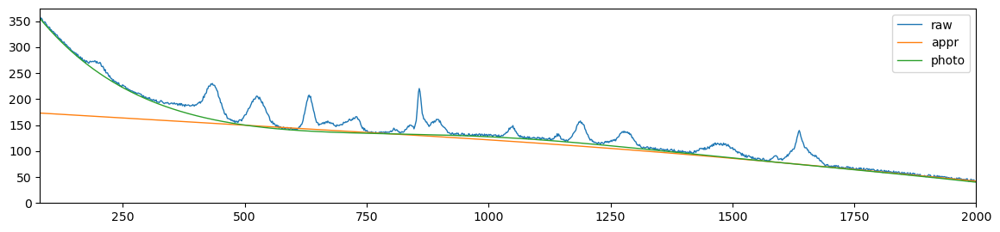

als_lambda: 57361525.104486816,	 als_p_weight: 0.014873521072935119,	 error: 1299.4176973733186, 	 smoothness: 0.5380866269616447, 	 smoothness: -0.5620447911345268


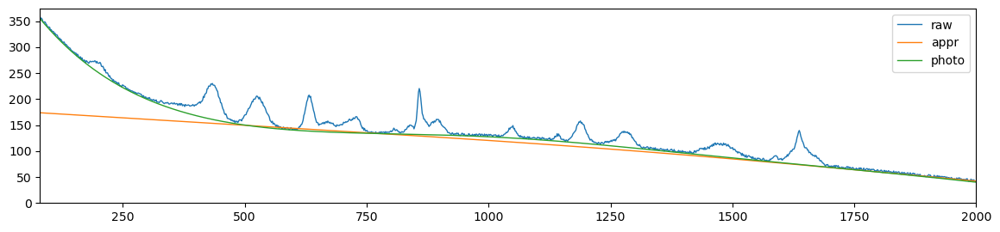

als_lambda: 57361525.104486816,	 als_p_weight: 0.010826367338740546,	 error: 1479.2489149268586, 	 smoothness: 0.5340342471037158, 	 smoothness: -0.5631400149137759


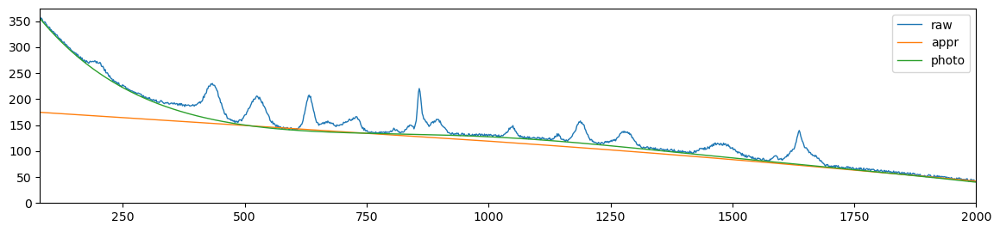

als_lambda: 57361525.104486816,	 als_p_weight: 0.007880462815669913,	 error: 1672.7058480280853, 	 smoothness: 0.5303117044459803, 	 smoothness: -0.5637208631603771


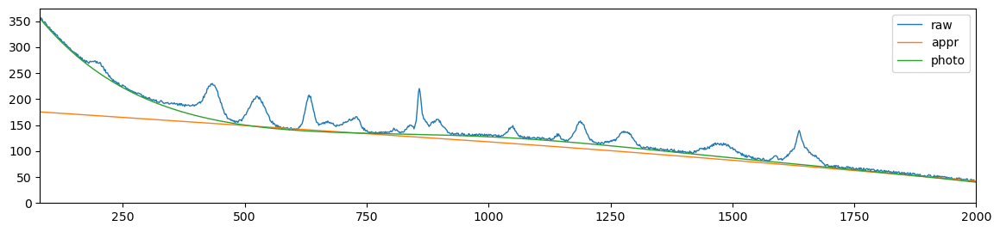

als_lambda: 57361525.104486816,	 als_p_weight: 0.005736152510448681,	 error: 1835.1789440545283, 	 smoothness: 0.5275267474410368, 	 smoothness: -0.5639041998631551


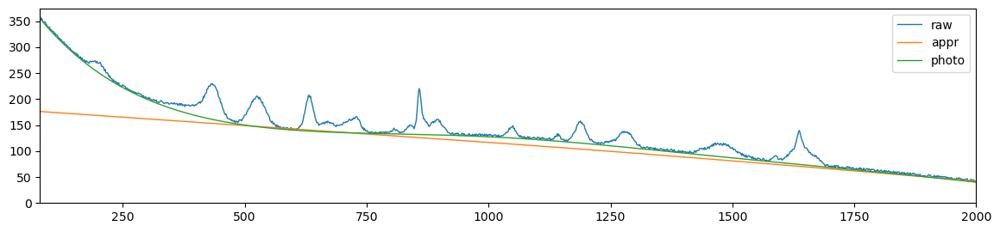

als_lambda: 57361525.104486816,	 als_p_weight: 0.0041753189365604,	 error: 1964.0162199772087, 	 smoothness: 0.5255566666779297, 	 smoothness: -0.5639048465143933


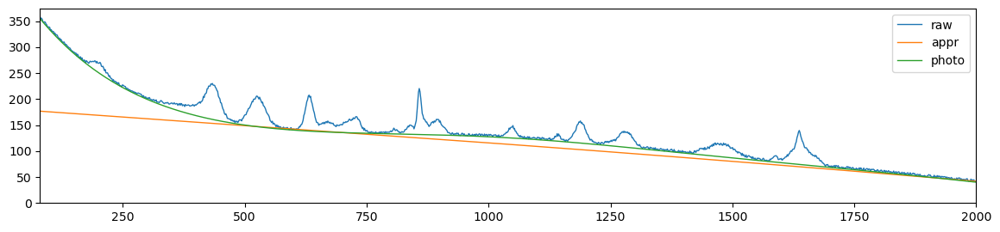

als_lambda: 57361525.104486816,	 als_p_weight: 0.0030391953823131978,	 error: 2065.078624851395, 	 smoothness: 0.5241733177090075, 	 smoothness: -0.5638341651362926


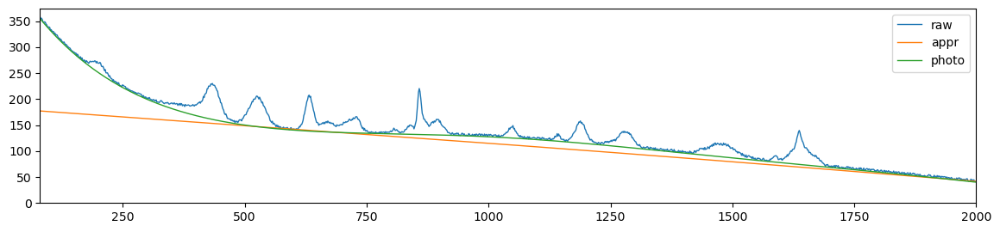

als_lambda: 57361525.104486816,	 als_p_weight: 0.00221221629107045,	 error: 2144.3063047481987, 	 smoothness: 0.5232007441346073, 	 smoothness: -0.5637485564348345


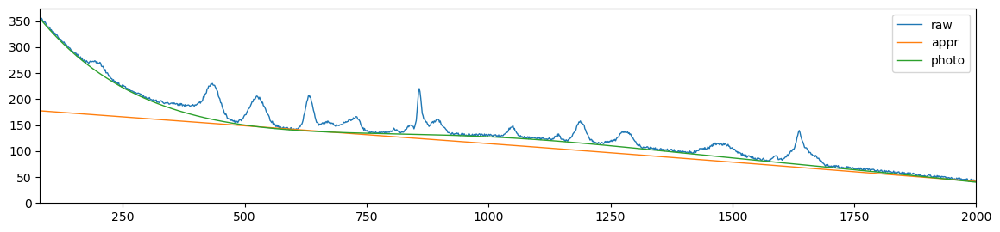

als_lambda: 57361525.104486816,	 als_p_weight: 0.0016102620275609393,	 error: 2206.649156285806, 	 smoothness: 0.5225178909543893, 	 smoothness: -0.5636663806463983


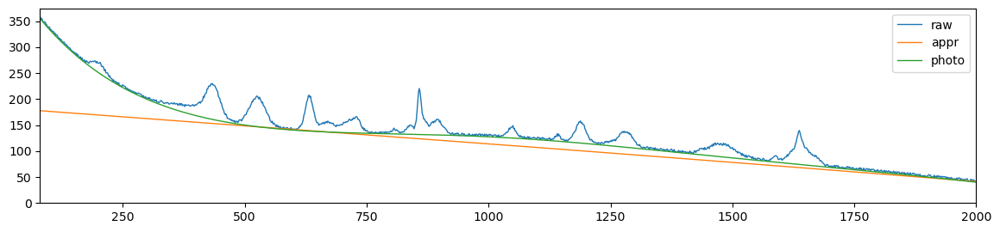

als_lambda: 57361525.104486816,	 als_p_weight: 0.0011721022975334804,	 error: 2256.267069908347, 	 smoothness: 0.5220328839549082, 	 smoothness: -0.5635959305589648


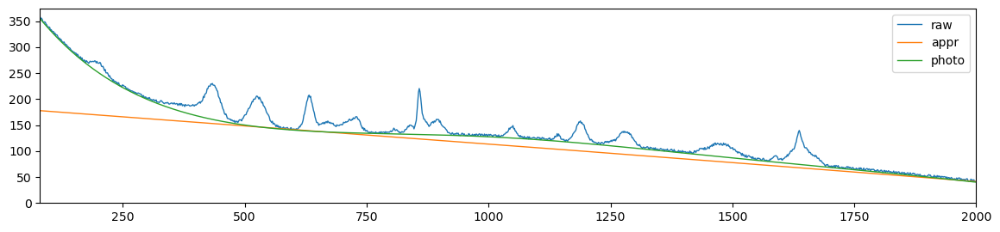

als_lambda: 57361525.104486816,	 als_p_weight: 0.0008531678524172806,	 error: 2295.674222908833, 	 smoothness: 0.5216866076050967, 	 smoothness: -0.5635378116641023


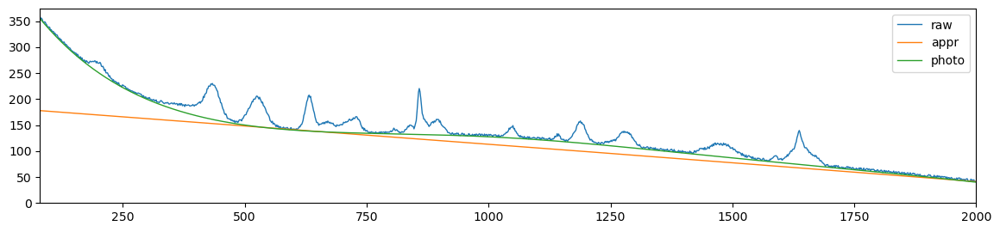

als_lambda: 57361525.104486816,	 als_p_weight: 0.0006210169418915617,	 error: 2327.1142441511256, 	 smoothness: 0.5214333837206093, 	 smoothness: -0.5634883939731881


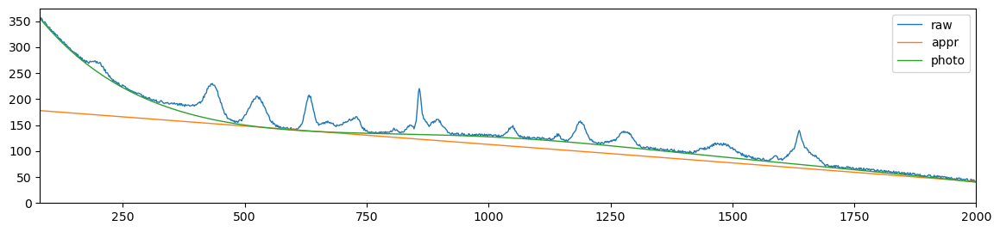

als_lambda: 57361525.104486816,	 als_p_weight: 0.00045203536563602454,	 error: 2352.1011848494522, 	 smoothness: 0.521248170261146, 	 smoothness: -0.5634488050654757


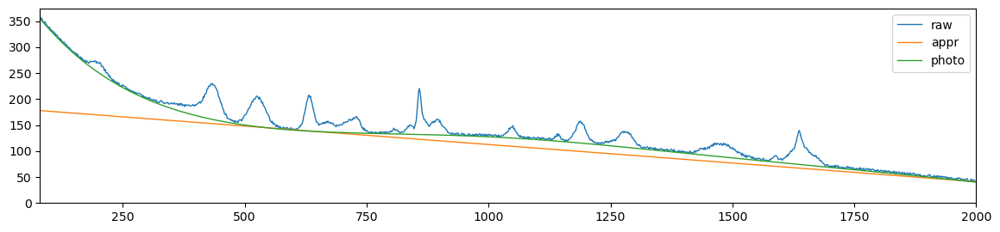

als_lambda: 57361525.104486816,	 als_p_weight: 0.00032903445623126676,	 error: 2372.1659252793706, 	 smoothness: 0.5211119296307839, 	 smoothness: -0.5634184212158377


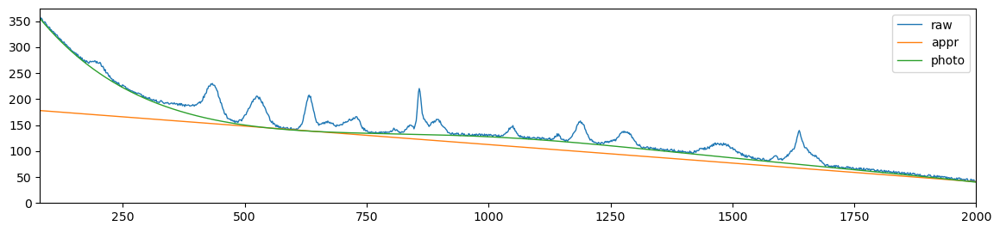

als_lambda: 57361525.104486816,	 als_p_weight: 0.0002395026619987486,	 error: 2388.604164267755, 	 smoothness: 0.5210104596034683, 	 smoothness: -0.5633940581063941


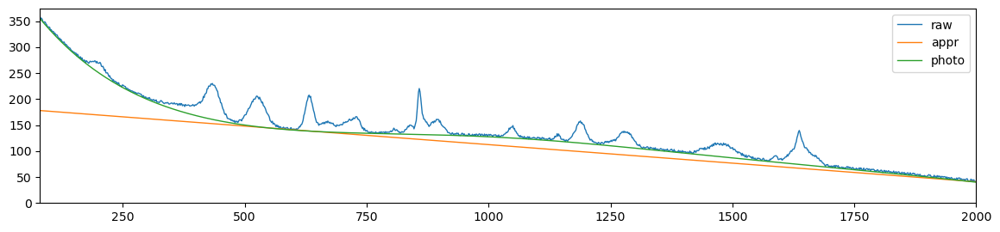

als_lambda: 57361525.104486816,	 als_p_weight: 0.00017433288221999874,	 error: 2401.952384597558, 	 smoothness: 0.520935993028913, 	 smoothness: -0.5633767660259532


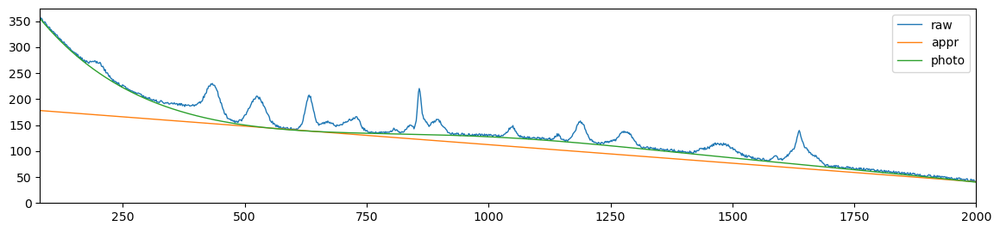

als_lambda: 57361525.104486816,	 als_p_weight: 0.0001268961003167922,	 error: 2412.441445880549, 	 smoothness: 0.5208839934516601, 	 smoothness: -0.5633663126822295


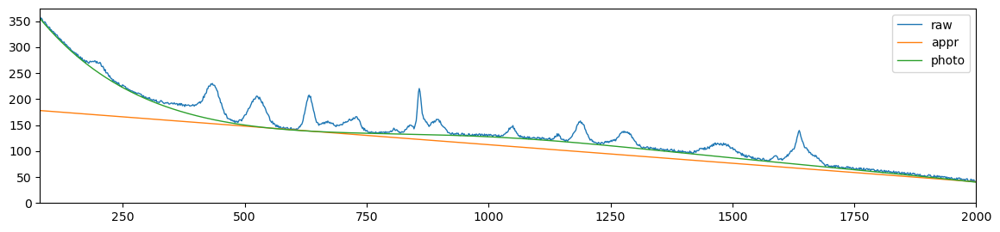

als_lambda: 57361525.104486816,	 als_p_weight: 9.236708571873866e-05,	 error: 2420.7533870700177, 	 smoothness: 0.5208476008116211, 	 smoothness: -0.5633598143227738


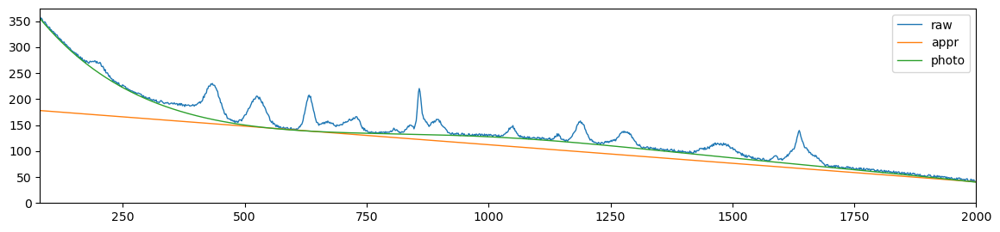

als_lambda: 57361525.104486816,	 als_p_weight: 6.723357536499335e-05,	 error: 2427.215202287038, 	 smoothness: 0.5208213711303546, 	 smoothness: -0.5633552083238841


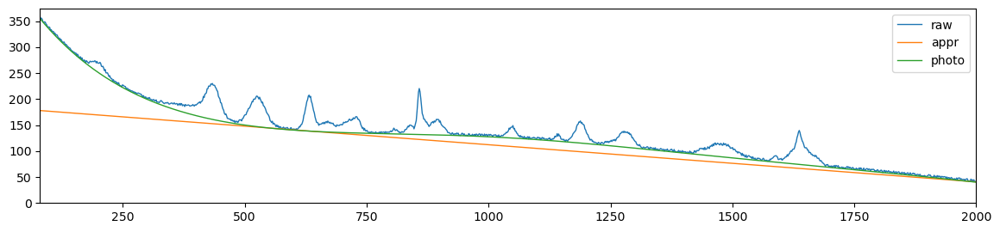

als_lambda: 57361525.104486816,	 als_p_weight: 4.893900918477499e-05,	 error: 2432.2339441903796, 	 smoothness: 0.5208035074983576, 	 smoothness: -0.5633526521460631


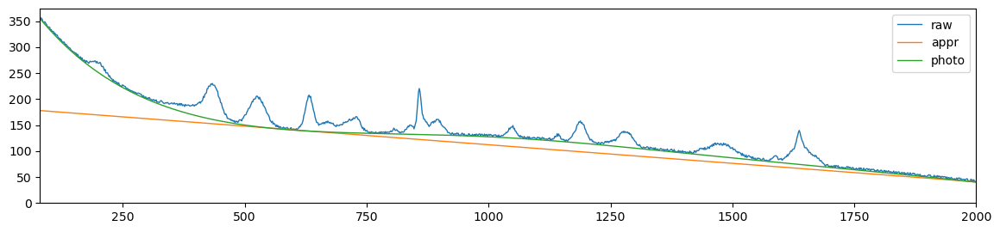

als_lambda: 57361525.104486816,	 als_p_weight: 3.5622478902624444e-05,	 error: 2436.111494133563, 	 smoothness: 0.5207906151783555, 	 smoothness: -0.563350969333189


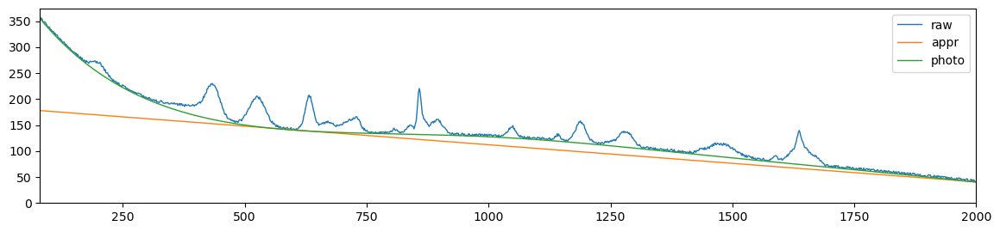

als_lambda: 57361525.104486816,	 als_p_weight: 2.592943797404667e-05,	 error: 2439.0658466892974, 	 smoothness: 0.5207819673743059, 	 smoothness: -0.5633502689353123


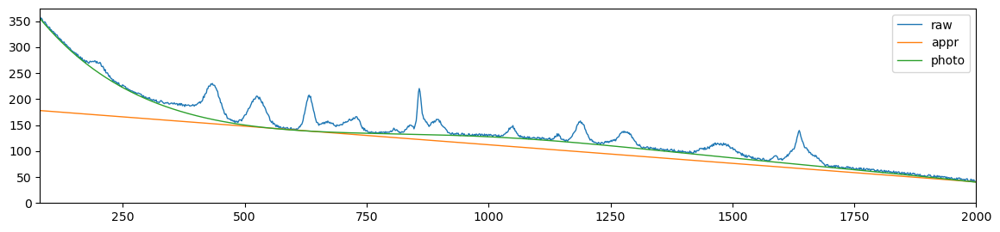

als_lambda: 57361525.104486816,	 als_p_weight: 1.8873918221350995e-05,	 error: 2441.268657849012, 	 smoothness: 0.5207758758929619, 	 smoothness: -0.5633499657162307


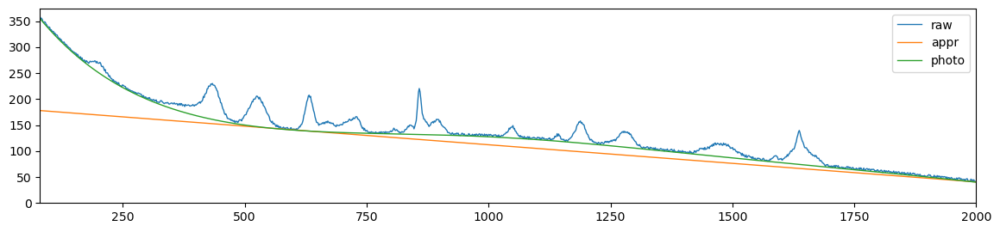

als_lambda: 57361525.104486816,	 als_p_weight: 1.3738237958832637e-05,	 error: 2442.8923308474505, 	 smoothness: 0.5207713805540964, 	 smoothness: -0.5633497006629415


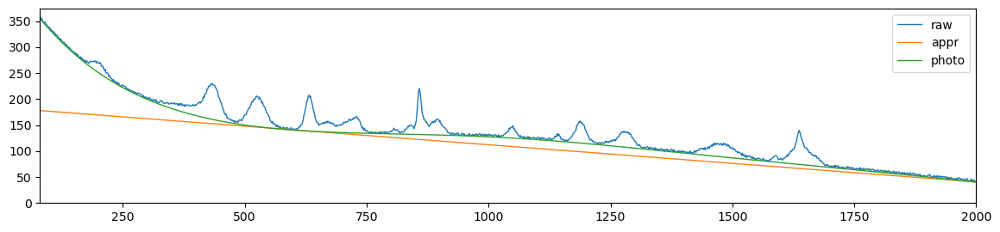

als_lambda: 57361525.104486816,	 als_p_weight: 1e-05,	 error: 2444.0853138710027, 	 smoothness: 0.5207681410896957, 	 smoothness: -0.5633495075579975


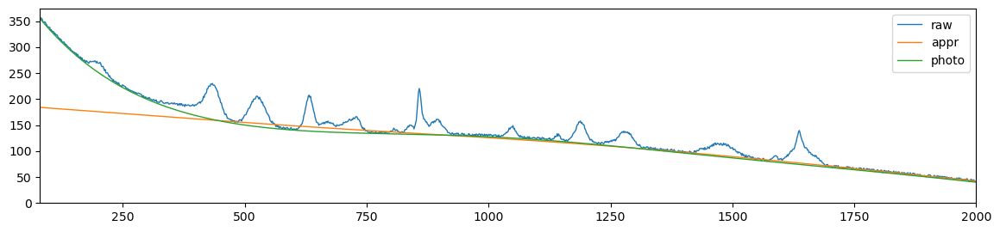

als_lambda: 100000000.0,	 als_p_weight: 0.1,	 error: 974.7631780094006, 	 smoothness: 0.5447926794925653, 	 smoothness: -0.5566948593339598


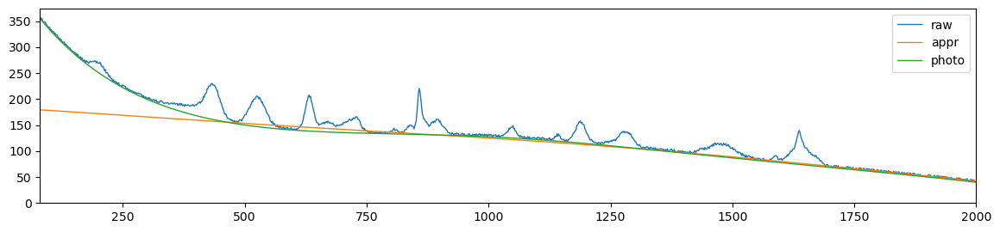

als_lambda: 100000000.0,	 als_p_weight: 0.0727895384398315,	 error: 999.790049394801, 	 smoothness: 0.5448298556314781, 	 smoothness: -0.5579114766833745


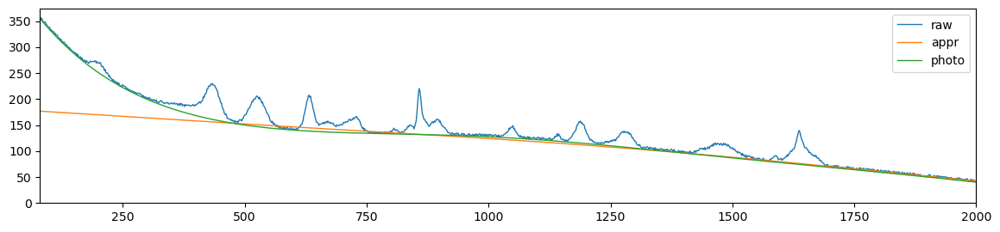

als_lambda: 100000000.0,	 als_p_weight: 0.05298316906283707,	 error: 1043.7491055537, 	 smoothness: 0.5438865888341633, 	 smoothness: -0.5590868867758724


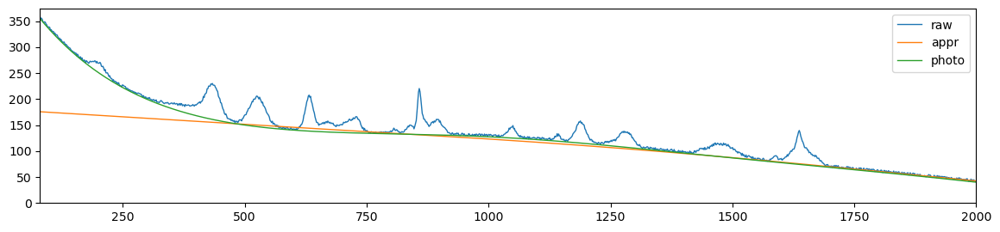

als_lambda: 100000000.0,	 als_p_weight: 0.03856620421163472,	 error: 1098.4700302985275, 	 smoothness: 0.5420372883371125, 	 smoothness: -0.5604670382549398


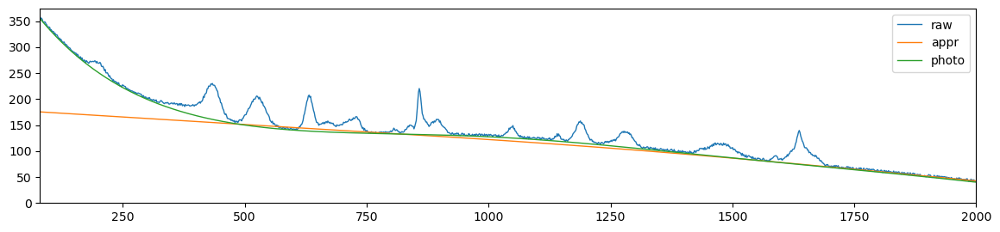

als_lambda: 100000000.0,	 als_p_weight: 0.02807216203941177,	 error: 1201.6603888364075, 	 smoothness: 0.5389326815226174, 	 smoothness: -0.5619315105744567


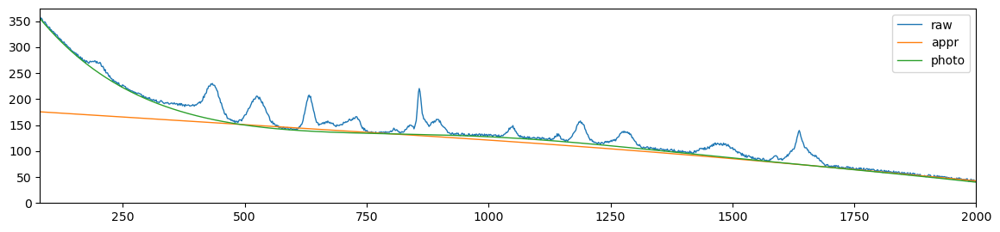

als_lambda: 100000000.0,	 als_p_weight: 0.020433597178569417,	 error: 1369.202819000101, 	 smoothness: 0.5350951017626724, 	 smoothness: -0.563057311588834


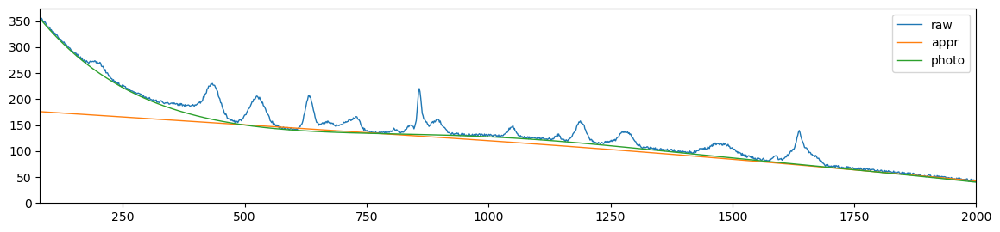

als_lambda: 100000000.0,	 als_p_weight: 0.014873521072935119,	 error: 1560.578642480731, 	 smoothness: 0.5312806581601908, 	 smoothness: -0.56374091099611


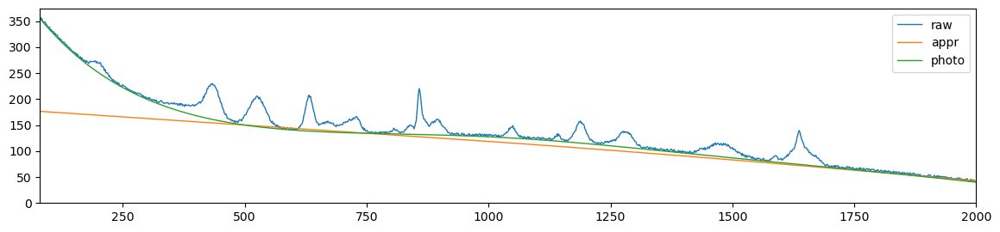

als_lambda: 100000000.0,	 als_p_weight: 0.010826367338740546,	 error: 1734.8285902200525, 	 smoothness: 0.5282765073398323, 	 smoothness: -0.5639827062147379


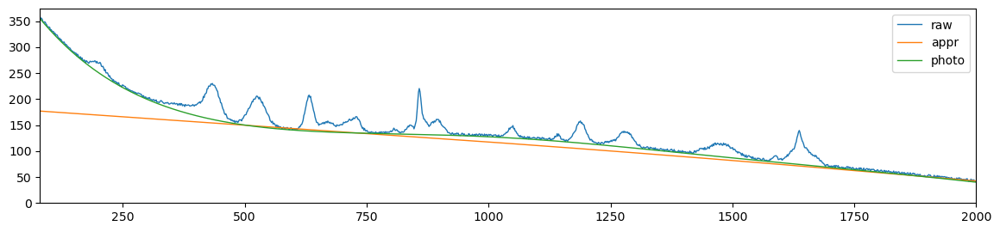

als_lambda: 100000000.0,	 als_p_weight: 0.007880462815669913,	 error: 1876.8862756411559, 	 smoothness: 0.5261033851936192, 	 smoothness: -0.5640004568365675


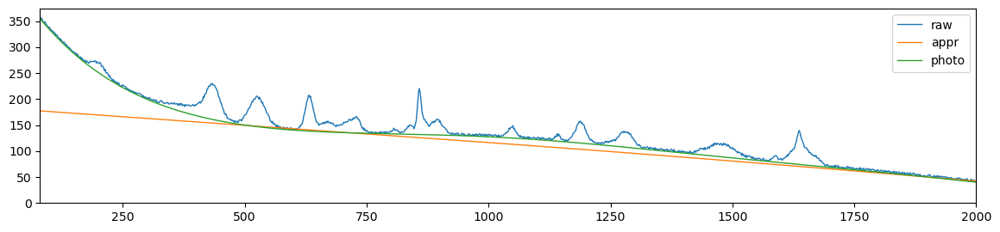

als_lambda: 100000000.0,	 als_p_weight: 0.005736152510448681,	 error: 1989.590901870629, 	 smoothness: 0.5245789629828805, 	 smoothness: -0.5639306511225645


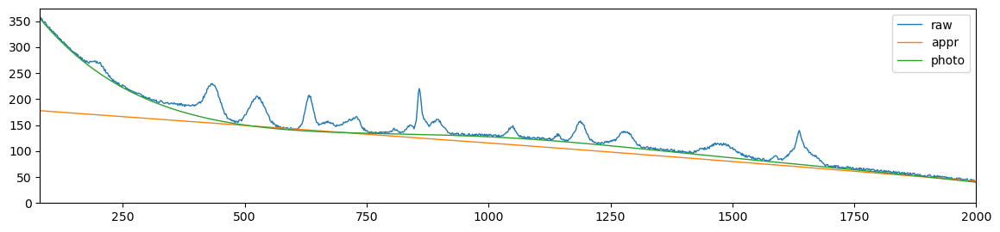

als_lambda: 100000000.0,	 als_p_weight: 0.0041753189365604,	 error: 2078.606505084195, 	 smoothness: 0.5235090689455943, 	 smoothness: -0.5638392586283193


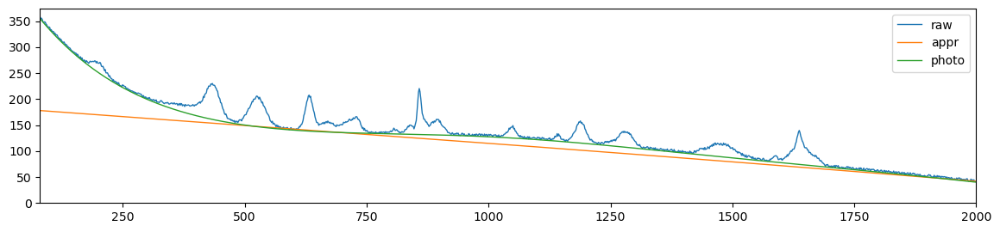

als_lambda: 100000000.0,	 als_p_weight: 0.0030391953823131978,	 error: 2149.551191157871, 	 smoothness: 0.5227461066123058, 	 smoothness: -0.5637454367812627


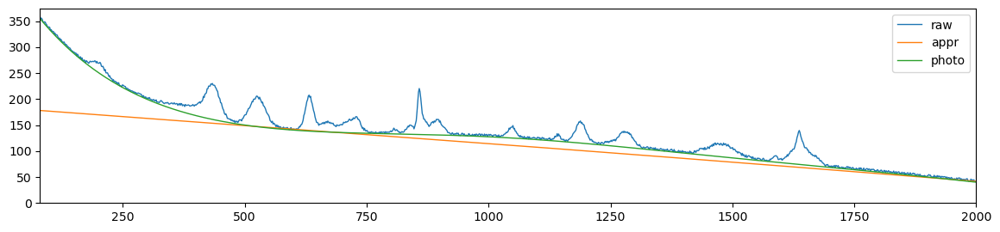

als_lambda: 100000000.0,	 als_p_weight: 0.00221221629107045,	 error: 2205.9064013944608, 	 smoothness: 0.522205777652211, 	 smoothness: -0.5636636429250975


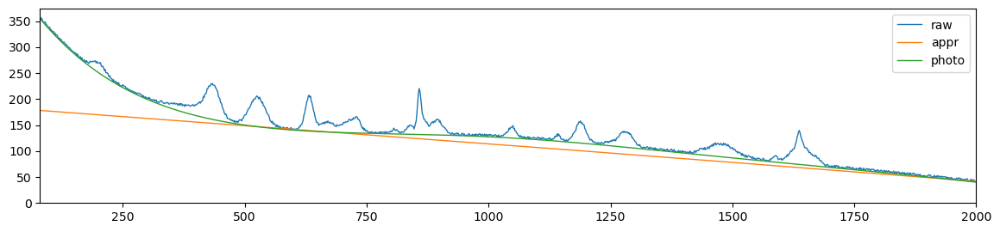

als_lambda: 100000000.0,	 als_p_weight: 0.0016102620275609393,	 error: 2251.5053618418915, 	 smoothness: 0.5218178022858254, 	 smoothness: -0.5635949586136892


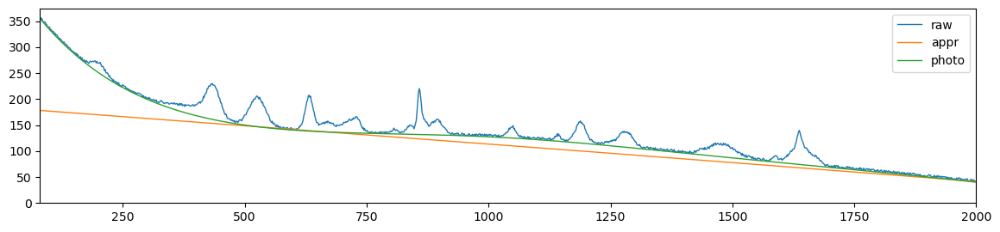

als_lambda: 100000000.0,	 als_p_weight: 0.0011721022975334804,	 error: 2288.7469204530835, 	 smoothness: 0.521537995899429, 	 smoothness: -0.5635390373532068


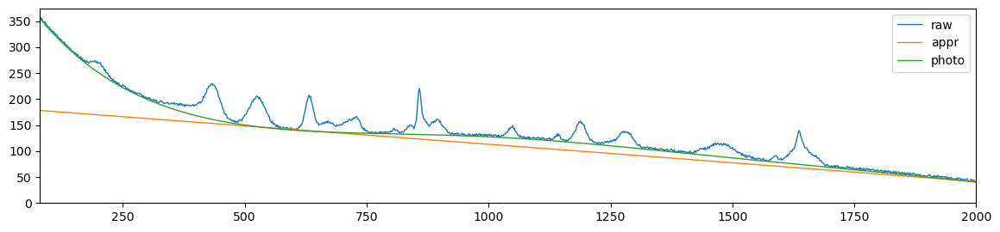

als_lambda: 100000000.0,	 als_p_weight: 0.0008531678524172806,	 error: 2319.277935789281, 	 smoothness: 0.5213338530471572, 	 smoothness: -0.5634941156378396


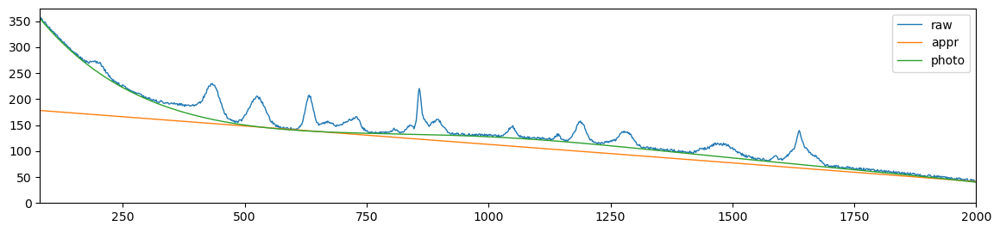

als_lambda: 100000000.0,	 als_p_weight: 0.0006210169418915617,	 error: 2344.2742642564504, 	 smoothness: 0.5211800092244235, 	 smoothness: -0.5634554159421323


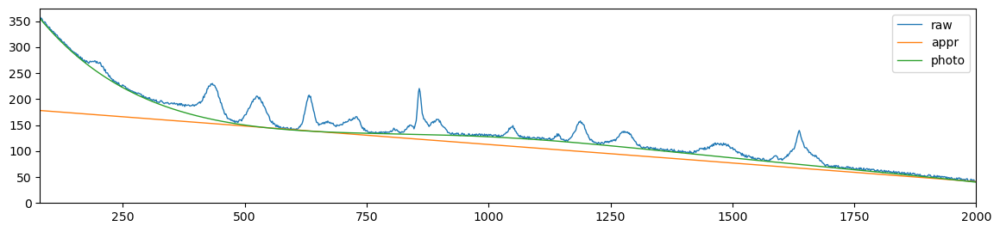

als_lambda: 100000000.0,	 als_p_weight: 0.00045203536563602454,	 error: 2364.609449506903, 	 smoothness: 0.5210653043435247, 	 smoothness: -0.5634242308266127


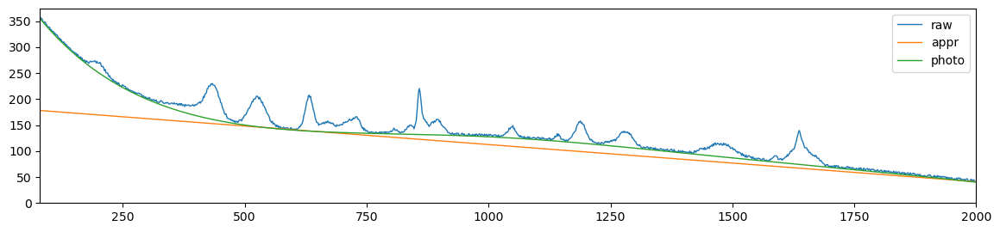

als_lambda: 100000000.0,	 als_p_weight: 0.00032903445623126676,	 error: 2381.3174370247198, 	 smoothness: 0.5209797539065462, 	 smoothness: -0.5634003636102508


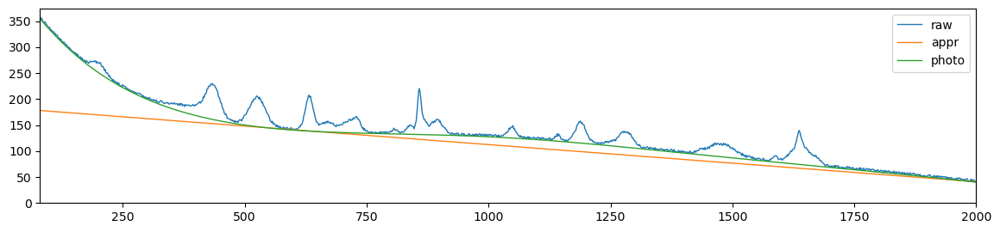

als_lambda: 100000000.0,	 als_p_weight: 0.0002395026619987486,	 error: 2395.289519815681, 	 smoothness: 0.520914808993217, 	 smoothness: -0.5633808448236689


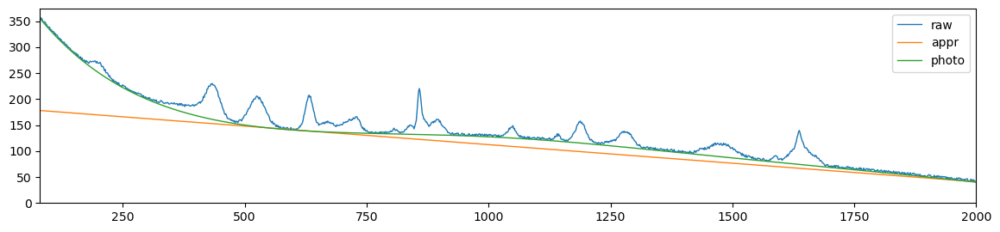

als_lambda: 100000000.0,	 als_p_weight: 0.00017433288221999874,	 error: 2406.854292254907, 	 smoothness: 0.5208667371847782, 	 smoothness: -0.5633672184384612


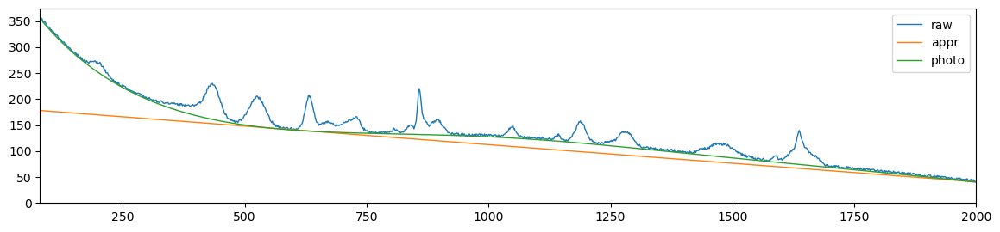

als_lambda: 100000000.0,	 als_p_weight: 0.0001268961003167922,	 error: 2416.035181196394, 	 smoothness: 0.5208338556864954, 	 smoothness: -0.5633594351210914


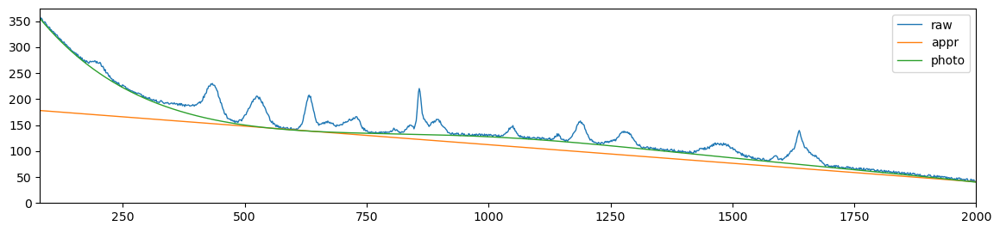

als_lambda: 100000000.0,	 als_p_weight: 9.236708571873866e-05,	 error: 2423.3919268047057, 	 smoothness: 0.5208112846020991, 	 smoothness: -0.5633548712399776


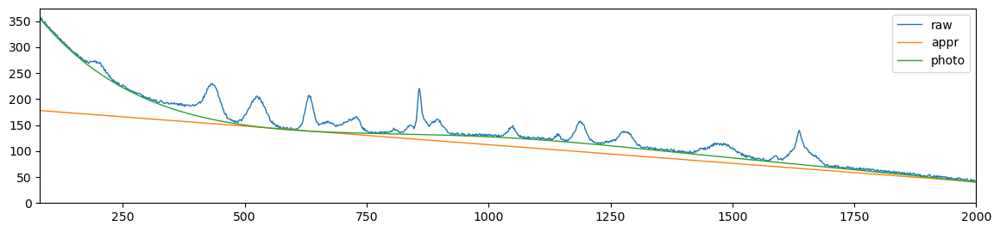

als_lambda: 100000000.0,	 als_p_weight: 6.723357536499335e-05,	 error: 2429.159657935649, 	 smoothness: 0.5207950779587472, 	 smoothness: -0.5633516891044446


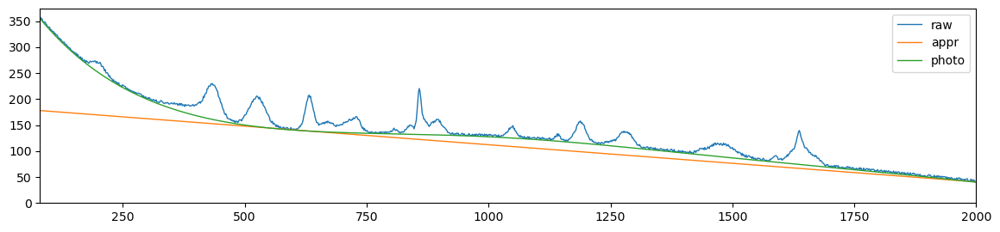

als_lambda: 100000000.0,	 als_p_weight: 4.893900918477499e-05,	 error: 2433.675907889849, 	 smoothness: 0.5207844143031898, 	 smoothness: -0.5633501440864153


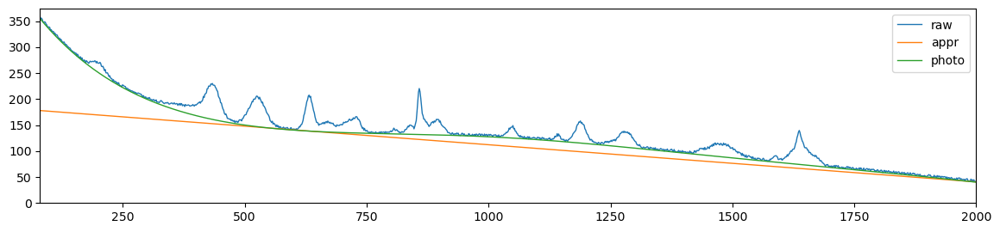

als_lambda: 100000000.0,	 als_p_weight: 3.5622478902624444e-05,	 error: 2437.191882282389, 	 smoothness: 0.5207767873481277, 	 smoothness: -0.5633492344444913


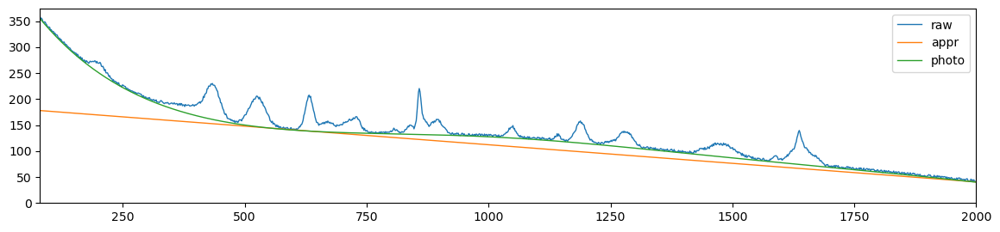

als_lambda: 100000000.0,	 als_p_weight: 2.592943797404667e-05,	 error: 2439.501964447117, 	 smoothness: 0.5207696409476562, 	 smoothness: -0.5633466559579


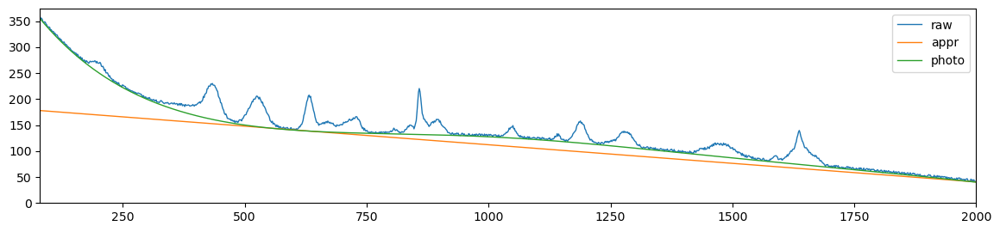

als_lambda: 100000000.0,	 als_p_weight: 1.8873918221350995e-05,	 error: 2441.5025482532296, 	 smoothness: 0.5207662587306146, 	 smoothness: -0.5633466939066508


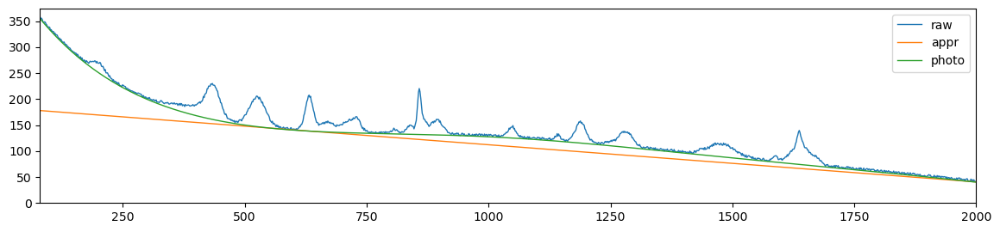

als_lambda: 100000000.0,	 als_p_weight: 1.3738237958832637e-05,	 error: 2442.978549869641, 	 smoothness: 0.5207637385213952, 	 smoothness: -0.5633466825507356


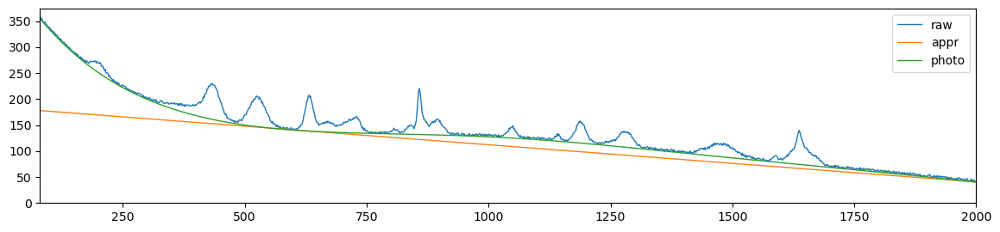

als_lambda: 100000000.0,	 als_p_weight: 1e-05,	 error: 2444.062843305989, 	 smoothness: 0.5207619060764788, 	 smoothness: -0.5633466450423508


In [17]:
plt.rcParams['figure.figsize'] = (14.0, 3.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['lines.linewidth'] = 1

error_lst = []
error_lst2 = []
error_lst3 = []

als_lambda_lst = np.logspace(1,8,30)
als_p_weight_lst = np.logspace(-1,-5,30)
for als_lambda in als_lambda_lst:
    for als_p_weight in als_p_weight_lst:
        e = []
        e2 = []
        e3 = []
        for j, (raw, real_photo) in enumerate(raw_lst):
            photo = derpsalsa.derpsalsa_baseline(x, raw, als_lambda=als_lambda, als_p_weight=als_p_weight, display=0)
            e += [error.MSE(photo, real_photo)]
            e2 += [error.TMSGE(photo, real_photo)]
            e3 += [error.MSGE(photo) - error.MSGE(real_photo)]
            
            if j == 22:
#                 print(j)
                plt.plot(x, raw, label="raw")
                plt.plot(x, photo, label="appr")
                plt.plot(x, real_photo, label="photo")
                plt.ylim(0)
                plt.xlim(start, end)
                plt.legend()
                plt.show()
        e = np.mean(e)
        e2 = np.mean(e2)
        e3 = np.mean(e3)
        error_lst.append(e)
        error_lst2.append(e2)
        error_lst3.append(e3)
        print(f"als_lambda: {als_lambda},\t als_p_weight: {als_p_weight},\t error: {e}, \t smoothness: {e2}, \t smoothness: {e3}")

        
        
#         raw, real_"photo = raw_lst[i]
#         weights = np.ones(len(x))
#         poly_max = copy.copy(raw).reshape(1,-1)
#         photo_old = -1
#         photo = poly_max
#         i = 0
#         while ((error.MAPE(photo_old, photo)) > 1e-4 and i < 30) or i < 2:
#             photo, photo_old = LS(poly_max, weights), photo
#             to_high = photo > raw
#             mean_error = np.mean(to_high, 0)
#             weights += mean_error
#             weights /= np.mean(weights)
#             poly_max[to_high] += (raw-photo)[to_high] * 0.5
#             poly_max[poly_max <= 0] = 1e-3
#             i += 1
#             photo[photo < 1] = 1
#         e = error.MSE(photo[0], real_photo)
#         e2 = error.TMSGE(photo[0], real_photo)
#         e3 = error.MSGE(photo[0]) - error.MSGE(real_photo)
#         error_lst.append(e)
#         error_lst2.append(e2)
#         error_lst3.append(e3)
#         print(f"FWHM: {FWHM_RBF},\t width: {width},\t error: {e}, \t smoothness: {e2}, \t smoothness: {e3}")
#         plt.plot(x, raw, label="raw")
# #         plt.plot(x, poly_max[0], label="target")
#         plt.plot(x, photo.reshape(-1), label="approximation")
#         plt.plot(x, real_photo, label="original photoluminescence")
#         plt.ylim(0)
#         plt.xlim(start, end)
#         plt.legend()
#         plt.show()"


error_lst = np.array(error_lst)
error_lst2 = np.array(error_lst2)
error_lst3 = np.array(error_lst3)

In [18]:
from scipy.ndimage import gaussian_filter

# error_lst1a = error_lst[::2]
# error_lst1b = error_lst[1::2]

# error_lst2a = error_lst2[::2]
# error_lst2b = error_lst2[1::2]

error_lst3c = np.abs(error_lst3)
# error_lst3a = error_lst3c[::2]
# error_lst3b = error_lst3c[1::2]

error_lst1a = error_lst
error_lst2a = error_lst2
error_lst3a = error_lst3c

(10.0, 0.0002395026619987486, 3.8570310417673657)
(2592.943797404667, 0.1, -2.7585108009711075)
(10.0, 0.00032903445623126676, 0.020543133775933545)


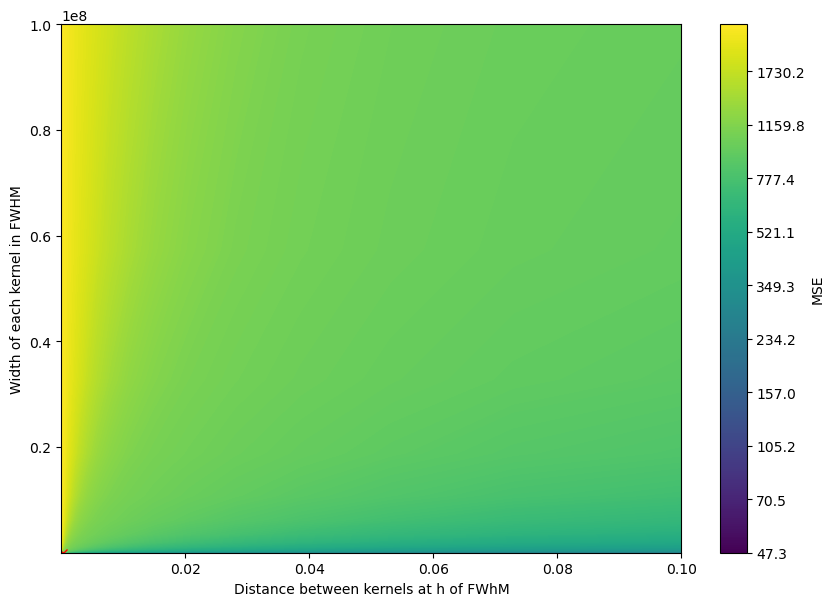

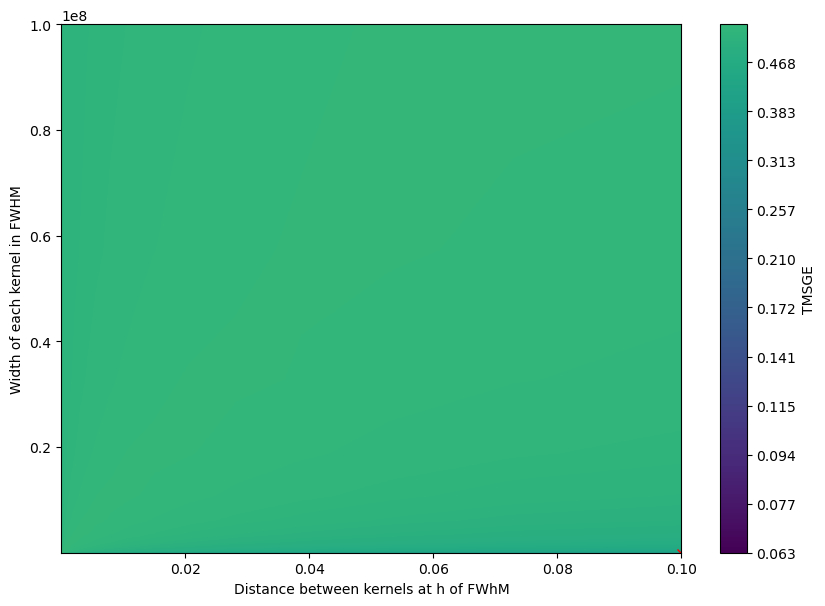

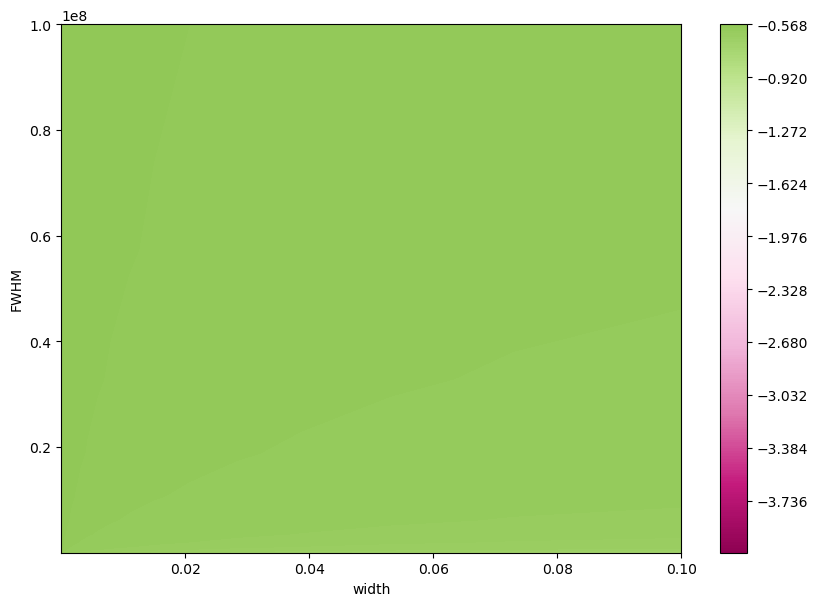

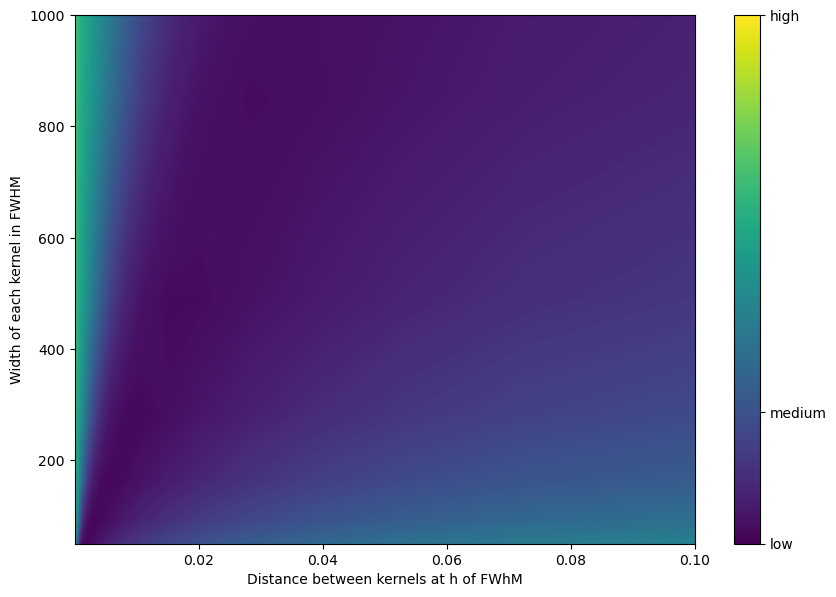

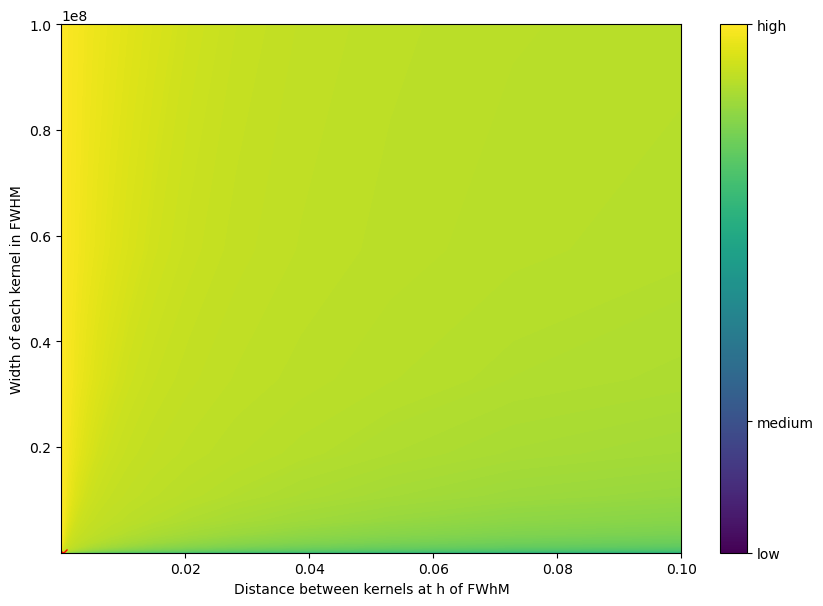

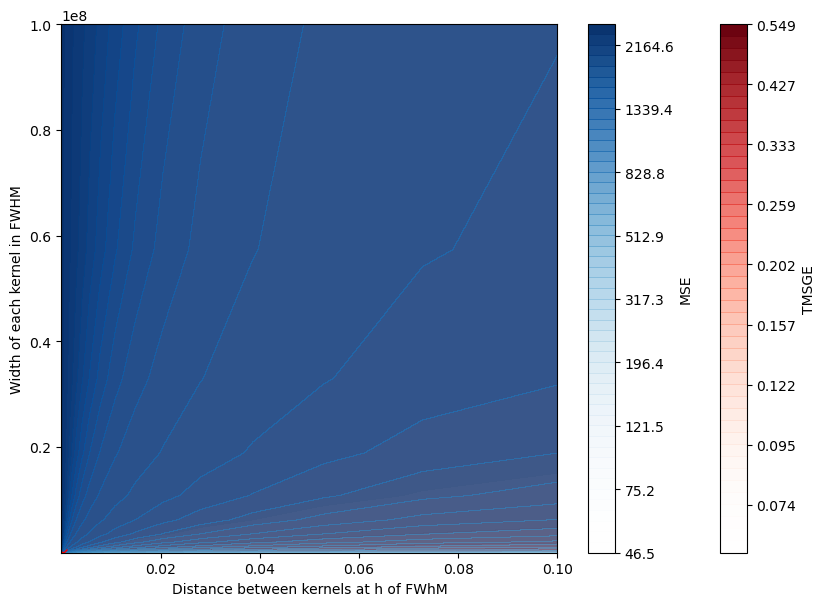

In [25]:
error_check1 = np.log(error_lst1a)
error_check2 = np.log(error_lst2a)
error_check3 = np.log(error_lst3a)
# error_check1 = (error_lst1a)
# error_check2 = (error_lst2a)
# error_check3 = (error_lst3a)

# error_check1 = (norm(error_check1)).reshape(len(als_lambda_lst), -1)
# error_check2 = (norm(error_check2)).reshape(len(als_lambda_lst), -1)
# error_check3 = (norm(error_check3)).reshape(len(als_lambda_lst), -1)
error_check1 = ((error_check1)).reshape(len(als_lambda_lst), -1)
error_check2 = ((error_check2)).reshape(len(als_lambda_lst), -1)
error_check3 = ((error_check3)).reshape(len(als_lambda_lst), -1)
error_check1 = gaussian_filter(error_check1, .8)
error_check2 = gaussian_filter(error_check2, .8)
error_check3 = gaussian_filter(error_check3, .8)

error_check = error_check1
l = len(als_p_weight_lst)
MSE_optimimum = (als_lambda_lst[np.argmin(error_check)//l], als_p_weight_lst[np.argmin(error_check)%l], np.min(error_check))
print(MSE_optimimum)

# print("best avg width", als_p_weight_lst[np.argmin(np.sum(error_check, 0))])

# print("best avg width FWHM", als_lambda_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))

error_check = error_check2
TMSGE_optimimum = (als_lambda_lst[np.argmin(error_check)//l], als_p_weight_lst[np.argmin(error_check)%l], np.min(error_check))
print(TMSGE_optimimum)

# print("best avg width", als_p_weight_lst[np.argmin(np.sum(error_check, 0))])

# print("best avg width FWHM", als_lambda_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))

# error_check = error_check3

# print(als_lambda_lst[np.argmin(error_check)//l], als_p_weight_lst[np.argmin(error_check)%l], np.min(error_check))

# print("best avg width", als_p_weight_lst[np.argmin(np.sum(error_check, 0))])

# print("best avg width FWHM", als_lambda_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))

error_check = norm(error_check1) + norm(error_check2) 
Combined_optimimum = (als_lambda_lst[np.argmin(error_check)//l], als_p_weight_lst[np.argmin(error_check)%l], np.min(error_check))
Combined_minima = [als_lambda_lst[i] for i in np.argmin(error_check, 0)]
print(Combined_optimimum)

# print("best avg width", als_p_weight_lst[np.argmin(np.sum(error_check, 0))])

# print("best avg width FWHM", als_lambda_lst[np.argmin(error_check[:,np.argmin(np.sum(error_check, 0))])], np.min(error_check[:,np.argmin(np.sum(error_check, 0))]))


# error_show = error_check
X, Y = np.meshgrid(als_p_weight_lst, als_lambda_lst)

plt.rcParams['figure.figsize'] = (10.0, 7.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['lines.linewidth'] = 1

# fig = plt.figure()
# ax = plt.axes()
# cset = ax.contourf(X, Y, np.log(error_check), levels=500, cmap = 'Greens',alpha=1, vmax=.02)
# cset = ax.contourf(X, Y, np.log(error_check1), levels=500, cmap = 'Reds',alpha=0.7, vmax=.01)
# cset = ax.contourf(X, Y, np.log(error_check2), levels=500, cmap = 'Blues',alpha=0.3, vmax=.01)
# ax.set_xlabel('width')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
# ax.set_ylabel('FWHM')
# plt.show()


fig = plt.figure()
ax = plt.axes()
cset = ax.contourf(X, Y, error_check1, levels=500, cmap = 'viridis',alpha=1)
ax.set_xlabel('Distance between kernels at h of FWhM')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('Width of each kernel in FWHM')
cbar = fig.colorbar(cset, label="MSE")
cbar.ax.set_yticklabels([f"{t:4.1f}" for t in np.exp(cbar.get_ticks())])
plt.plot([MSE_optimimum[1]], [MSE_optimimum[0]], 'rx')
plt.show()

fig = plt.figure()
ax = plt.axes()
cset = ax.contourf(X, Y, error_check2, levels=500, cmap = 'viridis',alpha=1, vmax=0.5)

ax.set_xlabel('Distance between kernels at h of FWhM')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('Width of each kernel in FWHM')
tick_labels = cset.get_array()

cbar = fig.colorbar(cset, ticks=tick_labels[::40], label="TMSGE")
cbar.ax.set_yticklabels([f"{t:4.3f}" for t in np.exp(cbar.get_ticks())])

plt.plot([TMSGE_optimimum[1]], [TMSGE_optimimum[0]], 'rx' )
plt.show()

fig = plt.figure()
ax = plt.axes()
cset = ax.contourf(X, Y, error_check3, levels=500, cmap = 'PiYG',alpha=1, vmax=0.5)

ax.set_xlabel('width')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('FWHM')
# plt.legend()
cbar = fig.colorbar(cset)
plt.show()

import matplotlib.pylab as pl
from matplotlib.colors import ListedColormap
def add_alpha(cmap, alpha=0):
    # Get the colormap colors
    my_cmap = cmap(np.arange(cmap.N))
    # Set alpha
    my_cmap[:,-1] = np.linspace(alpha, 1, cmap.N)
    # Create new colormap
    return ListedColormap(my_cmap)

# Choose colormap
Reds = add_alpha(pl.cm.Reds)
Greens = add_alpha(pl.cm.Greens)
Blues = add_alpha(pl.cm.Blues)

fig = plt.figure()
ax = plt.axes()
error_check = (norm(error_check1) + norm(error_check2)) / 2
cset = ax.contourf(X, Y, error_check, levels=500, cmap = "viridis")
tick_labels = cset.get_array()

cbar = fig.colorbar(cset, ticks=[tick_labels[0], tick_labels[len(tick_labels)//4], tick_labels[-1]])
cbar.ax.set_yticklabels(['low', 'medium', 'high'])  
plt.plot([Combined_optimimum[1]], [Combined_optimimum[0]], 'rx' )

# index = np.where(als_p_weight_lst == Combined_optimimum[1])[0][0]
# from scipy.interpolate import UnivariateSpline

# n=1
# spl = UnivariateSpline(als_p_weight_lst[index-n:-1], Combined_minima[index-n:-1], s = 1e4)
# spl_x = np.linspace(als_p_weight_lst[index+1], als_p_weight_lst[-2], 100)
# spl_y = spl(spl_x)
# plt.plot(spl_x, spl_y, 'r', linestyle=(0,(5,5)))

ax.set_xlabel('Distance between kernels at h of FWhM')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('Width of each kernel in FWHM')
ax.set_ylim(50,1000)
# plt.legend()
plt.show()

fig = plt.figure()
ax = plt.axes()
error_check = (norm(error_check1) + norm(error_check2)) / 2
cset = ax.contourf(X, Y, error_check, levels=500, cmap = "viridis")
tick_labels = cset.get_array()

cbar = fig.colorbar(cset, ticks=[tick_labels[0], tick_labels[len(tick_labels)//4], tick_labels[-1]])
cbar.ax.set_yticklabels(['low', 'medium', 'high'])  
plt.plot([Combined_optimimum[1]], [Combined_optimimum[0]], 'rx' )

ax.set_xlabel('Distance between kernels at h of FWhM')
# ax.set_xticks(np.linspace(0.5,0.99,8))
# ax.set_yticks(np.linspace(50,1000,20))
ax.set_ylabel('Width of each kernel in FWHM')
# ax.set_ylim(50,1000)
# plt.legend()
plt.show()


fig = plt.figure()
ax = plt.axes()
cset = ax.contourf(X, Y, error_check2, levels=50, cmap = Reds)
cbar = fig.colorbar(cset, label="TMSGE")
cbar.ax.set_yticklabels([f"{t:.3f}" for t in np.exp(cbar.get_ticks())])
cset = ax.contourf(X, Y, error_check1, levels=50, cmap = Blues)
cbar = fig.colorbar(cset, label="MSE")
cbar.ax.set_yticklabels([f"{t:.1f}" for t in np.exp(cbar.get_ticks())])
ax.set_xlabel('Distance between kernels at h of FWhM')
# ax.set_xticks(np.linspace(0.5, 0.99, 8))
# ax.set_yticks(als_lambda_lst)
ax.set_ylabel('Width of each kernel in FWHM')
# plt.legend()
plt.plot([Combined_optimimum[1]], [Combined_optimimum[0]], 'rx')
plt.show()
